In [1]:
import re, pickle, time, os, copy
import plot_utils, train_utils, function_utils, dict_utils, build_feature_utils

import numpy as np
import pandas as pd


from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import ElasticNetCV
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score
from sklearn.feature_selection import r_regression

import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

<frozen importlib._bootstrap>:219: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


## Remove and fix some data

In [2]:
batch1 = pickle.load(open(os.path.join('.','Data','batch1.pkl'), 'rb'))
#remove batteries that do not reach 80% capacity
del batch1['b1c8']
del batch1['b1c10']
del batch1['b1c12']
del batch1['b1c13']
del batch1['b1c22']

numBat1 = len(batch1.keys())

batch2 = pickle.load(open(os.path.join('.','Data','batch2.pkl'),'rb'))
# There are four cells from batch1 that carried into batch2, we'll remove the data from batch2
# and put it with the correct cell from batch1
batch2_keys = ['b2c7', 'b2c8', 'b2c9', 'b2c15', 'b2c16']
batch1_keys = ['b1c0', 'b1c1', 'b1c2', 'b1c3', 'b1c4']
add_len = [662, 981, 1060, 208, 482];

for i, bk in enumerate(batch1_keys):
    batch1[bk]['cycle_life'] = batch1[bk]['cycle_life'] + add_len[i]
    for j in batch1[bk]['summary'].keys():
        if j == 'cycle':
            batch1[bk]['summary'][j] = np.hstack((batch1[bk]['summary'][j], batch2[batch2_keys[i]]['summary'][j] + len(batch1[bk]['summary'][j])))
        else:
            batch1[bk]['summary'][j] = np.hstack((batch1[bk]['summary'][j], batch2[batch2_keys[i]]['summary'][j]))
    last_cycle = len(batch1[bk]['cycles'].keys())
    for j, jk in enumerate(batch2[batch2_keys[i]]['cycles'].keys()):
        batch1[bk]['cycles'][str(last_cycle + j)] = batch2[batch2_keys[i]]['cycles'][jk]
        
## THIS IS MY CHANGE, 3/6/2021: b2c1 is an anomaly; 148 cycle life. REMOVE at cell above and below

del batch2['b2c7']
del batch2['b2c8']
del batch2['b2c9']
del batch2['b2c15']
del batch2['b2c16']

numBat2 = len(batch2.keys())

batch3 = pickle.load(open(os.path.join('.','Data','batch3.pkl'),'rb'))
# remove noisy channels from batch3
del batch3['b3c37']
del batch3['b3c2']
del batch3['b3c23']
del batch3['b3c32']
del batch3['b3c38']
del batch3['b3c39']

numBat3 = len(batch3.keys())

numBat = numBat1 + numBat2 + numBat3
bat_dict = {'LFP_data': {**batch1, **batch2, **batch3}}

In [3]:
# index used in the nature paper
# test_ind = np.hstack((np.arange(0,(numBat1+numBat2),2),83))
test_ind = np.arange(0,(numBat1+numBat2),2)
train_ind = np.arange(1,(numBat1+numBat2-1),2)
secondary_test_ind = np.arange(numBat-numBat3,numBat);

# remove the anomalous cell, b2c1
test_ind = np.delete(test_ind, 21)
test_ind = np.append(test_ind, numBat1+numBat2-1)

In [4]:
# Seggregate the data into charge, discharge and their rests
bat_index_dict = dict_utils.create_bat_index_dict(bat_dict['LFP_data'].keys(), bat_dict['LFP_data'])
# And assign back into bat_dict for ease of use
bat_dict = function_utils.set_stepIndex(bat_dict, bat_index_dict)

# Check for error in the step index assignment
for cellNo in bat_dict['LFP_data'].keys():
    for cycleNo in list(bat_dict['LFP_data'][cellNo]['cycles'].keys())[1:202]:
        checkCell = bat_dict['LFP_data'][cellNo]['cycles'][cycleNo]
        idxCh = np.where(checkCell['Step_index'] == 3)[0]
        idxDis = np.where(checkCell['Step_index'] == 5)[0]

        if np.mean(checkCell['Qd'][idxCh][-10:]) > 0.1: print("The mean Qd for charging index is higher than 0.1 for", cellNo, cycleNo)
        if checkCell['Qd'][idxDis[0]] > 0.1: print("The starting Qd is higher than 0.1 for", cellNo, cycleNo)

# Manual fix for certain cell/cycle
fixCell = bat_dict['LFP_data']['b2c27']['cycles']
for keyName in fixCell['118'].keys():
    fixCell['118'][keyName] = fixCell['117'][keyName]

Rest index is empty for b1c45 270
The mean Qd for charging index is higher than 0.1 for b2c12 252
The starting Qd is higher than 0.03 for b2c12 252
The starting Qd is higher than 0.03 for b2c27 118
The starting Qd is higher than 0.03 for b2c44 247
Rest index is empty for b2c44 247
The starting Qd is higher than 0.1 for b2c27 118


#### Only consider CC-region only and interpolate

In [5]:
stepTotal = 100
testDict = copy.deepcopy(bat_dict)

for cellNo in testDict['LFP_data'].keys():
    for cycleNo in testDict['LFP_data'][cellNo]['cycles'].keys():
        if cycleNo == '0': continue
        testCellwCycle = testDict['LFP_data'][cellNo]['cycles'][cycleNo]
        
        idxDis = np.where(testCellwCycle['Step_index'] == 5)[0]
        idxCh = np.where(testCellwCycle['Step_index'] == 3)[0]
        # idxChCC = np.where(testCellwCycle['Step_index'] == 3)[0][0: np.where(testCellwCycle['Step_index'] == 4)[0][0]]

        linDictDis = function_utils.interpolate_data(xLimitList = [3.6, 2.04], step = stepTotal, cellDictOri = testCellwCycle, 
                                                 yKeyList = ['Qd', 'T_cell', 'V'], xKey = 'V', idxList = idxDis)
        for keyName in linDictDis.keys(): testCellwCycle[keyName] = linDictDis[keyName].copy()
        
        
        linDictCh = function_utils.interpolate_data(xLimitList = [0, 0.88], step = stepTotal, cellDictOri = testCellwCycle, 
                                                  yKeyList = ['Qc', 'T_cell'], xKey = 'Qc', idxList = idxCh)
        for keyName in linDictCh.keys(): testCellwCycle[keyName] = linDictCh[keyName].copy()

In [6]:
chargepolicylst = []
cyclelifelst = []
avgchargepolicylst = []
diffchargepolicylst = []
avgchargetimelst = []

timeCycles = list(map(str, np.arange(1,11,1))) #first 10 cycles for average charge time

for batno in testDict['LFP_data'].keys():
    chargepolicylst.append((testDict['LFP_data'][batno]['charge_policy']))
    cyclelifelst.append(int(testDict['LFP_data'][batno]['cycle_life']))
    
    totTime = 0
    for cycle in timeCycles:
        stopIdx = bat_index_dict[batno][cycle]['rest'][0]
        totTime += testDict['LFP_data'][batno]['cycles'][cycle]['t'][stopIdx]
    avgchargetimelst.append(totTime/len(timeCycles))

avgchargepolicylst = []
for policy in chargepolicylst:
    avgchargelst = re.findall(r'[0-9.]+', policy)
    avgchargelst = list(map(float, avgchargelst))
    a0 = avgchargelst[0]; a1 = avgchargelst[1]; a2 = avgchargelst[2]
    
    avgcharge = ((a0 * a1 / 100) + (a2 * (0.80 - a1 / 100))) / 0.80
    avgchargepolicylst.append(avgcharge)
    
    diffchargepolicy = a0 - a2
    diffchargepolicylst.append(diffchargepolicy)
       
bat_df = pd.DataFrame({'Bat code': pd.Series(list(testDict['LFP_data'].keys())),
                       'Charging policy': pd.Series(chargepolicylst),
                       'Avg charging policy' : pd.Series(avgchargepolicylst),
                       'Diff in charging policy' : pd.Series(diffchargepolicylst),
                       'Cycle life': pd.Series(cyclelifelst),
                       'Avg charging time' : pd.Series(avgchargetimelst)
})

In [7]:
# Y values - cycle life
y_train = np.log10(bat_df['Cycle life'][train_ind])
y_test = np.log10(bat_df['Cycle life'][test_ind])
y_secondary_test = np.log10(bat_df['Cycle life'][secondary_test_ind])
y_all = np.concatenate((y_train, y_test, y_secondary_test))

lenList = [len(train_ind), len(train_ind) + len(test_ind), len(train_ind) + len(test_ind) + len(secondary_test_ind)]

In [8]:
cycleList = [str(x) for x in np.arange(1,150,1)]

T_Q =  build_feature_utils.create_T_Q_lin_feature(testDict, cycleList, avgUpToCycle=150)
dTdQ =  build_feature_utils.create_dTdQ_lin_feature(testDict, cycleList, avgUpToCycle=150)

TQKeynameUnique = function_utils.get_unique_keyname_tuple(T_Q)
dTdQKeynameUnique = function_utils.get_unique_keyname_tuple(dTdQ)

In [9]:
# Manual fix
def modify_inf(dictname, keyname_tuple, currentCycle):
    if np.any(np.isinf(dictname[keyname_tuple])):
        indexList = np.argwhere(dictname[keyname_tuple] == -np.inf)
        for idx in indexList: dictname[keyname_tuple][idx] = dictname[keyname_tuple[0], keyname_tuple[1], 'Average_2to'+str(int(currentCycle)-1)][idx]

    return dictname[keyname_tuple]

for avgNo in ['142', '143', '144', '145', '146', '147', '148', '149']:
    cycleNo = 'Average_2to' + avgNo
    T_Q[('Charge', 'Minimum', cycleNo)] = modify_inf(T_Q, ('Charge', 'Minimum', cycleNo), avgNo)
    T_Q[('Charge', 'Max-Min', cycleNo)] = modify_inf(T_Q, ('Charge', 'Max-Min', cycleNo), avgNo)
    T_Q[('Discharge', 'Variance', cycleNo)] = modify_inf(T_Q, ('Discharge', 'Variance', cycleNo), avgNo)
    dTdQ[('Charge', 'Mean', cycleNo)] = modify_inf(dTdQ, ('Charge', 'Mean', cycleNo), avgNo)
    dTdQ[('Charge', 'Skewness', cycleNo)] = modify_inf(dTdQ, ('Charge', 'Skewness', cycleNo), avgNo) 
    dTdQ[('Charge', 'Maximum', cycleNo)] = modify_inf(dTdQ, ('Charge', 'Maximum', cycleNo), avgNo)

### The code below train and test the model using feature input extracted from different aggregate of cycle numbers. We assess the averaged values of the features, from the first 3, 4, .. 150 cycles (thus Avg3, Avg4, ..)
#### Uncomment and run the code below to see the errors and plots
#### The results are provided and can be seen by simply un-hiding the output.


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 3.9
Best score obtained was: 0.448977158693428
Cycle no: Average_2to3
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to3') : 0.07914083788058668
T_Q('Charge', 'Skewness', 'Average_2to3') : -0.011445476427029123
T_Q('Charge', 'Max-Min', 'Average_2to3') : -0.06559203338905406
dTdQ('Charge', 'Maximum', 'Average_2to3') : -0.0321727197261748
dTdQ('Discharge', 'Max-Min', 'Average_2to3') : 0.013582174785595988
nature_dictAvg_charge_time : 0.09731225628460123
nature_dictIR_cycle2 : 0.0013975717421891472
nature_dictMinT_2to3 : 0.04314821353667426
nature_dictIntegralT_2to3 : -0.08500569128304919

Intercept: 2.7939698976436365
r2-score: 0.845
MAE_all: 101.7
MAE_train: 61.6
MAE_test: 85.5
MAE_2ndTest: 159.8
MAPE_all: 11.9 %
MAPE_train: 8.5 %
MAPE_test: 11.1 %
MAPE_2ndTest: 16.1 %
RMSE_all: 154.5
RMSE_train: 93.3
RMSE_test: 137.1
RMSE_2ndTest: 211.6
RMSPE_all: 16.

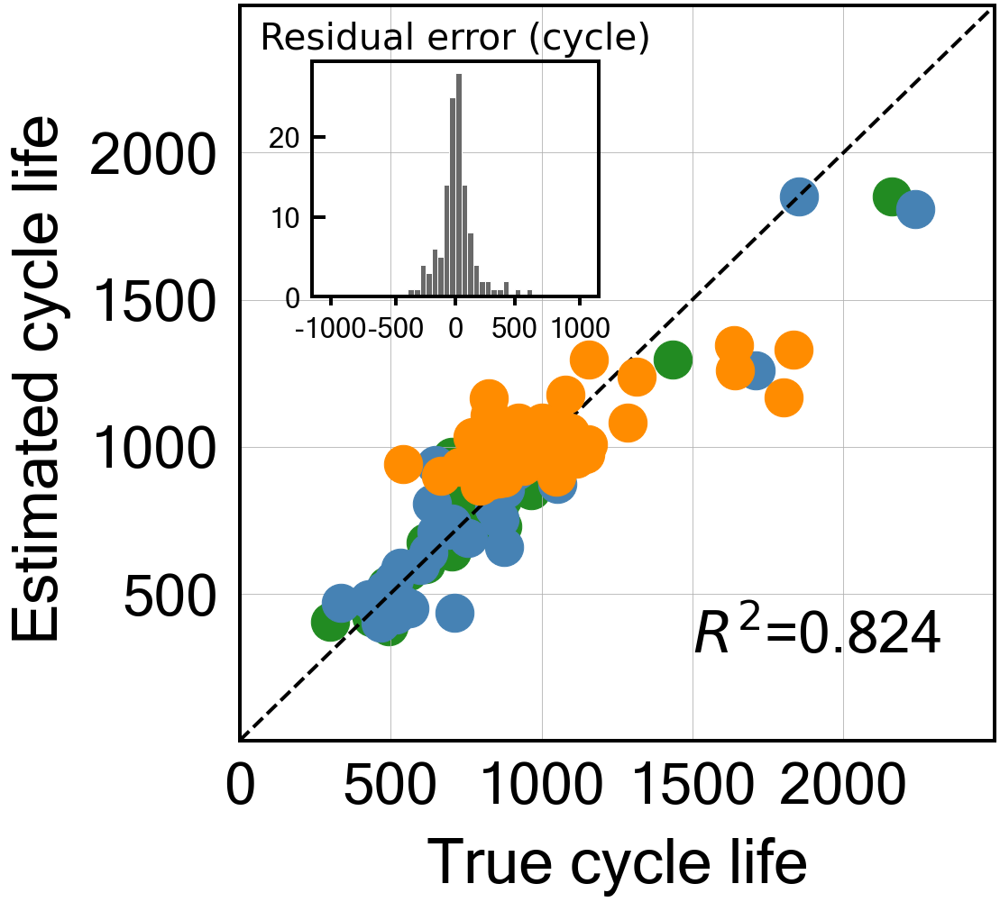


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.0
Best score obtained was: 0.4051583350660991
Cycle no: Average_2to4
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to4') : 0.09001051341628434
T_Q('Charge', 'Skewness', 'Average_2to4') : -0.008476228307652338
T_Q('Charge', 'Max-Min', 'Average_2to4') : -0.05644612215957004
dTdQ('Charge', 'Maximum', 'Average_2to4') : -0.028698608451472245
dTdQ('Discharge', 'Max-Min', 'Average_2to4') : 0.0019464742366165234
nature_dictAvg_charge_time : 0.10773542043219618
nature_dictIR_cycle2 : 0.0029575474832164027
nature_dictMinT_2to4 : 0.04001154337988113
nature_dictIntegralT_2to4 : -0.09139228159073864

Intercept: 2.7939698976436365
r2-score: 0.837
MAE_all: 106.0
MAE_train: 64.7
MAE_test: 90.2
MAE_2ndTest: 165.1
MAPE_all: 12.1 %
MAPE_train: 8.7 %
MAPE_test: 11.6 %
MAPE_2ndTest: 16.1 %
RMSE_all: 159.9
RMSE_train: 98.9
RMSE_test: 139.0
RMSE_2ndTest: 219.9
RMSPE_all:

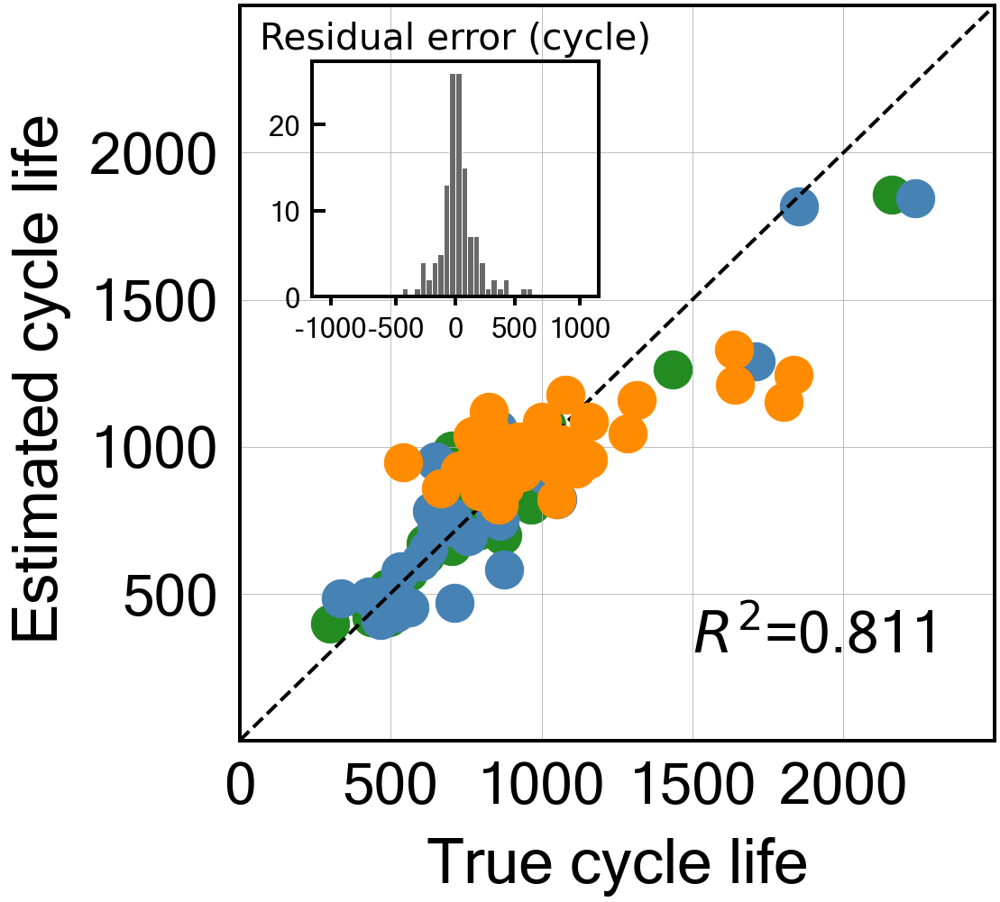


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 3.9
Best score obtained was: 0.49249093505029484
Cycle no: Average_2to5
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to5') : 0.08962557029090513
T_Q('Charge', 'Skewness', 'Average_2to5') : -0.014624382097688128
T_Q('Charge', 'Max-Min', 'Average_2to5') : -0.08190644677188162
dTdQ('Charge', 'Maximum', 'Average_2to5') : -0.033748768180635796
dTdQ('Discharge', 'Max-Min', 'Average_2to5') : 0.017087084559073467
nature_dictAvg_charge_time : 0.09675675926939634
nature_dictIR_cycle2 : 0.005368261463786101
nature_dictMinT_2to5 : 0.04692822297708549
nature_dictIntegralT_2to5 : -0.0860453825616228

Intercept: 2.793969897643637
r2-score: 0.852
MAE_all: 101.3
MAE_train: 63.0
MAE_test: 90.4
MAE_2ndTest: 151.9
MAPE_all: 11.8 %
MAPE_train: 8.5 %
MAPE_test: 11.5 %
MAPE_2ndTest: 15.3 %
RMSE_all: 151.8
RMSE_train: 97.5
RMSE_test: 137.5
RMSE_2ndTest: 203.1
RMSPE_all: 16

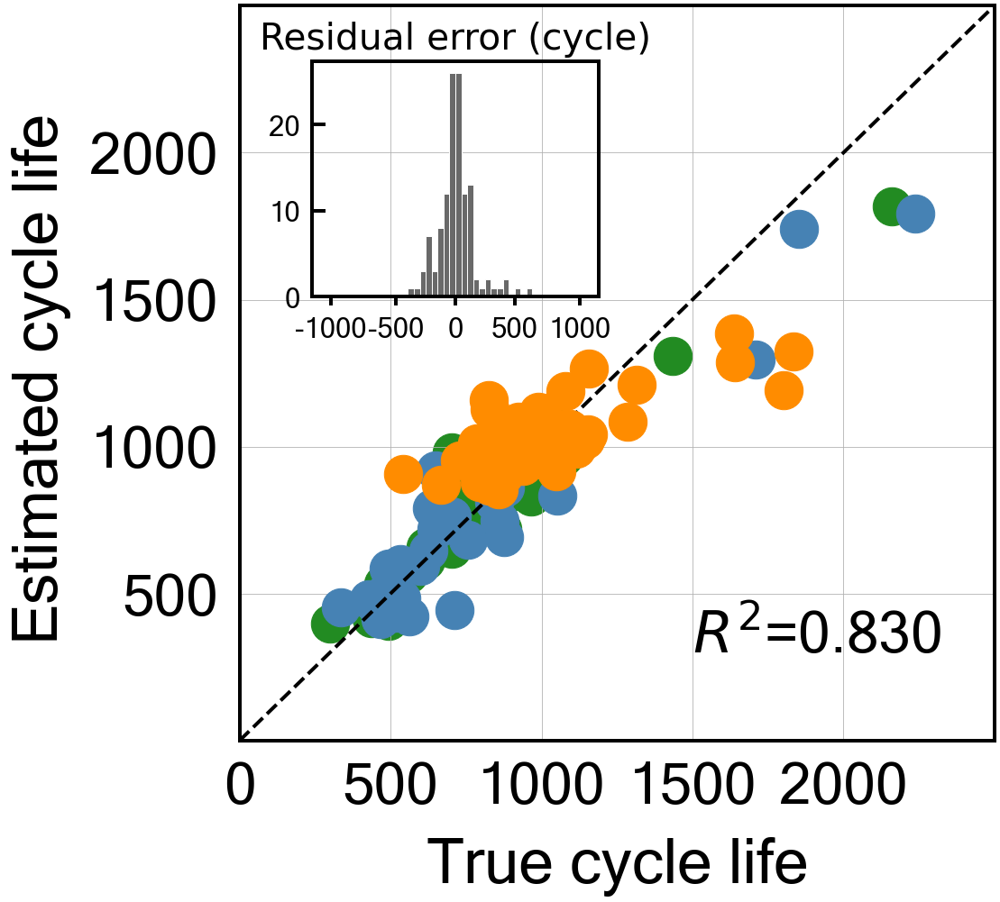


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.0
Best score obtained was: 0.4877295528634118
Cycle no: Average_2to6
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to6') : 0.07629621505496148
T_Q('Charge', 'Skewness', 'Average_2to6') : -0.0188968769487863
T_Q('Charge', 'Max-Min', 'Average_2to6') : -0.08128259372683874
dTdQ('Charge', 'Maximum', 'Average_2to6') : -0.039753131485654215
dTdQ('Discharge', 'Max-Min', 'Average_2to6') : 0.030840076701281072
nature_dictAvg_charge_time : 0.092876506612682
nature_dictIR_cycle2 : 0.0075006959961387825
nature_dictMinT_2to6 : 0.049106731348272224
nature_dictIntegralT_2to6 : -0.08629376207245318

Intercept: 2.793969897643637
r2-score: 0.849
MAE_all: 103.0
MAE_train: 62.1
MAE_test: 88.5
MAE_2ndTest: 160.1
MAPE_all: 12.1 %
MAPE_train: 8.3 %
MAPE_test: 11.7 %
MAPE_2ndTest: 16.4 %
RMSE_all: 151.4
RMSE_train: 96.8
RMSE_test: 135.4
RMSE_2ndTest: 204.1
RMSPE_all: 16.6

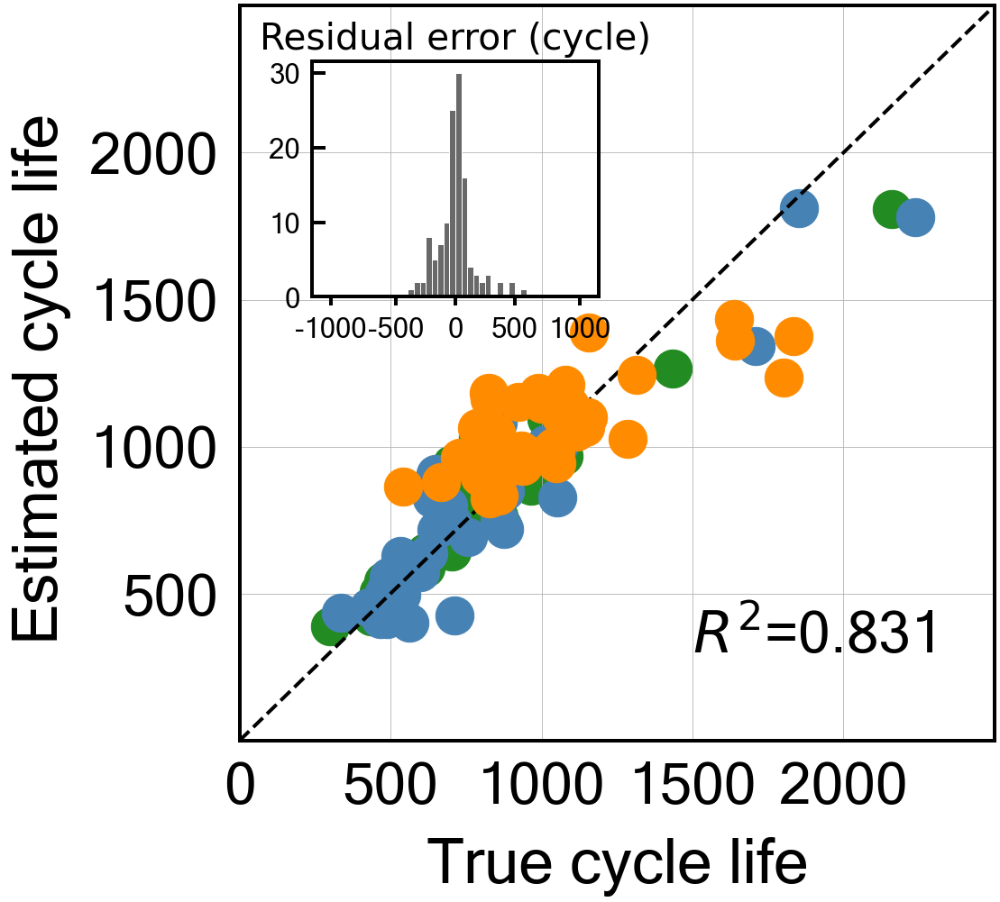


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.0
Best score obtained was: 0.47762532979285754
Cycle no: Average_2to7
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to7') : 0.0031092740282635295
T_Q('Charge', 'Skewness', 'Average_2to7') : -0.016217547166645675
T_Q('Charge', 'Max-Min', 'Average_2to7') : -0.012293803127185393
dTdQ('Charge', 'Maximum', 'Average_2to7') : -0.042012055691873954
dTdQ('Discharge', 'Max-Min', 'Average_2to7') : 0.02593962970557953
nature_dictAvg_charge_time : 0.08747417396677035
nature_dictIR_cycle2 : 0.0029862221670741533
nature_dictMinT_2to7 : 0.050418545554076946
nature_dictIntegralT_2to7 : -0.07737569320727498

Intercept: 2.793969897643637
r2-score: 0.836
MAE_all: 106.8
MAE_train: 65.3
MAE_test: 93.1
MAE_2ndTest: 163.8
MAPE_all: 12.6 %
MAPE_train: 8.7 %
MAPE_test: 12.0 %
MAPE_2ndTest: 17.2 %
RMSE_all: 156.3
RMSE_train: 102.2
RMSE_test: 144.5
RMSE_2ndTest: 206.1
RMSPE_a

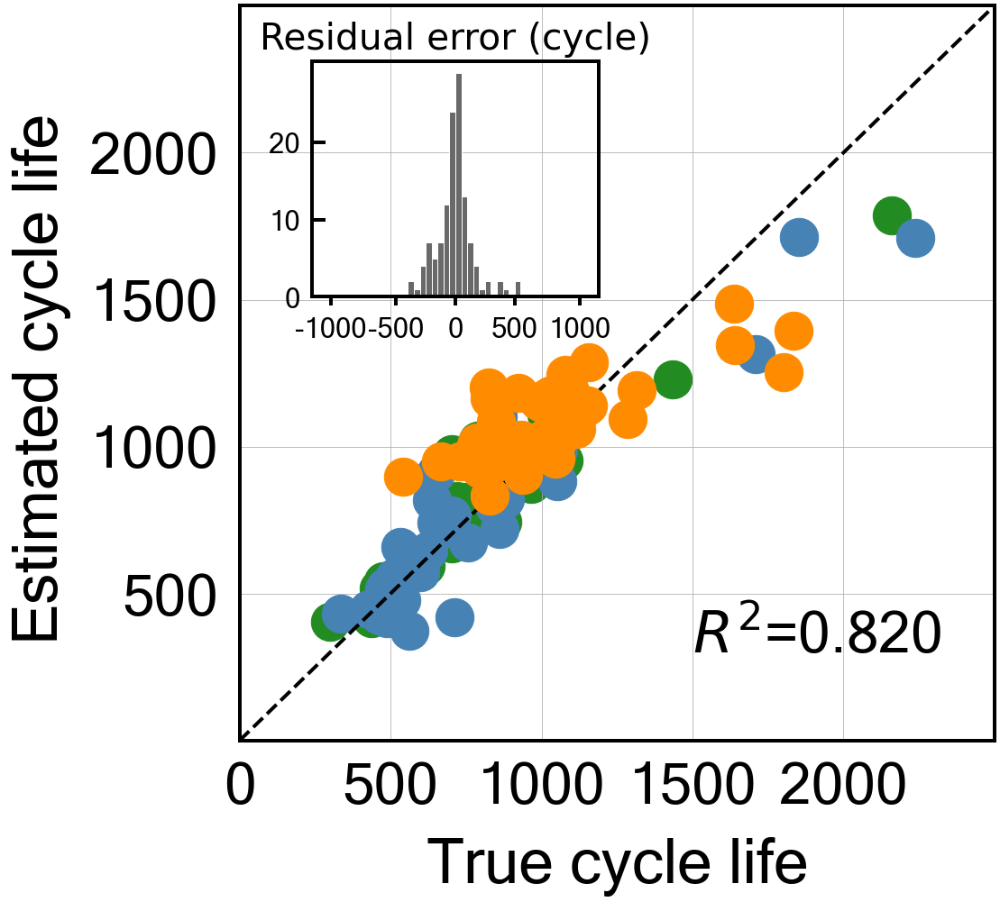


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 3.9
Best score obtained was: 0.4886517877960528
Cycle no: Average_2to8
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to8') : 0.11547524146638198
T_Q('Charge', 'Skewness', 'Average_2to8') : -0.026182089165094145
T_Q('Charge', 'Max-Min', 'Average_2to8') : -0.12753160596656601
dTdQ('Charge', 'Maximum', 'Average_2to8') : -0.02307970301176886
dTdQ('Discharge', 'Max-Min', 'Average_2to8') : 0.02451751486511153
nature_dictAvg_charge_time : 0.091116114259309
nature_dictIR_cycle2 : 0.011453113408803525
nature_dictMinT_2to8 : 0.04784396589774432
nature_dictIntegralT_2to8 : -0.08887315019695526

Intercept: 2.7939698976436365
r2-score: 0.854
MAE_all: 100.6
MAE_train: 61.2
MAE_test: 93.7
MAE_2ndTest: 148.4
MAPE_all: 11.6 %
MAPE_train: 8.3 %
MAPE_test: 12.0 %
MAPE_2ndTest: 14.5 %
RMSE_all: 154.2
RMSE_train: 96.3
RMSE_test: 144.8
RMSE_2ndTest: 203.9
RMSPE_all: 15.9 

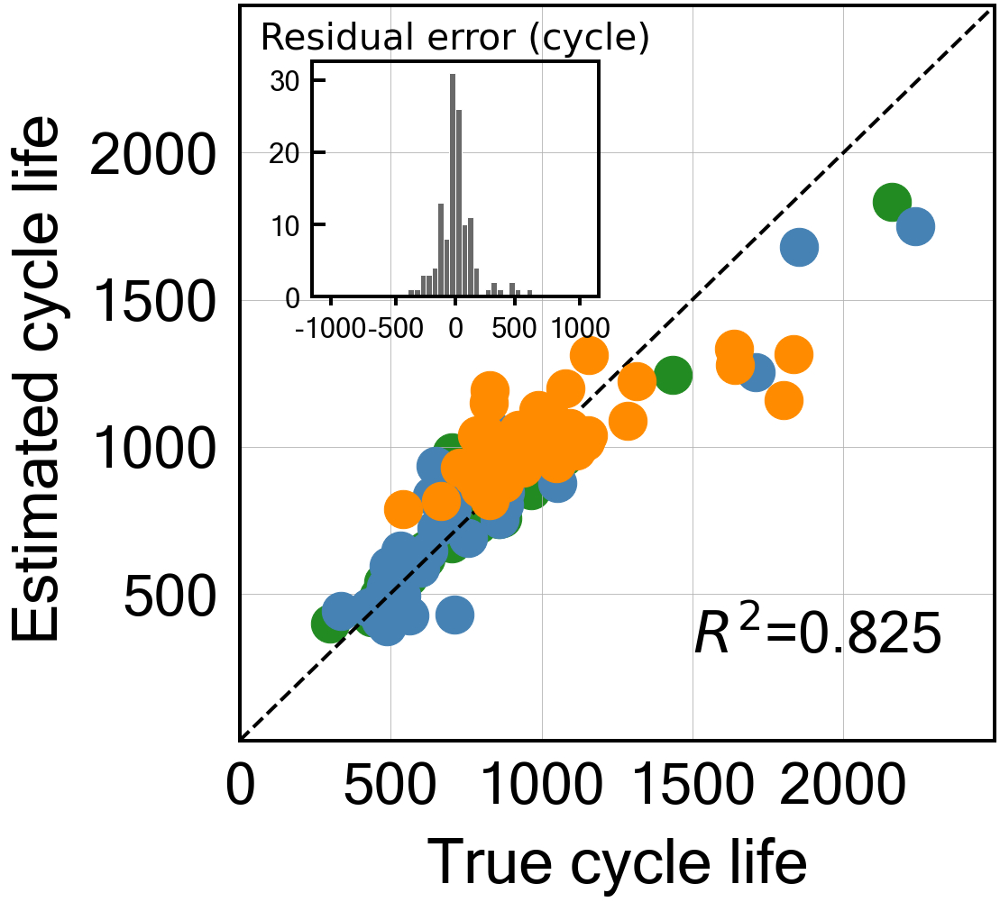


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 3.9
Best score obtained was: 0.49850897629989144
Cycle no: Average_2to9
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to9') : 0.10542784305227271
T_Q('Charge', 'Skewness', 'Average_2to9') : -0.026321531085158712
T_Q('Charge', 'Max-Min', 'Average_2to9') : -0.11655769634795768
dTdQ('Charge', 'Maximum', 'Average_2to9') : -0.022226738554755484
dTdQ('Discharge', 'Max-Min', 'Average_2to9') : 0.0221049775569293
nature_dictAvg_charge_time : 0.09167130363928343
nature_dictIR_cycle2 : 0.010642529018724946
nature_dictMinT_2to9 : 0.047843436129376554
nature_dictIntegralT_2to9 : -0.08703952141653482

Intercept: 2.793969897643637
r2-score: 0.854
MAE_all: 101.2
MAE_train: 62.2
MAE_test: 94.5
MAE_2ndTest: 148.1
MAPE_all: 11.7 %
MAPE_train: 8.3 %
MAPE_test: 12.1 %
MAPE_2ndTest: 14.5 %
RMSE_all: 154.9
RMSE_train: 100.5
RMSE_test: 146.9
RMSE_2ndTest: 201.9
RMSPE_all: 1

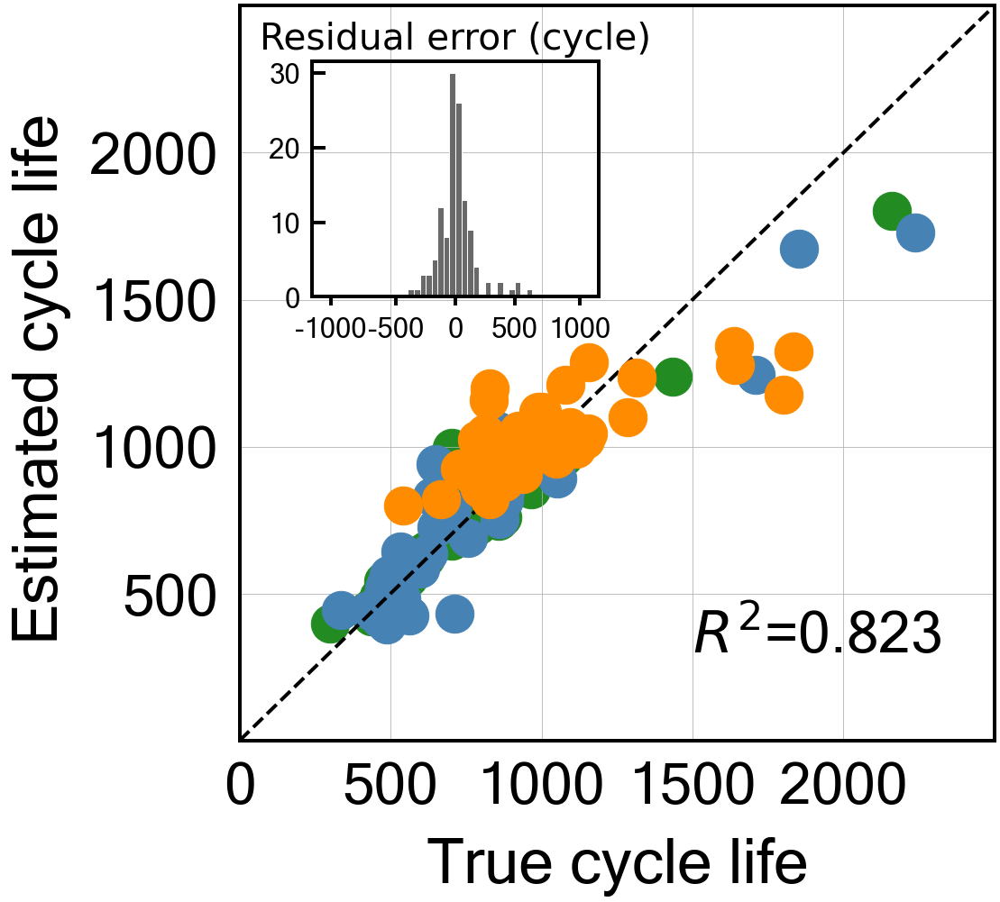


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 3.9
Best score obtained was: 0.49441273399657726
Cycle no: Average_2to10
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to10') : 0.11737301007463191
T_Q('Charge', 'Skewness', 'Average_2to10') : -0.024633119855491745
T_Q('Charge', 'Max-Min', 'Average_2to10') : -0.12153395420830226
dTdQ('Charge', 'Maximum', 'Average_2to10') : -0.020087913071413093
dTdQ('Discharge', 'Max-Min', 'Average_2to10') : 0.017337635958780902
nature_dictAvg_charge_time : 0.0949129381991336
nature_dictIR_cycle2 : 0.009142478030738421
nature_dictMinT_2to10 : 0.04580435079510531
nature_dictIntegralT_2to10 : -0.08701501918929645

Intercept: 2.793969897643637
r2-score: 0.857
MAE_all: 101.3
MAE_train: 62.9
MAE_test: 94.0
MAE_2ndTest: 148.2
MAPE_all: 11.5 %
MAPE_train: 8.4 %
MAPE_test: 12.0 %
MAPE_2ndTest: 14.2 %
RMSE_all: 155.5
RMSE_train: 102.8
RMSE_test: 146.2
RMSE_2ndTest: 202.7
RMSP

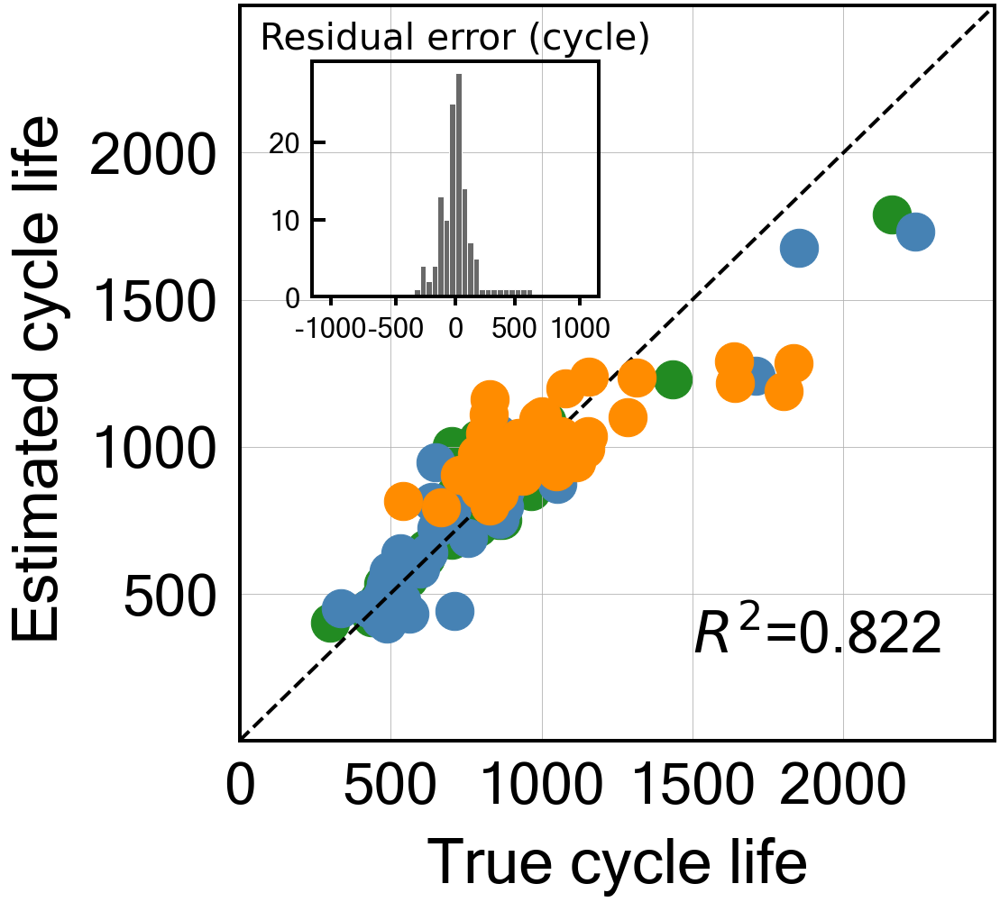


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: 0.5160087491166809
Cycle no: Average_2to11
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to11') : 0.1081399596171724
T_Q('Charge', 'Skewness', 'Average_2to11') : -0.026376876407317465
T_Q('Charge', 'Max-Min', 'Average_2to11') : -0.1204786632121843
dTdQ('Charge', 'Maximum', 'Average_2to11') : -0.023550291781182817
dTdQ('Discharge', 'Max-Min', 'Average_2to11') : 0.02461765409010778
nature_dictAvg_charge_time : 0.09265185692282246
nature_dictIR_cycle2 : 0.010620807175102708
nature_dictMinT_2to11 : 0.0491201595366828
nature_dictIntegralT_2to11 : -0.08524600682285324

Intercept: 2.7939698976436365
r2-score: 0.856
MAE_all: 100.8
MAE_train: 62.9
MAE_test: 94.0
MAE_2ndTest: 146.9
MAPE_all: 11.5 %
MAPE_train: 8.2 %
MAPE_test: 11.9 %
MAPE_2ndTest: 14.4 %
RMSE_all: 155.1
RMSE_train: 105.1
RMSE_test: 149.0
RMSE_2ndTest: 198.4
RMSPE_a

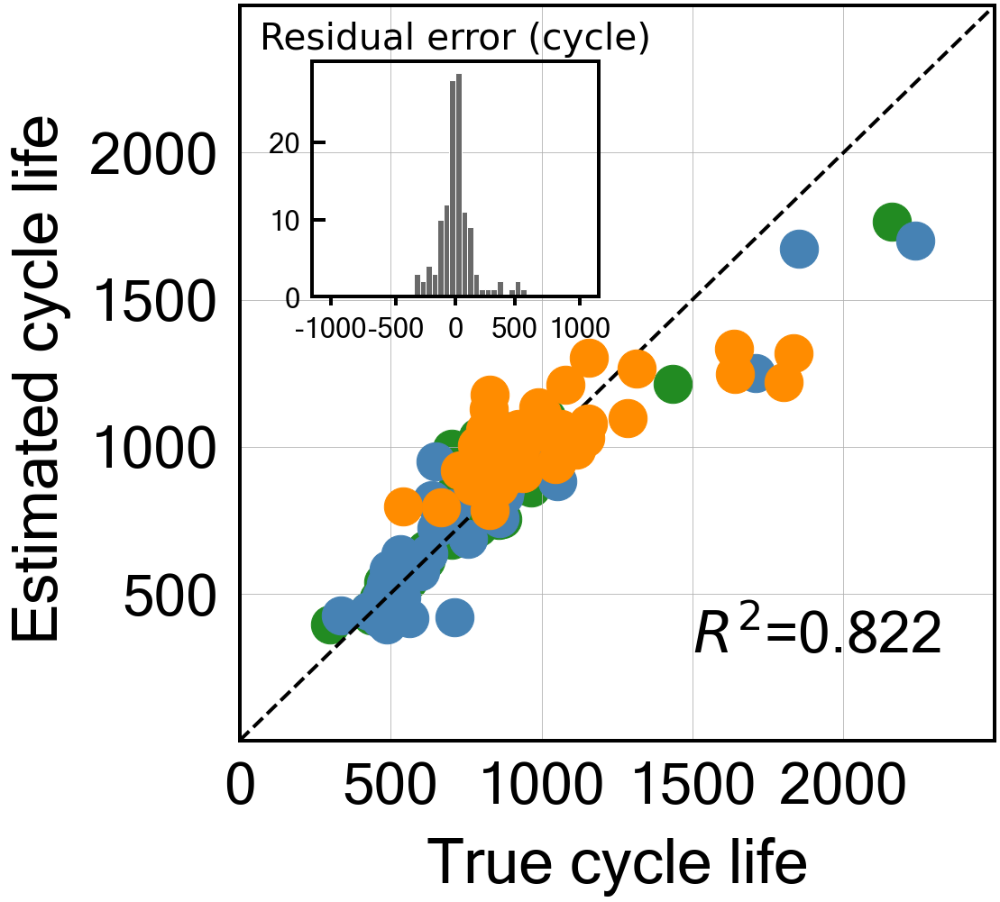


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: 0.15486246149905192
Cycle no: Average_2to12
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to12') : -0.0
T_Q('Charge', 'Skewness', 'Average_2to12') : -0.0
T_Q('Charge', 'Max-Min', 'Average_2to12') : -0.012312941837183879
dTdQ('Charge', 'Maximum', 'Average_2to12') : -0.03229623871973607
dTdQ('Discharge', 'Max-Min', 'Average_2to12') : 0.0
nature_dictAvg_charge_time : 0.08956443645856121
nature_dictIR_cycle2 : -0.04563097656841722
nature_dictMinT_2to12 : 0.03689801697611839
nature_dictIntegralT_2to12 : -0.0

Intercept: 2.793969897643637
r2-score: 0.718
MAE_all: 129.7
MAE_train: 82.2
MAE_test: 123.0
MAE_2ndTest: 185.6
MAPE_all: 15.3 %
MAPE_train: 11.1 %
MAPE_test: 15.2 %
MAPE_2ndTest: 19.6 %
RMSE_all: 201.6
RMSE_train: 136.0
RMSE_test: 188.6
RMSE_2ndTest: 262.1
RMSPE_all: 23.6 %
RMSPE_train: 15.7 %
RMSPE_test: 20.3 %
RMSPE_2nd

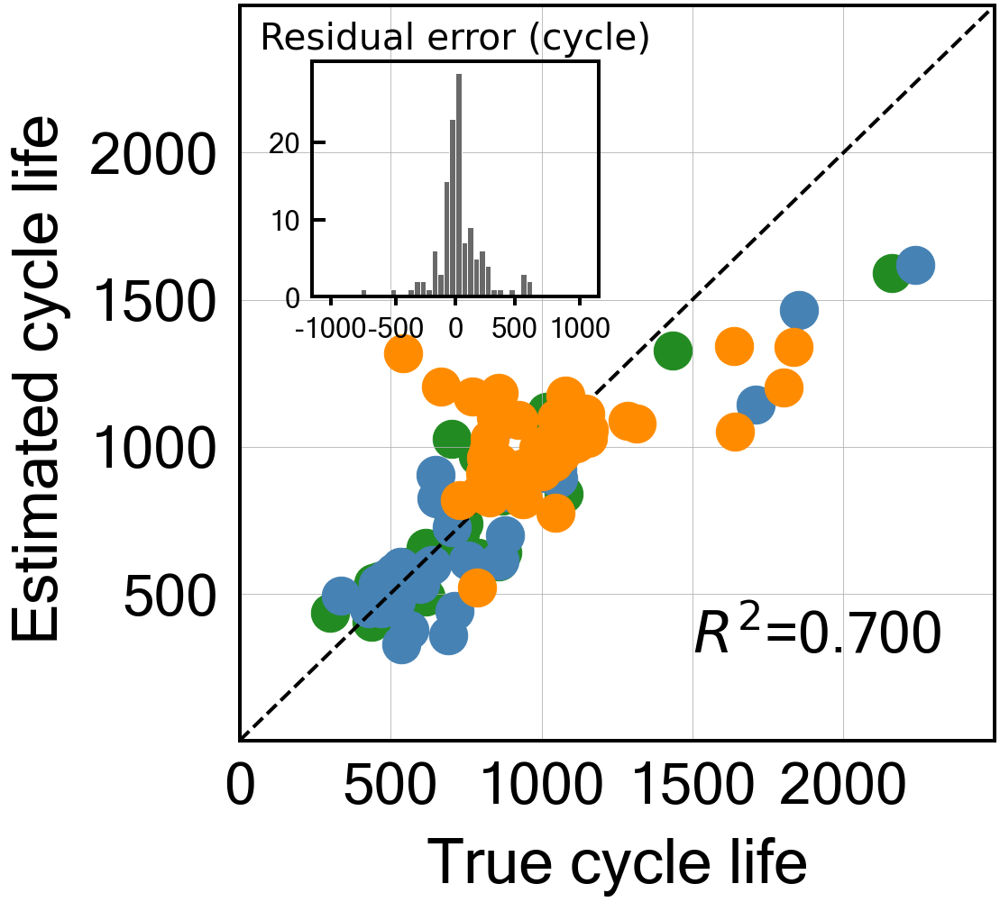


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.0
Best score obtained was: 0.23468738681970158
Cycle no: Average_2to13
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to13') : -0.0
T_Q('Charge', 'Skewness', 'Average_2to13') : -0.0
T_Q('Charge', 'Max-Min', 'Average_2to13') : -0.03781383901988285
dTdQ('Charge', 'Maximum', 'Average_2to13') : -0.03315591356777889
dTdQ('Discharge', 'Max-Min', 'Average_2to13') : 0.016466055873813727
nature_dictAvg_charge_time : 0.07419252117149945
nature_dictIR_cycle2 : -0.03920996096679674
nature_dictMinT_2to13 : 0.04180615533400691
nature_dictIntegralT_2to13 : 0.015780908918254757

Intercept: 2.7939698976436373
r2-score: 0.752
MAE_all: 122.3
MAE_train: 75.8
MAE_test: 117.8
MAE_2ndTest: 174.8
MAPE_all: 14.4 %
MAPE_train: 10.3 %
MAPE_test: 14.9 %
MAPE_2ndTest: 18.0 %
RMSE_all: 189.8
RMSE_train: 128.1
RMSE_test: 173.8
RMSE_2ndTest: 249.4
RMSPE_all: 21.2 %
RMSPE_train: 14

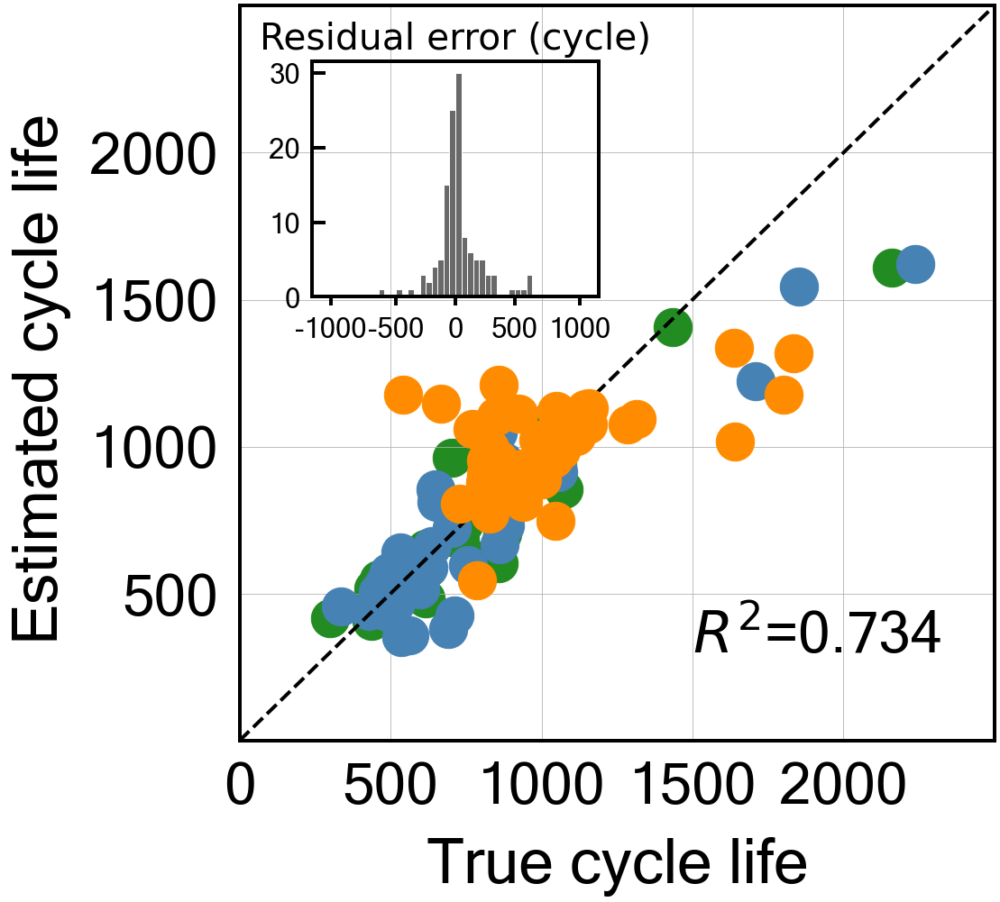


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.0
Best score obtained was: 0.19589123943901976
Cycle no: Average_2to14
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to14') : -0.0
T_Q('Charge', 'Skewness', 'Average_2to14') : -0.0
T_Q('Charge', 'Max-Min', 'Average_2to14') : -0.031852575775453085
dTdQ('Charge', 'Maximum', 'Average_2to14') : -0.029903453206470417
dTdQ('Discharge', 'Max-Min', 'Average_2to14') : 0.010743442586474094
nature_dictAvg_charge_time : 0.07703304499358482
nature_dictIR_cycle2 : -0.040642082192883816
nature_dictMinT_2to14 : 0.03781774959244347
nature_dictIntegralT_2to14 : 0.013304013186993296

Intercept: 2.793969897643637
r2-score: 0.743
MAE_all: 125.5
MAE_train: 77.0
MAE_test: 119.0
MAE_2ndTest: 182.0
MAPE_all: 14.5 %
MAPE_train: 10.4 %
MAPE_test: 14.8 %
MAPE_2ndTest: 18.5 %
RMSE_all: 195.4
RMSE_train: 130.9
RMSE_test: 181.1
RMSE_2ndTest: 255.7
RMSPE_all: 21.4 %
RMSPE_train: 

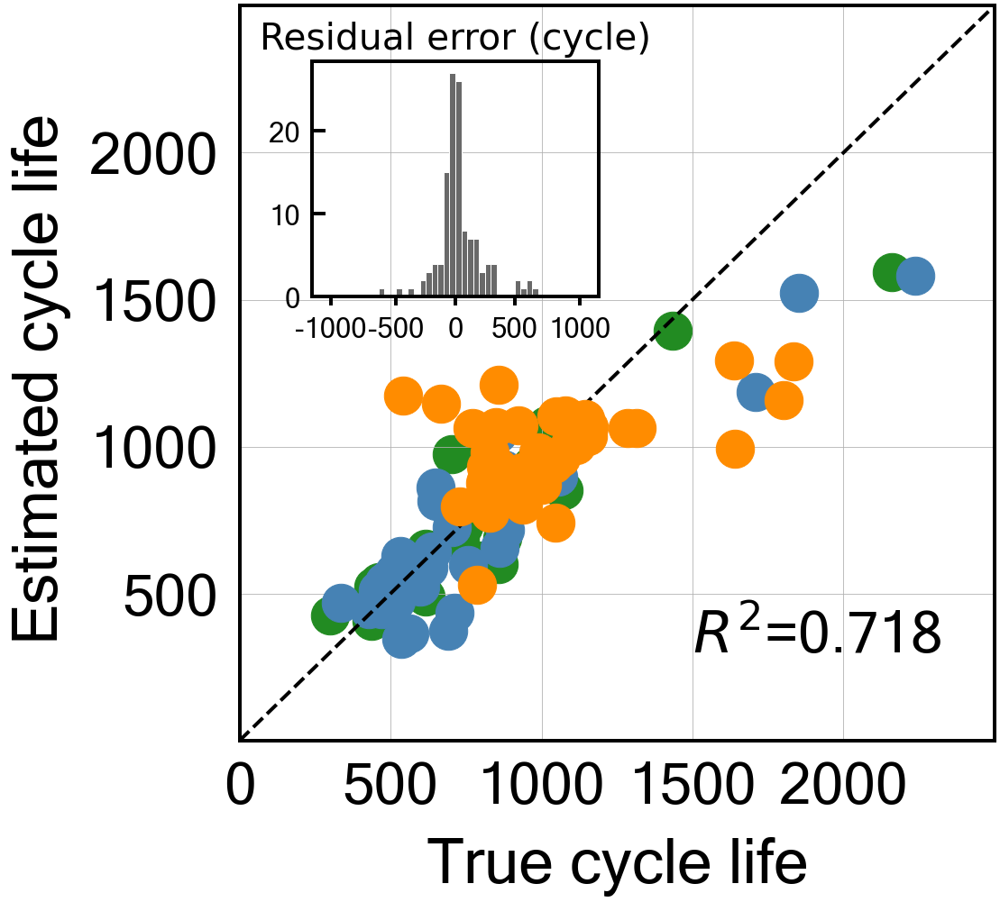


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: 0.14834194273453472
Cycle no: Average_2to15
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to15') : -0.0
T_Q('Charge', 'Skewness', 'Average_2to15') : 0.0
T_Q('Charge', 'Max-Min', 'Average_2to15') : -0.027864686297698886
dTdQ('Charge', 'Maximum', 'Average_2to15') : -0.02562465411729948
dTdQ('Discharge', 'Max-Min', 'Average_2to15') : 0.004577579645512623
nature_dictAvg_charge_time : 0.08053368340598177
nature_dictIR_cycle2 : -0.04322411922810595
nature_dictMinT_2to15 : 0.03415620600091821
nature_dictIntegralT_2to15 : 0.011822853878515708

Intercept: 2.793969897643637
r2-score: 0.728
MAE_all: 129.8
MAE_train: 80.3
MAE_test: 120.9
MAE_2ndTest: 189.9
MAPE_all: 14.9 %
MAPE_train: 10.8 %
MAPE_test: 14.9 %
MAPE_2ndTest: 19.2 %
RMSE_all: 202.2
RMSE_train: 136.8
RMSE_test: 188.5
RMSE_2ndTest: 263.1
RMSPE_all: 22.1 %
RMSPE_train: 15.

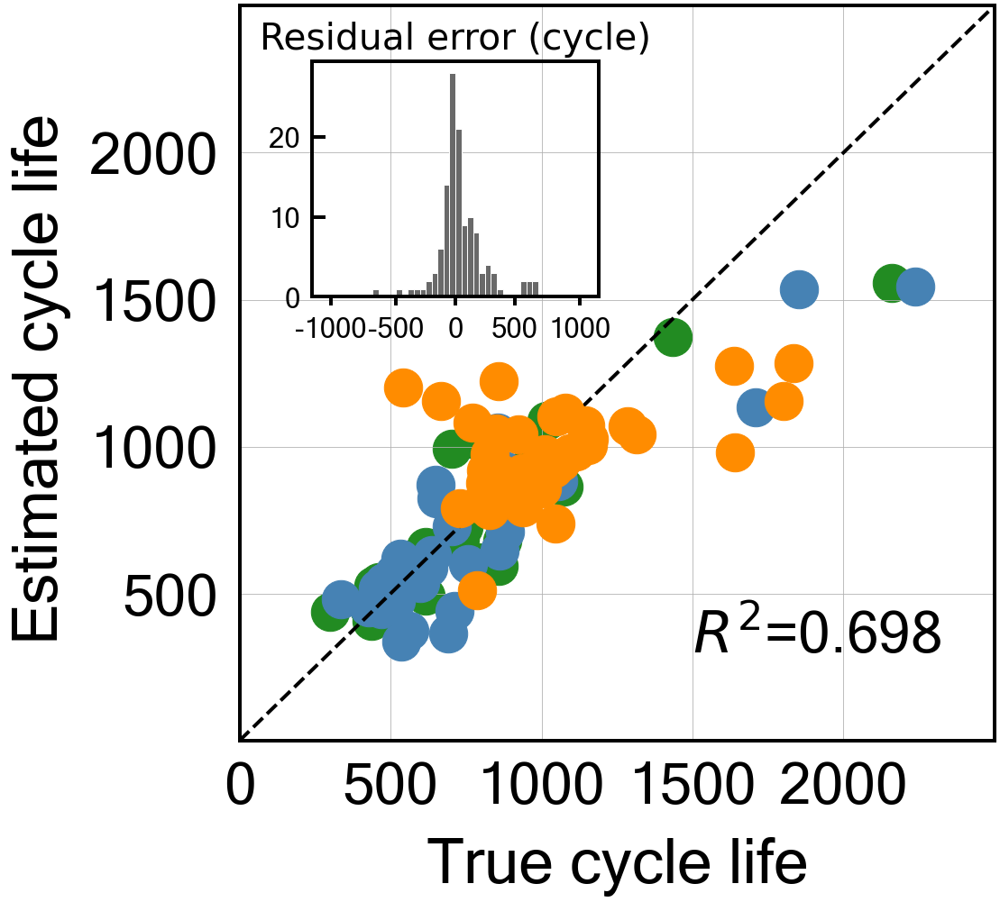


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: 0.15694529397894663
Cycle no: Average_2to16
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to16') : -0.0
T_Q('Charge', 'Skewness', 'Average_2to16') : 0.0
T_Q('Charge', 'Max-Min', 'Average_2to16') : -0.02445176198663653
dTdQ('Charge', 'Maximum', 'Average_2to16') : -0.026734165407844828
dTdQ('Discharge', 'Max-Min', 'Average_2to16') : 0.0026177109501285918
nature_dictAvg_charge_time : 0.08271598253064845
nature_dictIR_cycle2 : -0.045328478897820185
nature_dictMinT_2to16 : 0.03244087435126591
nature_dictIntegralT_2to16 : 0.010101011190166733

Intercept: 2.793969897643637
r2-score: 0.725
MAE_all: 128.8
MAE_train: 80.2
MAE_test: 120.3
MAE_2ndTest: 187.6
MAPE_all: 14.9 %
MAPE_train: 10.9 %
MAPE_test: 14.8 %
MAPE_2ndTest: 19.3 %
RMSE_all: 201.3
RMSE_train: 136.4
RMSE_test: 187.7
RMSE_2ndTest: 261.8
RMSPE_all: 22.5 %
RMSPE_train: 1

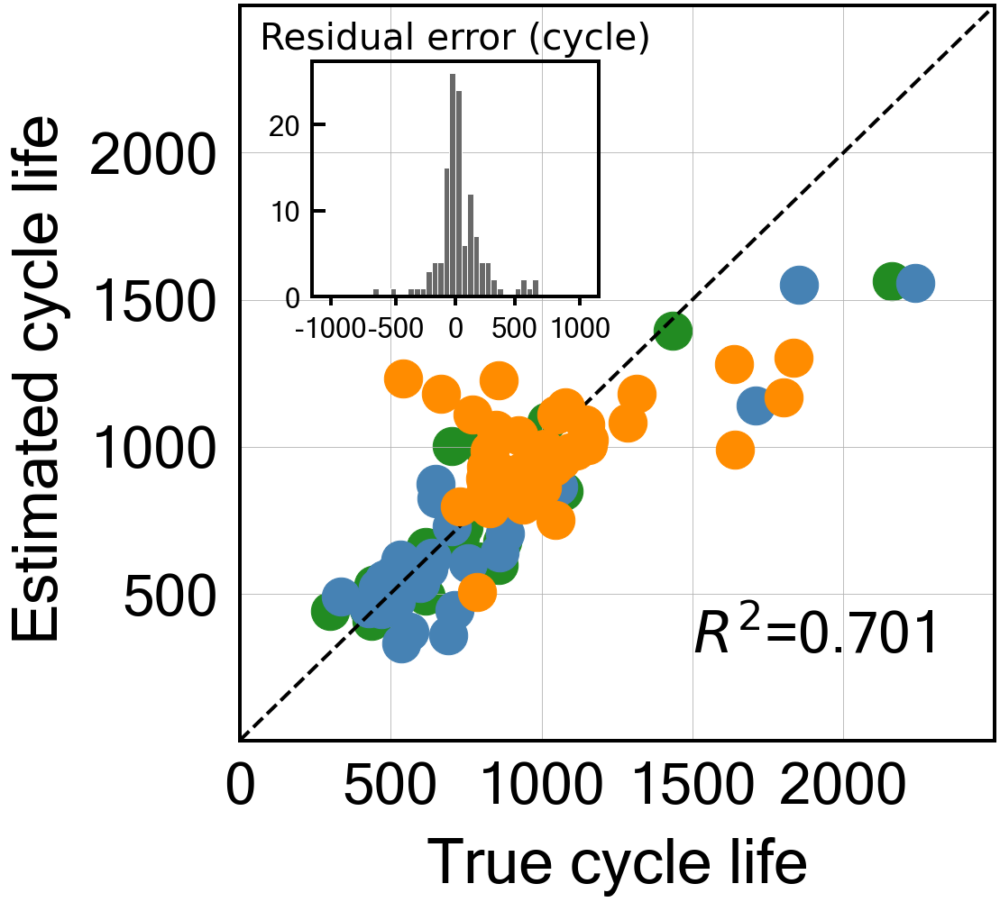


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: 0.12558441021515931
Cycle no: Average_2to17
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to17') : -0.0
T_Q('Charge', 'Skewness', 'Average_2to17') : -0.0
T_Q('Charge', 'Max-Min', 'Average_2to17') : -0.02286849574805691
dTdQ('Charge', 'Maximum', 'Average_2to17') : -0.02505093248156537
dTdQ('Discharge', 'Max-Min', 'Average_2to17') : 0.002301545612426064
nature_dictAvg_charge_time : 0.08416802737329095
nature_dictIR_cycle2 : -0.046894872007488514
nature_dictMinT_2to17 : 0.028979670544874023
nature_dictIntegralT_2to17 : 0.00867147592758818

Intercept: 2.793969897643637
r2-score: 0.716
MAE_all: 131.0
MAE_train: 81.4
MAE_test: 120.9
MAE_2ndTest: 192.5
MAPE_all: 15.1 %
MAPE_train: 11.0 %
MAPE_test: 14.9 %
MAPE_2ndTest: 19.5 %
RMSE_all: 205.5
RMSE_train: 140.7
RMSE_test: 191.6
RMSE_2ndTest: 266.6
RMSPE_all: 22.7 %
RMSPE_train: 15

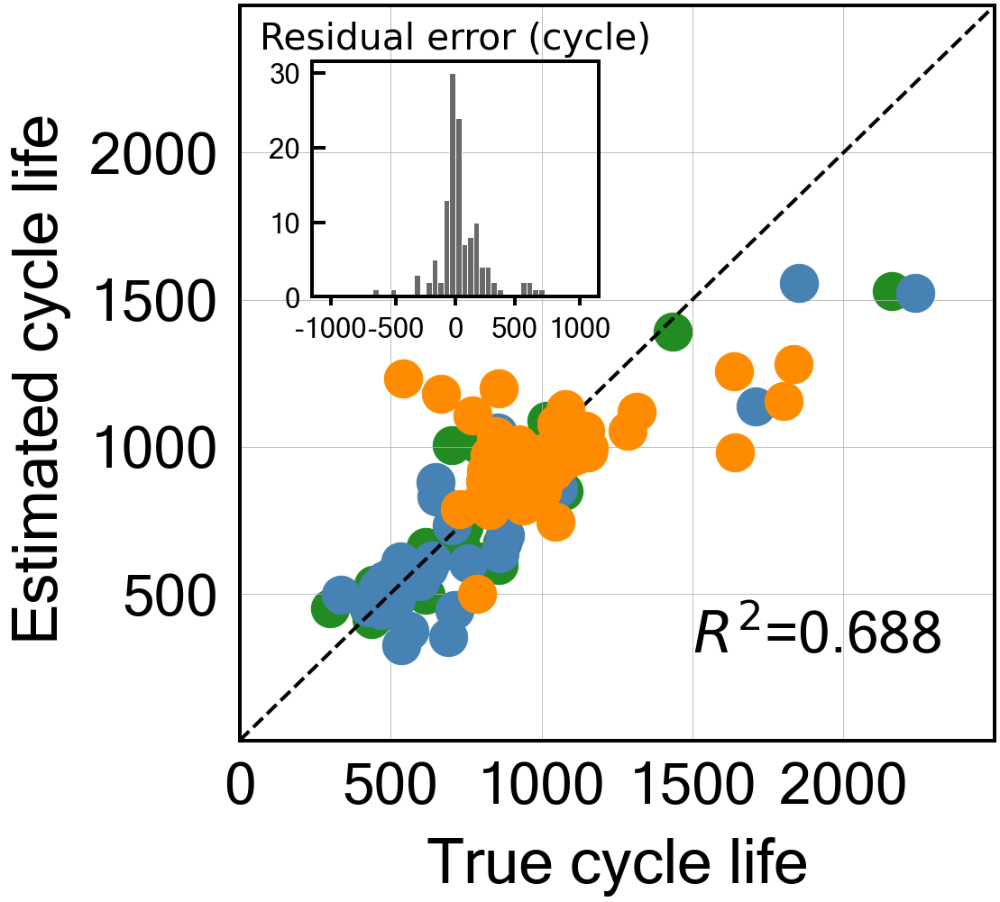


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.0
Best score obtained was: 0.08030394325985957
Cycle no: Average_2to18
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to18') : -0.0
T_Q('Charge', 'Skewness', 'Average_2to18') : 0.0
T_Q('Charge', 'Max-Min', 'Average_2to18') : -0.01996130578382991
dTdQ('Charge', 'Maximum', 'Average_2to18') : -0.022879512519610727
dTdQ('Discharge', 'Max-Min', 'Average_2to18') : 0.0
nature_dictAvg_charge_time : 0.0857004517265452
nature_dictIR_cycle2 : -0.048288366389248376
nature_dictMinT_2to18 : 0.02635159585343214
nature_dictIntegralT_2to18 : 0.0065750606889021035

Intercept: 2.793969897643637
r2-score: 0.705
MAE_all: 134.3
MAE_train: 83.1
MAE_test: 123.5
MAE_2ndTest: 198.1
MAPE_all: 15.4 %
MAPE_train: 11.2 %
MAPE_test: 15.2 %
MAPE_2ndTest: 20.0 %
RMSE_all: 210.1
RMSE_train: 142.8
RMSE_test: 195.5
RMSE_2ndTest: 273.4
RMSPE_all: 23.1 %
RMSPE_train: 16.2 %
RMSPE_test: 

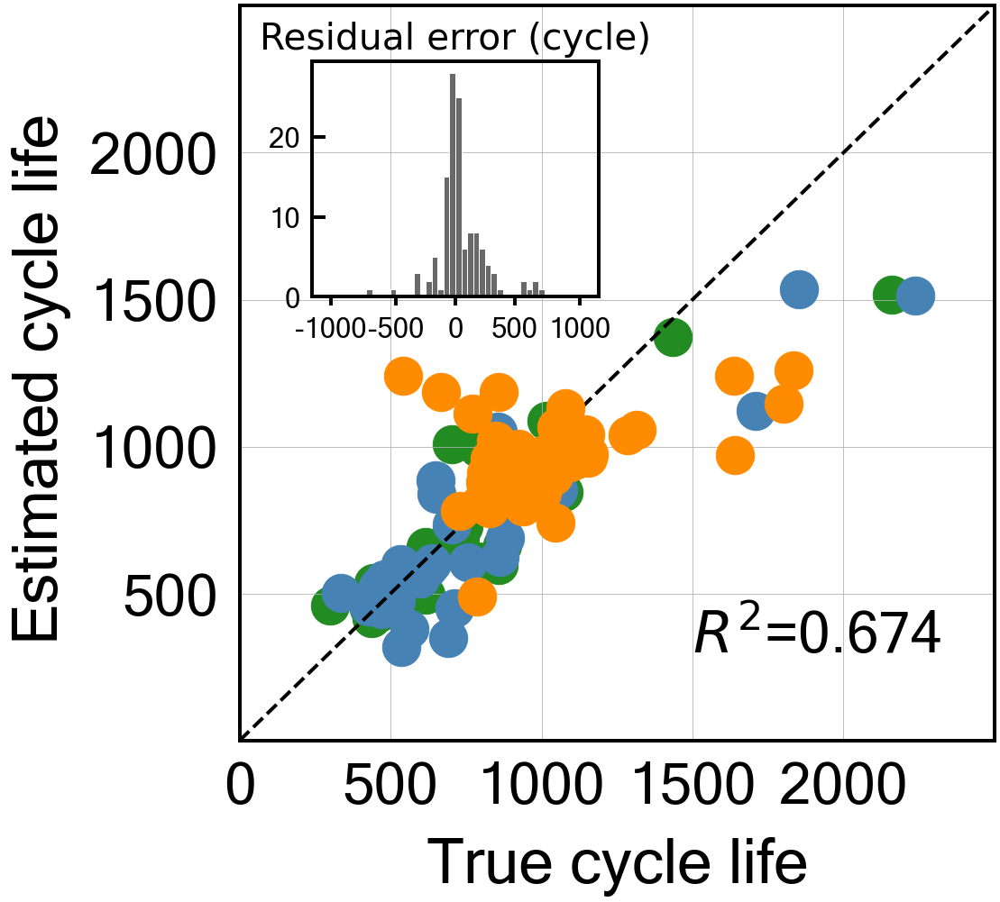


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: 0.01386651512326631
Cycle no: Average_2to19
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to19') : -0.0
T_Q('Charge', 'Skewness', 'Average_2to19') : 0.0
T_Q('Charge', 'Max-Min', 'Average_2to19') : -0.017585461962104535
dTdQ('Charge', 'Maximum', 'Average_2to19') : -0.020467562638460318
dTdQ('Discharge', 'Max-Min', 'Average_2to19') : 0.0
nature_dictAvg_charge_time : 0.08691121819632072
nature_dictIR_cycle2 : -0.050101378562403154
nature_dictMinT_2to19 : 0.02128928709740202
nature_dictIntegralT_2to19 : 0.0038085374513754907

Intercept: 2.7939698976436373
r2-score: 0.688
MAE_all: 138.5
MAE_train: 84.9
MAE_test: 126.7
MAE_2ndTest: 205.9
MAPE_all: 15.7 %
MAPE_train: 11.4 %
MAPE_test: 15.5 %
MAPE_2ndTest: 20.4 %
RMSE_all: 216.9
RMSE_train: 146.7
RMSE_test: 201.0
RMSE_2ndTest: 283.1
RMSPE_all: 23.5 %
RMSPE_train: 16.7 %
RMSPE_tes

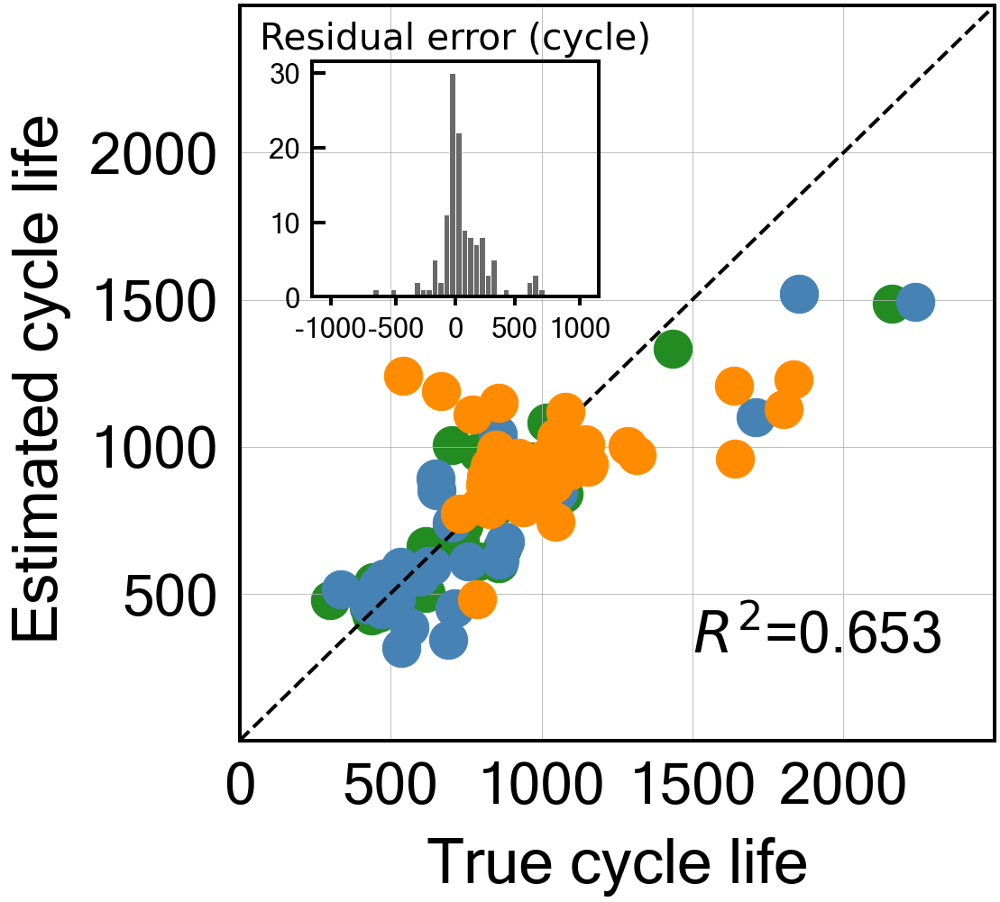


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: -0.027114890567916827
Cycle no: Average_2to20
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to20') : -0.0
T_Q('Charge', 'Skewness', 'Average_2to20') : 0.0
T_Q('Charge', 'Max-Min', 'Average_2to20') : -0.01733595835035145
dTdQ('Charge', 'Maximum', 'Average_2to20') : -0.019144862058497417
dTdQ('Discharge', 'Max-Min', 'Average_2to20') : 0.0
nature_dictAvg_charge_time : 0.08600417275280008
nature_dictIR_cycle2 : -0.05010421698988447
nature_dictMinT_2to20 : 0.01855055555927493
nature_dictIntegralT_2to20 : 0.0016106967859382836

Intercept: 2.793969897643637
r2-score: 0.679
MAE_all: 141.1
MAE_train: 85.7
MAE_test: 129.2
MAE_2ndTest: 210.4
MAPE_all: 15.9 %
MAPE_train: 11.5 %
MAPE_test: 15.6 %
MAPE_2ndTest: 20.6 %
RMSE_all: 221.8
RMSE_train: 149.8
RMSE_test: 206.6
RMSE_2ndTest: 289.0
RMSPE_all: 23.6 %
RMSPE_train: 17.0 %
RMSPE_test

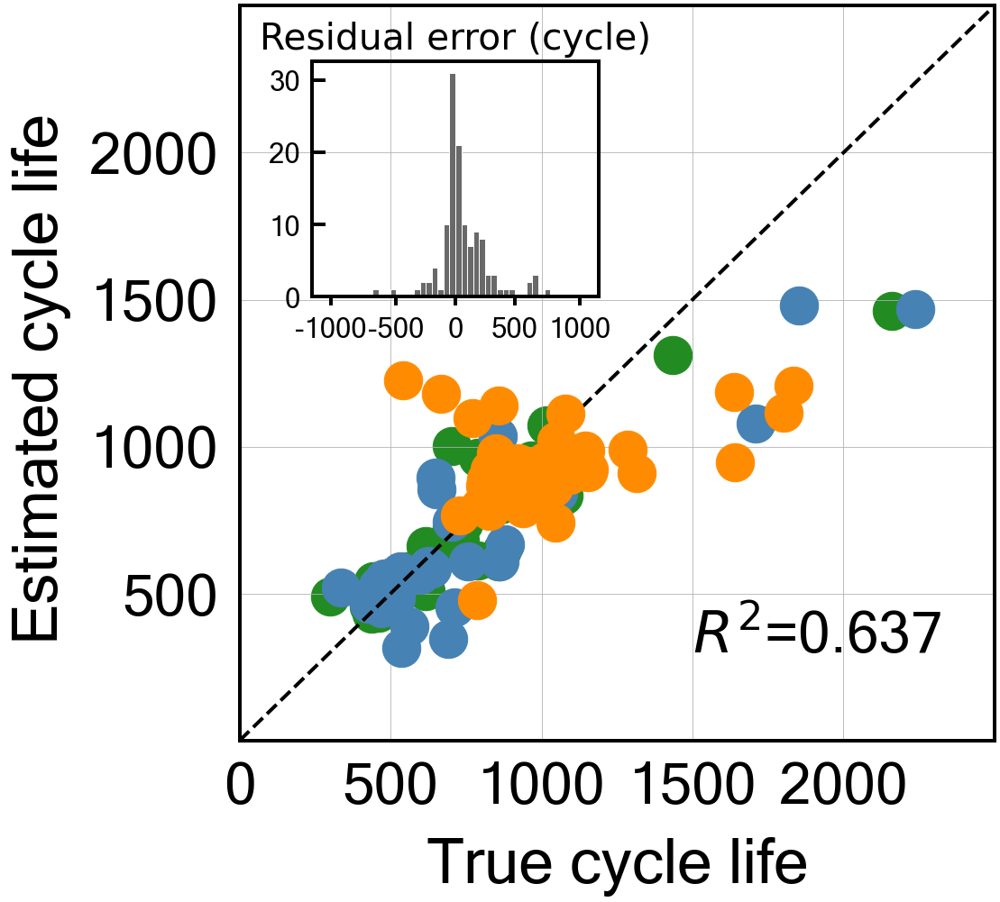


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.0
Best score obtained was: -0.03303256632891394
Cycle no: Average_2to21
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to21') : -0.0
T_Q('Charge', 'Skewness', 'Average_2to21') : 0.0
T_Q('Charge', 'Max-Min', 'Average_2to21') : -0.01608298133576616
dTdQ('Charge', 'Maximum', 'Average_2to21') : -0.01924067415710723
dTdQ('Discharge', 'Max-Min', 'Average_2to21') : 0.0
nature_dictAvg_charge_time : 0.08668296582505894
nature_dictIR_cycle2 : -0.050099110910460924
nature_dictMinT_2to21 : 0.01810893918194656
nature_dictIntegralT_2to21 : 0.0

Intercept: 2.793969897643637
r2-score: 0.677
MAE_all: 141.8
MAE_train: 86.3
MAE_test: 130.0
MAE_2ndTest: 211.1
MAPE_all: 15.9 %
MAPE_train: 11.6 %
MAPE_test: 15.7 %
MAPE_2ndTest: 20.7 %
RMSE_all: 222.9
RMSE_train: 150.6
RMSE_test: 208.4
RMSE_2ndTest: 289.8
RMSPE_all: 23.7 %
RMSPE_train: 17.0 %
RMSPE_test: 21.3 %
RMSPE_2ndT

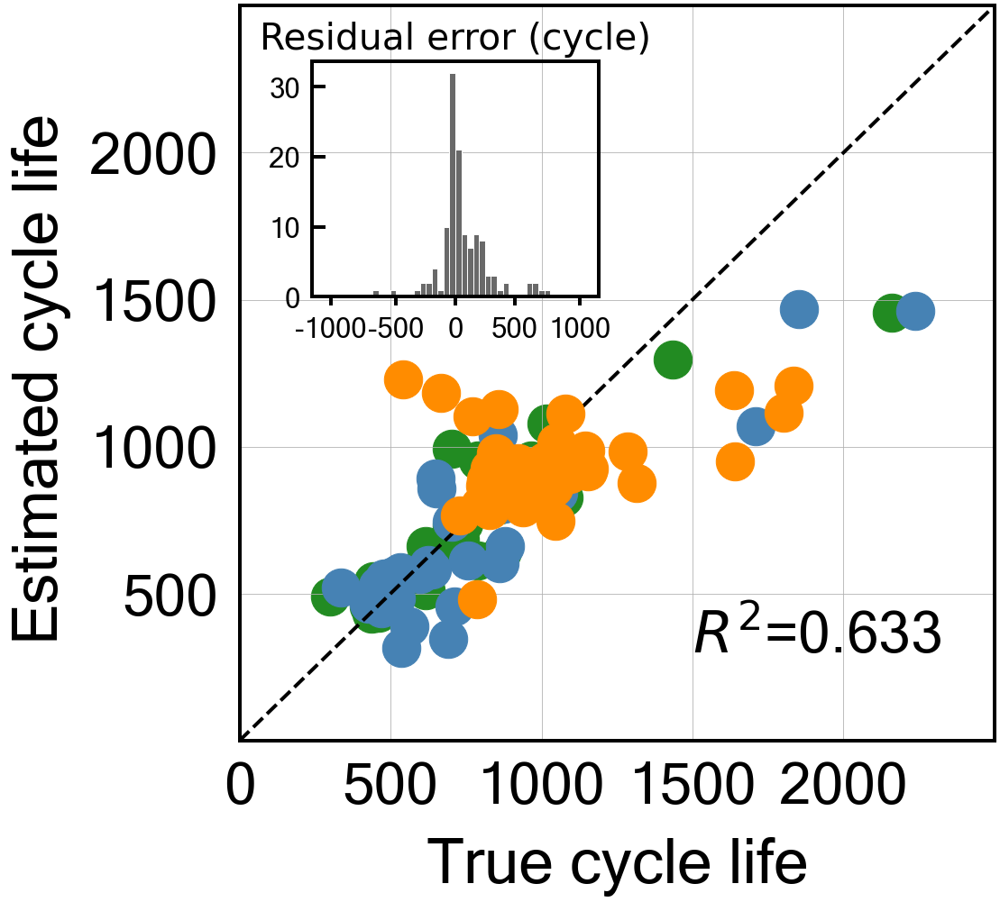


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: -0.11916539466663867
Cycle no: Average_2to22
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to22') : -0.0
T_Q('Charge', 'Skewness', 'Average_2to22') : 0.0
T_Q('Charge', 'Max-Min', 'Average_2to22') : -0.01136786076943289
dTdQ('Charge', 'Maximum', 'Average_2to22') : -0.017500119248266423
dTdQ('Discharge', 'Max-Min', 'Average_2to22') : 0.0
nature_dictAvg_charge_time : 0.08835100612869042
nature_dictIR_cycle2 : -0.051010968647228275
nature_dictMinT_2to22 : 0.01499779948500026
nature_dictIntegralT_2to22 : 0.0

Intercept: 2.793969897643637
r2-score: 0.658
MAE_all: 146.8
MAE_train: 88.7
MAE_test: 133.1
MAE_2ndTest: 220.8
MAPE_all: 16.4 %
MAPE_train: 11.9 %
MAPE_test: 16.1 %
MAPE_2ndTest: 21.3 %
RMSE_all: 229.4
RMSE_train: 152.9
RMSE_test: 211.2
RMSE_2ndTest: 301.6
RMSPE_all: 24.0 %
RMSPE_train: 17.5 %
RMSPE_test: 21.8 %
RMSPE_2nd

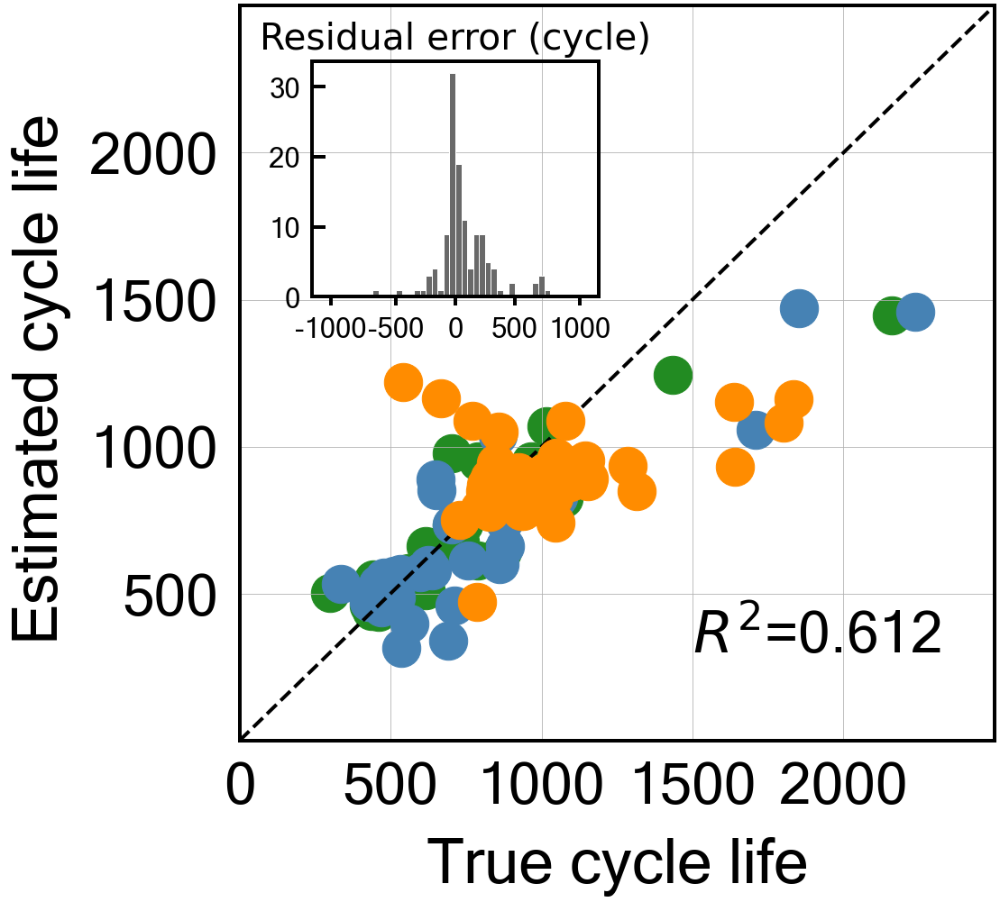


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: -0.3730837333514063
Cycle no: Average_2to23
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to23') : -0.0
T_Q('Charge', 'Skewness', 'Average_2to23') : 0.0
T_Q('Charge', 'Max-Min', 'Average_2to23') : -0.011478190305849468
dTdQ('Charge', 'Maximum', 'Average_2to23') : -0.009017976486784209
dTdQ('Discharge', 'Max-Min', 'Average_2to23') : -0.0
nature_dictAvg_charge_time : 0.08613127326555836
nature_dictIR_cycle2 : -0.05085148483125566
nature_dictMinT_2to23 : 0.006980489609302791
nature_dictIntegralT_2to23 : 0.0

Intercept: 2.7939698976436373
r2-score: 0.602
MAE_all: 161.7
MAE_train: 93.6
MAE_test: 139.3
MAE_2ndTest: 254.9
MAPE_all: 17.6 %
MAPE_train: 12.5 %
MAPE_test: 16.7 %
MAPE_2ndTest: 23.9 %
RMSE_all: 249.3
RMSE_train: 163.0
RMSE_test: 223.2
RMSE_2ndTest: 334.1
RMSPE_all: 24.7 %
RMSPE_train: 18.6 %
RMSPE_test: 22.5 %
RMSPE_2

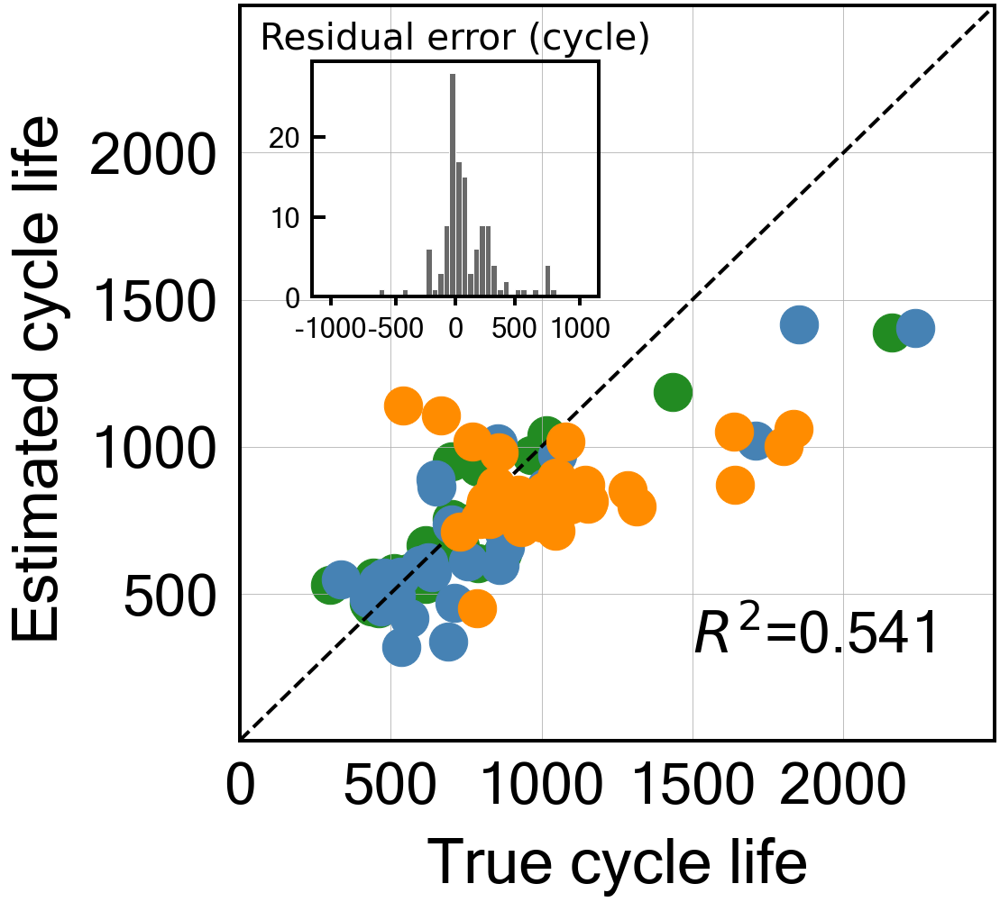


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.0
Best score obtained was: -0.5394405095668908
Cycle no: Average_2to24
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to24') : -0.0
T_Q('Charge', 'Skewness', 'Average_2to24') : 0.0
T_Q('Charge', 'Max-Min', 'Average_2to24') : -0.011203926563151834
dTdQ('Charge', 'Maximum', 'Average_2to24') : -0.004801443332467276
dTdQ('Discharge', 'Max-Min', 'Average_2to24') : -0.0
nature_dictAvg_charge_time : 0.08471278467198647
nature_dictIR_cycle2 : -0.050423858788533935
nature_dictMinT_2to24 : 0.002742974761759153
nature_dictIntegralT_2to24 : 0.0

Intercept: 2.7939698976436373
r2-score: 0.563
MAE_all: 171.8
MAE_train: 96.7
MAE_test: 143.4
MAE_2ndTest: 278.4
MAPE_all: 18.6 %
MAPE_train: 13.0 %
MAPE_test: 17.1 %
MAPE_2ndTest: 25.9 %
RMSE_all: 261.3
RMSE_train: 168.9
RMSE_test: 230.1
RMSE_2ndTest: 353.7
RMSPE_all: 25.3 %
RMSPE_train: 19.4 %
RMSPE_test: 22.9 %
RMSPE_

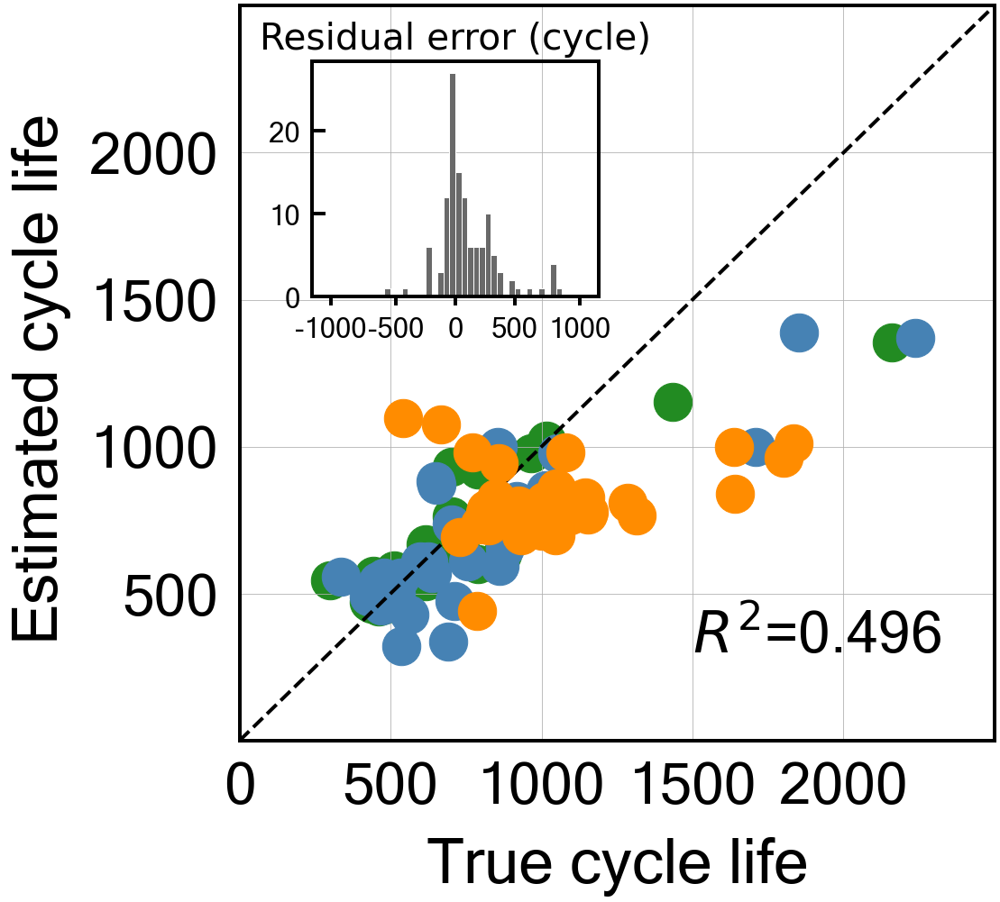


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: 0.07587170163018075
Cycle no: Average_2to25
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to25') : -0.0043799501023125895
T_Q('Charge', 'Skewness', 'Average_2to25') : 0.0
T_Q('Charge', 'Max-Min', 'Average_2to25') : -0.024048361734117965
dTdQ('Charge', 'Maximum', 'Average_2to25') : -0.021466181082904923
dTdQ('Discharge', 'Max-Min', 'Average_2to25') : 0.0
nature_dictAvg_charge_time : 0.07360227327354245
nature_dictIR_cycle2 : -0.04475413792096124
nature_dictMinT_2to25 : 0.028324477204615922
nature_dictIntegralT_2to25 : 0.003140867103055972

Intercept: 2.793969897643637
r2-score: 0.701
MAE_all: 138.2
MAE_train: 86.7
MAE_test: 132.5
MAE_2ndTest: 197.0
MAPE_all: 15.6 %
MAPE_train: 11.5 %
MAPE_test: 15.6 %
MAPE_2ndTest: 20.0 %
RMSE_all: 221.0
RMSE_train: 157.3
RMSE_test: 217.7
RMSE_2ndTest: 274.1
RMSPE_all: 23.2 %
RMSPE_train: 

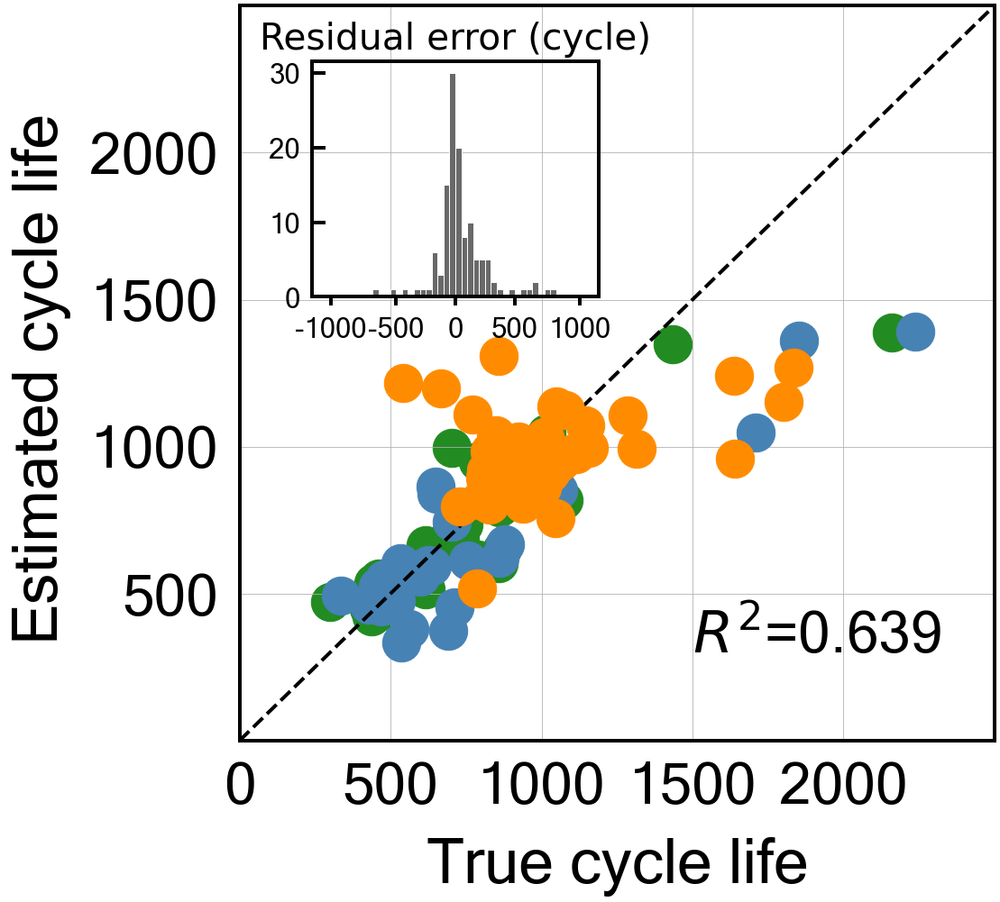


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: 0.16972814332886377
Cycle no: Average_2to26
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to26') : -0.01826796779181706
T_Q('Charge', 'Skewness', 'Average_2to26') : 0.0
T_Q('Charge', 'Max-Min', 'Average_2to26') : -0.02875650474207245
dTdQ('Charge', 'Maximum', 'Average_2to26') : -0.02816374615232147
dTdQ('Discharge', 'Max-Min', 'Average_2to26') : 0.01478146746118556
nature_dictAvg_charge_time : 0.06481440700104432
nature_dictIR_cycle2 : -0.04177141272465159
nature_dictMinT_2to26 : 0.0325401783757271
nature_dictIntegralT_2to26 : 0.0071253289937914886

Intercept: 2.793969897643637
r2-score: 0.721
MAE_all: 132.5
MAE_train: 84.1
MAE_test: 131.8
MAE_2ndTest: 182.8
MAPE_all: 15.2 %
MAPE_train: 11.1 %
MAPE_test: 15.7 %
MAPE_2ndTest: 18.9 %
RMSE_all: 212.0
RMSE_train: 153.4
RMSE_test: 210.6
RMSE_2ndTest: 259.8
RMSPE_all: 22.4 %
RM

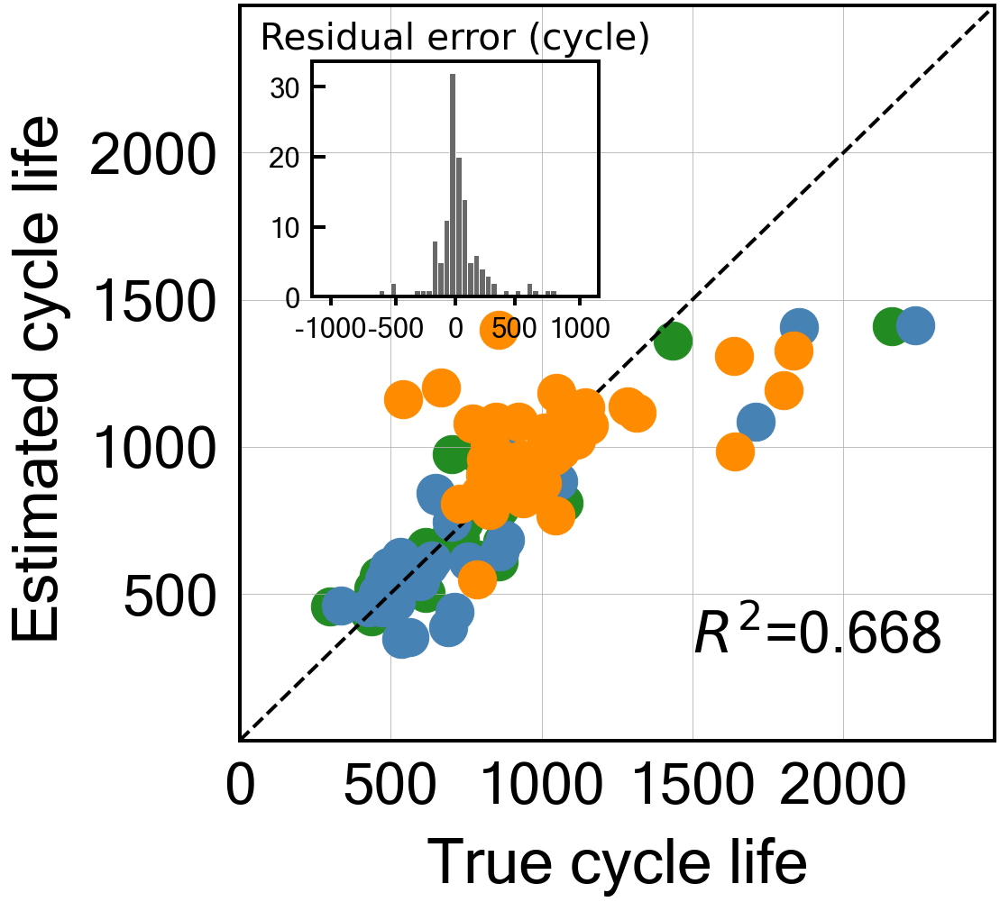


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: 0.16525113842298778
Cycle no: Average_2to27
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to27') : -0.018330794161420798
T_Q('Charge', 'Skewness', 'Average_2to27') : 0.0
T_Q('Charge', 'Max-Min', 'Average_2to27') : -0.028391360654769337
dTdQ('Charge', 'Maximum', 'Average_2to27') : -0.02846729702336755
dTdQ('Discharge', 'Max-Min', 'Average_2to27') : 0.014758963966977642
nature_dictAvg_charge_time : 0.06497884780071539
nature_dictIR_cycle2 : -0.04188386032478506
nature_dictMinT_2to27 : 0.032676568836407446
nature_dictIntegralT_2to27 : 0.006088163595829428

Intercept: 2.793969897643637
r2-score: 0.719
MAE_all: 132.7
MAE_train: 84.2
MAE_test: 132.1
MAE_2ndTest: 183.1
MAPE_all: 15.3 %
MAPE_train: 11.1 %
MAPE_test: 15.8 %
MAPE_2ndTest: 19.1 %
RMSE_all: 212.7
RMSE_train: 153.7
RMSE_test: 211.8
RMSE_2ndTest: 260.5
RMSPE_all: 22.6 

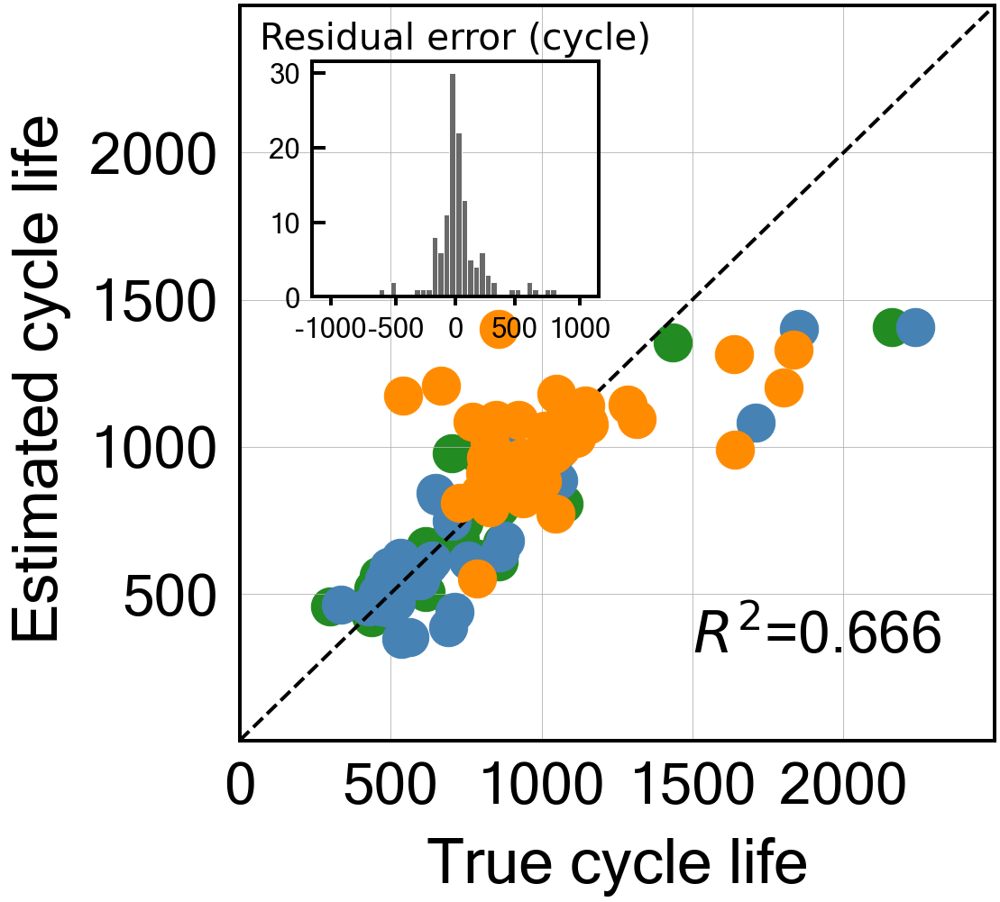


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: 0.1613392421866977
Cycle no: Average_2to28
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to28') : -0.018048486305091194
T_Q('Charge', 'Skewness', 'Average_2to28') : 0.0
T_Q('Charge', 'Max-Min', 'Average_2to28') : -0.028173178531195886
dTdQ('Charge', 'Maximum', 'Average_2to28') : -0.028392529154531623
dTdQ('Discharge', 'Max-Min', 'Average_2to28') : 0.014525000228116404
nature_dictAvg_charge_time : 0.06550502124619864
nature_dictIR_cycle2 : -0.04193917709763113
nature_dictMinT_2to28 : 0.032681794270837096
nature_dictIntegralT_2to28 : 0.00521058339640674

Intercept: 2.793969897643637
r2-score: 0.718
MAE_all: 133.1
MAE_train: 84.4
MAE_test: 132.4
MAE_2ndTest: 183.8
MAPE_all: 15.3 %
MAPE_train: 11.1 %
MAPE_test: 15.7 %
MAPE_2ndTest: 19.2 %
RMSE_all: 213.6
RMSE_train: 154.3
RMSE_test: 213.2
RMSE_2ndTest: 261.1
RMSPE_all: 22.7 %

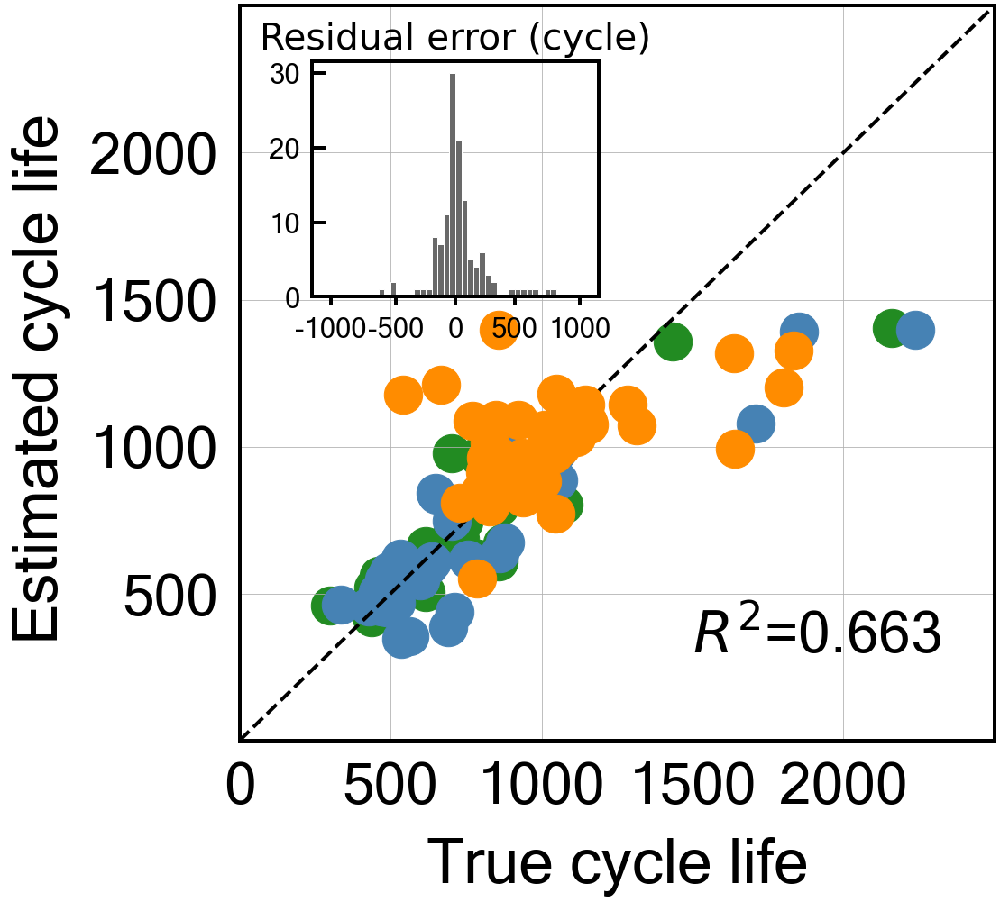


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.3
Best score obtained was: 0.1923628225394176
Cycle no: Average_2to29
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to29') : -0.017216127715628186
T_Q('Charge', 'Skewness', 'Average_2to29') : 0.0
T_Q('Charge', 'Max-Min', 'Average_2to29') : -0.03130384317472065
dTdQ('Charge', 'Maximum', 'Average_2to29') : -0.034552489427500395
dTdQ('Discharge', 'Max-Min', 'Average_2to29') : 0.021497613885471657
nature_dictAvg_charge_time : 0.06870435962165052
nature_dictIR_cycle2 : -0.042987144444425265
nature_dictMinT_2to29 : 0.03401176699823122
nature_dictIntegralT_2to29 : 0.004167345016807641

Intercept: 2.7939698976436373
r2-score: 0.724
MAE_all: 130.4
MAE_train: 82.6
MAE_test: 128.1
MAE_2ndTest: 181.8
MAPE_all: 15.3 %
MAPE_train: 11.0 %
MAPE_test: 15.6 %
MAPE_2ndTest: 19.5 %
RMSE_all: 205.4
RMSE_train: 145.8
RMSE_test: 200.8
RMSE_2ndTest: 256.2
RMSPE_all: 22.9 

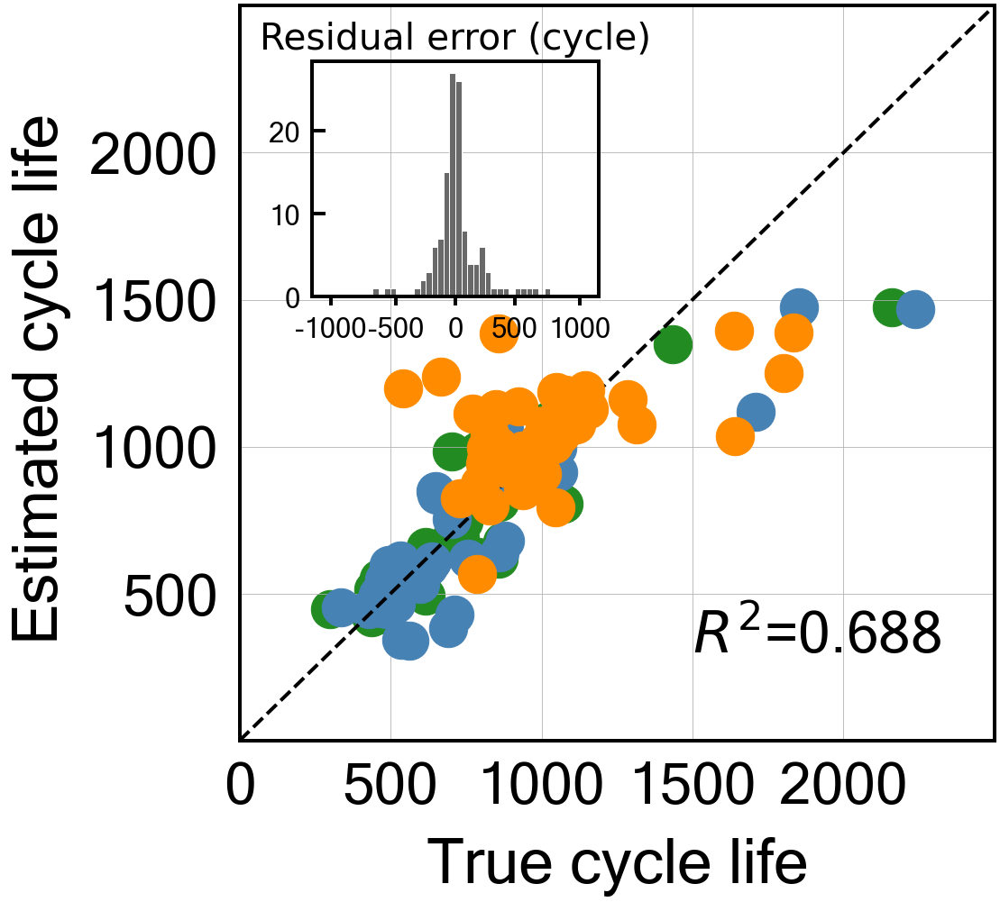


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: 0.1709423962538561
Cycle no: Average_2to30
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to30') : -0.017238024251127925
T_Q('Charge', 'Skewness', 'Average_2to30') : 5.78414421762098e-05
T_Q('Charge', 'Max-Min', 'Average_2to30') : -0.02894507947500304
dTdQ('Charge', 'Maximum', 'Average_2to30') : -0.032761380836845745
dTdQ('Discharge', 'Max-Min', 'Average_2to30') : 0.01761443644501111
nature_dictAvg_charge_time : 0.06857623204429611
nature_dictIR_cycle2 : -0.04282902052505091
nature_dictMinT_2to30 : 0.03380559203243803
nature_dictIntegralT_2to30 : 0.0030948024418655175

Intercept: 2.793969897643637
r2-score: 0.719
MAE_all: 132.4
MAE_train: 83.6
MAE_test: 130.8
MAE_2ndTest: 184.0
MAPE_all: 15.4 %
MAPE_train: 11.1 %
MAPE_test: 15.7 %
MAPE_2ndTest: 19.6 %
RMSE_all: 210.0
RMSE_train: 149.6
RMSE_test: 207.6
RMSE_2ndTest: 259.6
R

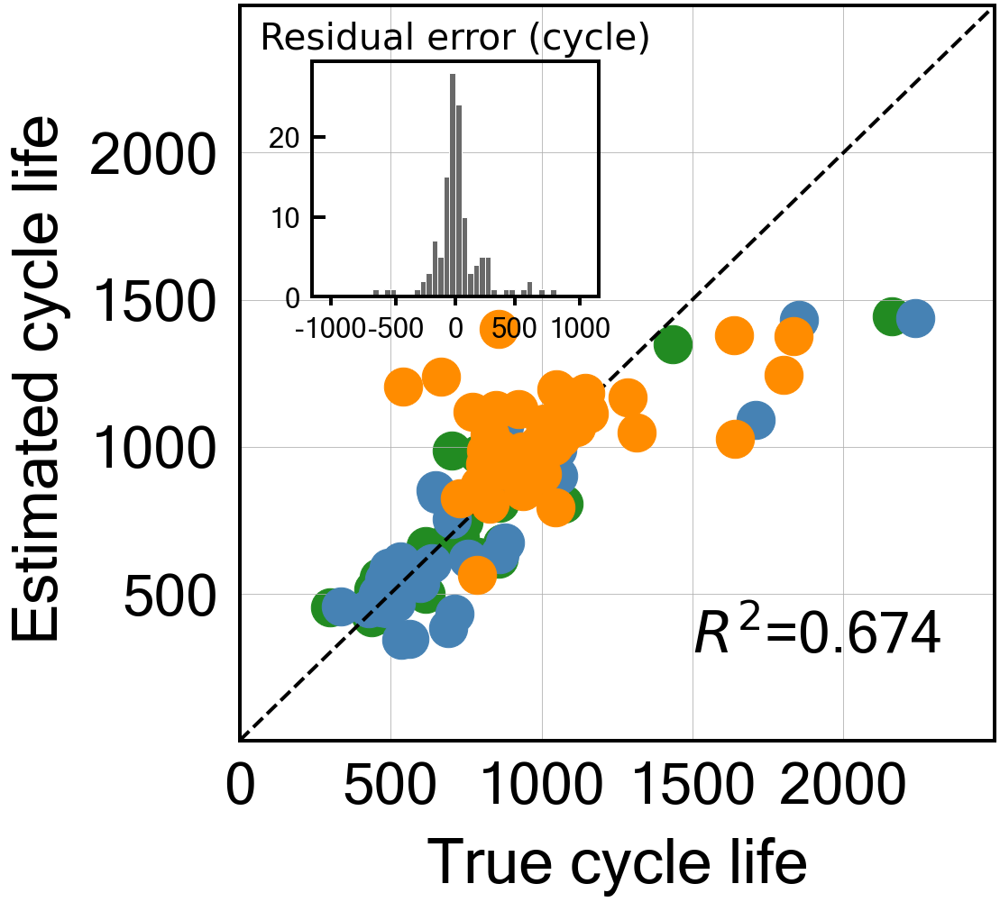


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: 0.16503639586047048
Cycle no: Average_2to31
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to31') : -0.017077425101861762
T_Q('Charge', 'Skewness', 'Average_2to31') : 0.00029619609501383256
T_Q('Charge', 'Max-Min', 'Average_2to31') : -0.02868896258287136
dTdQ('Charge', 'Maximum', 'Average_2to31') : -0.03374597992982694
dTdQ('Discharge', 'Max-Min', 'Average_2to31') : 0.018895010228951396
nature_dictAvg_charge_time : 0.06899364309055878
nature_dictIR_cycle2 : -0.0434700044716598
nature_dictMinT_2to31 : 0.0329760600638967
nature_dictIntegralT_2to31 : 0.002045644977222101

Intercept: 2.793969897643637
r2-score: 0.717
MAE_all: 132.6
MAE_train: 83.7
MAE_test: 130.7
MAE_2ndTest: 184.7
MAPE_all: 15.5 %
MAPE_train: 11.1 %
MAPE_test: 15.7 %
MAPE_2ndTest: 19.8 %
RMSE_all: 210.3
RMSE_train: 149.6
RMSE_test: 207.4
RMSE_2ndTest: 260.5
R

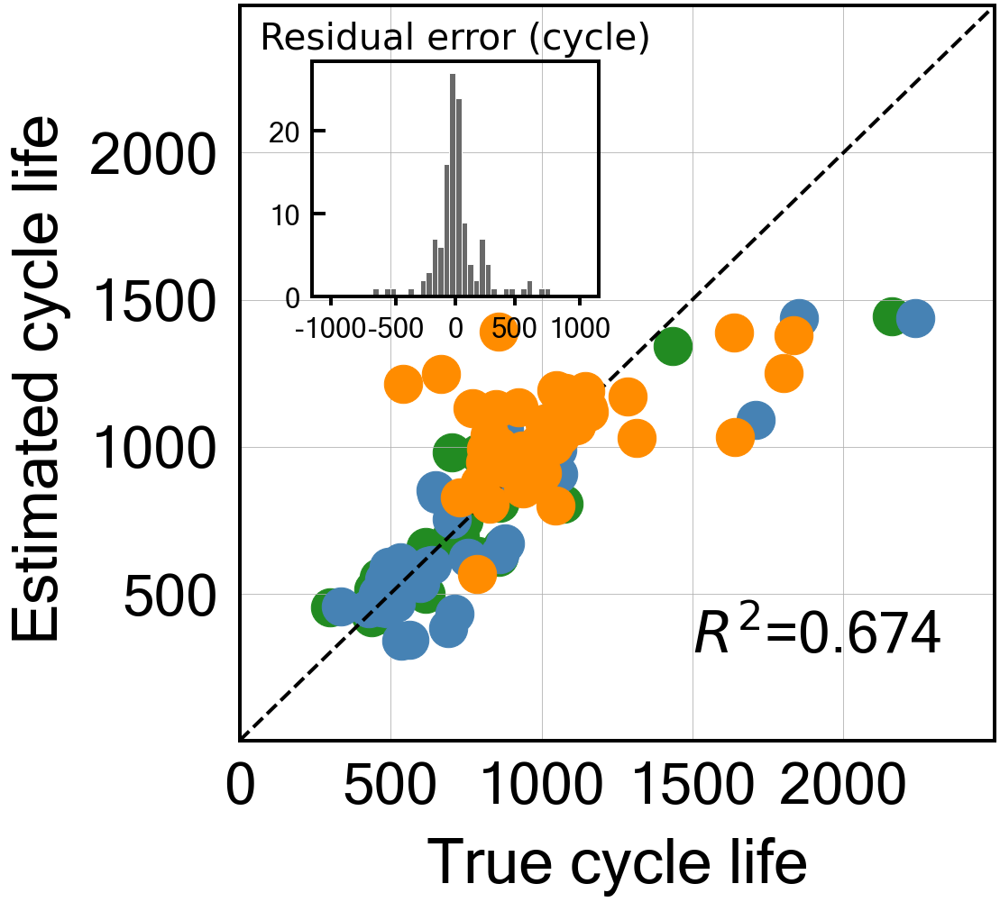


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: 0.1637475531500573
Cycle no: Average_2to32
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to32') : -0.017503352651261676
T_Q('Charge', 'Skewness', 'Average_2to32') : 0.0007565120027213854
T_Q('Charge', 'Max-Min', 'Average_2to32') : -0.028636703485752438
dTdQ('Charge', 'Maximum', 'Average_2to32') : -0.034995000614215455
dTdQ('Discharge', 'Max-Min', 'Average_2to32') : 0.02032871140418071
nature_dictAvg_charge_time : 0.06873948540933277
nature_dictIR_cycle2 : -0.04333167022005047
nature_dictMinT_2to32 : 0.03263902697636372
nature_dictIntegralT_2to32 : 0.0013785189133189732

Intercept: 2.793969897643637
r2-score: 0.717
MAE_all: 132.6
MAE_train: 83.2
MAE_test: 130.6
MAE_2ndTest: 185.3
MAPE_all: 15.5 %
MAPE_train: 11.0 %
MAPE_test: 15.7 %
MAPE_2ndTest: 19.9 %
RMSE_all: 210.3
RMSE_train: 148.7
RMSE_test: 207.7
RMSE_2ndTest: 260.7

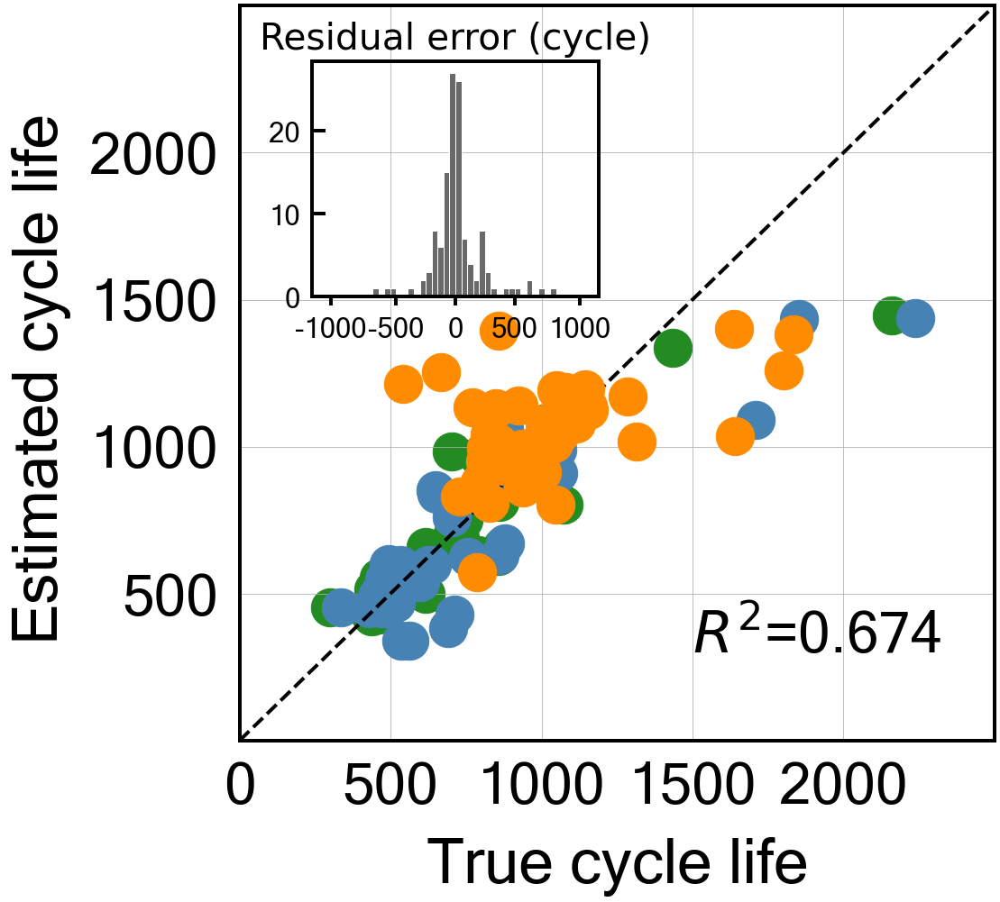


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: 0.1496074675158704
Cycle no: Average_2to33
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to33') : -0.016441706645483247
T_Q('Charge', 'Skewness', 'Average_2to33') : 0.0014995012073590126
T_Q('Charge', 'Max-Min', 'Average_2to33') : -0.03048909469029963
dTdQ('Charge', 'Maximum', 'Average_2to33') : -0.03819065375992285
dTdQ('Discharge', 'Max-Min', 'Average_2to33') : 0.02328845786103344
nature_dictAvg_charge_time : 0.07032398240873117
nature_dictIR_cycle2 : -0.0439573761313693
nature_dictMinT_2to33 : 0.033556989931198225
nature_dictIntegralT_2to33 : 0.0009542312844993321

Intercept: 2.793969897643637
r2-score: 0.715
MAE_all: 132.5
MAE_train: 82.2
MAE_test: 128.0
MAE_2ndTest: 188.8
MAPE_all: 15.6 %
MAPE_train: 10.8 %
MAPE_test: 15.5 %
MAPE_2ndTest: 20.6 %
RMSE_all: 208.5
RMSE_train: 144.9
RMSE_test: 202.5
RMSE_2ndTest: 262.9
R

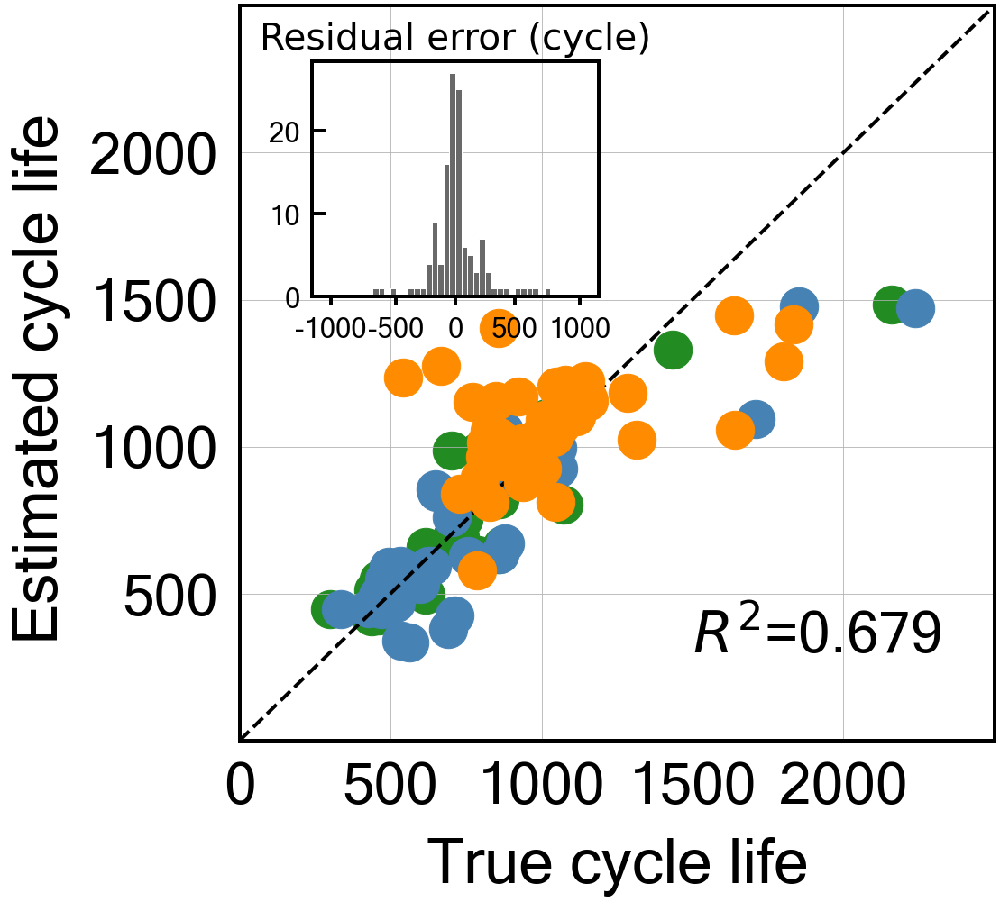


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: 0.11365606058719235
Cycle no: Average_2to34
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to34') : -0.01199533001214647
T_Q('Charge', 'Skewness', 'Average_2to34') : 0.004022089424441905
T_Q('Charge', 'Max-Min', 'Average_2to34') : -0.03809987991181654
dTdQ('Charge', 'Maximum', 'Average_2to34') : -0.04963834386873977
dTdQ('Discharge', 'Max-Min', 'Average_2to34') : 0.03544979630665164
nature_dictAvg_charge_time : 0.07345451951317601
nature_dictIR_cycle2 : -0.04425352357593343
nature_dictMinT_2to34 : 0.03563709554061686
nature_dictIntegralT_2to34 : 0.0

Intercept: 2.7939698976436373
r2-score: 0.712
MAE_all: 136.2
MAE_train: 80.4
MAE_test: 120.5
MAE_2ndTest: 209.8
MAPE_all: 16.3 %
MAPE_train: 10.7 %
MAPE_test: 15.1 %
MAPE_2ndTest: 23.3 %
RMSE_all: 202.7
RMSE_train: 133.5
RMSE_test: 185.2
RMSE_2ndTest: 268.4
RMSPE_all: 24.3 %
R

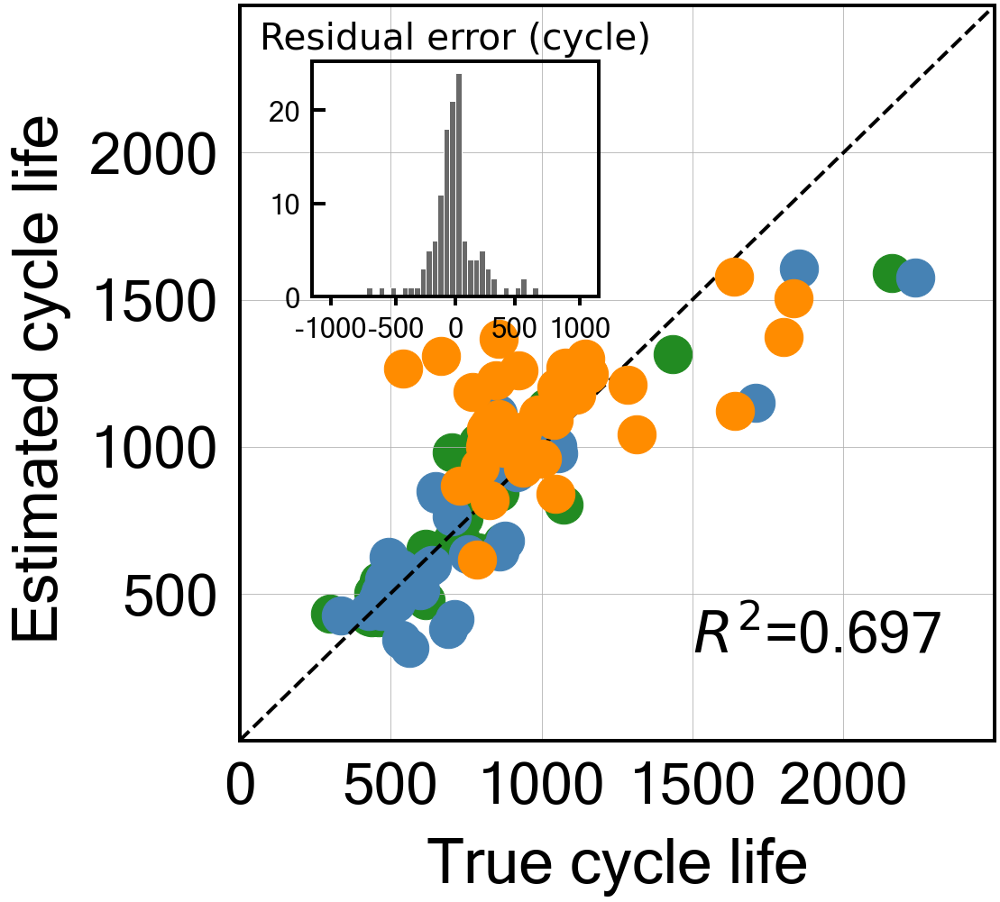


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: 0.11174428966868788
Cycle no: Average_2to35
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to35') : -0.011777513951934354
T_Q('Charge', 'Skewness', 'Average_2to35') : 0.003986644851571572
T_Q('Charge', 'Max-Min', 'Average_2to35') : -0.03736727058585373
dTdQ('Charge', 'Maximum', 'Average_2to35') : -0.04890538819552414
dTdQ('Discharge', 'Max-Min', 'Average_2to35') : 0.03436967621536668
nature_dictAvg_charge_time : 0.0736107796917143
nature_dictIR_cycle2 : -0.04458261495029967
nature_dictMinT_2to35 : 0.03524709802891637
nature_dictIntegralT_2to35 : 0.0

Intercept: 2.7939698976436373
r2-score: 0.712
MAE_all: 135.9
MAE_train: 80.5
MAE_test: 120.5
MAE_2ndTest: 209.1
MAPE_all: 16.3 %
MAPE_train: 10.7 %
MAPE_test: 15.1 %
MAPE_2ndTest: 23.2 %
RMSE_all: 202.7
RMSE_train: 134.0
RMSE_test: 184.6
RMSE_2ndTest: 268.7
RMSPE_all: 24.3 %
R

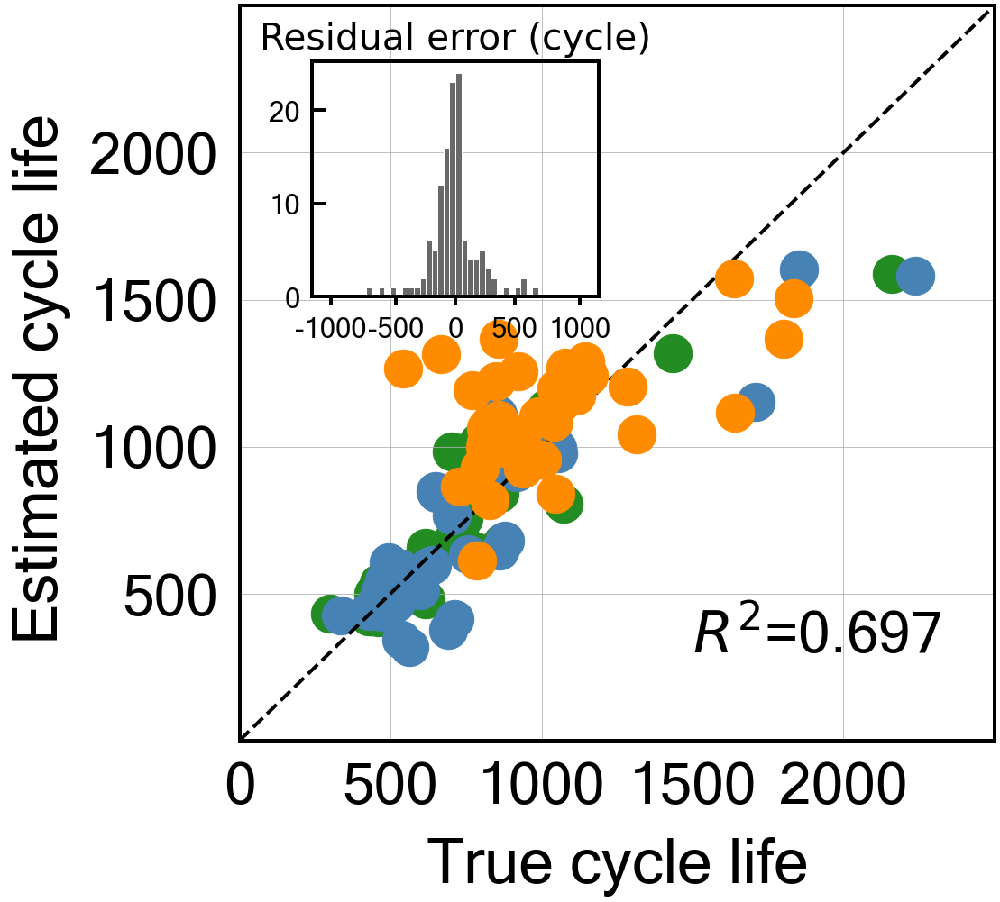


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: 0.028773103207447637
Cycle no: Average_2to36
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to36') : -0.007444774223272155
T_Q('Charge', 'Skewness', 'Average_2to36') : 0.0058046796240034376
T_Q('Charge', 'Max-Min', 'Average_2to36') : -0.04261099476147721
dTdQ('Charge', 'Maximum', 'Average_2to36') : -0.056735543673952504
dTdQ('Discharge', 'Max-Min', 'Average_2to36') : 0.04055414845757076
nature_dictAvg_charge_time : 0.07531441057879996
nature_dictIR_cycle2 : -0.04338789658072541
nature_dictMinT_2to36 : 0.03800864144180456
nature_dictIntegralT_2to36 : -0.0009500572050650255

Intercept: 2.7939698976436373
r2-score: 0.705
MAE_all: 141.1
MAE_train: 80.1
MAE_test: 116.8
MAE_2ndTest: 229.1
MAPE_all: 17.0 %
MAPE_train: 10.7 %
MAPE_test: 14.9 %
MAPE_2ndTest: 25.6 %
RMSE_all: 203.9
RMSE_train: 127.7
RMSE_test: 175.0
RMSE_2ndTest: 28

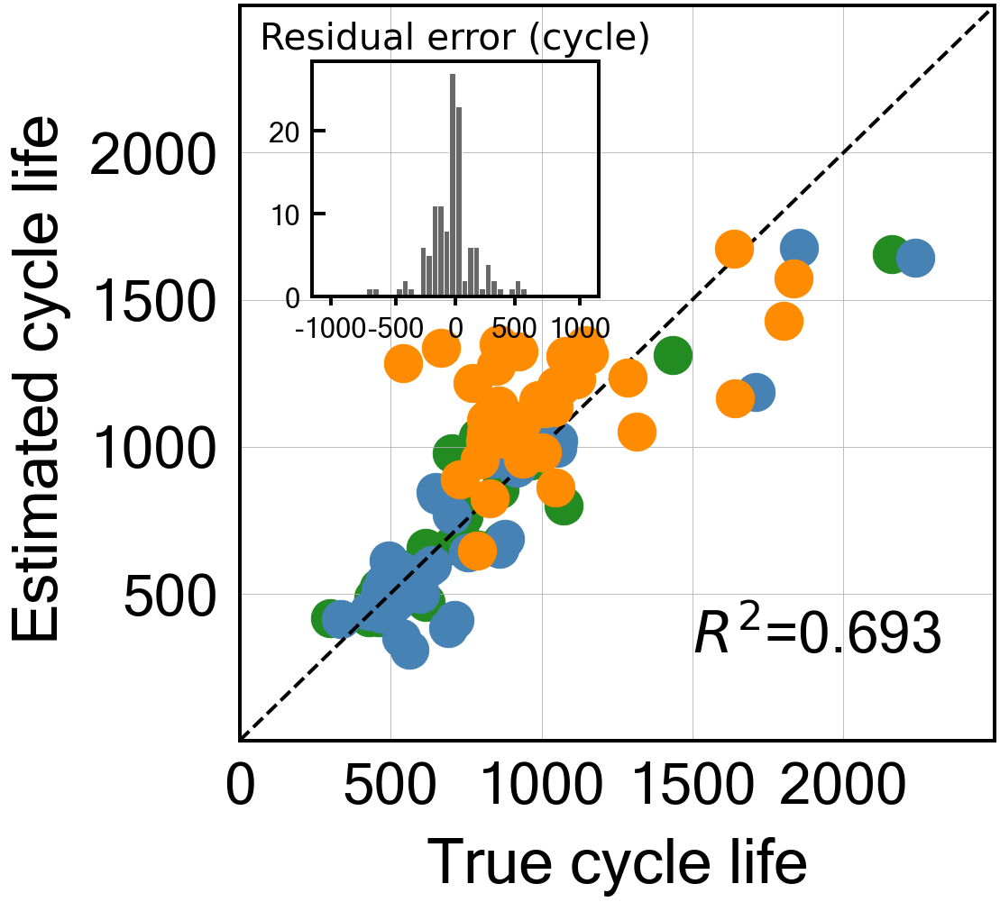


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: 0.02733800940236808
Cycle no: Average_2to37
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to37') : -0.008130793304156152
T_Q('Charge', 'Skewness', 'Average_2to37') : 0.005983762228462424
T_Q('Charge', 'Max-Min', 'Average_2to37') : -0.042169930587422265
dTdQ('Charge', 'Maximum', 'Average_2to37') : -0.05749705172571023
dTdQ('Discharge', 'Max-Min', 'Average_2to37') : 0.04172755280639686
nature_dictAvg_charge_time : 0.07503770296287518
nature_dictIR_cycle2 : -0.04316530049295579
nature_dictMinT_2to37 : 0.03685438373070467
nature_dictIntegralT_2to37 : -0.0020077764318231096

Intercept: 2.7939698976436373
r2-score: 0.705
MAE_all: 141.4
MAE_train: 80.0
MAE_test: 116.9
MAE_2ndTest: 230.1
MAPE_all: 17.0 %
MAPE_train: 10.7 %
MAPE_test: 14.9 %
MAPE_2ndTest: 25.7 %
RMSE_all: 204.0
RMSE_train: 127.1
RMSE_test: 175.4
RMSE_2ndTest: 281.

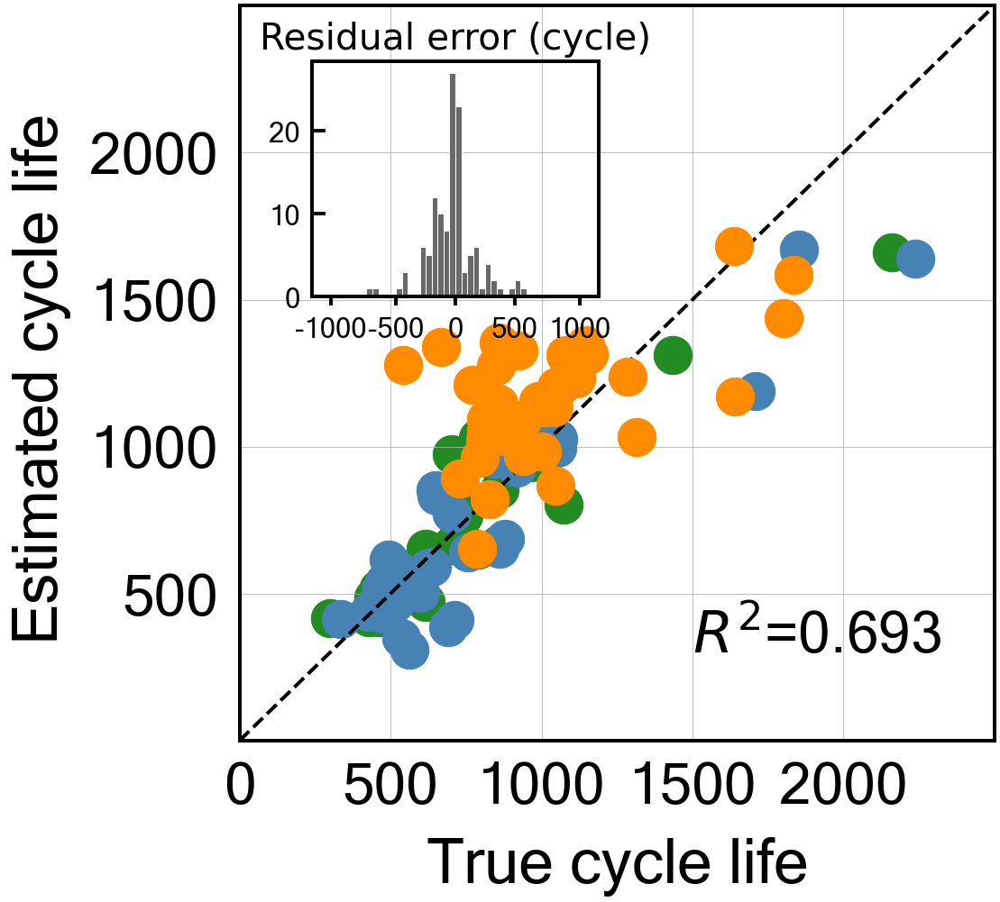


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: 0.017543729218675086
Cycle no: Average_2to38
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to38') : -0.008480166399988765
T_Q('Charge', 'Skewness', 'Average_2to38') : 0.006379053615810075
T_Q('Charge', 'Max-Min', 'Average_2to38') : -0.041247875097253264
dTdQ('Charge', 'Maximum', 'Average_2to38') : -0.05840848013810621
dTdQ('Discharge', 'Max-Min', 'Average_2to38') : 0.04212315322650322
nature_dictAvg_charge_time : 0.07498209757938815
nature_dictIR_cycle2 : -0.042958097191074913
nature_dictMinT_2to38 : 0.03647645712997842
nature_dictIntegralT_2to38 : -0.0028983872415457032

Intercept: 2.793969897643637
r2-score: 0.704
MAE_all: 142.0
MAE_train: 79.6
MAE_test: 117.1
MAE_2ndTest: 232.0
MAPE_all: 17.1 %
MAPE_train: 10.6 %
MAPE_test: 14.9 %
MAPE_2ndTest: 25.9 %
RMSE_all: 204.6
RMSE_train: 126.3
RMSE_test: 176.0
RMSE_2ndTest: 282

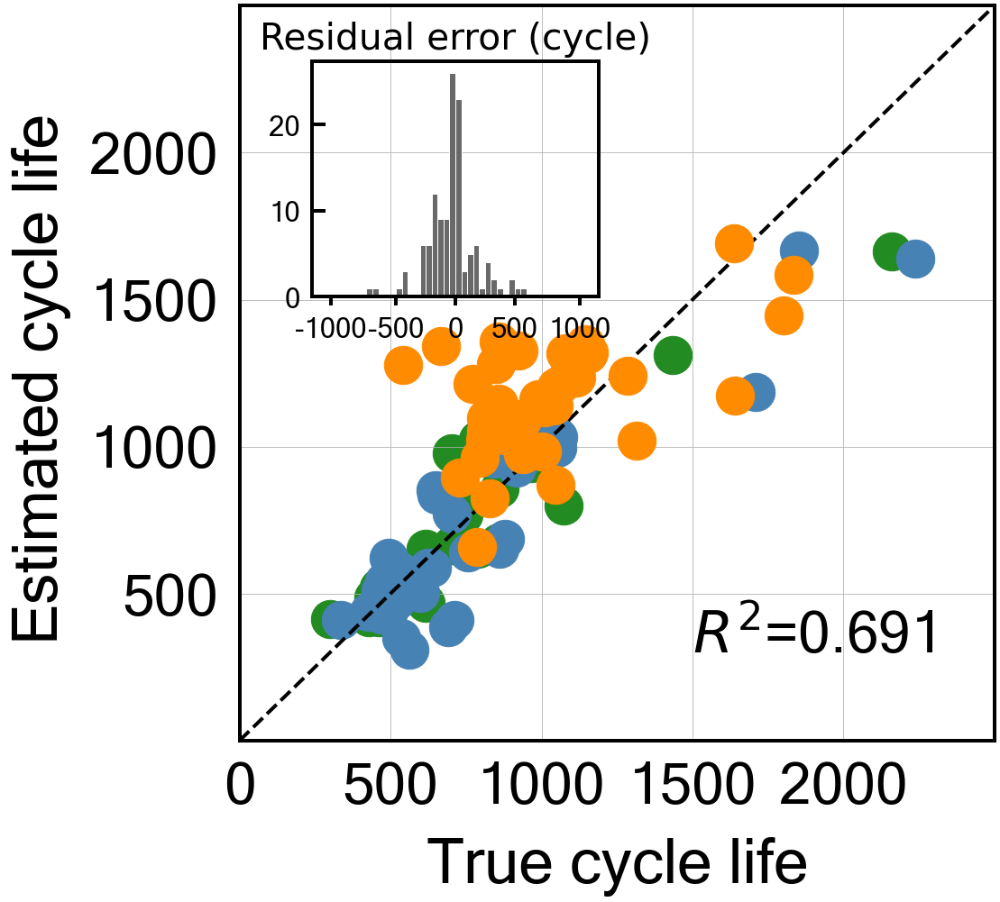


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.0
Best score obtained was: 0.0008991308125012587
Cycle no: Average_2to39
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to39') : -0.006740577239316535
T_Q('Charge', 'Skewness', 'Average_2to39') : 0.0052556629644180865
T_Q('Charge', 'Max-Min', 'Average_2to39') : -0.0426418991069191
dTdQ('Charge', 'Maximum', 'Average_2to39') : -0.05779097207331188
dTdQ('Discharge', 'Max-Min', 'Average_2to39') : 0.041353702375856186
nature_dictAvg_charge_time : 0.07533886678389928
nature_dictIR_cycle2 : -0.04292220898856881
nature_dictMinT_2to39 : 0.037164512573289045
nature_dictIntegralT_2to39 : -0.0033182056351657514

Intercept: 2.7939698976436373
r2-score: 0.701
MAE_all: 143.3
MAE_train: 79.5
MAE_test: 118.7
MAE_2ndTest: 234.6
MAPE_all: 17.2 %
MAPE_train: 10.6 %
MAPE_test: 15.1 %
MAPE_2ndTest: 26.2 %
RMSE_all: 206.2
RMSE_train: 126.5
RMSE_test: 177.7
RMSE_2ndTest: 2

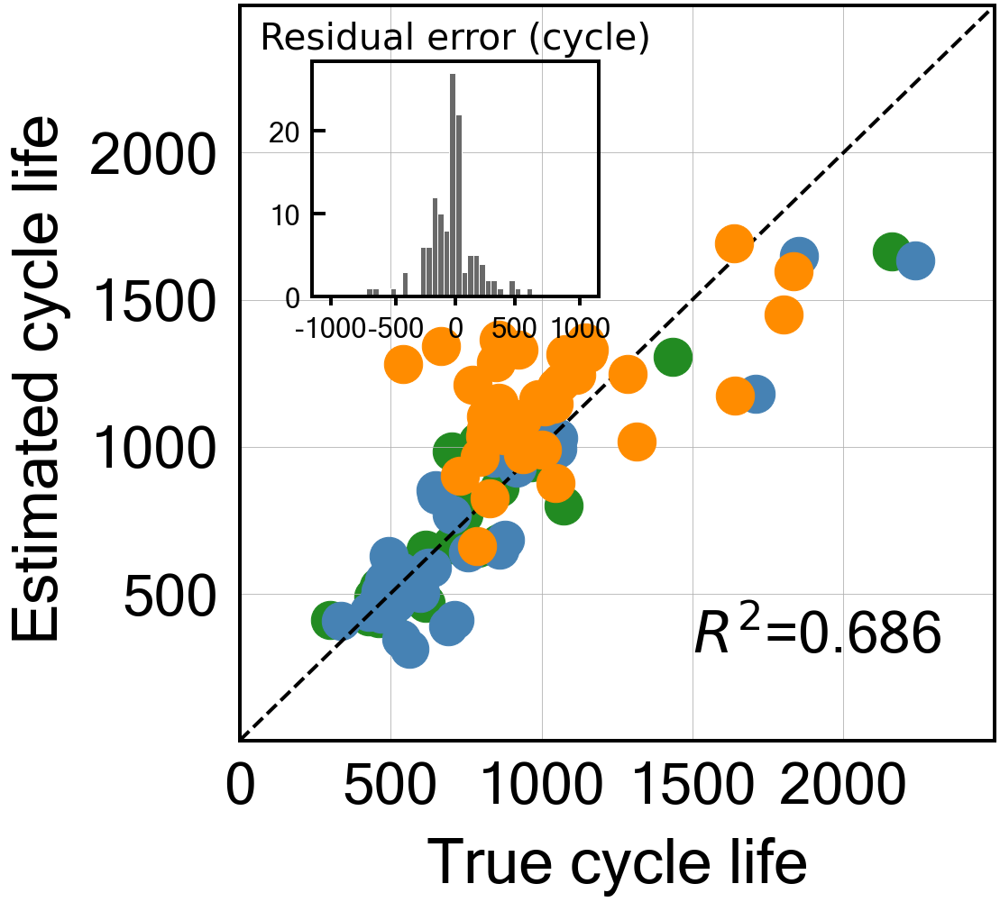


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: -0.03601062485746831
Cycle no: Average_2to40
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to40') : -0.007086534831732541
T_Q('Charge', 'Skewness', 'Average_2to40') : 0.005638995306197586
T_Q('Charge', 'Max-Min', 'Average_2to40') : -0.04184489654811744
dTdQ('Charge', 'Maximum', 'Average_2to40') : -0.05927262545723647
dTdQ('Discharge', 'Max-Min', 'Average_2to40') : 0.04186098595358468
nature_dictAvg_charge_time : 0.07553846125782399
nature_dictIR_cycle2 : -0.042515385299141124
nature_dictMinT_2to40 : 0.03757705109188598
nature_dictIntegralT_2to40 : -0.004303034173594072

Intercept: 2.793969897643637
r2-score: 0.697
MAE_all: 145.6
MAE_train: 79.3
MAE_test: 119.5
MAE_2ndTest: 240.8
MAPE_all: 17.5 %
MAPE_train: 10.6 %
MAPE_test: 15.2 %
MAPE_2ndTest: 26.9 %
RMSE_all: 208.5
RMSE_train: 125.2
RMSE_test: 178.2
RMSE_2ndTest: 290.2

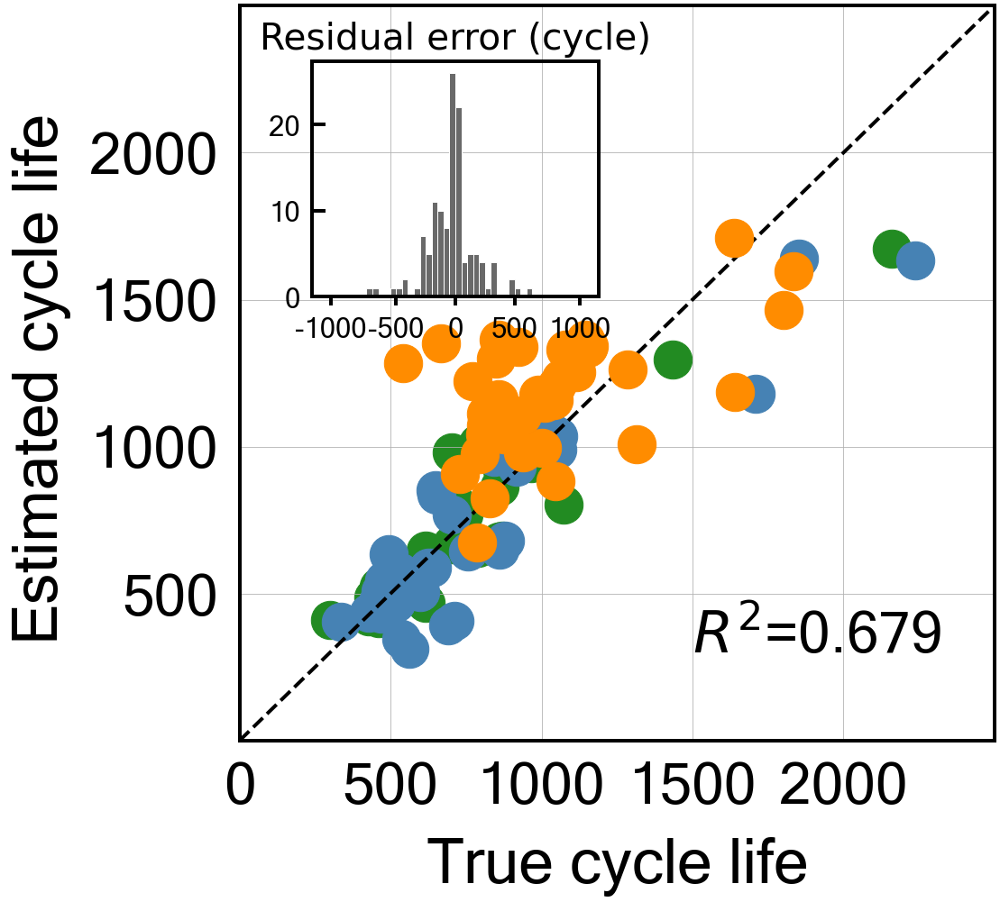


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.0
Best score obtained was: -0.08739871122806542
Cycle no: Average_2to41
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to41') : -0.007238780108394734
T_Q('Charge', 'Skewness', 'Average_2to41') : 0.005536626737182004
T_Q('Charge', 'Max-Min', 'Average_2to41') : -0.04082452724626052
dTdQ('Charge', 'Maximum', 'Average_2to41') : -0.060168587856541514
dTdQ('Discharge', 'Max-Min', 'Average_2to41') : 0.04174825978783115
nature_dictAvg_charge_time : 0.07606873003963922
nature_dictIR_cycle2 : -0.042324885674765084
nature_dictMinT_2to41 : 0.03834171299502179
nature_dictIntegralT_2to41 : -0.005248040342702849

Intercept: 2.7939698976436373
r2-score: 0.691
MAE_all: 147.8
MAE_train: 79.4
MAE_test: 118.7
MAE_2ndTest: 248.4
MAPE_all: 17.7 %
MAPE_train: 10.6 %
MAPE_test: 15.1 %
MAPE_2ndTest: 27.8 %
RMSE_all: 211.3
RMSE_train: 125.2
RMSE_test: 176.9
RMSE_2ndTest: 297

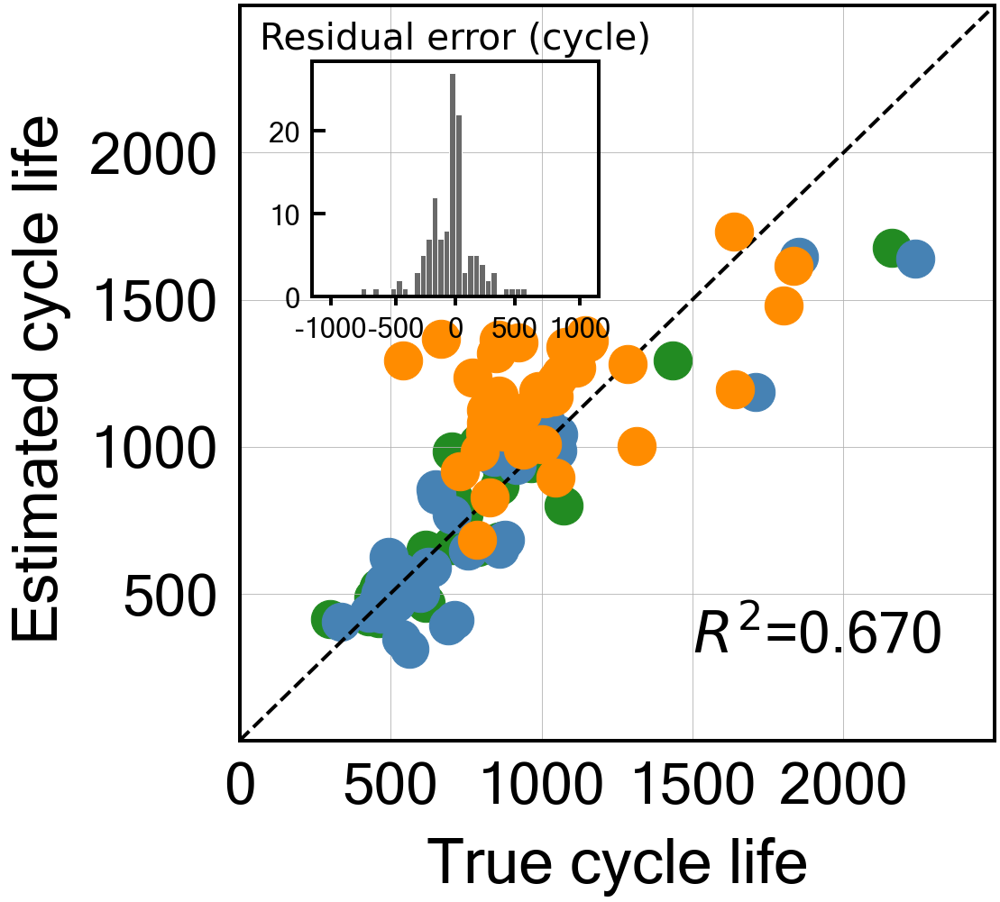


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: -0.08539353026678187
Cycle no: Average_2to42
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to42') : -0.007294114320208358
T_Q('Charge', 'Skewness', 'Average_2to42') : 0.005864343679031042
T_Q('Charge', 'Max-Min', 'Average_2to42') : -0.03977753453484653
dTdQ('Charge', 'Maximum', 'Average_2to42') : -0.06043236031518391
dTdQ('Discharge', 'Max-Min', 'Average_2to42') : 0.041585039048637064
nature_dictAvg_charge_time : 0.07652867747295115
nature_dictIR_cycle2 : -0.04233083858487139
nature_dictMinT_2to42 : 0.03745158575197333
nature_dictIntegralT_2to42 : -0.006172146634868301

Intercept: 2.7939698976436373
r2-score: 0.692
MAE_all: 147.6
MAE_train: 79.5
MAE_test: 118.3
MAE_2ndTest: 248.2
MAPE_all: 17.7 %
MAPE_train: 10.6 %
MAPE_test: 15.0 %
MAPE_2ndTest: 27.8 %
RMSE_all: 211.2
RMSE_train: 125.2
RMSE_test: 176.7
RMSE_2ndTest: 297.

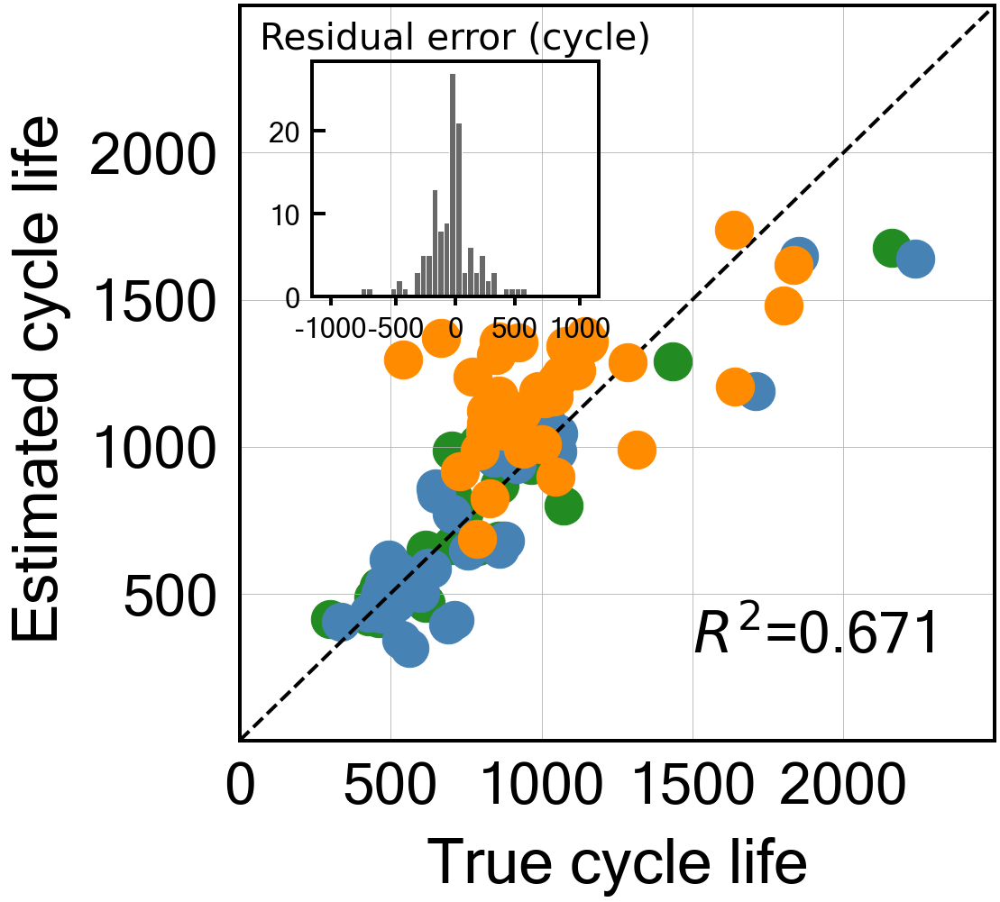


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: -0.0936837236499739
Cycle no: Average_2to43
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to43') : -0.007734986600893119
T_Q('Charge', 'Skewness', 'Average_2to43') : 0.006187656432107665
T_Q('Charge', 'Max-Min', 'Average_2to43') : -0.03897861608215977
dTdQ('Charge', 'Maximum', 'Average_2to43') : -0.060991686431434454
dTdQ('Discharge', 'Max-Min', 'Average_2to43') : 0.04174195751368053
nature_dictAvg_charge_time : 0.07643059690041044
nature_dictIR_cycle2 : -0.041870847545398104
nature_dictMinT_2to43 : 0.03731800255727703
nature_dictIntegralT_2to43 : -0.006968390929200774

Intercept: 2.7939698976436373
r2-score: 0.693
MAE_all: 147.7
MAE_train: 79.4
MAE_test: 117.4
MAE_2ndTest: 249.6
MAPE_all: 17.6 %
MAPE_train: 10.5 %
MAPE_test: 14.8 %
MAPE_2ndTest: 27.9 %
RMSE_all: 211.6
RMSE_train: 125.3
RMSE_test: 176.4
RMSE_2ndTest: 298.

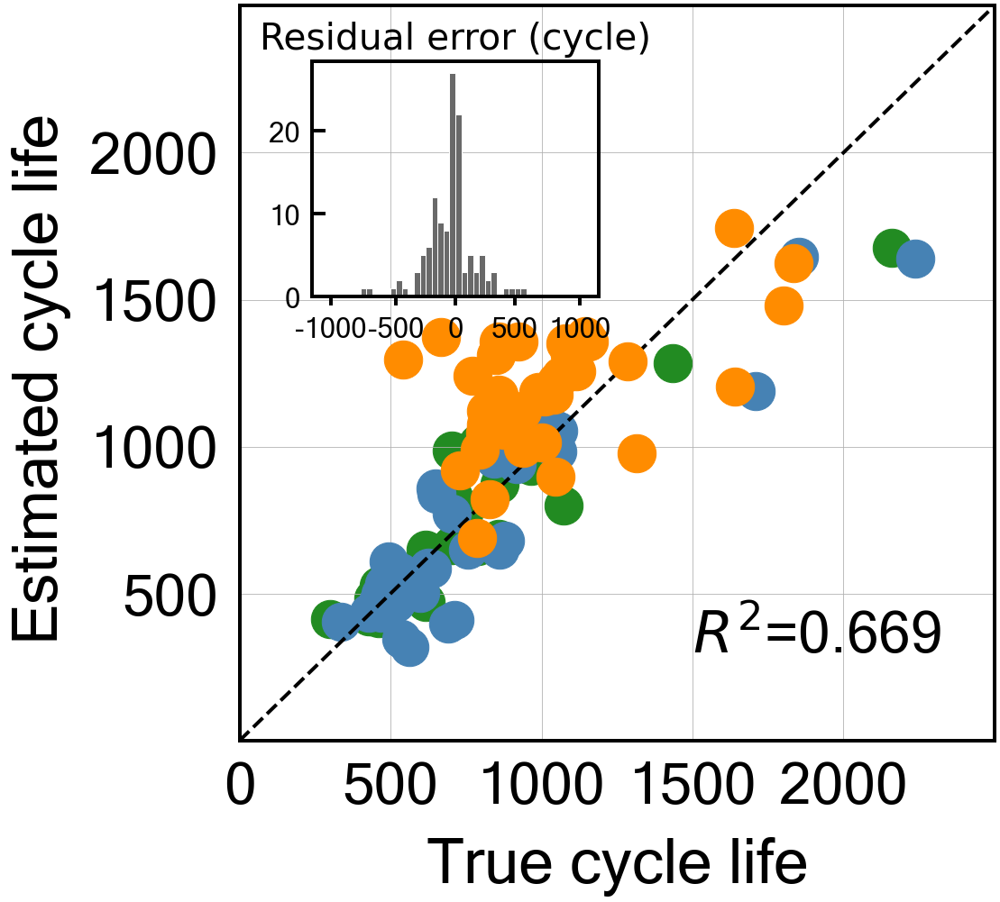


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: -0.07768672246359865
Cycle no: Average_2to44
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to44') : -0.008076609730784237
T_Q('Charge', 'Skewness', 'Average_2to44') : 0.005062640871949944
T_Q('Charge', 'Max-Min', 'Average_2to44') : -0.03857178740509748
dTdQ('Charge', 'Maximum', 'Average_2to44') : -0.059758106213303054
dTdQ('Discharge', 'Max-Min', 'Average_2to44') : 0.04103544908504334
nature_dictAvg_charge_time : 0.07656913678635478
nature_dictIR_cycle2 : -0.04156781390479172
nature_dictMinT_2to44 : 0.036860231841090114
nature_dictIntegralT_2to44 : -0.007684611823009999

Intercept: 2.7939698976436373
r2-score: 0.695
MAE_all: 146.8
MAE_train: 79.4
MAE_test: 117.3
MAE_2ndTest: 246.8
MAPE_all: 17.5 %
MAPE_train: 10.5 %
MAPE_test: 14.7 %
MAPE_2ndTest: 27.6 %
RMSE_all: 210.9
RMSE_train: 126.5
RMSE_test: 176.8
RMSE_2ndTest: 296

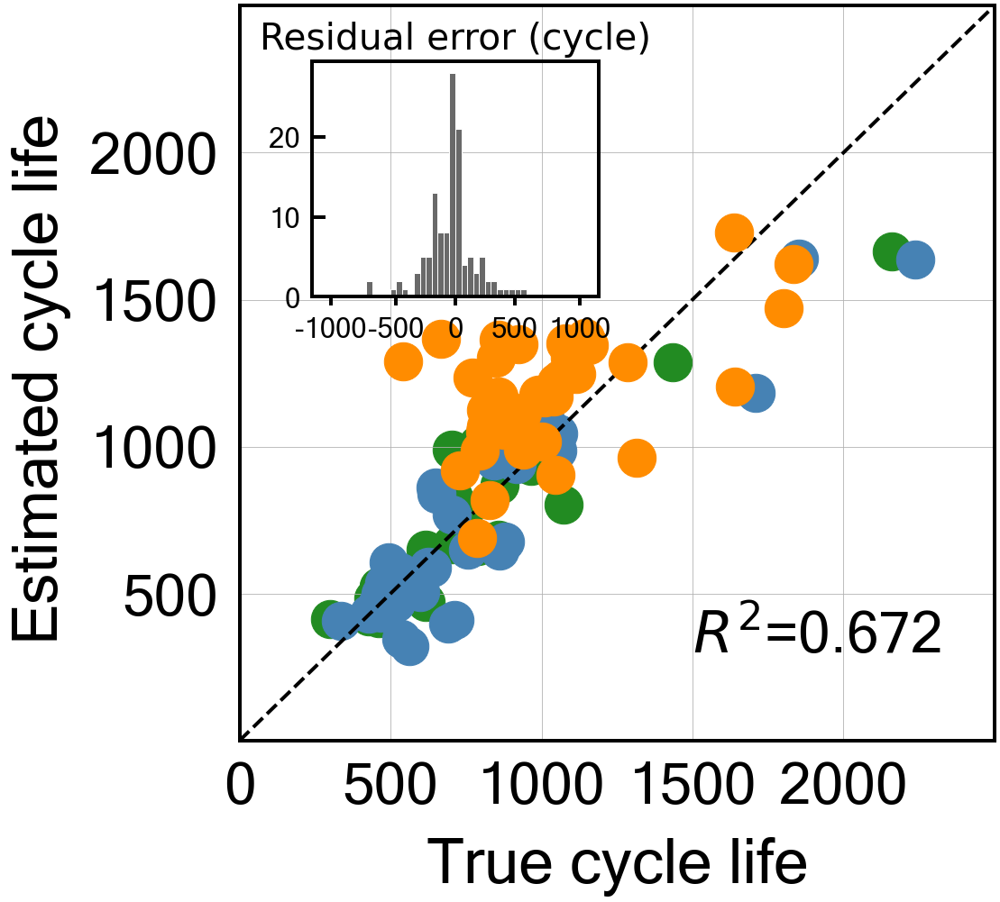


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: -0.0847670728906611
Cycle no: Average_2to45
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to45') : -0.009258443563083522
T_Q('Charge', 'Skewness', 'Average_2to45') : 0.0049870460553847
T_Q('Charge', 'Max-Min', 'Average_2to45') : -0.03705017633845125
dTdQ('Charge', 'Maximum', 'Average_2to45') : -0.06056768148693988
dTdQ('Discharge', 'Max-Min', 'Average_2to45') : 0.04188282158036438
nature_dictAvg_charge_time : 0.07680511387043944
nature_dictIR_cycle2 : -0.04133252917993391
nature_dictMinT_2to45 : 0.03704239456105323
nature_dictIntegralT_2to45 : -0.008115852466139615

Intercept: 2.793969897643637
r2-score: 0.696
MAE_all: 146.9
MAE_train: 79.3
MAE_test: 116.2
MAE_2ndTest: 248.4
MAPE_all: 17.5 %
MAPE_train: 10.5 %
MAPE_test: 14.6 %
MAPE_2ndTest: 27.8 %
RMSE_all: 211.0
RMSE_train: 126.0
RMSE_test: 175.7
RMSE_2ndTest: 296.9
RMS

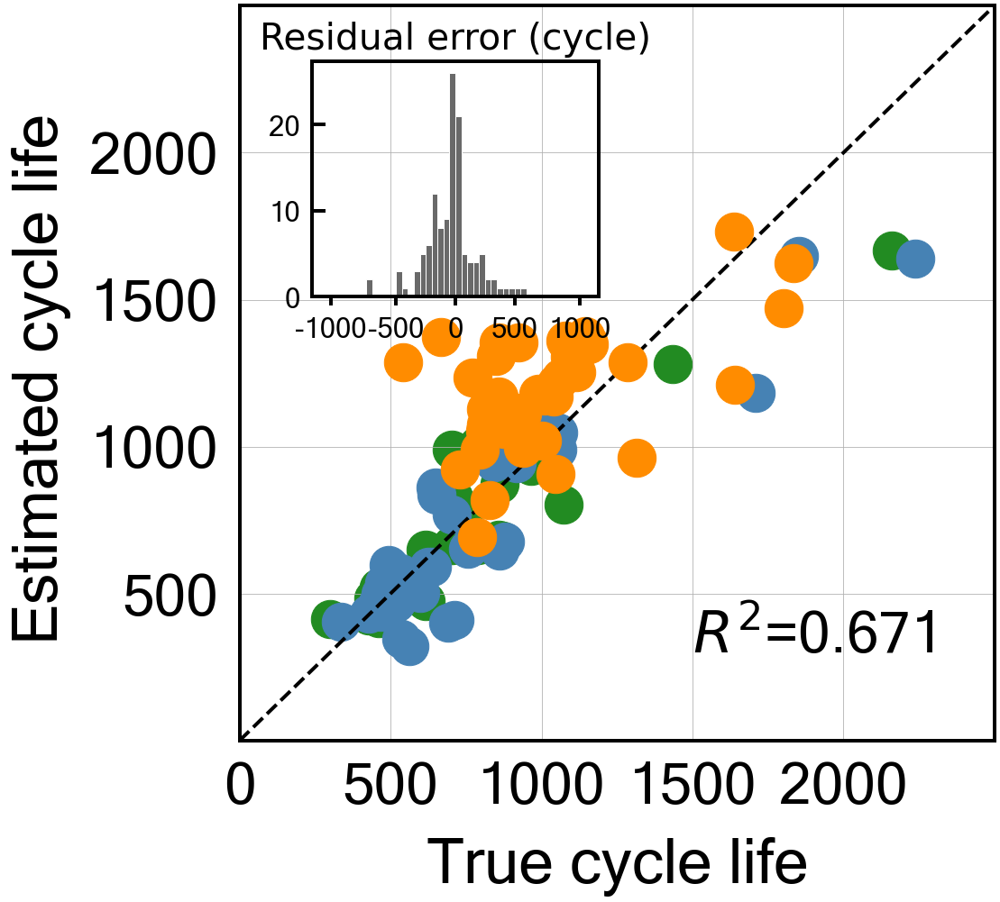


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: -0.08905304500227706
Cycle no: Average_2to46
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to46') : -0.008813940285595638
T_Q('Charge', 'Skewness', 'Average_2to46') : 0.005473391114185306
T_Q('Charge', 'Max-Min', 'Average_2to46') : -0.035315389356644675
dTdQ('Charge', 'Maximum', 'Average_2to46') : -0.06138835513844178
dTdQ('Discharge', 'Max-Min', 'Average_2to46') : 0.04189138051454522
nature_dictAvg_charge_time : 0.07796214263513879
nature_dictIR_cycle2 : -0.04134839367232098
nature_dictMinT_2to46 : 0.0365916115076107
nature_dictIntegralT_2to46 : -0.009049016227030051

Intercept: 2.7939698976436373
r2-score: 0.697
MAE_all: 146.6
MAE_train: 79.2
MAE_test: 115.5
MAE_2ndTest: 248.4
MAPE_all: 17.5 %
MAPE_train: 10.5 %
MAPE_test: 14.5 %
MAPE_2ndTest: 27.8 %
RMSE_all: 210.8
RMSE_train: 125.4
RMSE_test: 174.6
RMSE_2ndTest: 297.5

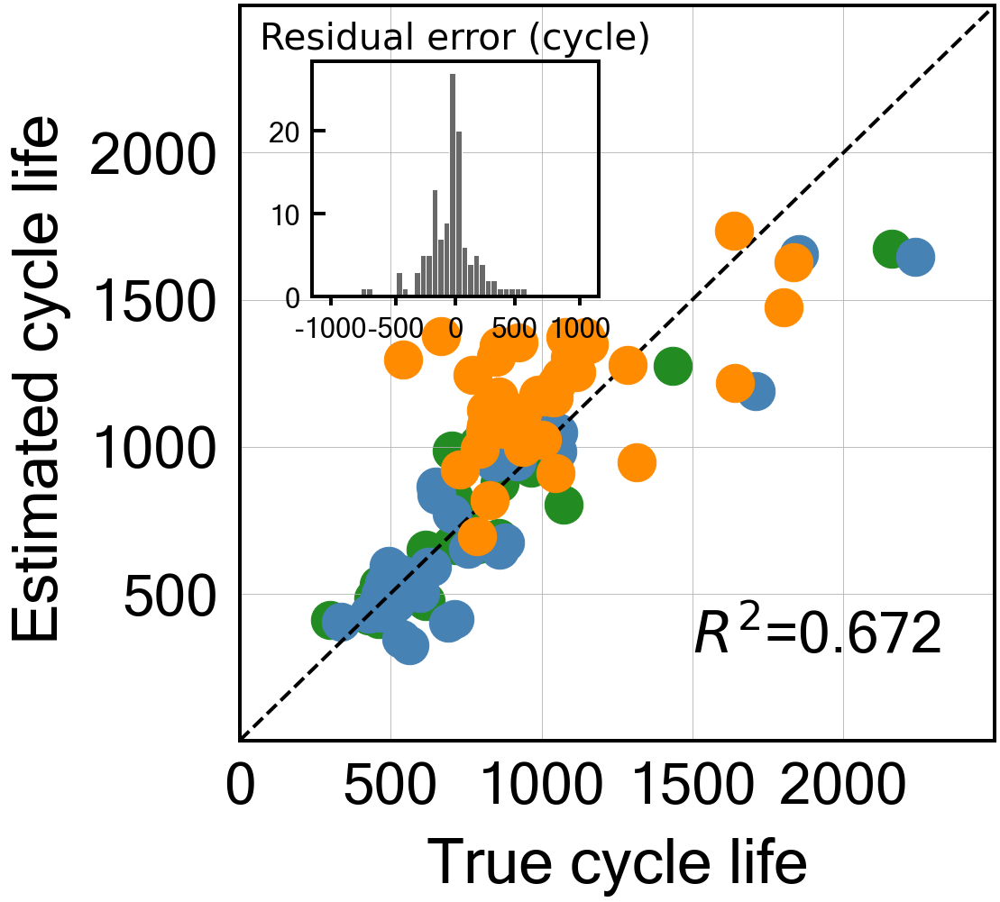


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.0
Best score obtained was: -0.10620489717152726
Cycle no: Average_2to47
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to47') : -0.008819648092104214
T_Q('Charge', 'Skewness', 'Average_2to47') : 0.005166717330107389
T_Q('Charge', 'Max-Min', 'Average_2to47') : -0.03348889416423905
dTdQ('Charge', 'Maximum', 'Average_2to47') : -0.06093769385978127
dTdQ('Discharge', 'Max-Min', 'Average_2to47') : 0.0402582012617993
nature_dictAvg_charge_time : 0.07872754830110668
nature_dictIR_cycle2 : -0.04122909520108863
nature_dictMinT_2to47 : 0.037045633121262786
nature_dictIntegralT_2to47 : -0.009685491500661126

Intercept: 2.793969897643638
r2-score: 0.694
MAE_all: 147.5
MAE_train: 79.8
MAE_test: 115.9
MAE_2ndTest: 250.1
MAPE_all: 17.6 %
MAPE_train: 10.5 %
MAPE_test: 14.5 %
MAPE_2ndTest: 28.0 %
RMSE_all: 212.5
RMSE_train: 126.2
RMSE_test: 176.1
RMSE_2ndTest: 299.9


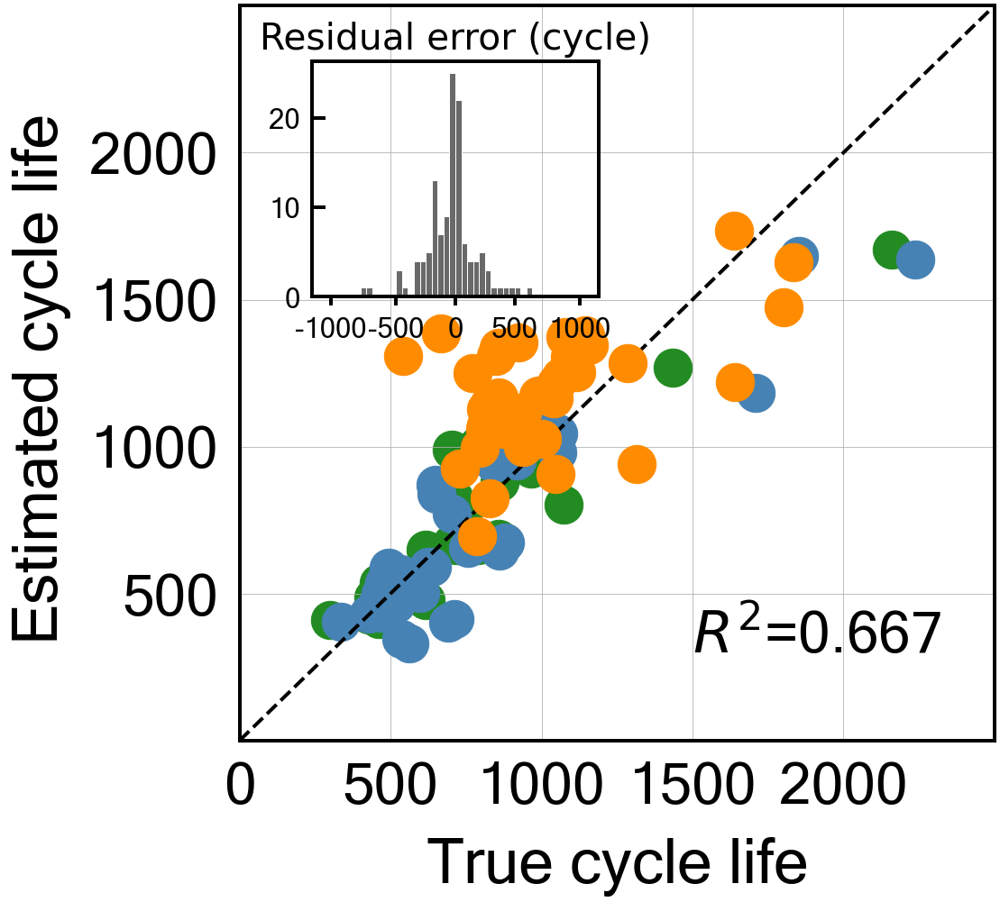


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: -0.1440548173736731
Cycle no: Average_2to48
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to48') : -0.00813461026755381
T_Q('Charge', 'Skewness', 'Average_2to48') : 0.005665385616014945
T_Q('Charge', 'Max-Min', 'Average_2to48') : -0.032794589022156956
dTdQ('Charge', 'Maximum', 'Average_2to48') : -0.06399259972034474
dTdQ('Discharge', 'Max-Min', 'Average_2to48') : 0.04273175540883625
nature_dictAvg_charge_time : 0.08014942141688947
nature_dictIR_cycle2 : -0.04057337422399936
nature_dictMinT_2to48 : 0.0371996725662926
nature_dictIntegralT_2to48 : -0.011177893637524205

Intercept: 2.793969897643637
r2-score: 0.692
MAE_all: 149.0
MAE_train: 79.9
MAE_test: 114.0
MAE_2ndTest: 256.6
MAPE_all: 17.8 %
MAPE_train: 10.6 %
MAPE_test: 14.3 %
MAPE_2ndTest: 28.7 %
RMSE_all: 213.2
RMSE_train: 123.7
RMSE_test: 172.1
RMSE_2ndTest: 305.0
RM

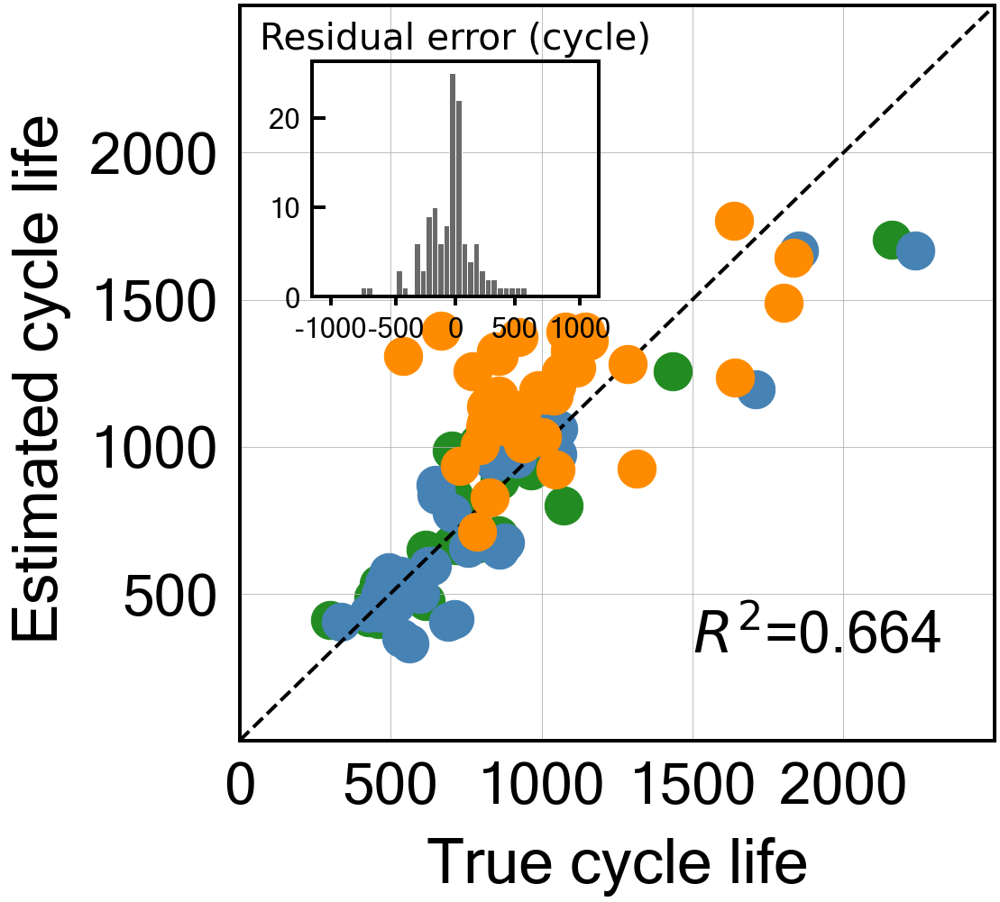


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.0
Best score obtained was: -0.14132182950023675
Cycle no: Average_2to49
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to49') : -0.007599732805101426
T_Q('Charge', 'Skewness', 'Average_2to49') : 0.005334347214460499
T_Q('Charge', 'Max-Min', 'Average_2to49') : -0.03170964274672486
dTdQ('Charge', 'Maximum', 'Average_2to49') : -0.0639407420914684
dTdQ('Discharge', 'Max-Min', 'Average_2to49') : 0.04251365488363253
nature_dictAvg_charge_time : 0.08081828651276446
nature_dictIR_cycle2 : -0.040658067786218166
nature_dictMinT_2to49 : 0.03667071291839072
nature_dictIntegralT_2to49 : -0.012042748426245633

Intercept: 2.793969897643637
r2-score: 0.693
MAE_all: 148.7
MAE_train: 79.9
MAE_test: 113.1
MAE_2ndTest: 256.5
MAPE_all: 17.7 %
MAPE_train: 10.6 %
MAPE_test: 14.2 %
MAPE_2ndTest: 28.7 %
RMSE_all: 212.9
RMSE_train: 123.8
RMSE_test: 171.4
RMSE_2ndTest: 304.6


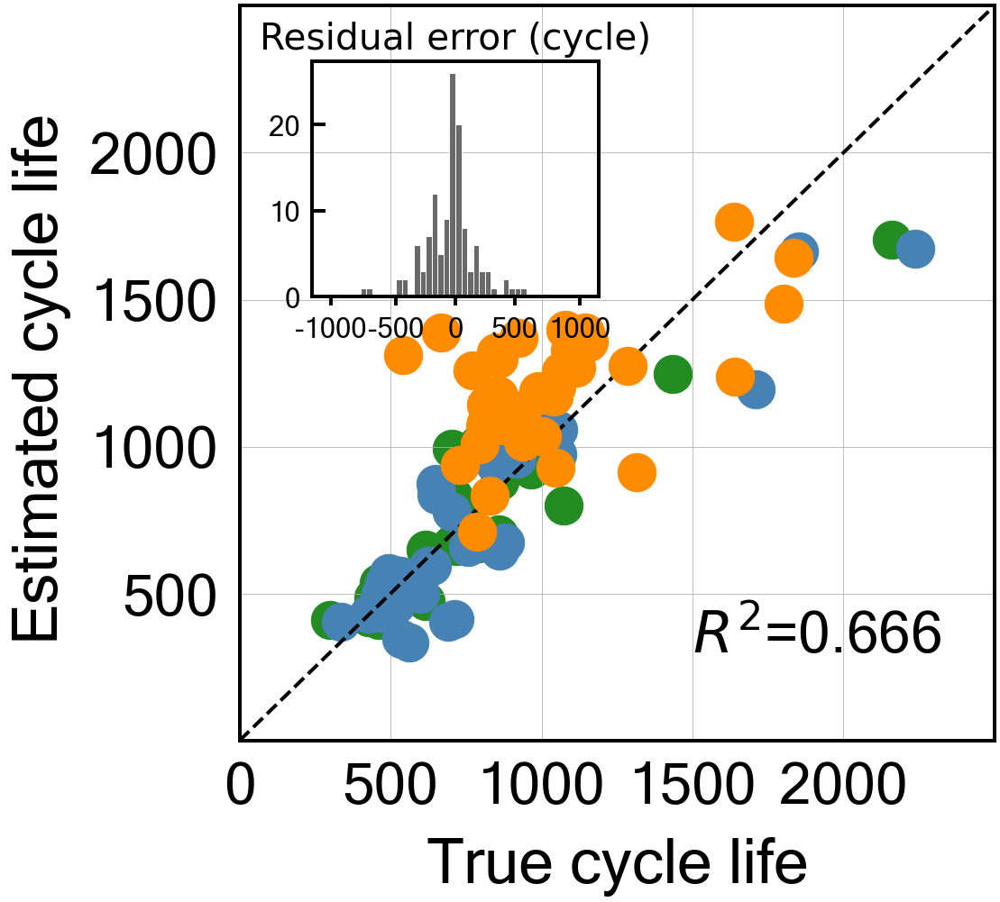


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.0
Best score obtained was: -0.15713611536311545
Cycle no: Average_2to50
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to50') : -0.008225259404605776
T_Q('Charge', 'Skewness', 'Average_2to50') : 0.005725383606919058
T_Q('Charge', 'Max-Min', 'Average_2to50') : -0.028584679763724363
dTdQ('Charge', 'Maximum', 'Average_2to50') : -0.06468230466468684
dTdQ('Discharge', 'Max-Min', 'Average_2to50') : 0.041903595105288065
nature_dictAvg_charge_time : 0.08217493717992343
nature_dictIR_cycle2 : -0.04087753152150296
nature_dictMinT_2to50 : 0.03676875804141536
nature_dictIntegralT_2to50 : -0.012739589873046233

Intercept: 2.7939698976436373
r2-score: 0.691
MAE_all: 149.0
MAE_train: 80.0
MAE_test: 112.1
MAE_2ndTest: 258.6
MAPE_all: 17.8 %
MAPE_train: 10.6 %
MAPE_test: 14.1 %
MAPE_2ndTest: 29.0 %
RMSE_all: 213.4
RMSE_train: 123.2
RMSE_test: 170.3
RMSE_2ndTest: 306

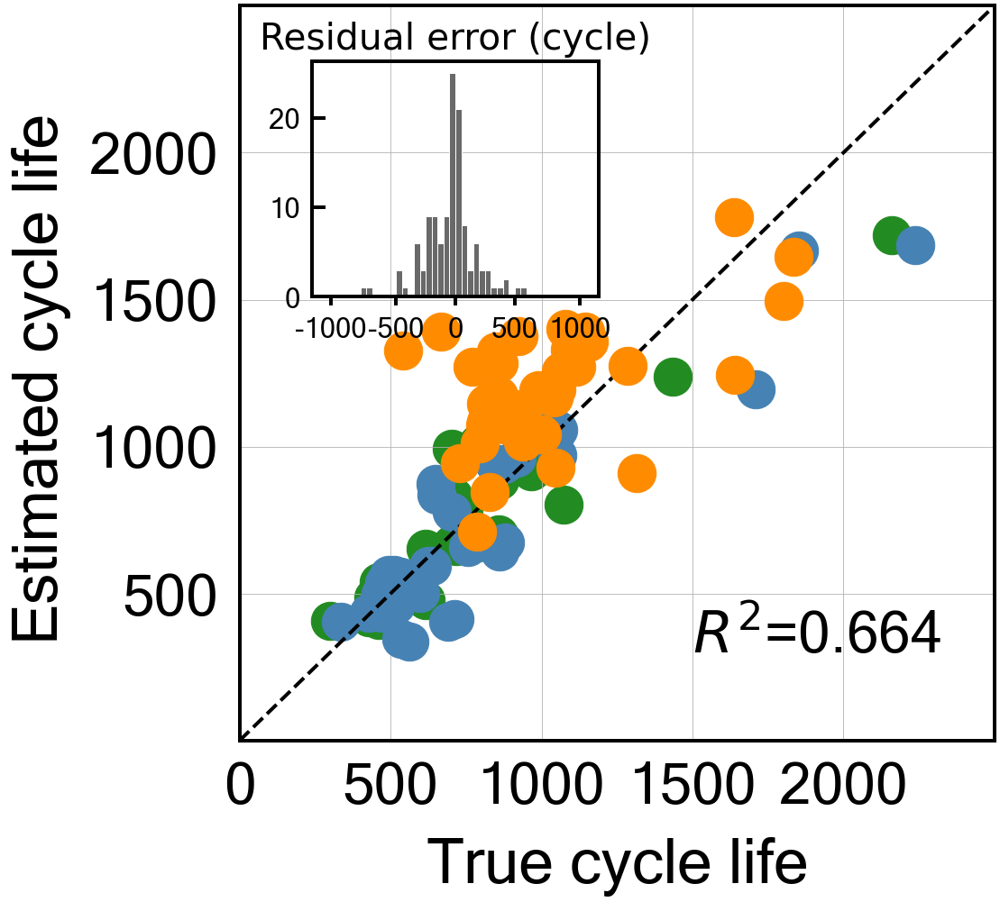


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.0
Best score obtained was: -0.10435695871562922
Cycle no: Average_2to51
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to51') : -0.008434293309791464
T_Q('Charge', 'Skewness', 'Average_2to51') : 0.004187331954713649
T_Q('Charge', 'Max-Min', 'Average_2to51') : -0.030491820961621997
dTdQ('Charge', 'Maximum', 'Average_2to51') : -0.06165756544104406
dTdQ('Discharge', 'Max-Min', 'Average_2to51') : 0.040459852768896166
nature_dictAvg_charge_time : 0.08027189167672334
nature_dictIR_cycle2 : -0.04006788493676448
nature_dictMinT_2to51 : 0.03660928814505586
nature_dictIntegralT_2to51 : -0.01275343678154663

Intercept: 2.7939698976436373
r2-score: 0.699
MAE_all: 147.3
MAE_train: 80.0
MAE_test: 113.6
MAE_2ndTest: 251.6
MAPE_all: 17.5 %
MAPE_train: 10.6 %
MAPE_test: 14.1 %
MAPE_2ndTest: 28.2 %
RMSE_all: 211.6
RMSE_train: 125.3
RMSE_test: 174.2
RMSE_2ndTest: 299.

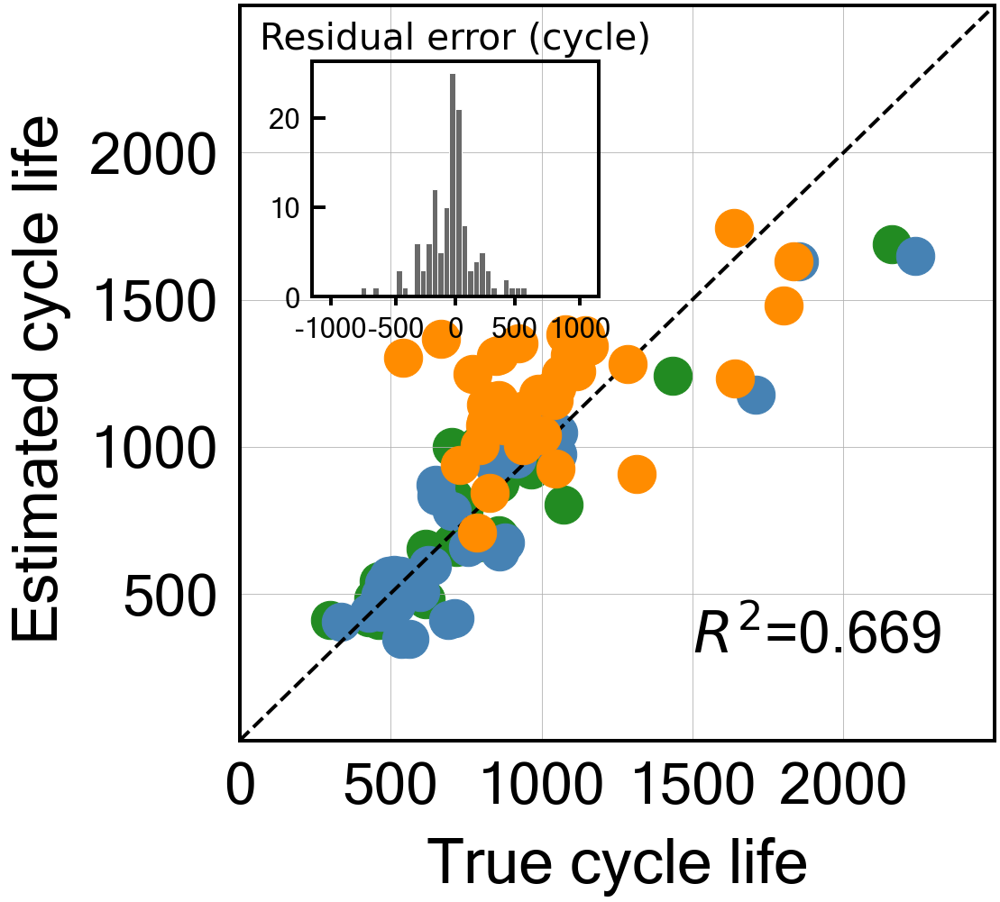


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: -0.14951469585877009
Cycle no: Average_2to52
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to52') : -0.007392084753547842
T_Q('Charge', 'Skewness', 'Average_2to52') : 0.005075178198247543
T_Q('Charge', 'Max-Min', 'Average_2to52') : -0.02807265841315346
dTdQ('Charge', 'Maximum', 'Average_2to52') : -0.06384842914890432
dTdQ('Discharge', 'Max-Min', 'Average_2to52') : 0.04087915194030171
nature_dictAvg_charge_time : 0.08249898049152285
nature_dictIR_cycle2 : -0.040169369324171554
nature_dictMinT_2to52 : 0.03652155171949776
nature_dictIntegralT_2to52 : -0.014398848905838821

Intercept: 2.793969897643637
r2-score: 0.694
MAE_all: 148.9
MAE_train: 80.2
MAE_test: 111.6
MAE_2ndTest: 258.4
MAPE_all: 17.7 %
MAPE_train: 10.6 %
MAPE_test: 13.9 %
MAPE_2ndTest: 29.0 %
RMSE_all: 213.4
RMSE_train: 124.3
RMSE_test: 171.2
RMSE_2ndTest: 305.7

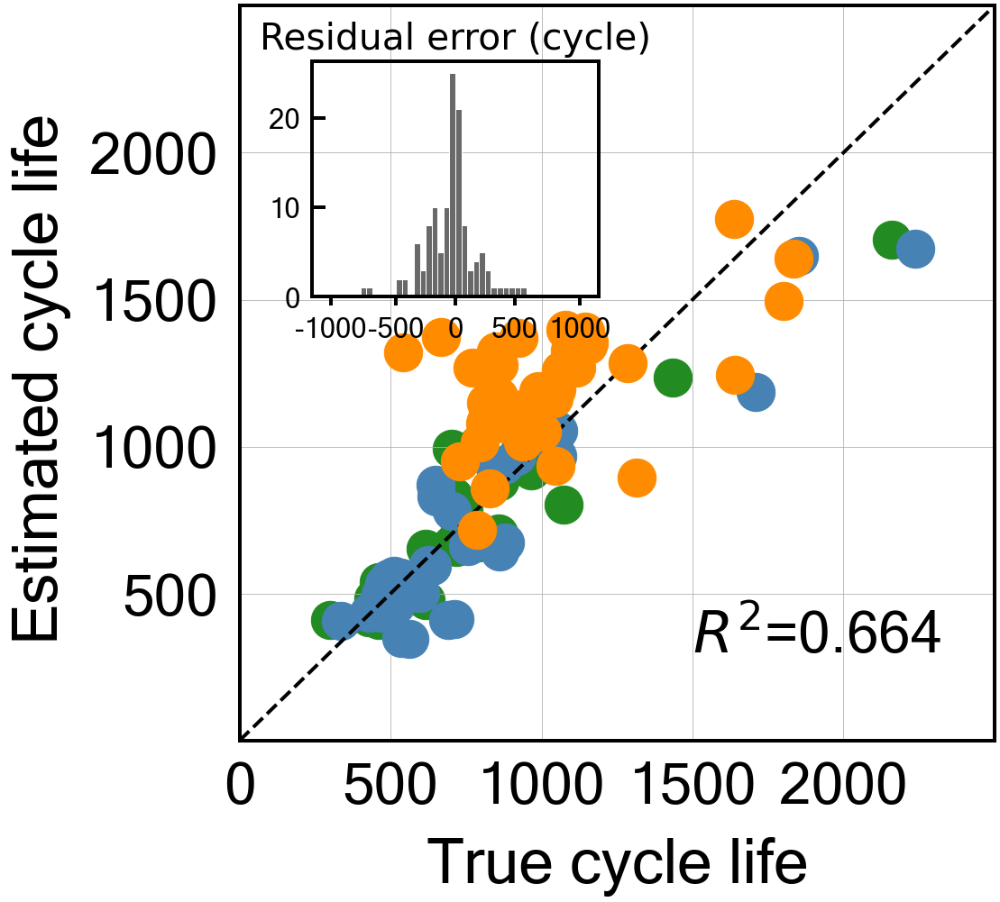


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: -0.13011324639719102
Cycle no: Average_2to53
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to53') : -0.007475649112099172
T_Q('Charge', 'Skewness', 'Average_2to53') : 0.004017466434813925
T_Q('Charge', 'Max-Min', 'Average_2to53') : -0.028245779320918873
dTdQ('Charge', 'Maximum', 'Average_2to53') : -0.06127324725679059
dTdQ('Discharge', 'Max-Min', 'Average_2to53') : 0.03825755016168371
nature_dictAvg_charge_time : 0.08168825320752689
nature_dictIR_cycle2 : -0.0397281642845953
nature_dictMinT_2to53 : 0.03707625977181536
nature_dictIntegralT_2to53 : -0.014585477138795433

Intercept: 2.7939698976436373
r2-score: 0.697
MAE_all: 148.7
MAE_train: 80.4
MAE_test: 113.3
MAE_2ndTest: 256.0
MAPE_all: 17.6 %
MAPE_train: 10.6 %
MAPE_test: 14.0 %
MAPE_2ndTest: 28.7 %
RMSE_all: 213.5
RMSE_train: 126.3
RMSE_test: 174.3
RMSE_2ndTest: 303.1

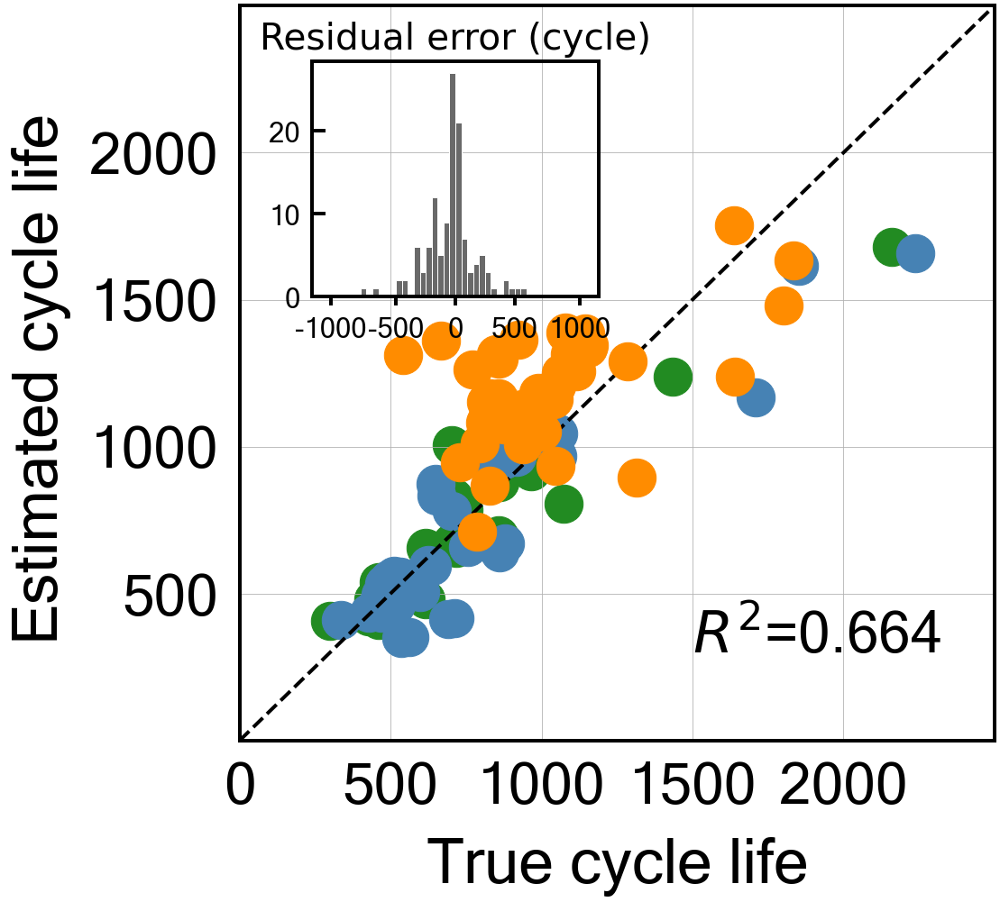


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: -0.1742896924981705
Cycle no: Average_2to54
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to54') : -0.006455258084715001
T_Q('Charge', 'Skewness', 'Average_2to54') : 0.005657266878142285
T_Q('Charge', 'Max-Min', 'Average_2to54') : -0.025949252658289824
dTdQ('Charge', 'Maximum', 'Average_2to54') : -0.06481847302689278
dTdQ('Discharge', 'Max-Min', 'Average_2to54') : 0.03951587359662653
nature_dictAvg_charge_time : 0.08373232798024248
nature_dictIR_cycle2 : -0.03900087694736174
nature_dictMinT_2to54 : 0.03734506996923913
nature_dictIntegralT_2to54 : -0.016384975765870627

Intercept: 2.7939698976436373
r2-score: 0.694
MAE_all: 150.5
MAE_train: 80.4
MAE_test: 111.4
MAE_2ndTest: 263.3
MAPE_all: 17.8 %
MAPE_train: 10.6 %
MAPE_test: 13.8 %
MAPE_2ndTest: 29.5 %
RMSE_all: 214.6
RMSE_train: 123.6
RMSE_test: 170.5
RMSE_2ndTest: 309.0

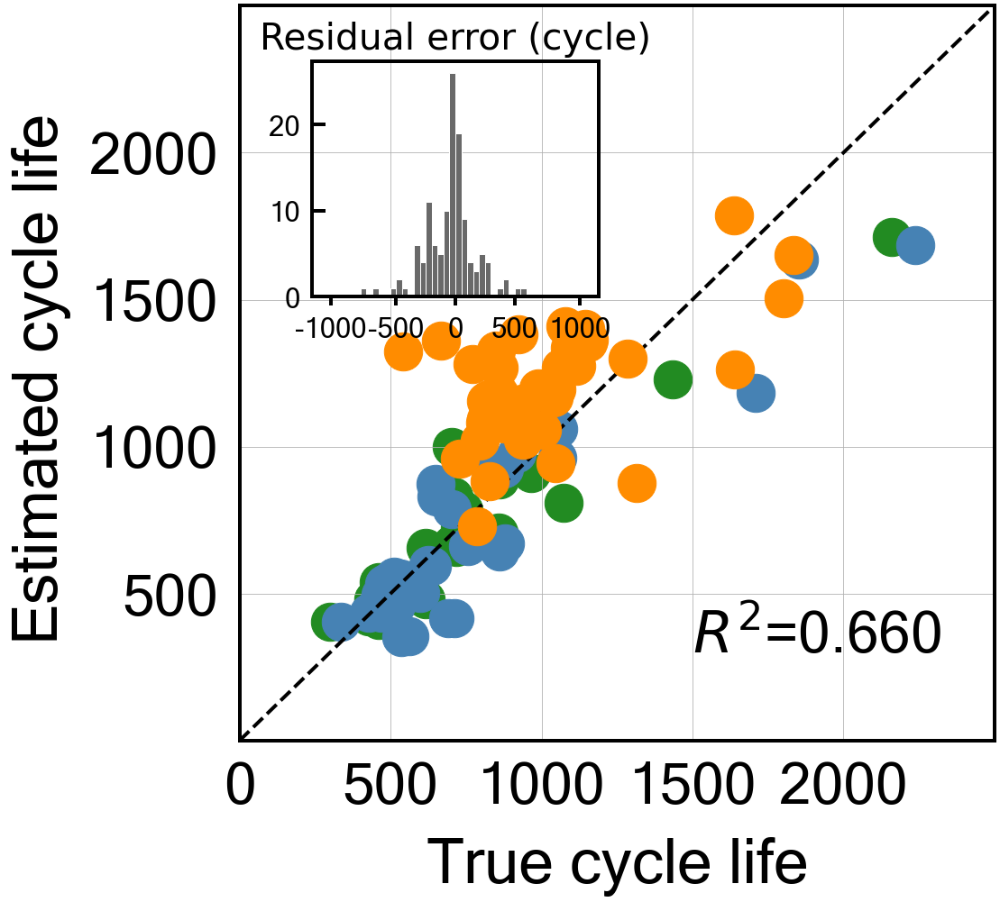


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.5
Best score obtained was: -0.15401411507770213
Cycle no: Average_2to55
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to55') : -0.0060625473787778135
T_Q('Charge', 'Skewness', 'Average_2to55') : 0.005321824928481849
T_Q('Charge', 'Max-Min', 'Average_2to55') : -0.025398661638526082
dTdQ('Charge', 'Maximum', 'Average_2to55') : -0.0642064587455335
dTdQ('Discharge', 'Max-Min', 'Average_2to55') : 0.039171595196279115
nature_dictAvg_charge_time : 0.08420668676816831
nature_dictIR_cycle2 : -0.038457642221576986
nature_dictMinT_2to55 : 0.03717427312877931
nature_dictIntegralT_2to55 : -0.01741545589430596

Intercept: 2.793969897643637
r2-score: 0.697
MAE_all: 149.7
MAE_train: 80.7
MAE_test: 111.0
MAE_2ndTest: 260.9
MAPE_all: 17.7 %
MAPE_train: 10.6 %
MAPE_test: 13.7 %
MAPE_2ndTest: 29.2 %
RMSE_all: 213.6
RMSE_train: 124.6
RMSE_test: 170.8
RMSE_2ndTest: 306.

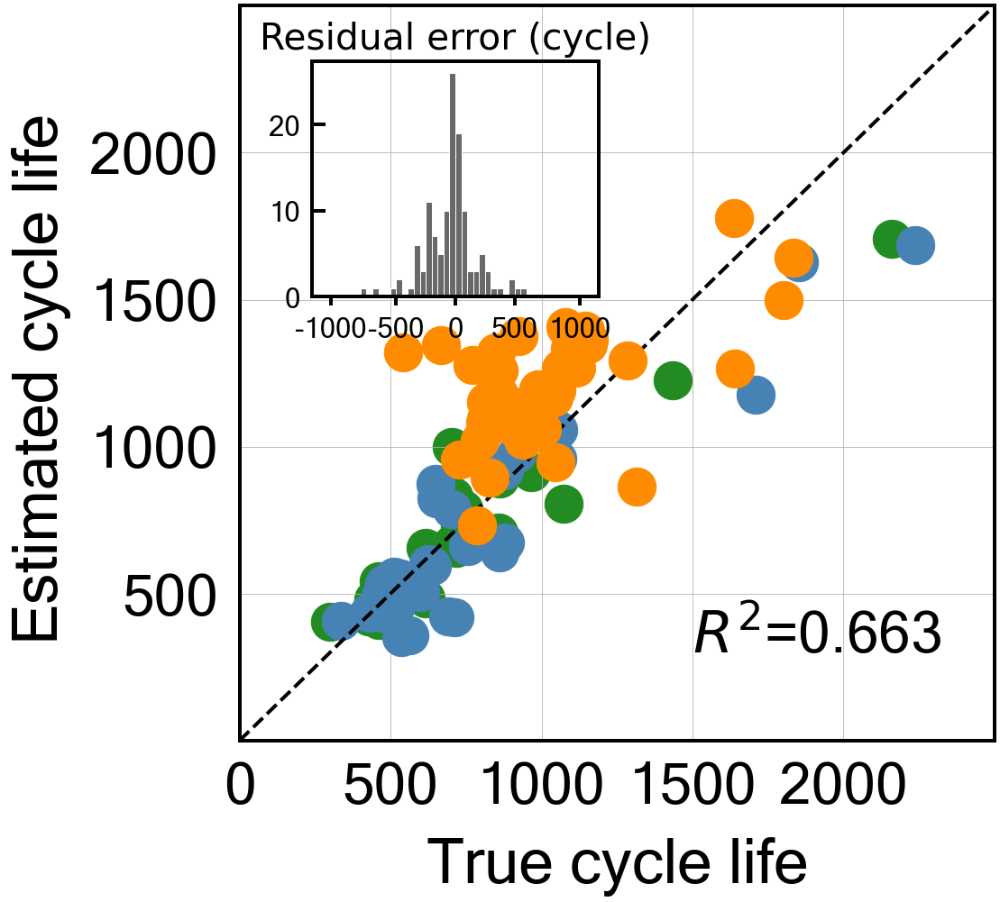


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.1
Best score obtained was: -0.16414923502367662
Cycle no: Average_2to56
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to56') : -0.005440568889012954
T_Q('Charge', 'Skewness', 'Average_2to56') : 0.005514149553242817
T_Q('Charge', 'Max-Min', 'Average_2to56') : -0.024581367928224438
dTdQ('Charge', 'Maximum', 'Average_2to56') : -0.06491880286625752
dTdQ('Discharge', 'Max-Min', 'Average_2to56') : 0.039090000998262056
nature_dictAvg_charge_time : 0.08480748049945938
nature_dictIR_cycle2 : -0.03783399519425164
nature_dictMinT_2to56 : 0.03756069073290676
nature_dictIntegralT_2to56 : -0.018465939395014473

Intercept: 2.793969897643637
r2-score: 0.697
MAE_all: 150.1
MAE_train: 80.9
MAE_test: 110.1
MAE_2ndTest: 262.9
MAPE_all: 17.8 %
MAPE_train: 10.6 %
MAPE_test: 13.6 %
MAPE_2ndTest: 29.4 %
RMSE_all: 214.0
RMSE_train: 124.3
RMSE_test: 169.9
RMSE_2ndTest: 307.

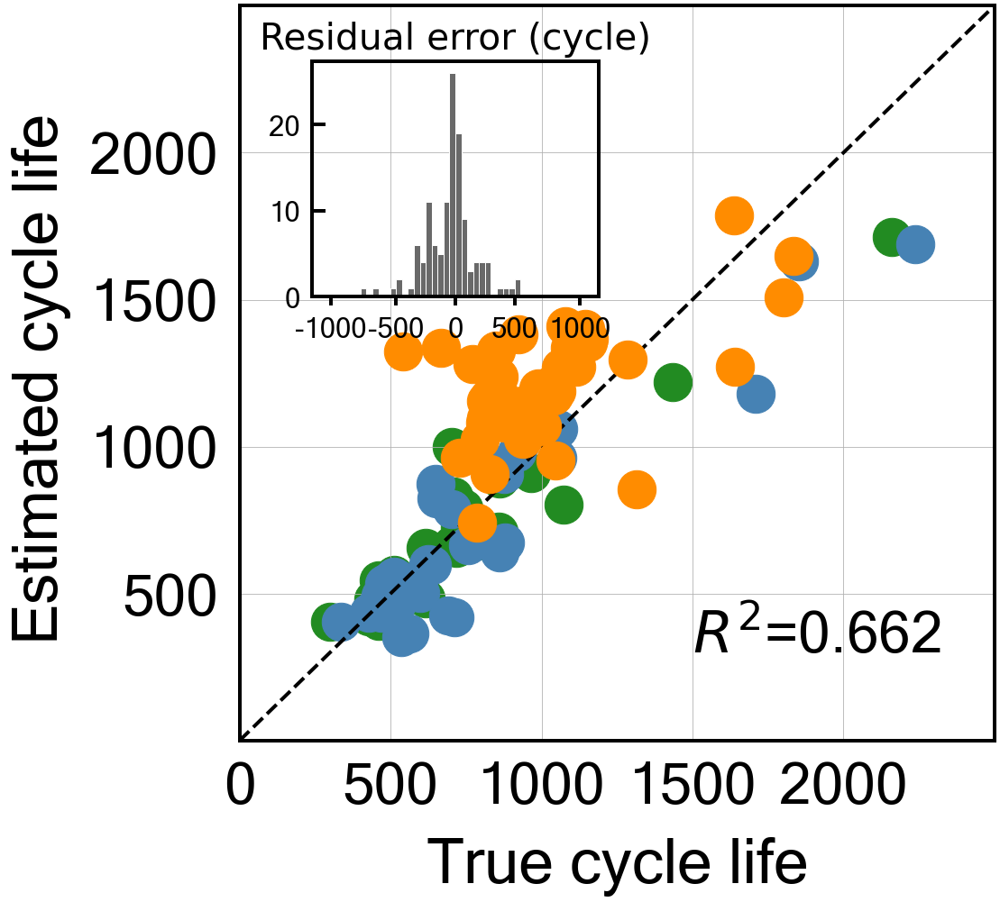


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: -0.14925243463670257
Cycle no: Average_2to57
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to57') : -0.006701688765856081
T_Q('Charge', 'Skewness', 'Average_2to57') : 0.0052536320064216395
T_Q('Charge', 'Max-Min', 'Average_2to57') : -0.024223061384758195
dTdQ('Charge', 'Maximum', 'Average_2to57') : -0.06523923997884862
dTdQ('Discharge', 'Max-Min', 'Average_2to57') : 0.04022497951707383
nature_dictAvg_charge_time : 0.08414860081998181
nature_dictIR_cycle2 : -0.03752418871389784
nature_dictMinT_2to57 : 0.03706566386748933
nature_dictIntegralT_2to57 : -0.018717527313464526

Intercept: 2.7939698976436373
r2-score: 0.701
MAE_all: 149.3
MAE_train: 80.5
MAE_test: 109.3
MAE_2ndTest: 261.9
MAPE_all: 17.7 %
MAPE_train: 10.6 %
MAPE_test: 13.5 %
MAPE_2ndTest: 29.3 %
RMSE_all: 212.7
RMSE_train: 123.7
RMSE_test: 168.9
RMSE_2ndTest: 305

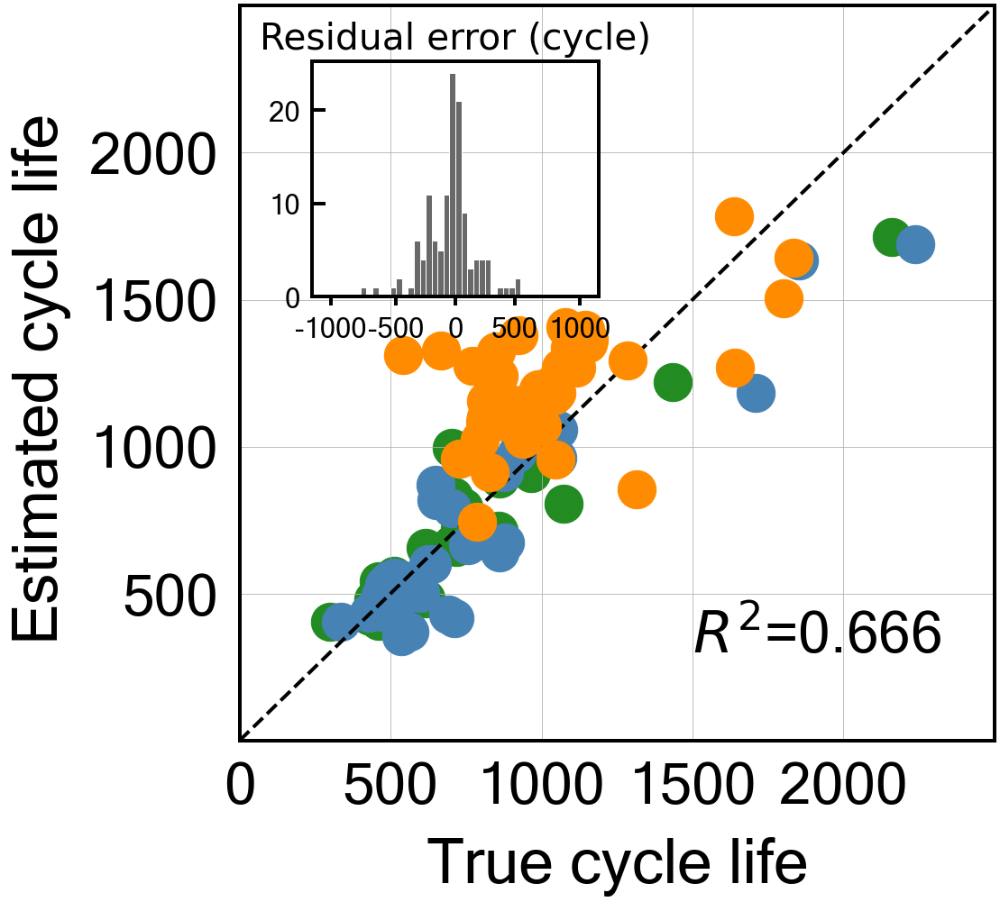


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: -0.18448967317973142
Cycle no: Average_2to58
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to58') : -0.005260746582759244
T_Q('Charge', 'Skewness', 'Average_2to58') : 0.005678866876096278
T_Q('Charge', 'Max-Min', 'Average_2to58') : -0.02266257907259404
dTdQ('Charge', 'Maximum', 'Average_2to58') : -0.06698629591531327
dTdQ('Discharge', 'Max-Min', 'Average_2to58') : 0.04052663721113958
nature_dictAvg_charge_time : 0.0863315013997453
nature_dictIR_cycle2 : -0.03735743618136704
nature_dictMinT_2to58 : 0.03715203291947411
nature_dictIntegralT_2to58 : -0.020224913041638242

Intercept: 2.7939698976436373
r2-score: 0.698
MAE_all: 150.1
MAE_train: 80.7
MAE_test: 107.0
MAE_2ndTest: 266.6
MAPE_all: 17.8 %
MAPE_train: 10.6 %
MAPE_test: 13.3 %
MAPE_2ndTest: 29.8 %
RMSE_all: 213.7
RMSE_train: 122.5
RMSE_test: 165.5
RMSE_2ndTest: 310.3


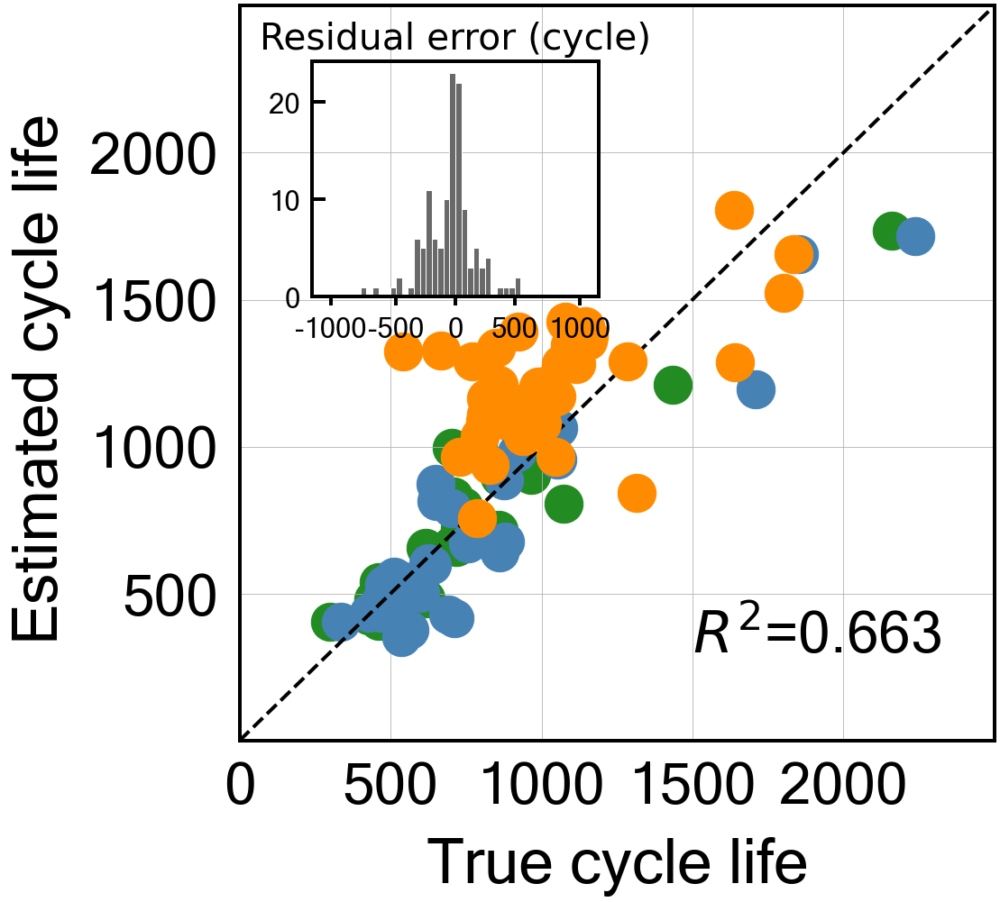


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.0
Best score obtained was: -0.14393297512030134
Cycle no: Average_2to59
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to59') : -0.008207413090177178
T_Q('Charge', 'Skewness', 'Average_2to59') : 0.004900086060223549
T_Q('Charge', 'Max-Min', 'Average_2to59') : -0.022865368043043496
dTdQ('Charge', 'Maximum', 'Average_2to59') : -0.06539326688046739
dTdQ('Discharge', 'Max-Min', 'Average_2to59') : 0.04005474685951961
nature_dictAvg_charge_time : 0.08377943971527152
nature_dictIR_cycle2 : -0.0361200007014331
nature_dictMinT_2to59 : 0.03776303030404631
nature_dictIntegralT_2to59 : -0.020111481938288052

Intercept: 2.793969897643637
r2-score: 0.705
MAE_all: 149.5
MAE_train: 80.2
MAE_test: 108.9
MAE_2ndTest: 263.1
MAPE_all: 17.6 %
MAPE_train: 10.5 %
MAPE_test: 13.3 %
MAPE_2ndTest: 29.4 %
RMSE_all: 212.5
RMSE_train: 123.7
RMSE_test: 169.4
RMSE_2ndTest: 304.9


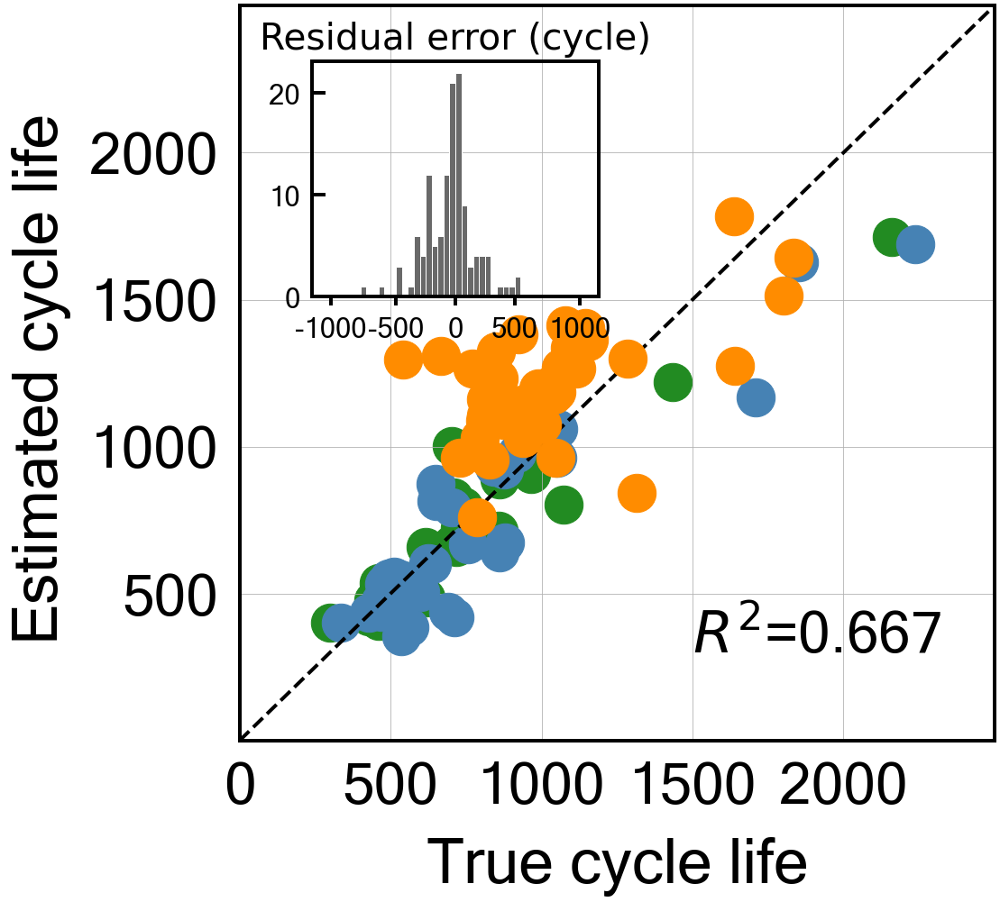


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.3
Best score obtained was: -0.14926657077197336
Cycle no: Average_2to60
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to60') : -0.007998224667792776
T_Q('Charge', 'Skewness', 'Average_2to60') : 0.004960755373710707
T_Q('Charge', 'Max-Min', 'Average_2to60') : -0.022580197472949395
dTdQ('Charge', 'Maximum', 'Average_2to60') : -0.06615025805763552
dTdQ('Discharge', 'Max-Min', 'Average_2to60') : 0.04085328517093588
nature_dictAvg_charge_time : 0.08411557047908308
nature_dictIR_cycle2 : -0.03563003464886268
nature_dictMinT_2to60 : 0.03751932648955784
nature_dictIntegralT_2to60 : -0.02088767539689478

Intercept: 2.7939698976436373
r2-score: 0.706
MAE_all: 149.5
MAE_train: 79.9
MAE_test: 107.7
MAE_2ndTest: 264.6
MAPE_all: 17.6 %
MAPE_train: 10.4 %
MAPE_test: 13.2 %
MAPE_2ndTest: 29.5 %
RMSE_all: 212.3
RMSE_train: 123.0
RMSE_test: 168.0
RMSE_2ndTest: 305.7

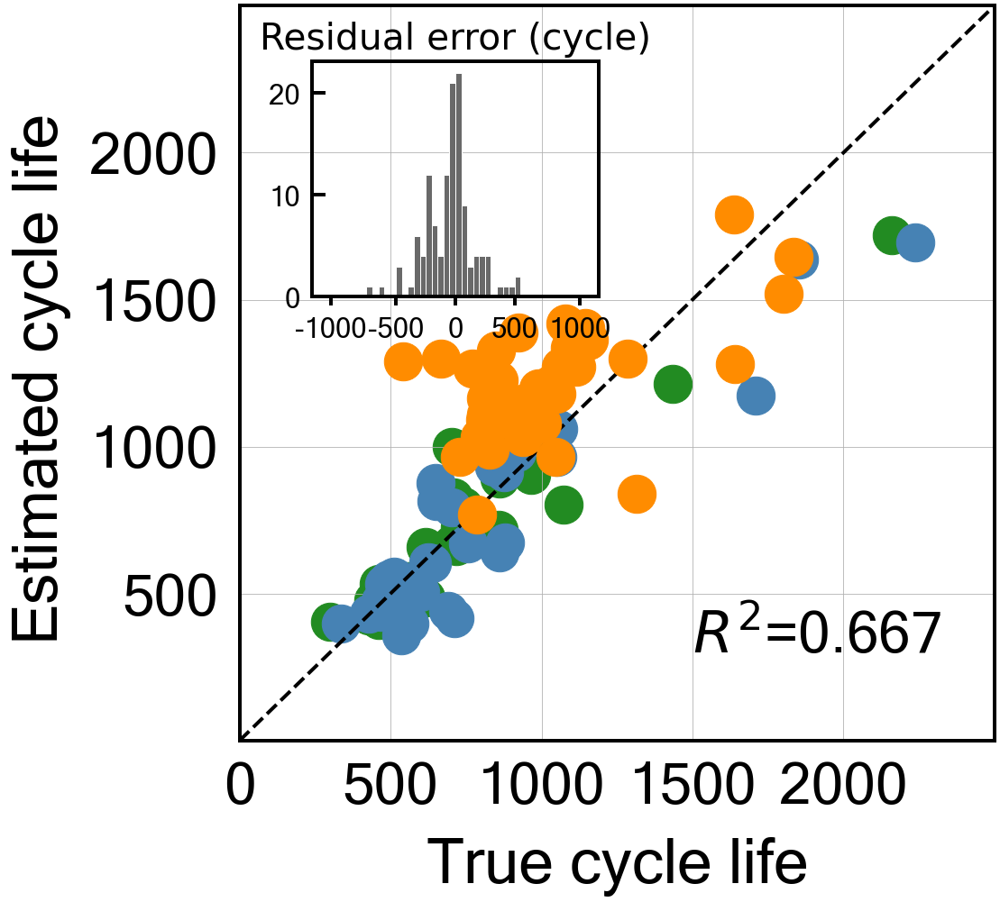


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.5
Best score obtained was: -0.19431825768300093
Cycle no: Average_2to61
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to61') : -0.010972290466145805
T_Q('Charge', 'Skewness', 'Average_2to61') : 0.0061624381296856955
T_Q('Charge', 'Max-Min', 'Average_2to61') : -0.016433012043355035
dTdQ('Charge', 'Maximum', 'Average_2to61') : -0.06869768929091216
dTdQ('Discharge', 'Max-Min', 'Average_2to61') : 0.041646399272791866
nature_dictAvg_charge_time : 0.086053852613519
nature_dictIR_cycle2 : -0.035595490207834285
nature_dictMinT_2to61 : 0.037250388129362336
nature_dictIntegralT_2to61 : -0.022248116995795115

Intercept: 2.793969897643637
r2-score: 0.702
MAE_all: 150.5
MAE_train: 79.6
MAE_test: 105.9
MAE_2ndTest: 270.1
MAPE_all: 17.7 %
MAPE_train: 10.4 %
MAPE_test: 13.0 %
MAPE_2ndTest: 30.2 %
RMSE_all: 213.9
RMSE_train: 121.8
RMSE_test: 164.5
RMSE_2ndTest: 311

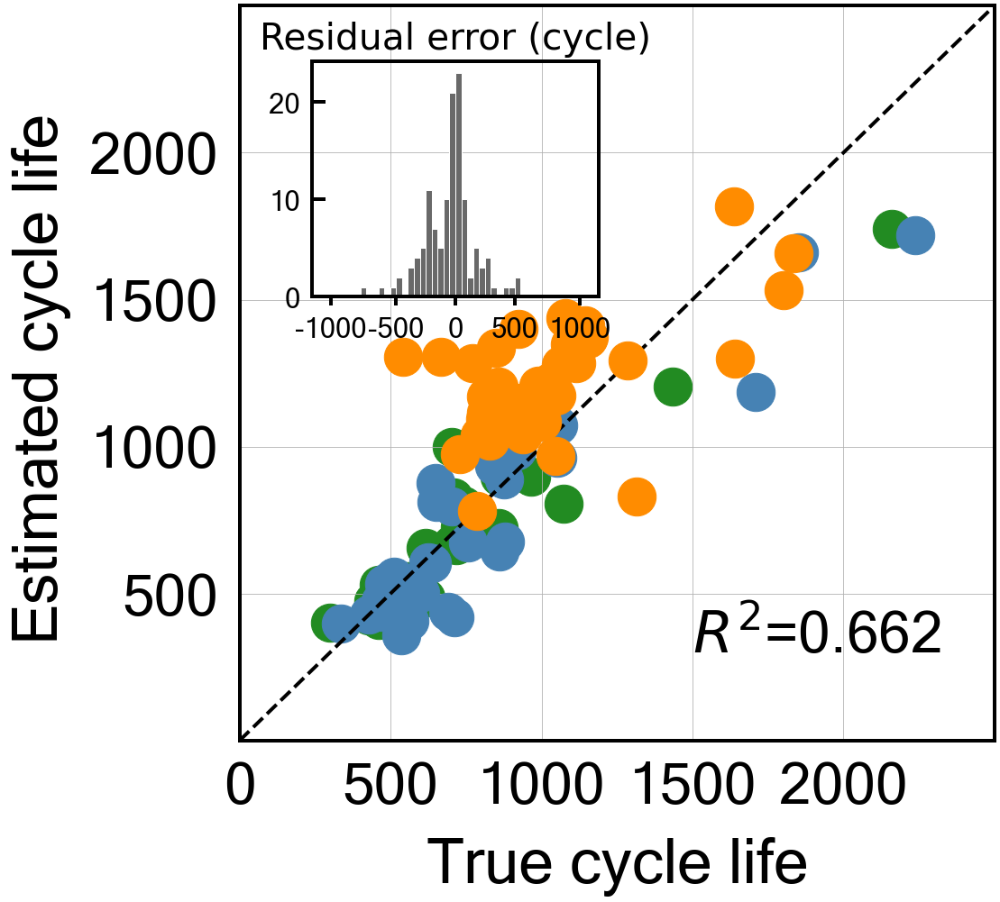


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 6.3
Best score obtained was: -0.1826638853216893
Cycle no: Average_2to62
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to62') : -0.010579106211030464
T_Q('Charge', 'Skewness', 'Average_2to62') : 0.005939349853929537
T_Q('Charge', 'Max-Min', 'Average_2to62') : -0.01442806522660092
dTdQ('Charge', 'Maximum', 'Average_2to62') : -0.06876997303016195
dTdQ('Discharge', 'Max-Min', 'Average_2to62') : 0.04112550015004918
nature_dictAvg_charge_time : 0.08723644526977219
nature_dictIR_cycle2 : -0.03570482532648825
nature_dictMinT_2to62 : 0.03642229074050445
nature_dictIntegralT_2to62 : -0.023266187776626136

Intercept: 2.7939698976436373
r2-score: 0.704
MAE_all: 149.6
MAE_train: 79.4
MAE_test: 105.1
MAE_2ndTest: 268.1
MAPE_all: 17.6 %
MAPE_train: 10.4 %
MAPE_test: 12.9 %
MAPE_2ndTest: 30.0 %
RMSE_all: 213.0
RMSE_train: 121.8
RMSE_test: 163.9
RMSE_2ndTest: 310.1


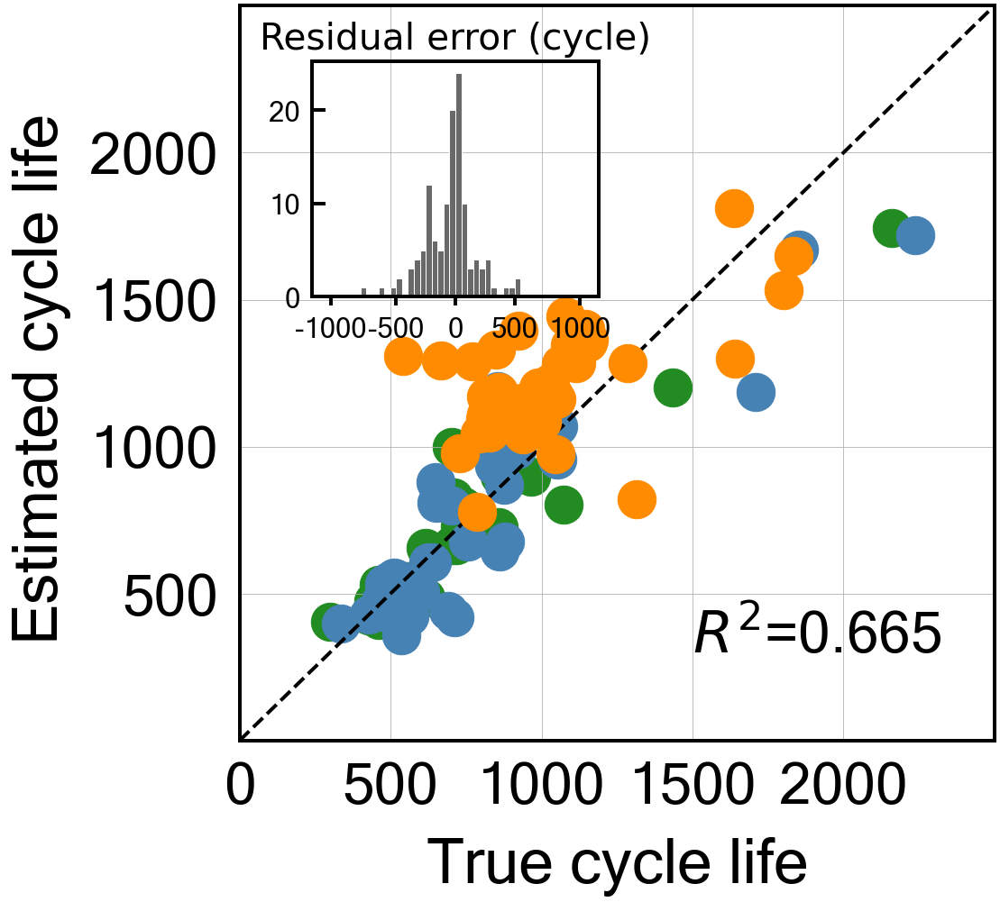


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.9
Best score obtained was: -0.17839696887673573
Cycle no: Average_2to63
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to63') : -0.010165954072247884
T_Q('Charge', 'Skewness', 'Average_2to63') : 0.00581087923784328
T_Q('Charge', 'Max-Min', 'Average_2to63') : -0.014466333283135334
dTdQ('Charge', 'Maximum', 'Average_2to63') : -0.06902644239087845
dTdQ('Discharge', 'Max-Min', 'Average_2to63') : 0.04157150066386666
nature_dictAvg_charge_time : 0.08739212022961751
nature_dictIR_cycle2 : -0.035282971987838425
nature_dictMinT_2to63 : 0.03632581399727599
nature_dictIntegralT_2to63 : -0.023820331955869748

Intercept: 2.793969897643638
r2-score: 0.706
MAE_all: 149.3
MAE_train: 79.2
MAE_test: 104.8
MAE_2ndTest: 268.0
MAPE_all: 17.6 %
MAPE_train: 10.3 %
MAPE_test: 12.8 %
MAPE_2ndTest: 30.0 %
RMSE_all: 212.6
RMSE_train: 121.6
RMSE_test: 163.4
RMSE_2ndTest: 309.5

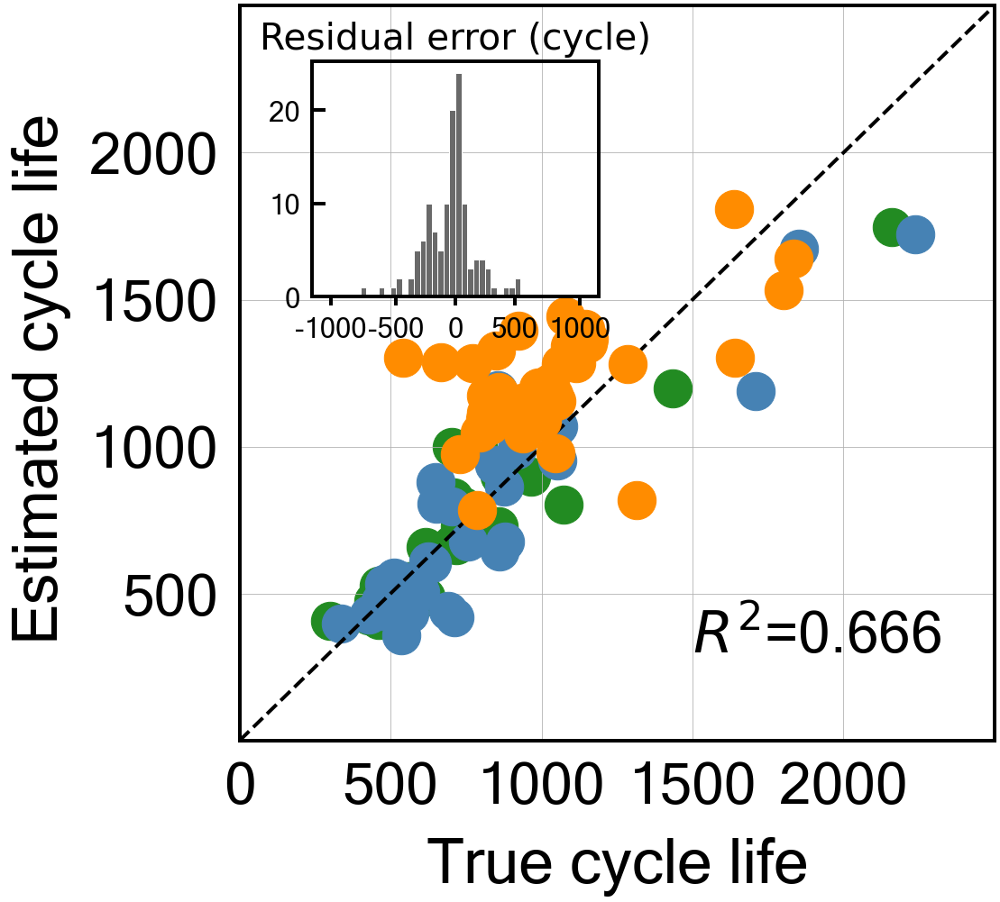


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.4
Best score obtained was: -0.16845107502444923
Cycle no: Average_2to64
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to64') : -0.0066925951345165255
T_Q('Charge', 'Skewness', 'Average_2to64') : 0.005280278052592038
T_Q('Charge', 'Max-Min', 'Average_2to64') : -0.017299113015859274
dTdQ('Charge', 'Maximum', 'Average_2to64') : -0.06792519519169901
dTdQ('Discharge', 'Max-Min', 'Average_2to64') : 0.040814742971709374
nature_dictAvg_charge_time : 0.08780161052766894
nature_dictIR_cycle2 : -0.03522998715551933
nature_dictMinT_2to64 : 0.0361762195102498
nature_dictIntegralT_2to64 : -0.0244366615503331

Intercept: 2.793969897643637
r2-score: 0.707
MAE_all: 148.9
MAE_train: 79.2
MAE_test: 104.9
MAE_2ndTest: 266.6
MAPE_all: 17.5 %
MAPE_train: 10.3 %
MAPE_test: 12.8 %
MAPE_2ndTest: 29.8 %
RMSE_all: 212.2
RMSE_train: 122.1
RMSE_test: 164.0
RMSE_2ndTest: 308.2


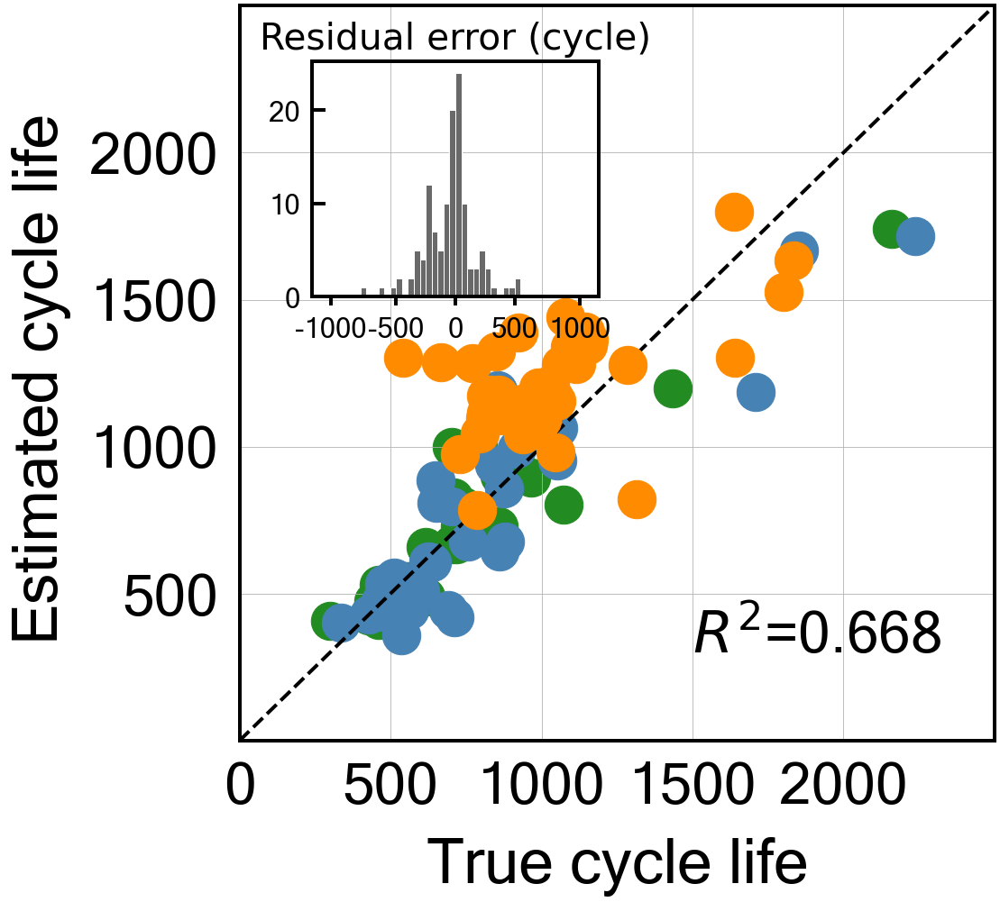


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: -0.16516733471977485
Cycle no: Average_2to65
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to65') : -0.009887648903909469
T_Q('Charge', 'Skewness', 'Average_2to65') : 0.006576687370836375
T_Q('Charge', 'Max-Min', 'Average_2to65') : -0.012150527126342852
dTdQ('Charge', 'Maximum', 'Average_2to65') : -0.06911555719415685
dTdQ('Discharge', 'Max-Min', 'Average_2to65') : 0.040702134416180556
nature_dictAvg_charge_time : 0.08862281047669655
nature_dictIR_cycle2 : -0.0351282920599867
nature_dictMinT_2to65 : 0.035867978350036626
nature_dictIntegralT_2to65 : -0.02467439177709085

Intercept: 2.7939698976436373
r2-score: 0.709
MAE_all: 148.2
MAE_train: 78.9
MAE_test: 104.1
MAE_2ndTest: 265.6
MAPE_all: 17.4 %
MAPE_train: 10.2 %
MAPE_test: 12.7 %
MAPE_2ndTest: 29.7 %
RMSE_all: 211.6
RMSE_train: 121.8
RMSE_test: 162.5
RMSE_2ndTest: 307.

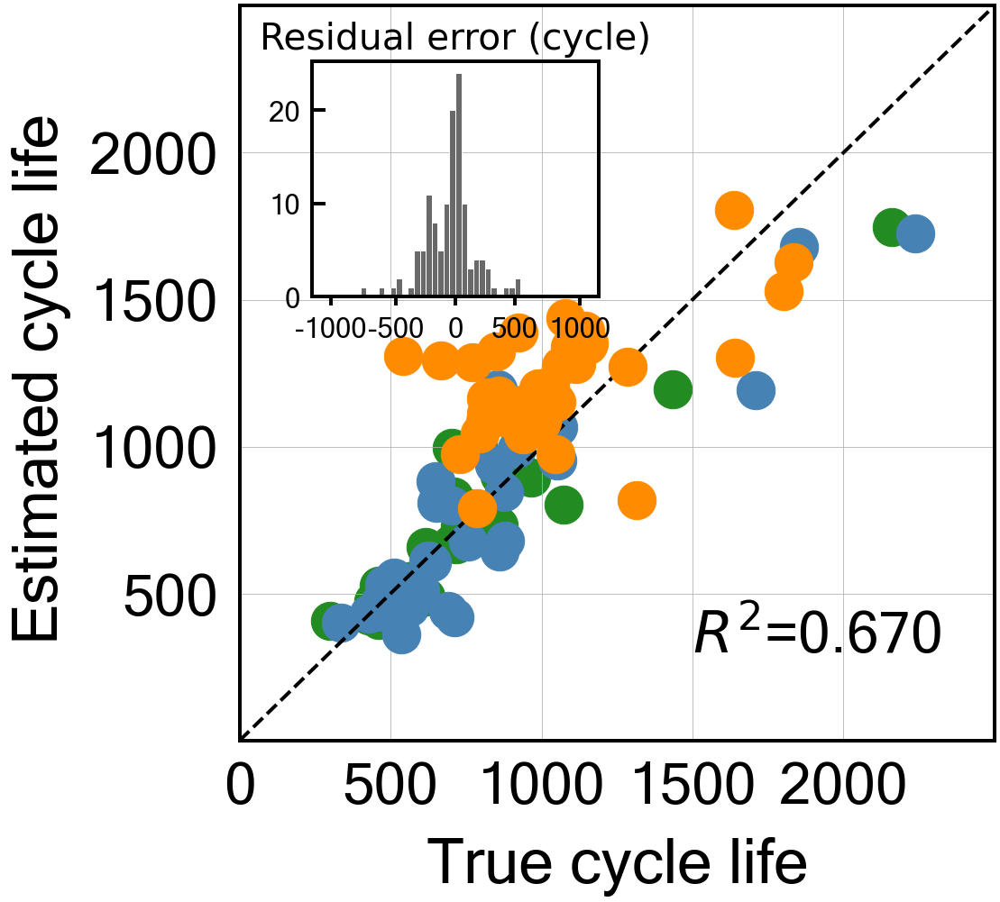


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.5
Best score obtained was: -0.16022170105588396
Cycle no: Average_2to66
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to66') : -0.00956030915509309
T_Q('Charge', 'Skewness', 'Average_2to66') : 0.006979510274571361
T_Q('Charge', 'Max-Min', 'Average_2to66') : -0.012310221147900001
dTdQ('Charge', 'Maximum', 'Average_2to66') : -0.06946023679957324
dTdQ('Discharge', 'Max-Min', 'Average_2to66') : 0.041621864772529125
nature_dictAvg_charge_time : 0.08856921244384484
nature_dictIR_cycle2 : -0.03499923051030779
nature_dictMinT_2to66 : 0.03511187352074919
nature_dictIntegralT_2to66 : -0.02521965859608154

Intercept: 2.7939698976436373
r2-score: 0.711
MAE_all: 147.9
MAE_train: 78.6
MAE_test: 103.7
MAE_2ndTest: 265.2
MAPE_all: 17.4 %
MAPE_train: 10.2 %
MAPE_test: 12.7 %
MAPE_2ndTest: 29.7 %
RMSE_all: 211.0
RMSE_train: 121.6
RMSE_test: 161.6
RMSE_2ndTest: 307.1

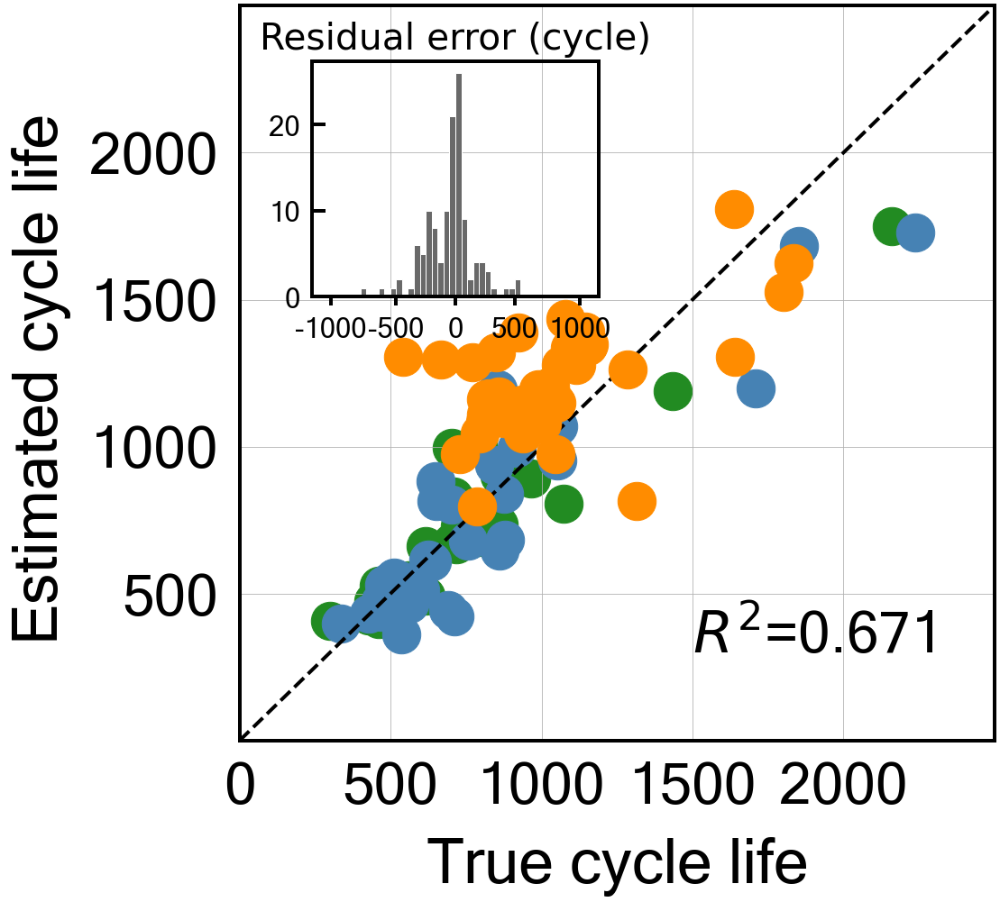


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.5
Best score obtained was: -0.1580018969762409
Cycle no: Average_2to67
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to67') : -0.007666882487698284
T_Q('Charge', 'Skewness', 'Average_2to67') : 0.0067714194586957896
T_Q('Charge', 'Max-Min', 'Average_2to67') : -0.014878770378425946
dTdQ('Charge', 'Maximum', 'Average_2to67') : -0.06935027226245981
dTdQ('Discharge', 'Max-Min', 'Average_2to67') : 0.04260722816359127
nature_dictAvg_charge_time : 0.08826710651893807
nature_dictIR_cycle2 : -0.034900413239258916
nature_dictMinT_2to67 : 0.03468976704286424
nature_dictIntegralT_2to67 : -0.025530766945933526

Intercept: 2.793969897643637
r2-score: 0.712
MAE_all: 147.5
MAE_train: 78.3
MAE_test: 102.8
MAE_2ndTest: 265.3
MAPE_all: 17.3 %
MAPE_train: 10.1 %
MAPE_test: 12.5 %
MAPE_2ndTest: 29.7 %
RMSE_all: 210.5
RMSE_train: 121.4
RMSE_test: 160.4
RMSE_2ndTest: 306.

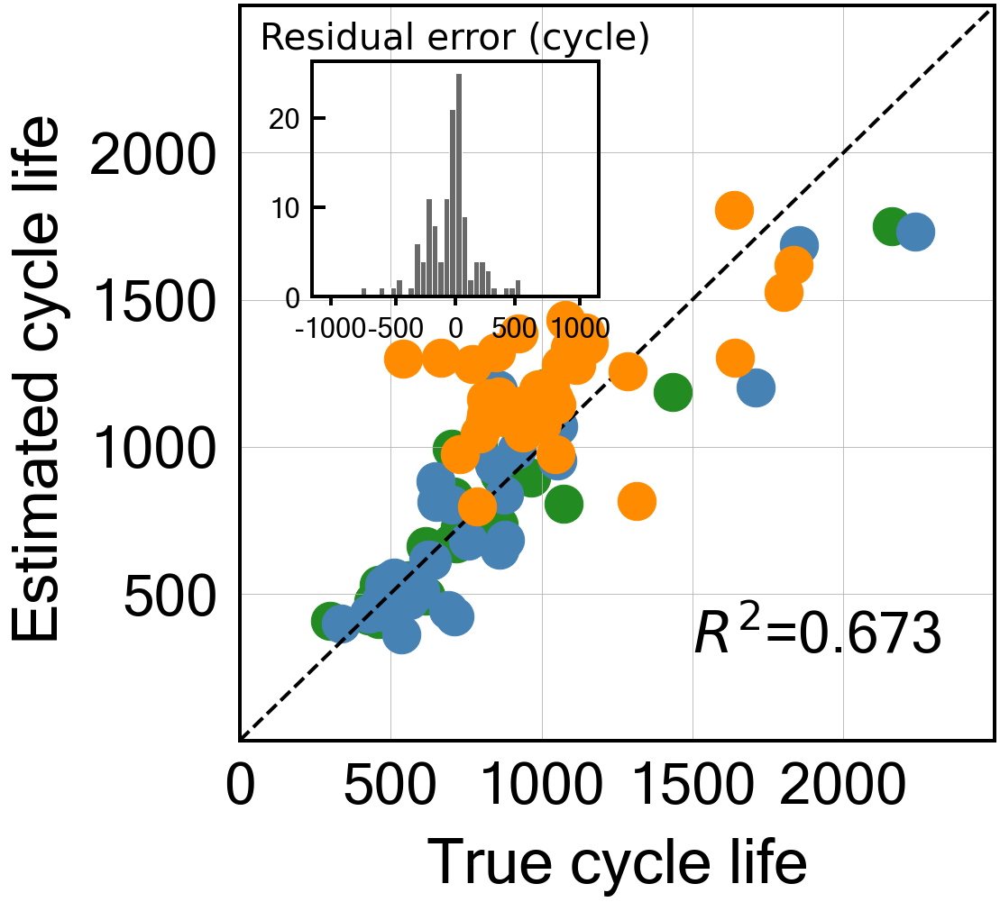


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: -0.17287267598053235
Cycle no: Average_2to68
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to68') : -0.006793566988246489
T_Q('Charge', 'Skewness', 'Average_2to68') : 0.006956656966830362
T_Q('Charge', 'Max-Min', 'Average_2to68') : -0.0160010584416321
dTdQ('Charge', 'Maximum', 'Average_2to68') : -0.06879459577288029
dTdQ('Discharge', 'Max-Min', 'Average_2to68') : 0.04283494289495645
nature_dictAvg_charge_time : 0.08797541475651402
nature_dictIR_cycle2 : -0.03567625703921294
nature_dictMinT_2to68 : 0.034142890341337065
nature_dictIntegralT_2to68 : -0.025288459882936504

Intercept: 2.7939698976436373
r2-score: 0.710
MAE_all: 147.8
MAE_train: 78.6
MAE_test: 102.5
MAE_2ndTest: 266.4
MAPE_all: 17.4 %
MAPE_train: 10.2 %
MAPE_test: 12.5 %
MAPE_2ndTest: 29.8 %
RMSE_all: 211.4
RMSE_train: 122.1
RMSE_test: 159.9
RMSE_2ndTest: 308.8

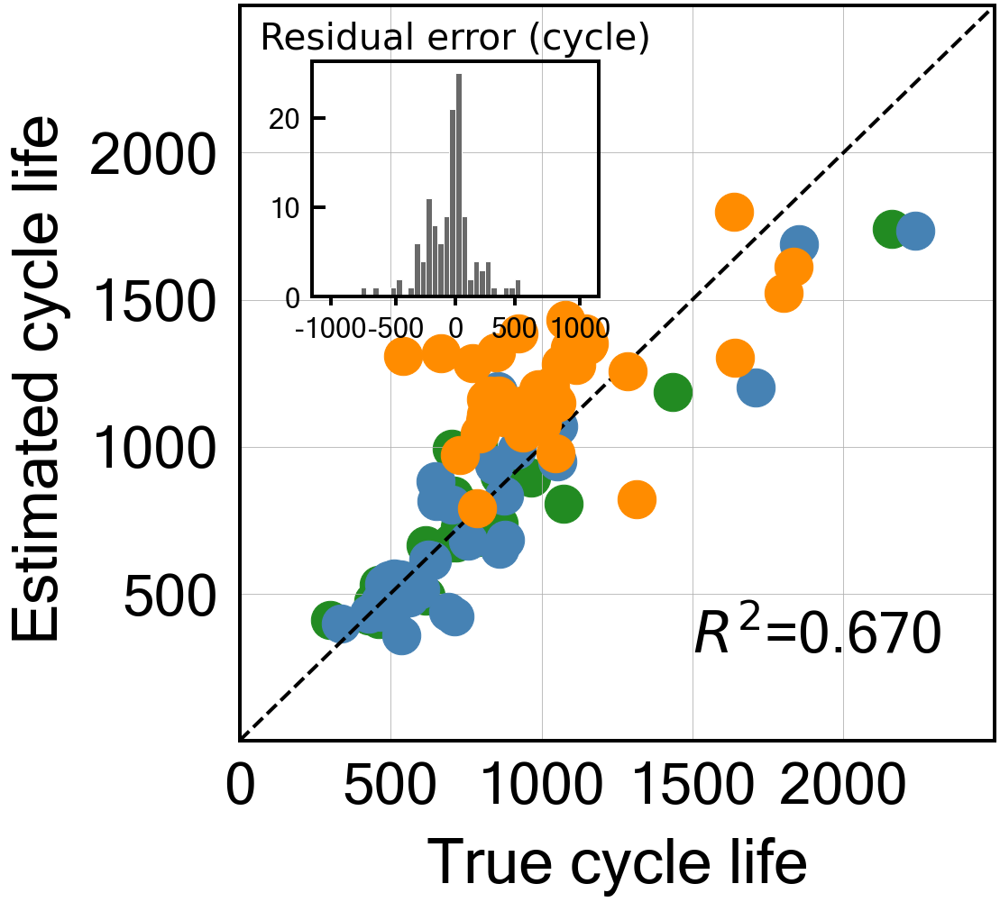


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.6
Best score obtained was: -0.17834772475459615
Cycle no: Average_2to69
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to69') : -0.0070440592478655546
T_Q('Charge', 'Skewness', 'Average_2to69') : 0.006880349941071915
T_Q('Charge', 'Max-Min', 'Average_2to69') : -0.01448422662661434
dTdQ('Charge', 'Maximum', 'Average_2to69') : -0.06869513136604445
dTdQ('Discharge', 'Max-Min', 'Average_2to69') : 0.042341454902865096
nature_dictAvg_charge_time : 0.08864789662850898
nature_dictIR_cycle2 : -0.0357858269534762
nature_dictMinT_2to69 : 0.03388567008445357
nature_dictIntegralT_2to69 : -0.02590367914578764

Intercept: 2.793969897643637
r2-score: 0.710
MAE_all: 147.7
MAE_train: 78.7
MAE_test: 102.0
MAE_2ndTest: 266.3
MAPE_all: 17.4 %
MAPE_train: 10.2 %
MAPE_test: 12.4 %
MAPE_2ndTest: 29.8 %
RMSE_all: 211.6
RMSE_train: 121.9
RMSE_test: 159.3
RMSE_2ndTest: 309.5


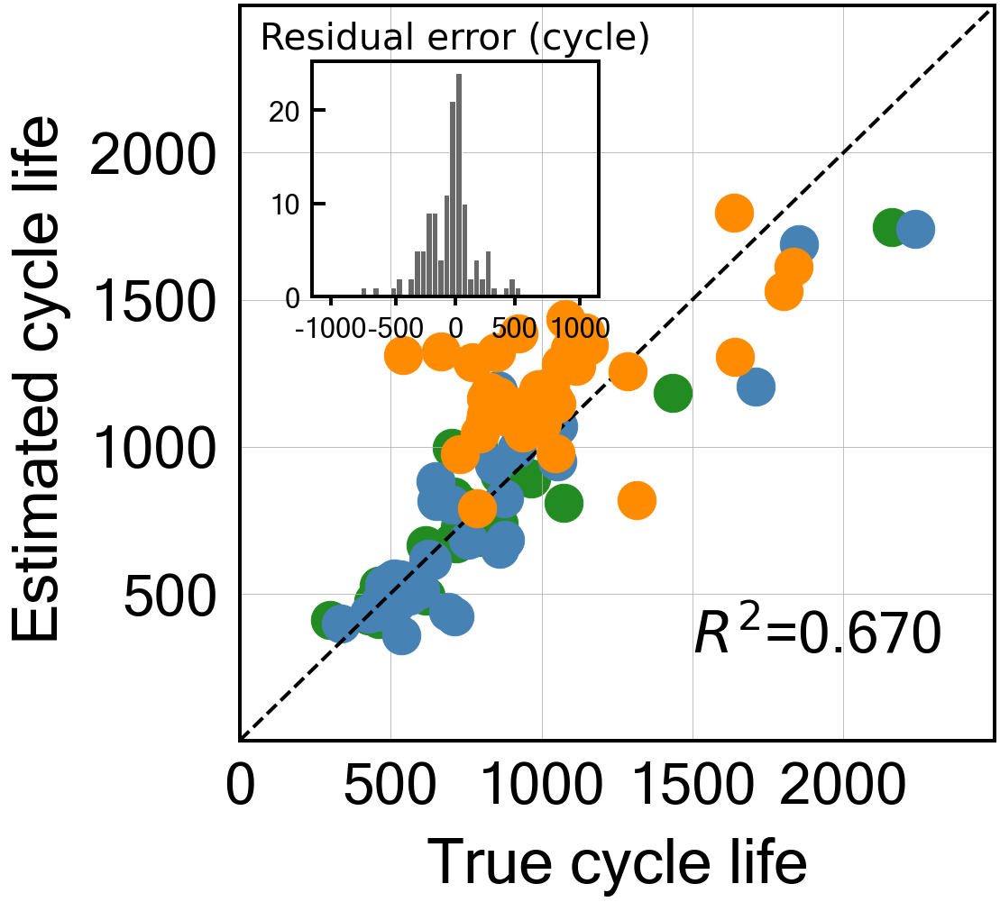


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: -0.19750671721420154
Cycle no: Average_2to70
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to70') : -0.005788204561176596
T_Q('Charge', 'Skewness', 'Average_2to70') : 0.007201891700398552
T_Q('Charge', 'Max-Min', 'Average_2to70') : -0.014007036871235012
dTdQ('Charge', 'Maximum', 'Average_2to70') : -0.06863798629769498
dTdQ('Discharge', 'Max-Min', 'Average_2to70') : 0.041160330091213955
nature_dictAvg_charge_time : 0.08908376006922122
nature_dictIR_cycle2 : -0.03564297845630904
nature_dictMinT_2to70 : 0.03410205892777412
nature_dictIntegralT_2to70 : -0.026529599039983916

Intercept: 2.7939698976436373
r2-score: 0.708
MAE_all: 148.2
MAE_train: 78.9
MAE_test: 101.7
MAE_2ndTest: 268.2
MAPE_all: 17.4 %
MAPE_train: 10.2 %
MAPE_test: 12.4 %
MAPE_2ndTest: 30.1 %
RMSE_all: 212.9
RMSE_train: 122.2
RMSE_test: 159.5
RMSE_2ndTest: 312

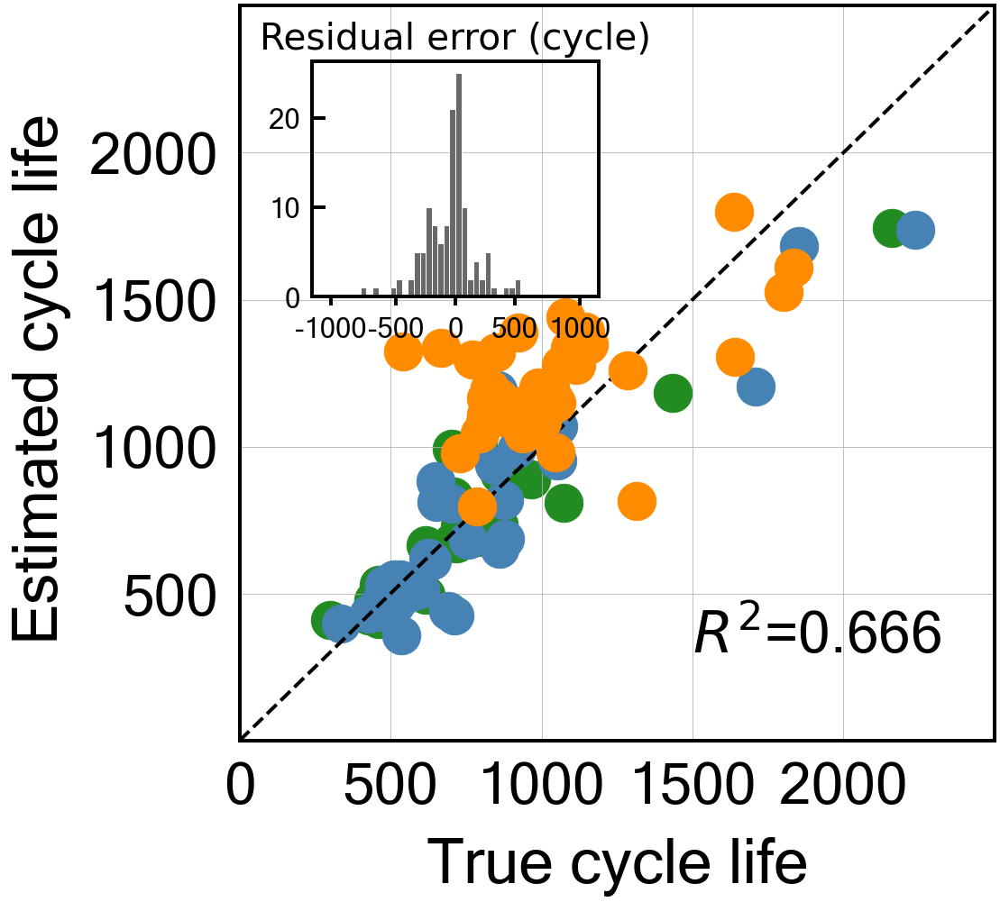


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.3
Best score obtained was: -0.20136418655133226
Cycle no: Average_2to71
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to71') : -0.0040302593586315025
T_Q('Charge', 'Skewness', 'Average_2to71') : 0.007035887522283774
T_Q('Charge', 'Max-Min', 'Average_2to71') : -0.014992519549132615
dTdQ('Charge', 'Maximum', 'Average_2to71') : -0.06790994053969468
dTdQ('Discharge', 'Max-Min', 'Average_2to71') : 0.04038725028502317
nature_dictAvg_charge_time : 0.08936302966804381
nature_dictIR_cycle2 : -0.03555038880477121
nature_dictMinT_2to71 : 0.033979620065476515
nature_dictIntegralT_2to71 : -0.027078786010858544

Intercept: 2.7939698976436373
r2-score: 0.707
MAE_all: 148.4
MAE_train: 79.1
MAE_test: 102.1
MAE_2ndTest: 268.0
MAPE_all: 17.4 %
MAPE_train: 10.3 %
MAPE_test: 12.4 %
MAPE_2ndTest: 30.1 %
RMSE_all: 213.4
RMSE_train: 122.4
RMSE_test: 160.3
RMSE_2ndTest: 31

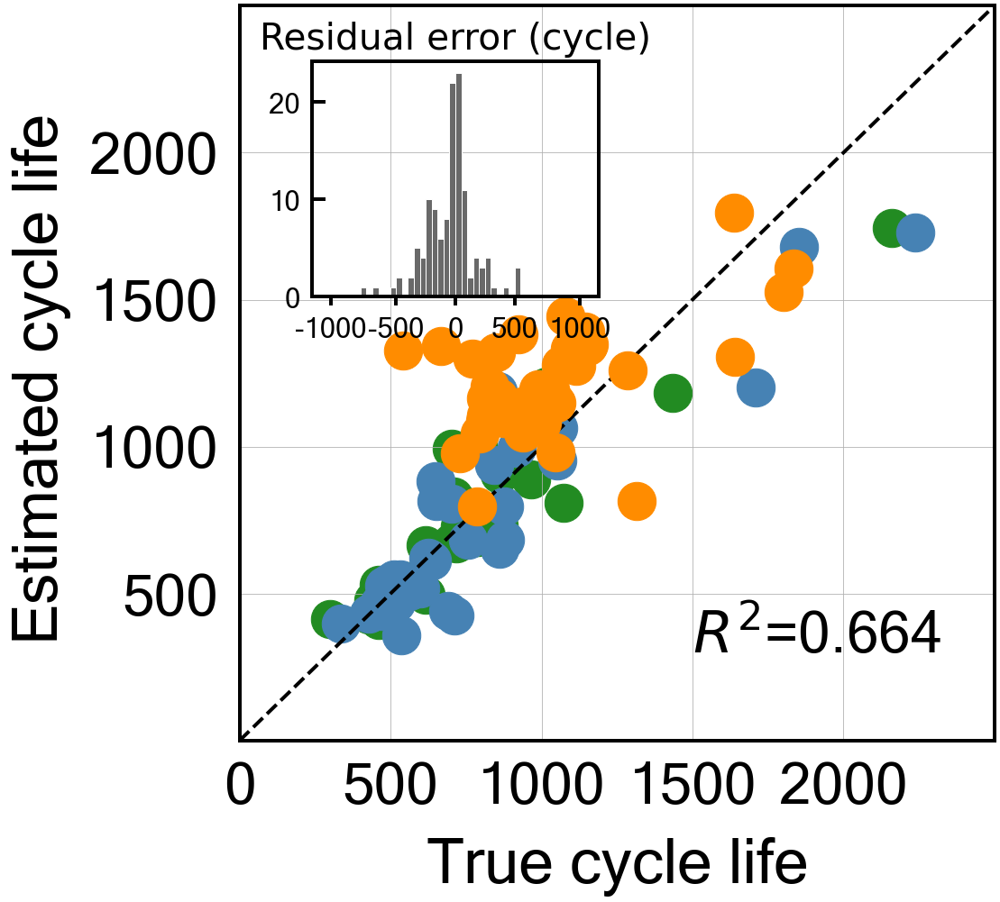


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.6
Best score obtained was: -0.2040525640834654
Cycle no: Average_2to72
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to72') : -0.0029258677108144255
T_Q('Charge', 'Skewness', 'Average_2to72') : 0.0075029243178803065
T_Q('Charge', 'Max-Min', 'Average_2to72') : -0.014898850402744641
dTdQ('Charge', 'Maximum', 'Average_2to72') : -0.06852002972193927
dTdQ('Discharge', 'Max-Min', 'Average_2to72') : 0.040873015185958976
nature_dictAvg_charge_time : 0.08963526147842202
nature_dictIR_cycle2 : -0.035407985219365834
nature_dictMinT_2to72 : 0.03317926461779085
nature_dictIntegralT_2to72 : -0.028109522188935417

Intercept: 2.7939698976436373
r2-score: 0.708
MAE_all: 148.2
MAE_train: 78.9
MAE_test: 101.7
MAE_2ndTest: 268.0
MAPE_all: 17.4 %
MAPE_train: 10.2 %
MAPE_test: 12.3 %
MAPE_2ndTest: 30.1 %
RMSE_all: 213.2
RMSE_train: 122.0
RMSE_test: 159.3
RMSE_2ndTest: 3

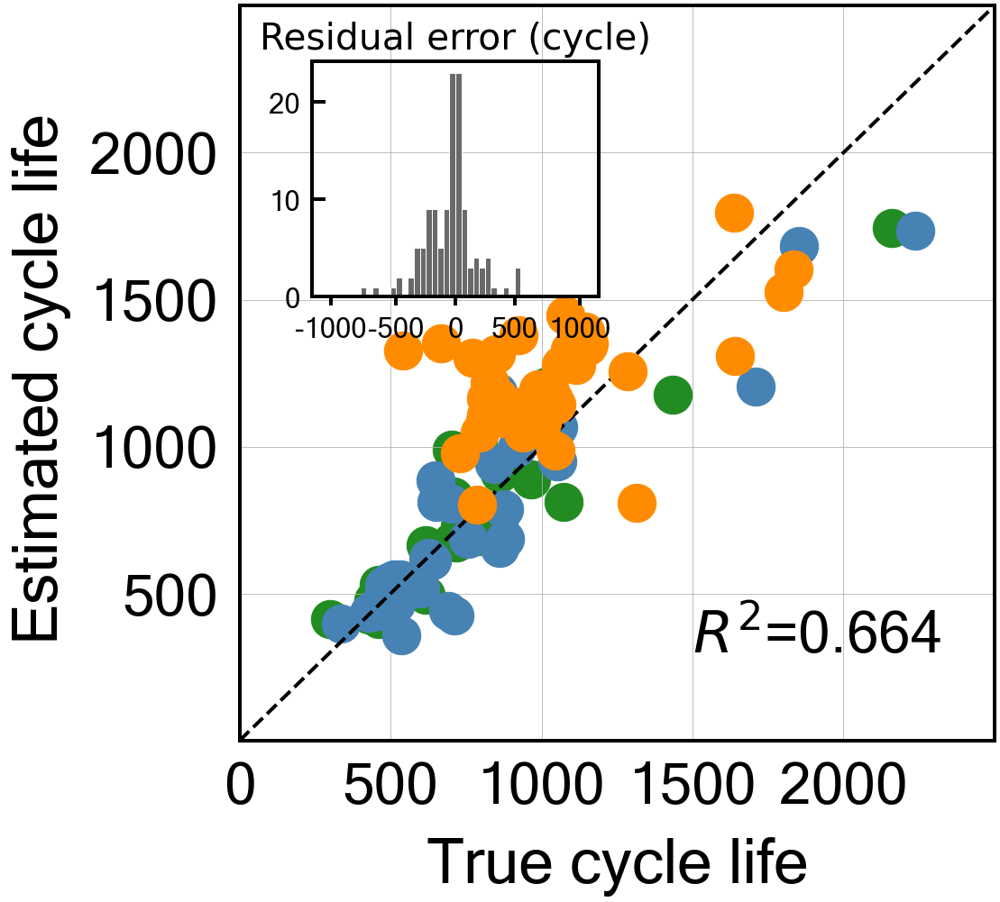


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.5
Best score obtained was: -0.2110306290394357
Cycle no: Average_2to73
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to73') : -0.001351276674084865
T_Q('Charge', 'Skewness', 'Average_2to73') : 0.007836530390317325
T_Q('Charge', 'Max-Min', 'Average_2to73') : -0.01484763023687135
dTdQ('Charge', 'Maximum', 'Average_2to73') : -0.06846270507338639
dTdQ('Discharge', 'Max-Min', 'Average_2to73') : 0.040045615266207354
nature_dictAvg_charge_time : 0.09020385910430052
nature_dictIR_cycle2 : -0.035279383708046425
nature_dictMinT_2to73 : 0.033086397792853384
nature_dictIntegralT_2to73 : -0.028898413066184587

Intercept: 2.7939698976436373
r2-score: 0.707
MAE_all: 148.3
MAE_train: 78.9
MAE_test: 101.7
MAE_2ndTest: 268.2
MAPE_all: 17.4 %
MAPE_train: 10.2 %
MAPE_test: 12.3 %
MAPE_2ndTest: 30.1 %
RMSE_all: 213.6
RMSE_train: 121.9
RMSE_test: 159.3
RMSE_2ndTest: 313

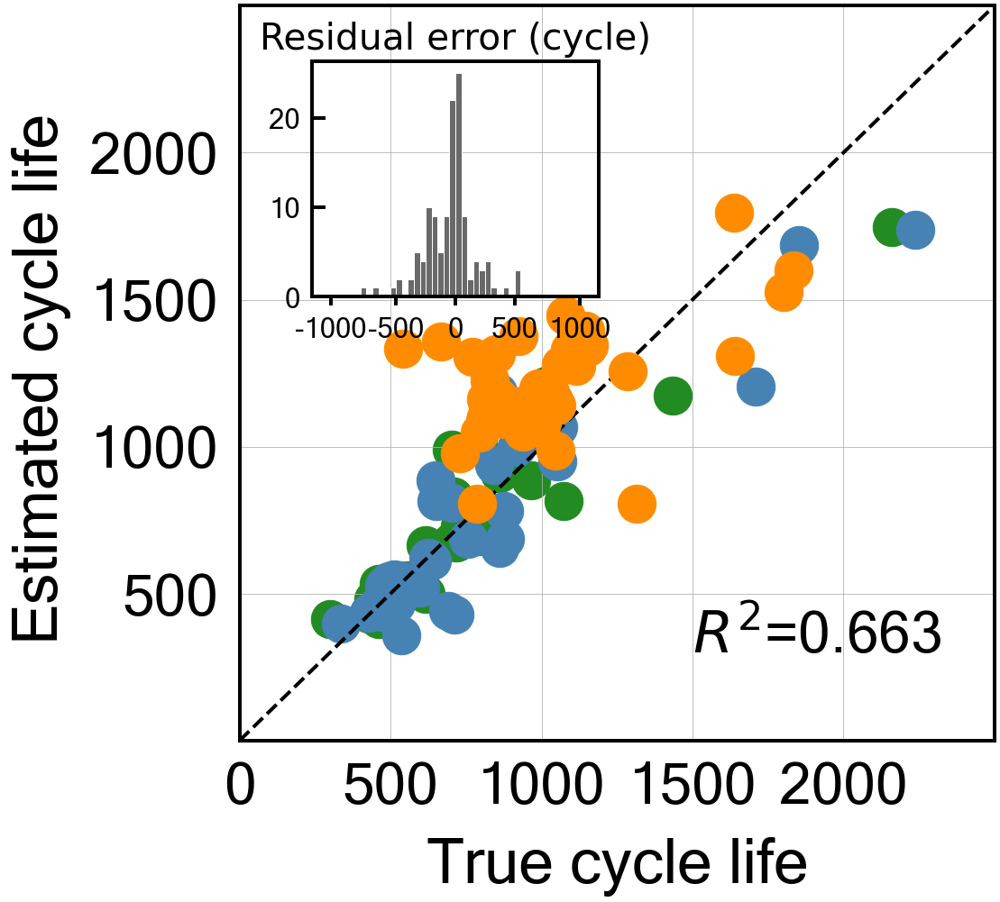


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: -0.2085463903707847
Cycle no: Average_2to74
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to74') : -0.0008539270309637321
T_Q('Charge', 'Skewness', 'Average_2to74') : 0.008313849133214613
T_Q('Charge', 'Max-Min', 'Average_2to74') : -0.014462275147517946
dTdQ('Charge', 'Maximum', 'Average_2to74') : -0.06868834362039425
dTdQ('Discharge', 'Max-Min', 'Average_2to74') : 0.04034484617097508
nature_dictAvg_charge_time : 0.09053108589403629
nature_dictIR_cycle2 : -0.03536414730655761
nature_dictMinT_2to74 : 0.03237366441541817
nature_dictIntegralT_2to74 : -0.029307513657795325

Intercept: 2.793969897643637
r2-score: 0.708
MAE_all: 147.8
MAE_train: 78.8
MAE_test: 101.3
MAE_2ndTest: 267.3
MAPE_all: 17.4 %
MAPE_train: 10.2 %
MAPE_test: 12.3 %
MAPE_2ndTest: 30.0 %
RMSE_all: 213.2
RMSE_train: 121.7
RMSE_test: 158.6
RMSE_2ndTest: 313.4

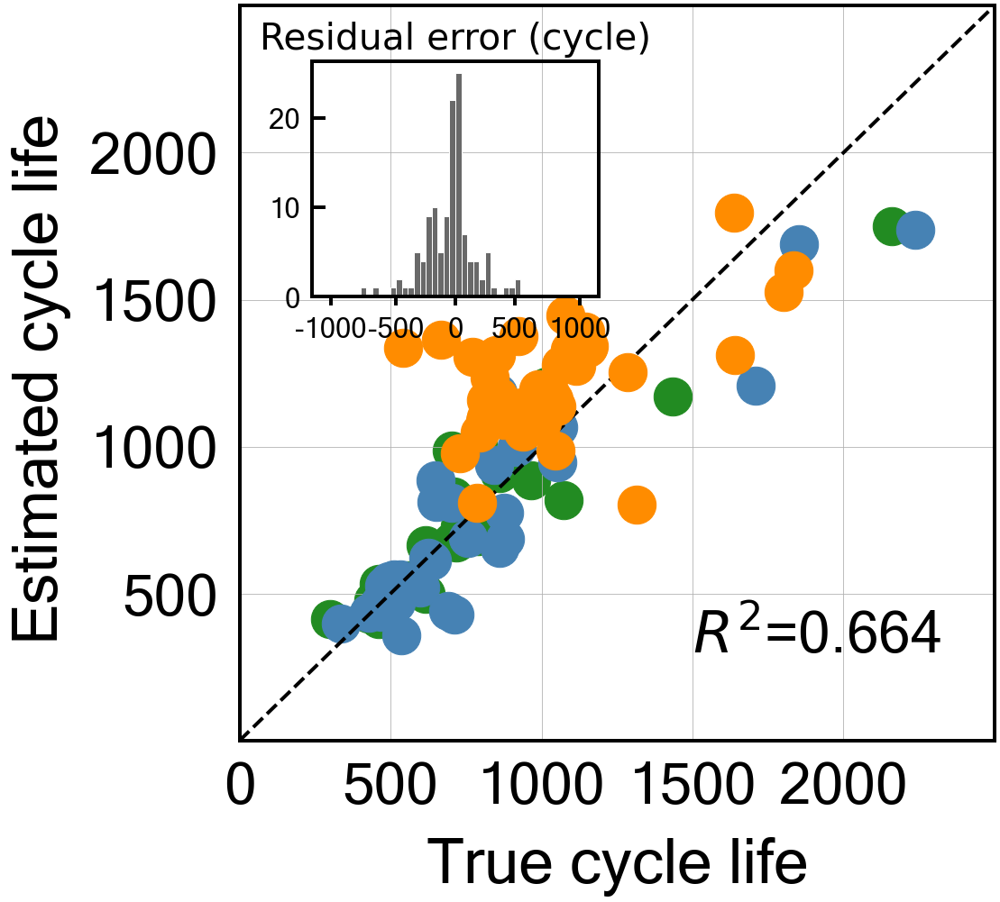


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: -0.2208177587384721
Cycle no: Average_2to75
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to75') : -0.0005952571164392622
T_Q('Charge', 'Skewness', 'Average_2to75') : 0.008840517239093845
T_Q('Charge', 'Max-Min', 'Average_2to75') : -0.01342563230013548
dTdQ('Charge', 'Maximum', 'Average_2to75') : -0.06930248116823612
dTdQ('Discharge', 'Max-Min', 'Average_2to75') : 0.04000667353308509
nature_dictAvg_charge_time : 0.09092580056116178
nature_dictIR_cycle2 : -0.03515460588880722
nature_dictMinT_2to75 : 0.0323773015399489
nature_dictIntegralT_2to75 : -0.029685502897213157

Intercept: 2.7939698976436373
r2-score: 0.707
MAE_all: 147.8
MAE_train: 78.5
MAE_test: 100.8
MAE_2ndTest: 268.3
MAPE_all: 17.4 %
MAPE_train: 10.2 %
MAPE_test: 12.2 %
MAPE_2ndTest: 30.2 %
RMSE_all: 213.8
RMSE_train: 121.0
RMSE_test: 158.4
RMSE_2ndTest: 315.0


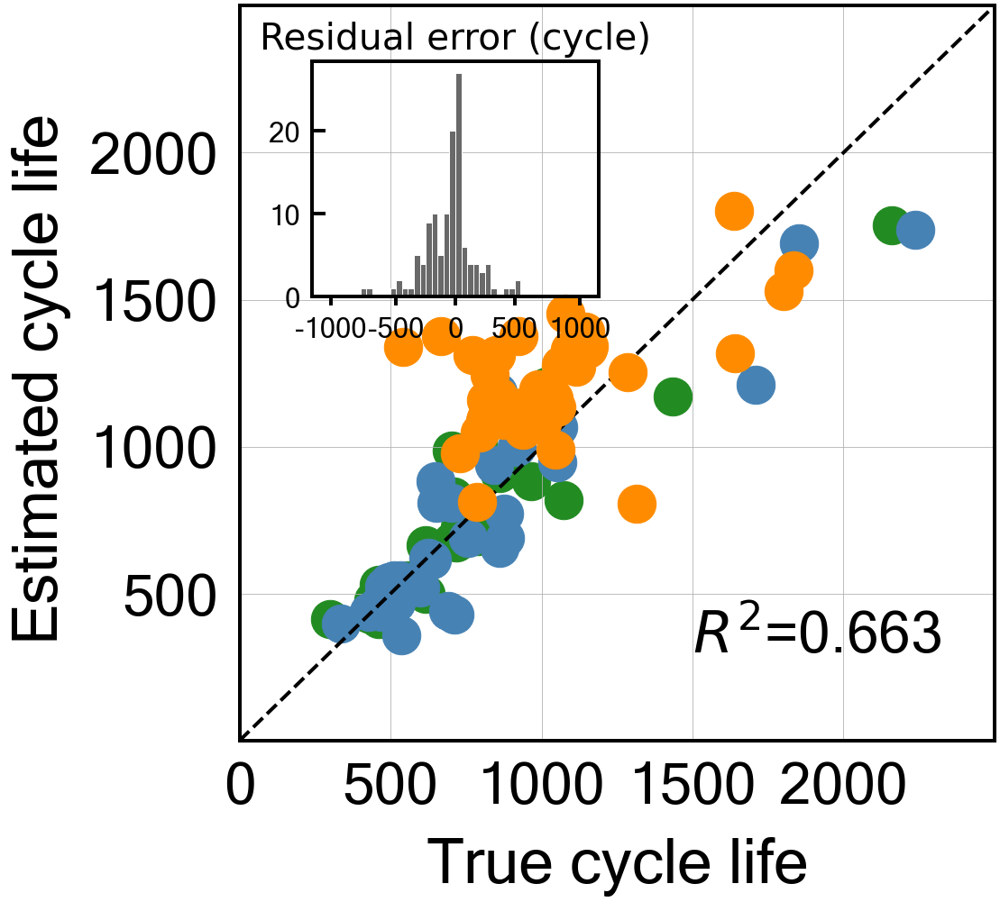


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.4
Best score obtained was: -0.2400354905754445
Cycle no: Average_2to76
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to76') : -0.00030207967373098026
T_Q('Charge', 'Skewness', 'Average_2to76') : 0.009073413778274718
T_Q('Charge', 'Max-Min', 'Average_2to76') : -0.011333343341549621
dTdQ('Charge', 'Maximum', 'Average_2to76') : -0.06964781688131137
dTdQ('Discharge', 'Max-Min', 'Average_2to76') : 0.03936109975606008
nature_dictAvg_charge_time : 0.09203018192698866
nature_dictIR_cycle2 : -0.03520091442492876
nature_dictMinT_2to76 : 0.032254516676179616
nature_dictIntegralT_2to76 : -0.03060224671103214

Intercept: 2.7939698976436373
r2-score: 0.705
MAE_all: 148.2
MAE_train: 78.7
MAE_test: 100.5
MAE_2ndTest: 269.4
MAPE_all: 17.4 %
MAPE_train: 10.2 %
MAPE_test: 12.1 %
MAPE_2ndTest: 30.3 %
RMSE_all: 215.0
RMSE_train: 121.2
RMSE_test: 158.2
RMSE_2ndTest: 317

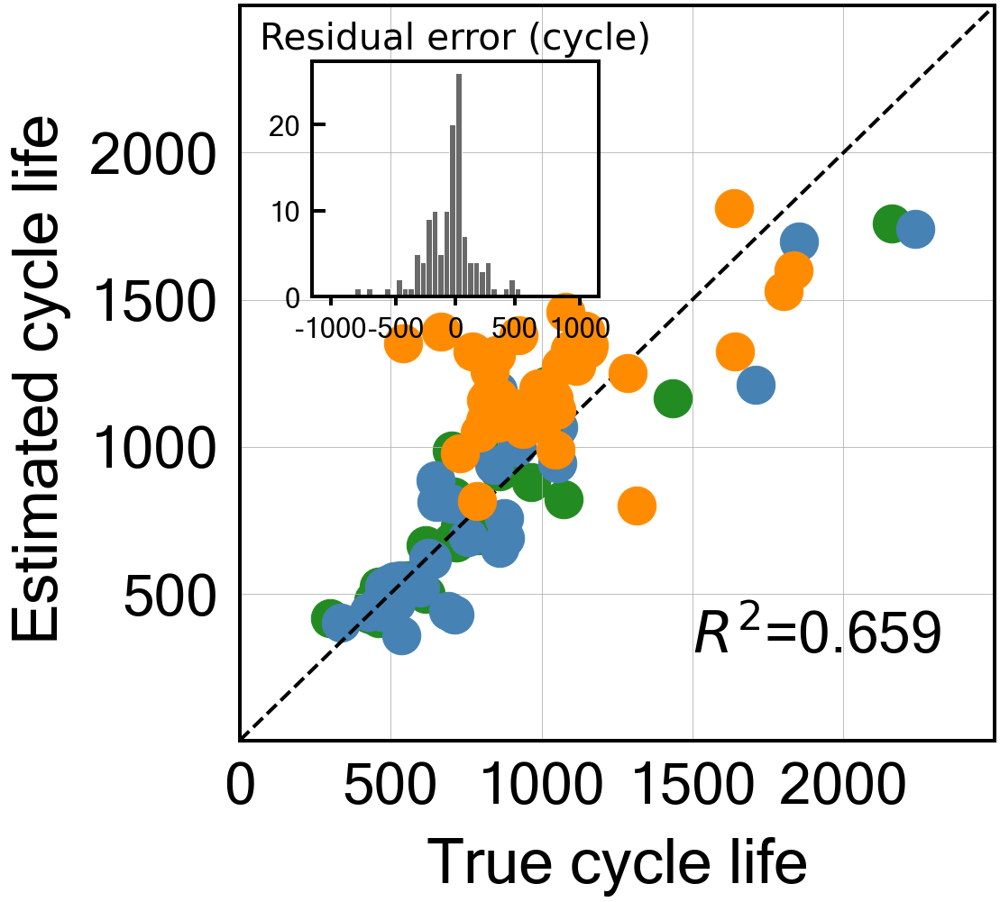


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.9
Best score obtained was: -0.24044462631103491
Cycle no: Average_2to77
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to77') : -0.0002726198184419455
T_Q('Charge', 'Skewness', 'Average_2to77') : 0.008776180164668797
T_Q('Charge', 'Max-Min', 'Average_2to77') : -0.011450342627576547
dTdQ('Charge', 'Maximum', 'Average_2to77') : -0.06880513417297532
dTdQ('Discharge', 'Max-Min', 'Average_2to77') : 0.038428894505754825
nature_dictAvg_charge_time : 0.09160295696828055
nature_dictIR_cycle2 : -0.03496094768160394
nature_dictMinT_2to77 : 0.03259352123274033
nature_dictIntegralT_2to77 : -0.030744697406961684

Intercept: 2.7939698976436373
r2-score: 0.705
MAE_all: 148.1
MAE_train: 78.8
MAE_test: 100.1
MAE_2ndTest: 269.5
MAPE_all: 17.4 %
MAPE_train: 10.2 %
MAPE_test: 12.0 %
MAPE_2ndTest: 30.4 %
RMSE_all: 215.2
RMSE_train: 121.6
RMSE_test: 158.5
RMSE_2ndTest: 31

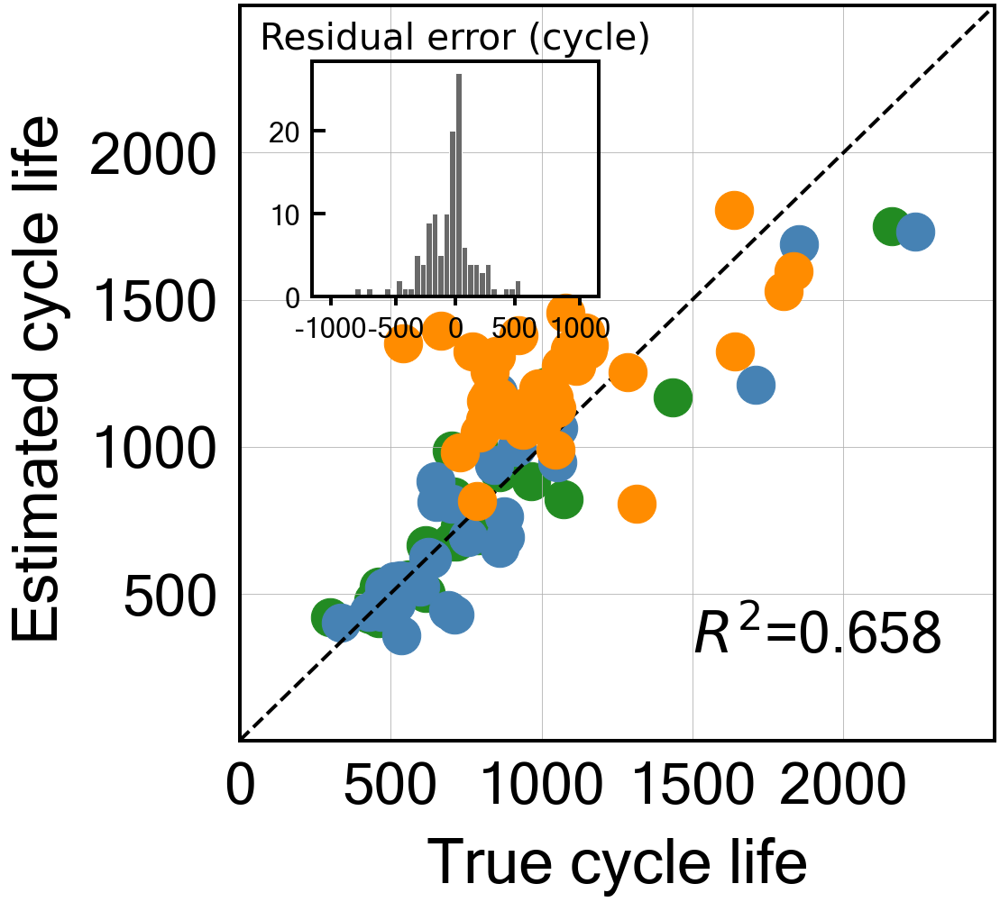


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.3
Best score obtained was: -0.24406831055419076
Cycle no: Average_2to78
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to78') : 3.158538186841068e-05
T_Q('Charge', 'Skewness', 'Average_2to78') : 0.009168386322578043
T_Q('Charge', 'Max-Min', 'Average_2to78') : -0.009918413661774605
dTdQ('Charge', 'Maximum', 'Average_2to78') : -0.06848163245363151
dTdQ('Discharge', 'Max-Min', 'Average_2to78') : 0.03729681330408694
nature_dictAvg_charge_time : 0.09235199507004725
nature_dictIR_cycle2 : -0.03501097228457599
nature_dictMinT_2to78 : 0.03252482843817483
nature_dictIntegralT_2to78 : -0.031226245975327586

Intercept: 2.793969897643637
r2-score: 0.704
MAE_all: 147.9
MAE_train: 78.9
MAE_test: 100.2
MAE_2ndTest: 268.6
MAPE_all: 17.4 %
MAPE_train: 10.2 %
MAPE_test: 12.1 %
MAPE_2ndTest: 30.3 %
RMSE_all: 215.5
RMSE_train: 122.3
RMSE_test: 158.6
RMSE_2ndTest: 318.0

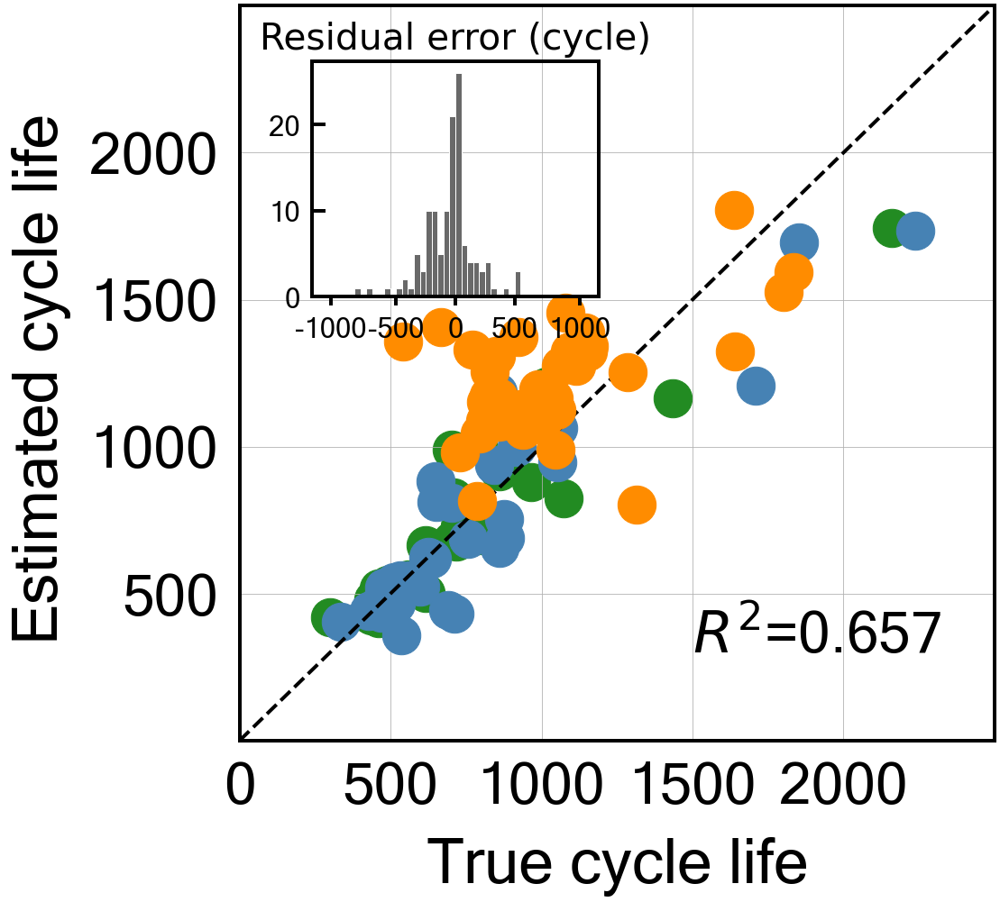


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.3
Best score obtained was: -0.2356526612219454
Cycle no: Average_2to79
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to79') : 0.0007578543984882317
T_Q('Charge', 'Skewness', 'Average_2to79') : 0.009252684856298411
T_Q('Charge', 'Max-Min', 'Average_2to79') : -0.00945908851234637
dTdQ('Charge', 'Maximum', 'Average_2to79') : -0.06788757325605824
dTdQ('Discharge', 'Max-Min', 'Average_2to79') : 0.03613265723524433
nature_dictAvg_charge_time : 0.092827090295417
nature_dictIR_cycle2 : -0.0350200059333486
nature_dictMinT_2to79 : 0.032222416421066505
nature_dictIntegralT_2to79 : -0.03157034520239345

Intercept: 2.793969897643637
r2-score: 0.705
MAE_all: 147.1
MAE_train: 78.8
MAE_test: 100.3
MAE_2ndTest: 266.3
MAPE_all: 17.3 %
MAPE_train: 10.2 %
MAPE_test: 12.1 %
MAPE_2ndTest: 30.1 %
RMSE_all: 215.1
RMSE_train: 122.1
RMSE_test: 158.9
RMSE_2ndTest: 316.9
RMSP

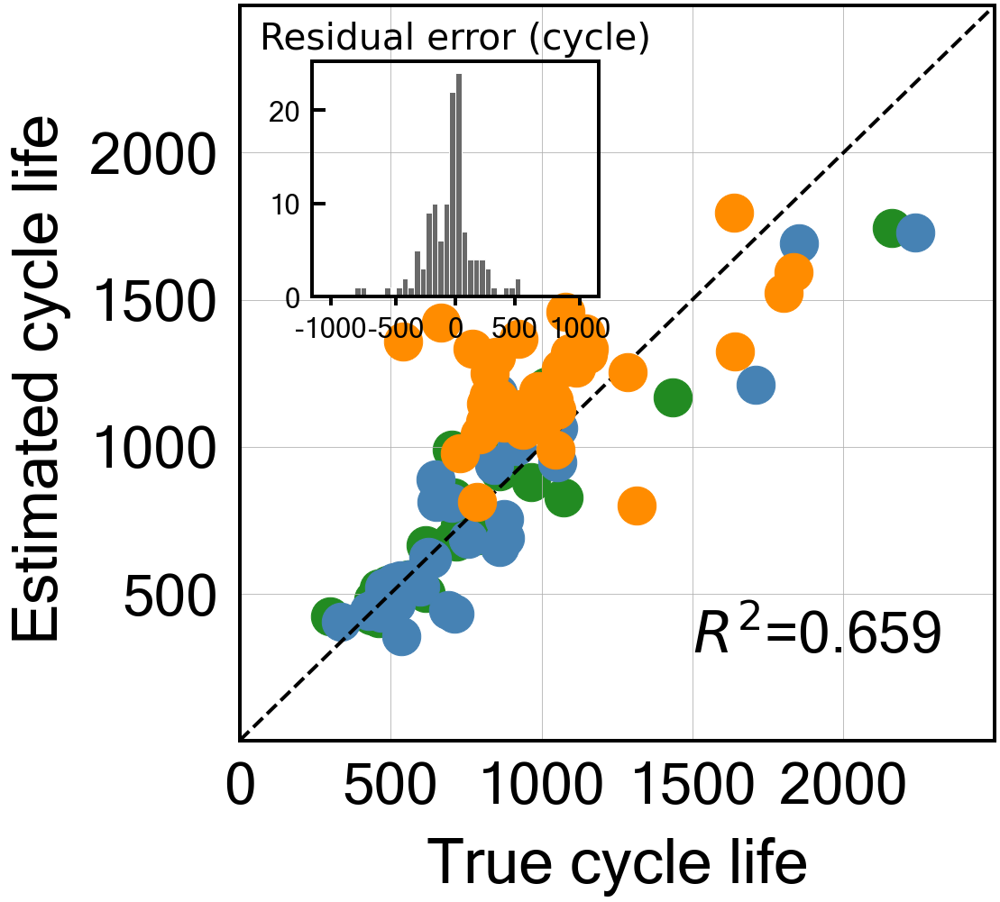


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.4
Best score obtained was: -0.2346653387428339
Cycle no: Average_2to80
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to80') : 0.0013183819529554981
T_Q('Charge', 'Skewness', 'Average_2to80') : 0.008944045421061874
T_Q('Charge', 'Max-Min', 'Average_2to80') : -0.009053460206428294
dTdQ('Charge', 'Maximum', 'Average_2to80') : -0.06726729255154881
dTdQ('Discharge', 'Max-Min', 'Average_2to80') : 0.03549415996746955
nature_dictAvg_charge_time : 0.09332379345142557
nature_dictIR_cycle2 : -0.035006489095815205
nature_dictMinT_2to80 : 0.032083141885022794
nature_dictIntegralT_2to80 : -0.032148883517770156

Intercept: 2.7939698976436373
r2-score: 0.705
MAE_all: 146.8
MAE_train: 78.9
MAE_test: 100.3
MAE_2ndTest: 265.2
MAPE_all: 17.3 %
MAPE_train: 10.2 %
MAPE_test: 12.1 %
MAPE_2ndTest: 30.0 %
RMSE_all: 215.2
RMSE_train: 122.4
RMSE_test: 159.4
RMSE_2ndTest: 316

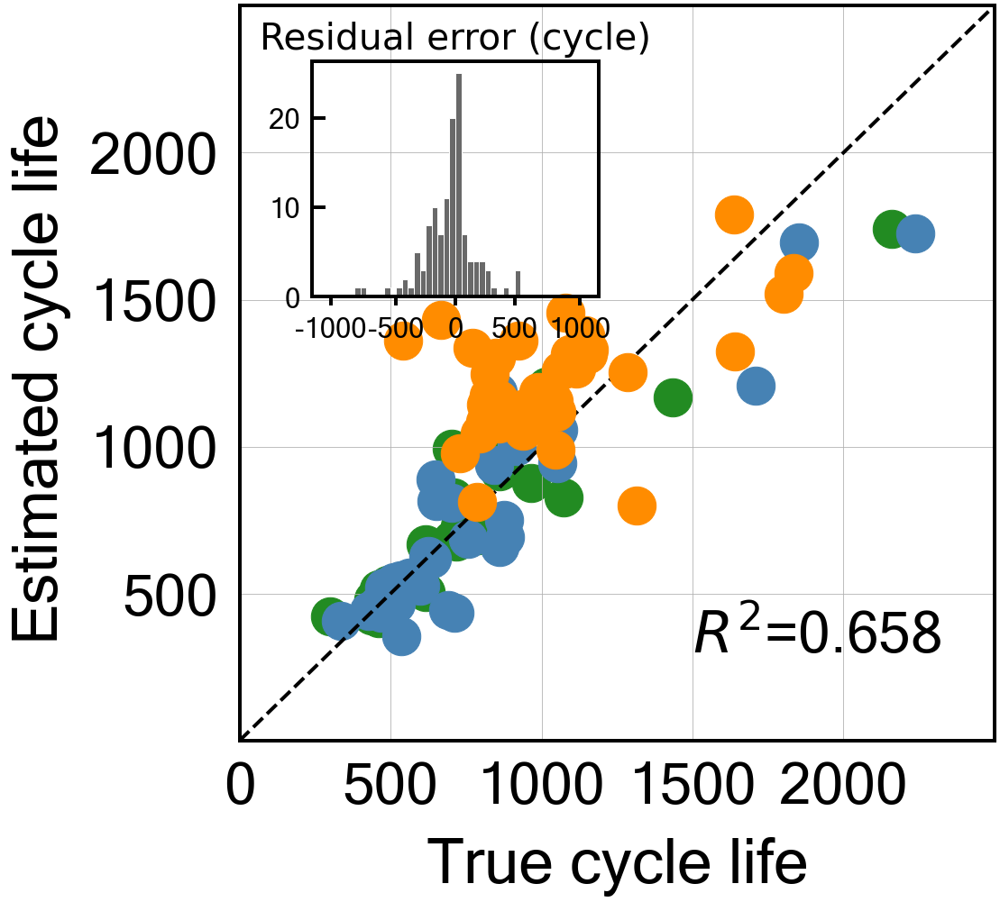


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: -0.23456161278054255
Cycle no: Average_2to81
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to81') : 0.0017093705203016466
T_Q('Charge', 'Skewness', 'Average_2to81') : 0.009564195502692425
T_Q('Charge', 'Max-Min', 'Average_2to81') : -0.007434018296471155
dTdQ('Charge', 'Maximum', 'Average_2to81') : -0.06722389139603005
dTdQ('Discharge', 'Max-Min', 'Average_2to81') : 0.03414452436373626
nature_dictAvg_charge_time : 0.093954053048839
nature_dictIR_cycle2 : -0.03483790509560929
nature_dictMinT_2to81 : 0.03219092051300668
nature_dictIntegralT_2to81 : -0.03261579940880102

Intercept: 2.793969897643637
r2-score: 0.705
MAE_all: 146.4
MAE_train: 79.0
MAE_test: 100.3
MAE_2ndTest: 264.0
MAPE_all: 17.2 %
MAPE_train: 10.2 %
MAPE_test: 12.0 %
MAPE_2ndTest: 29.9 %
RMSE_all: 215.2
RMSE_train: 122.7
RMSE_test: 159.5
RMSE_2ndTest: 316.8
RM

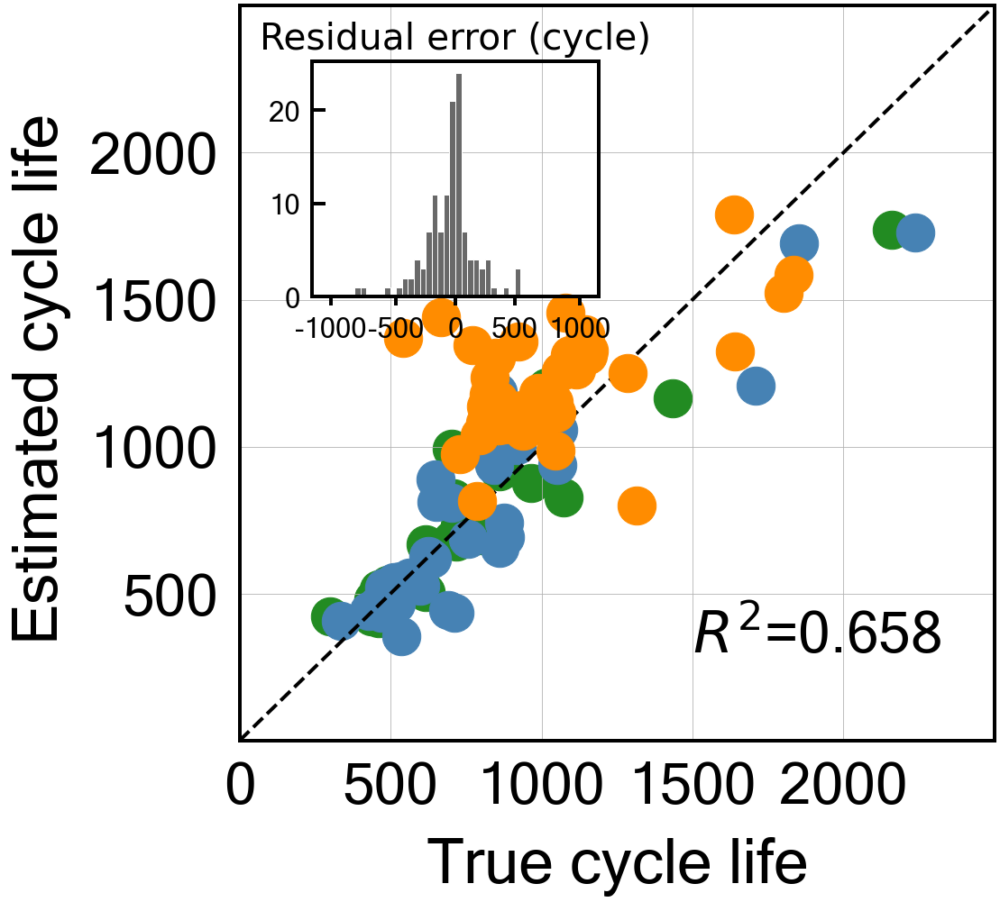


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.1
Best score obtained was: -0.23274904163452836
Cycle no: Average_2to82
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to82') : 0.0016071145385527959
T_Q('Charge', 'Skewness', 'Average_2to82') : 0.009334911411667052
T_Q('Charge', 'Max-Min', 'Average_2to82') : -0.007931932849557599
dTdQ('Charge', 'Maximum', 'Average_2to82') : -0.06699543792272464
dTdQ('Discharge', 'Max-Min', 'Average_2to82') : 0.03426667719071445
nature_dictAvg_charge_time : 0.09372292143441993
nature_dictIR_cycle2 : -0.03452989911195443
nature_dictMinT_2to82 : 0.032374591123702036
nature_dictIntegralT_2to82 : -0.03269175463730478

Intercept: 2.7939698976436373
r2-score: 0.706
MAE_all: 146.1
MAE_train: 78.8
MAE_test: 100.0
MAE_2ndTest: 263.7
MAPE_all: 17.2 %
MAPE_train: 10.2 %
MAPE_test: 12.0 %
MAPE_2ndTest: 29.8 %
RMSE_all: 215.0
RMSE_train: 122.6
RMSE_test: 159.1
RMSE_2ndTest: 316.

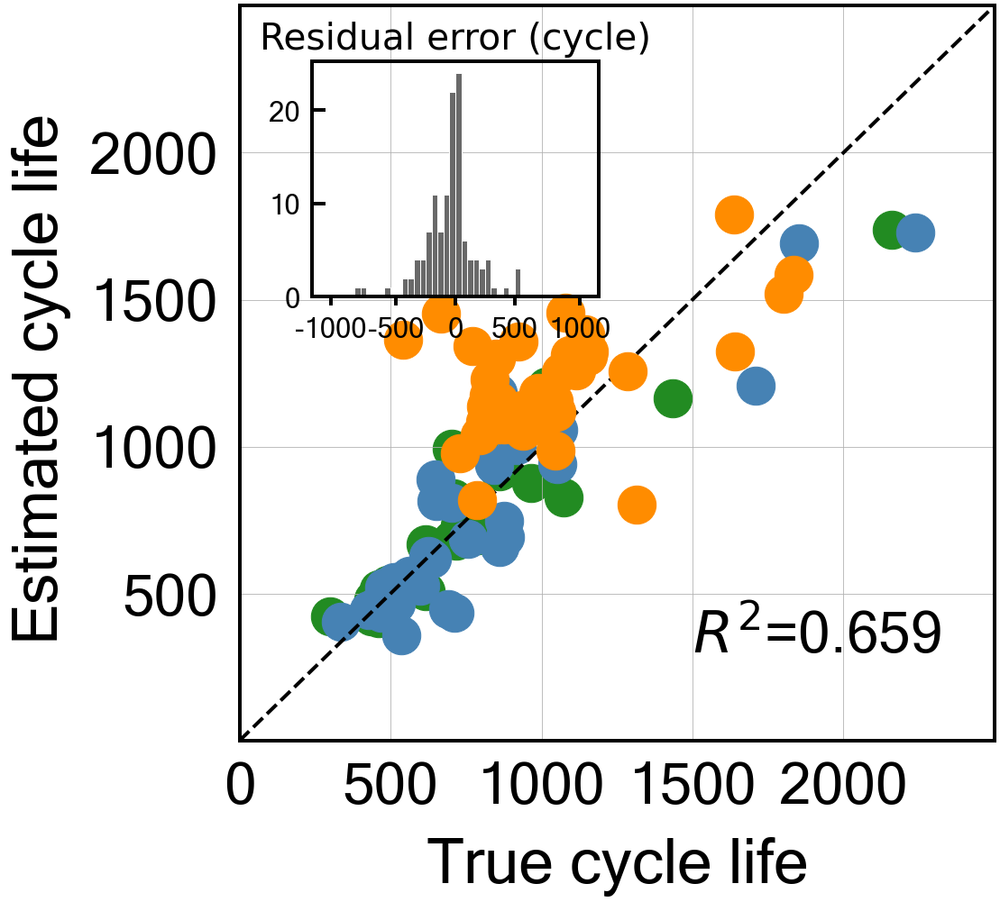


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.4
Best score obtained was: -0.2381003262638397
Cycle no: Average_2to83
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to83') : 0.002278469559721477
T_Q('Charge', 'Skewness', 'Average_2to83') : 0.00970019145592151
T_Q('Charge', 'Max-Min', 'Average_2to83') : -0.007041583538329389
dTdQ('Charge', 'Maximum', 'Average_2to83') : -0.06694464081119764
dTdQ('Discharge', 'Max-Min', 'Average_2to83') : 0.03342624019382508
nature_dictAvg_charge_time : 0.09430611177905719
nature_dictIR_cycle2 : -0.03432484023694061
nature_dictMinT_2to83 : 0.032287451274672786
nature_dictIntegralT_2to83 : -0.03338502902791804

Intercept: 2.793969897643637
r2-score: 0.706
MAE_all: 145.9
MAE_train: 78.8
MAE_test: 100.0
MAE_2ndTest: 262.8
MAPE_all: 17.2 %
MAPE_train: 10.2 %
MAPE_test: 12.0 %
MAPE_2ndTest: 29.8 %
RMSE_all: 215.3
RMSE_train: 122.6
RMSE_test: 158.9
RMSE_2ndTest: 317.2
RM

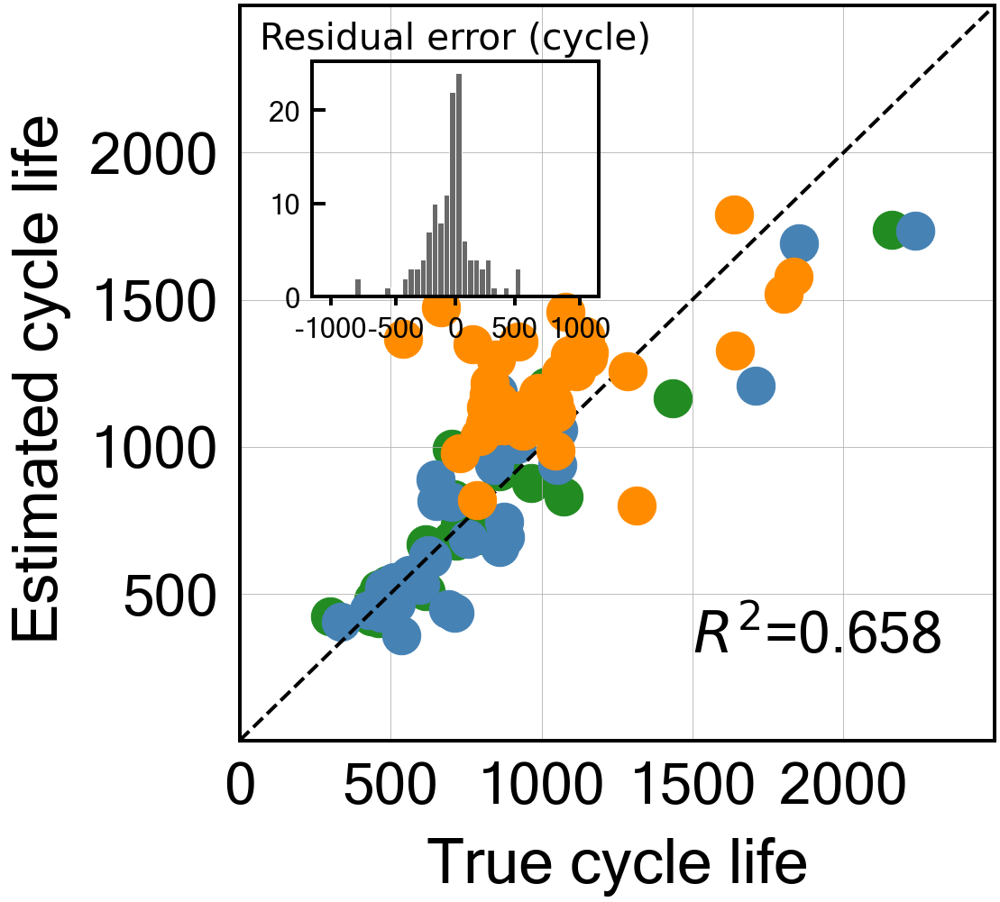


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: -0.24136140088955993
Cycle no: Average_2to84
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to84') : 0.002790125177946016
T_Q('Charge', 'Skewness', 'Average_2to84') : 0.009348032771730606
T_Q('Charge', 'Max-Min', 'Average_2to84') : -0.007449394274065121
dTdQ('Charge', 'Maximum', 'Average_2to84') : -0.06688011040399833
dTdQ('Discharge', 'Max-Min', 'Average_2to84') : 0.03342176779728865
nature_dictAvg_charge_time : 0.09430503321074568
nature_dictIR_cycle2 : -0.03403372419882519
nature_dictMinT_2to84 : 0.03227454094926923
nature_dictIntegralT_2to84 : -0.03372727725500681

Intercept: 2.7939698976436373
r2-score: 0.706
MAE_all: 145.8
MAE_train: 78.8
MAE_test: 99.9
MAE_2ndTest: 262.6
MAPE_all: 17.2 %
MAPE_train: 10.2 %
MAPE_test: 12.0 %
MAPE_2ndTest: 29.8 %
RMSE_all: 215.4
RMSE_train: 122.3
RMSE_test: 158.7
RMSE_2ndTest: 317.7
R

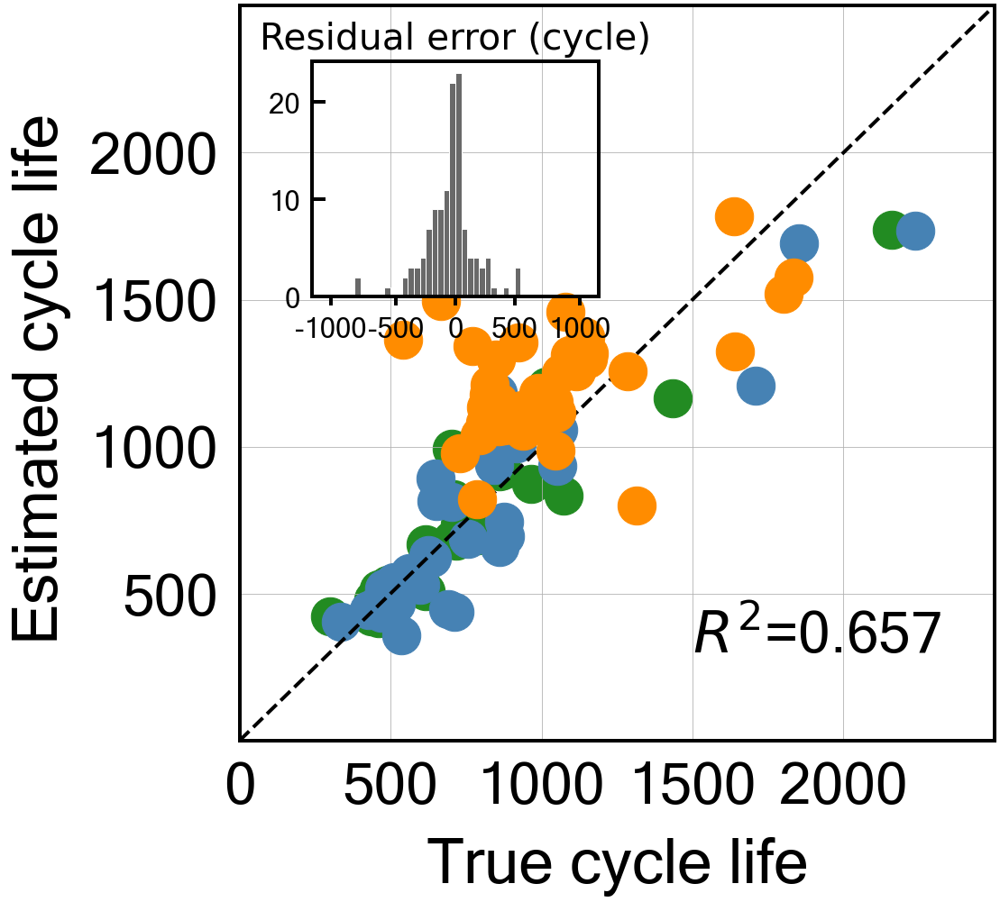


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.3
Best score obtained was: -0.24279604188391257
Cycle no: Average_2to85
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to85') : 0.002606001778671079
T_Q('Charge', 'Skewness', 'Average_2to85') : 0.00926484316315142
T_Q('Charge', 'Max-Min', 'Average_2to85') : -0.007182470062914915
dTdQ('Charge', 'Maximum', 'Average_2to85') : -0.06685849820051136
dTdQ('Discharge', 'Max-Min', 'Average_2to85') : 0.033653100335014785
nature_dictAvg_charge_time : 0.09428542195297542
nature_dictIR_cycle2 : -0.03394345583540765
nature_dictMinT_2to85 : 0.03204269043449197
nature_dictIntegralT_2to85 : -0.03406477155365884

Intercept: 2.793969897643638
r2-score: 0.707
MAE_all: 145.4
MAE_train: 78.5
MAE_test: 99.6
MAE_2ndTest: 262.0
MAPE_all: 17.1 %
MAPE_train: 10.2 %
MAPE_test: 11.9 %
MAPE_2ndTest: 29.7 %
RMSE_all: 215.4
RMSE_train: 122.1
RMSE_test: 158.4
RMSE_2ndTest: 317.8
RM

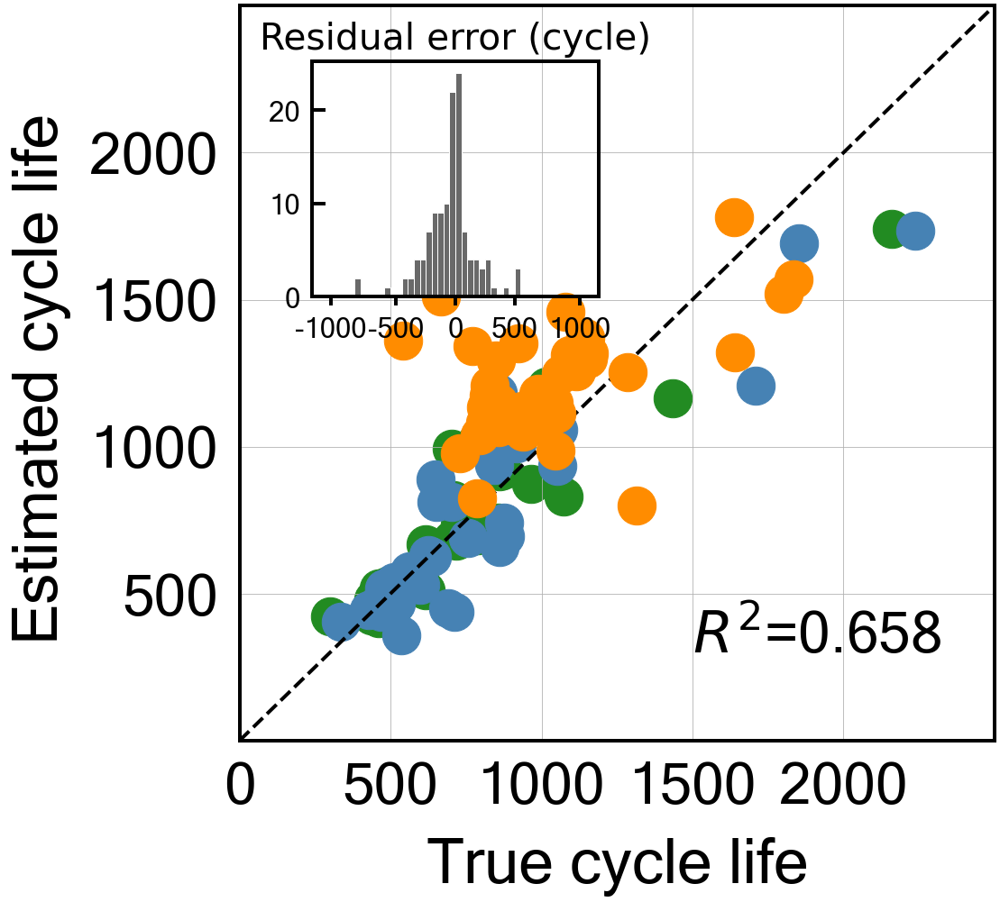


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: -0.2832386716695148
Cycle no: Average_2to86
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to86') : 0.00451710614214261
T_Q('Charge', 'Skewness', 'Average_2to86') : 0.010722468185245524
T_Q('Charge', 'Max-Min', 'Average_2to86') : -0.006505081289261895
dTdQ('Charge', 'Maximum', 'Average_2to86') : -0.06948841219238909
dTdQ('Discharge', 'Max-Min', 'Average_2to86') : 0.035229943001916696
nature_dictAvg_charge_time : 0.09589168857240546
nature_dictIR_cycle2 : -0.03370767540565635
nature_dictMinT_2to86 : 0.03160949716290086
nature_dictIntegralT_2to86 : -0.03526200090822629

Intercept: 2.7939698976436373
r2-score: 0.703
MAE_all: 146.4
MAE_train: 78.1
MAE_test: 99.3
MAE_2ndTest: 265.8
MAPE_all: 17.3 %
MAPE_train: 10.1 %
MAPE_test: 12.0 %
MAPE_2ndTest: 30.2 %
RMSE_all: 216.7
RMSE_train: 120.1
RMSE_test: 155.1
RMSE_2ndTest: 323.0
RM

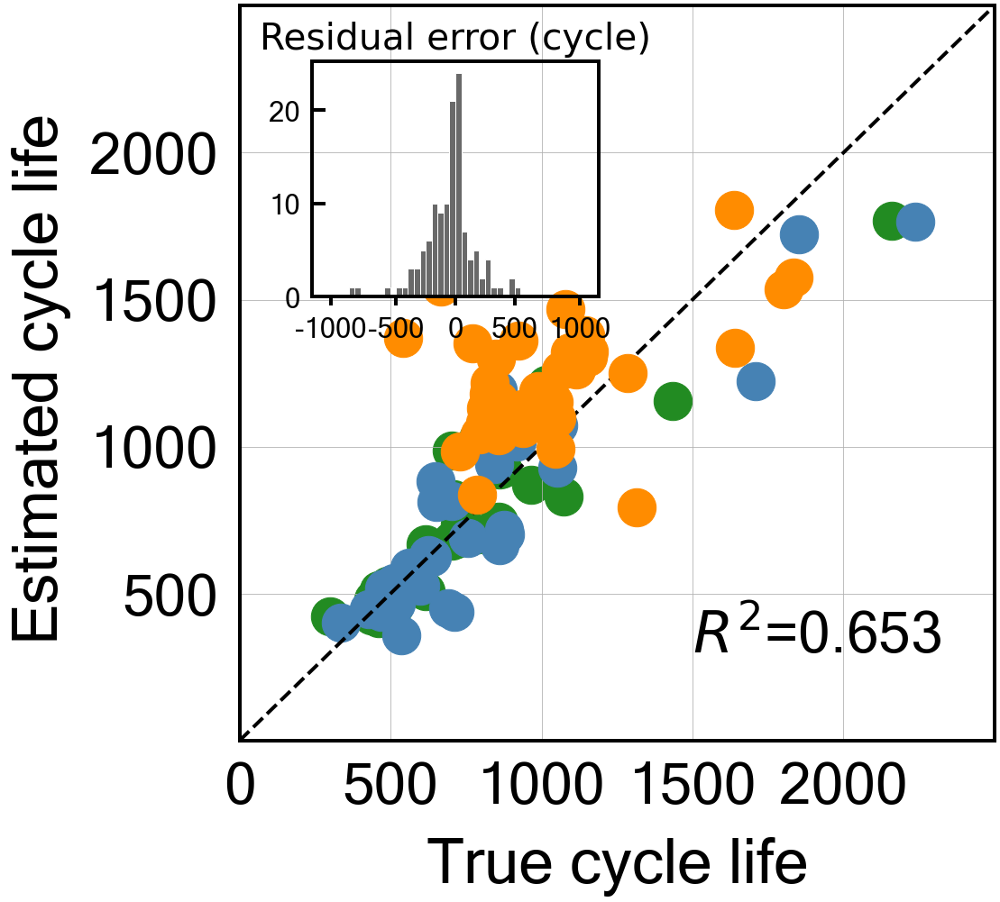


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.2
Best score obtained was: -0.28720632119276157
Cycle no: Average_2to87
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to87') : 0.005098157566802947
T_Q('Charge', 'Skewness', 'Average_2to87') : 0.010764682280999038
T_Q('Charge', 'Max-Min', 'Average_2to87') : -0.005922015533034463
dTdQ('Charge', 'Maximum', 'Average_2to87') : -0.06900679407143354
dTdQ('Discharge', 'Max-Min', 'Average_2to87') : 0.03387282786467635
nature_dictAvg_charge_time : 0.09624231767244949
nature_dictIR_cycle2 : -0.03353825324492651
nature_dictMinT_2to87 : 0.032055450869857706
nature_dictIntegralT_2to87 : -0.035628544951817664

Intercept: 2.7939698976436373
r2-score: 0.703
MAE_all: 146.4
MAE_train: 78.2
MAE_test: 99.3
MAE_2ndTest: 265.8
MAPE_all: 17.3 %
MAPE_train: 10.2 %
MAPE_test: 12.0 %
MAPE_2ndTest: 30.2 %
RMSE_all: 217.1
RMSE_train: 120.3
RMSE_test: 155.5
RMSE_2ndTest: 323.5

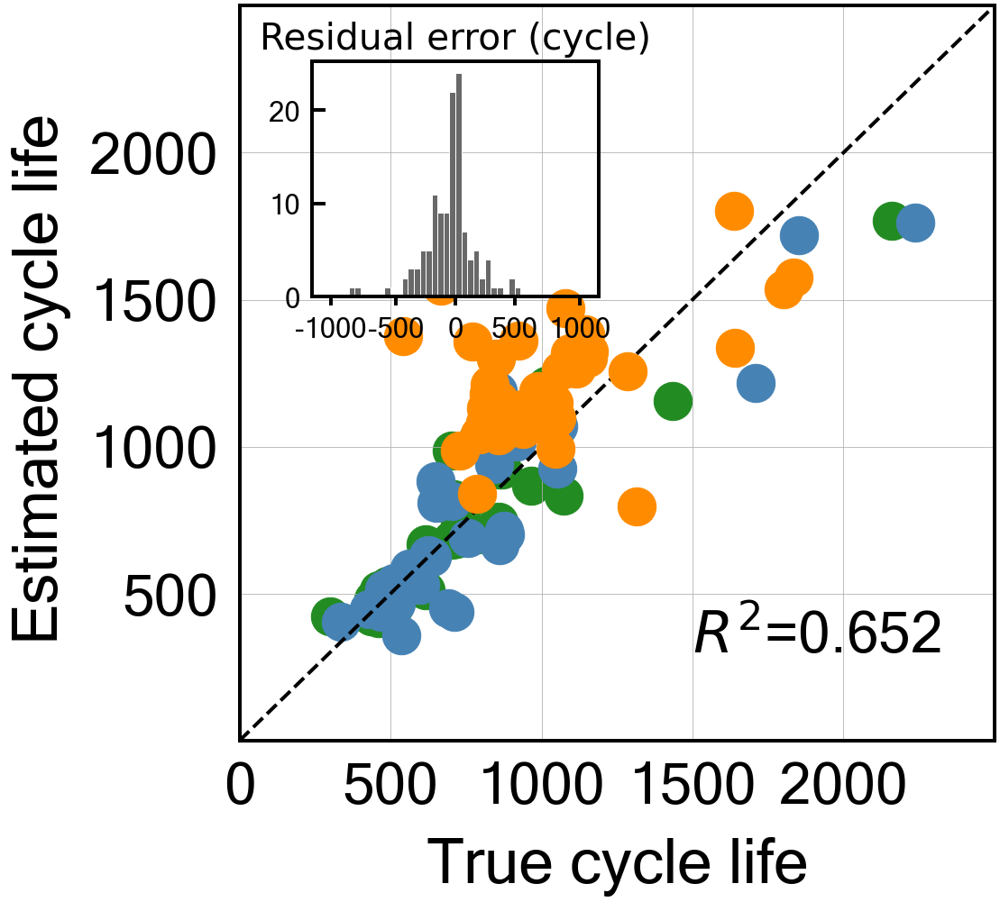


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.5
Best score obtained was: -0.292683412446888
Cycle no: Average_2to88
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to88') : 0.005376690949980424
T_Q('Charge', 'Skewness', 'Average_2to88') : 0.011068736653915444
T_Q('Charge', 'Max-Min', 'Average_2to88') : -0.0056784919595587735
dTdQ('Charge', 'Maximum', 'Average_2to88') : -0.06905427290752095
dTdQ('Discharge', 'Max-Min', 'Average_2to88') : 0.03358475196613221
nature_dictAvg_charge_time : 0.09634036787735886
nature_dictIR_cycle2 : -0.03330033312146964
nature_dictMinT_2to88 : 0.03207347103668478
nature_dictIntegralT_2to88 : -0.036101332861577545

Intercept: 2.7939698976436373
r2-score: 0.703
MAE_all: 146.5
MAE_train: 78.1
MAE_test: 99.2
MAE_2ndTest: 266.3
MAPE_all: 17.3 %
MAPE_train: 10.1 %
MAPE_test: 12.0 %
MAPE_2ndTest: 30.3 %
RMSE_all: 217.4
RMSE_train: 120.4
RMSE_test: 155.6
RMSE_2ndTest: 324.2
R

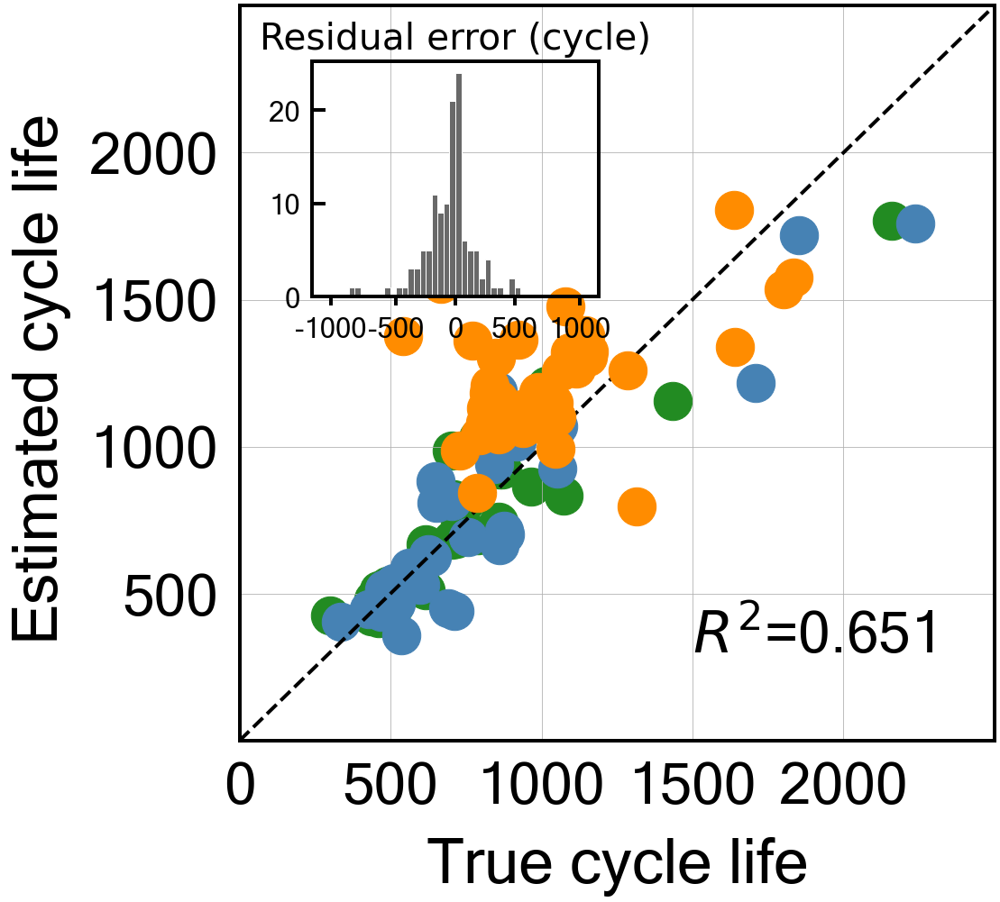


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.4
Best score obtained was: -0.26460668384592645
Cycle no: Average_2to89
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to89') : 0.0036409125175956964
T_Q('Charge', 'Skewness', 'Average_2to89') : 0.010426790940628743
T_Q('Charge', 'Max-Min', 'Average_2to89') : -0.005295833393345501
dTdQ('Charge', 'Maximum', 'Average_2to89') : -0.06699709026414637
dTdQ('Discharge', 'Max-Min', 'Average_2to89') : 0.03217214853677761
nature_dictAvg_charge_time : 0.09498074566416591
nature_dictIR_cycle2 : -0.03314597279962332
nature_dictMinT_2to89 : 0.032403251014010155
nature_dictIntegralT_2to89 : -0.0357900611950855

Intercept: 2.7939698976436365
r2-score: 0.706
MAE_all: 145.5
MAE_train: 78.2
MAE_test: 99.5
MAE_2ndTest: 262.8
MAPE_all: 17.1 %
MAPE_train: 10.1 %
MAPE_test: 11.9 %
MAPE_2ndTest: 29.9 %
RMSE_all: 216.5
RMSE_train: 121.8
RMSE_test: 157.9
RMSE_2ndTest: 320.6


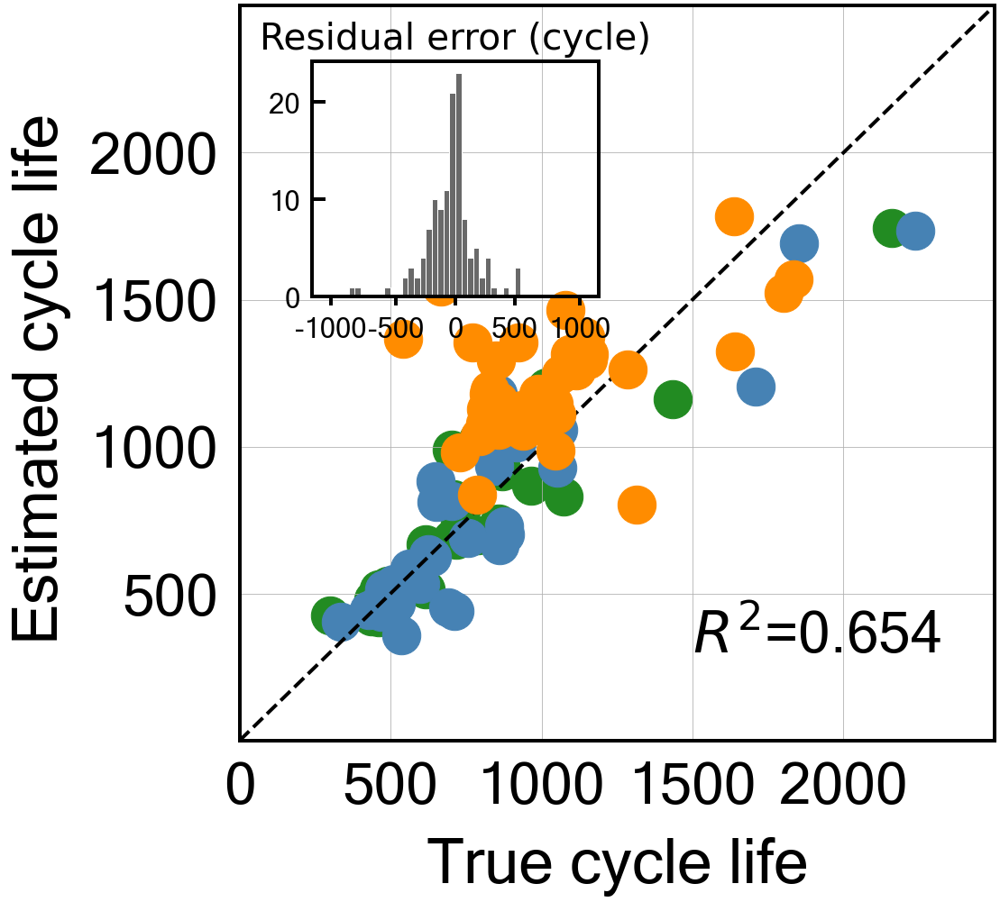


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.5
Best score obtained was: -0.2913041222329442
Cycle no: Average_2to90
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to90') : 0.004739266036544016
T_Q('Charge', 'Skewness', 'Average_2to90') : 0.010147534666327352
T_Q('Charge', 'Max-Min', 'Average_2to90') : -0.005172955998635161
dTdQ('Charge', 'Maximum', 'Average_2to90') : -0.06921568577974664
dTdQ('Discharge', 'Max-Min', 'Average_2to90') : 0.034427631155612905
nature_dictAvg_charge_time : 0.09686135659983457
nature_dictIR_cycle2 : -0.032513599878321676
nature_dictMinT_2to90 : 0.03240045904016722
nature_dictIntegralT_2to90 : -0.03695838083713831

Intercept: 2.7939698976436373
r2-score: 0.704
MAE_all: 146.3
MAE_train: 78.1
MAE_test: 98.1
MAE_2ndTest: 266.8
MAPE_all: 17.3 %
MAPE_train: 10.2 %
MAPE_test: 11.9 %
MAPE_2ndTest: 30.3 %
RMSE_all: 216.8
RMSE_train: 119.9
RMSE_test: 153.6
RMSE_2ndTest: 324.0


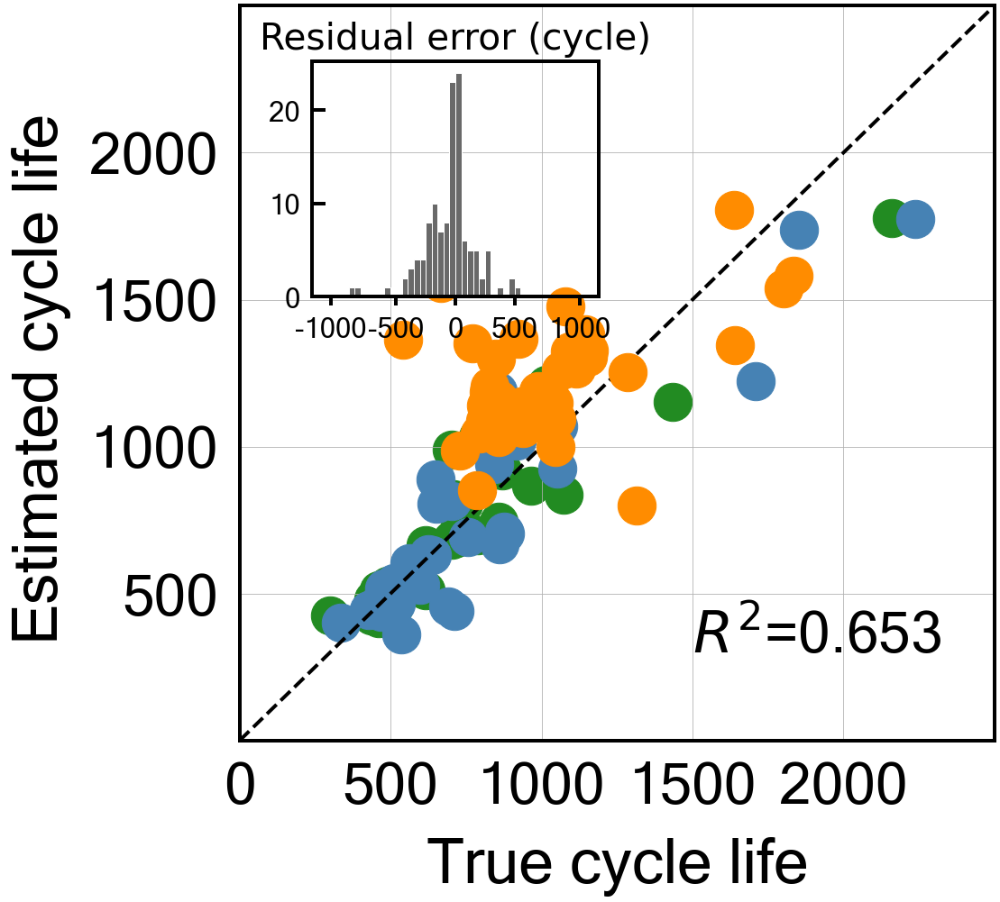


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: -0.29041164928468044
Cycle no: Average_2to91
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to91') : 0.00436753360930907
T_Q('Charge', 'Skewness', 'Average_2to91') : 0.010139641540182154
T_Q('Charge', 'Max-Min', 'Average_2to91') : -0.00332079616871736
dTdQ('Charge', 'Maximum', 'Average_2to91') : -0.06890485860369135
dTdQ('Discharge', 'Max-Min', 'Average_2to91') : 0.03302527264028171
nature_dictAvg_charge_time : 0.09675362157789479
nature_dictIR_cycle2 : -0.03200452817105216
nature_dictMinT_2to91 : 0.03266633130758411
nature_dictIntegralT_2to91 : -0.03773795101305699

Intercept: 2.7939698976436373
r2-score: 0.704
MAE_all: 146.3
MAE_train: 78.1
MAE_test: 98.2
MAE_2ndTest: 266.7
MAPE_all: 17.3 %
MAPE_train: 10.2 %
MAPE_test: 11.8 %
MAPE_2ndTest: 30.3 %
RMSE_all: 216.8
RMSE_train: 120.0
RMSE_test: 154.1
RMSE_2ndTest: 323.9
RMS

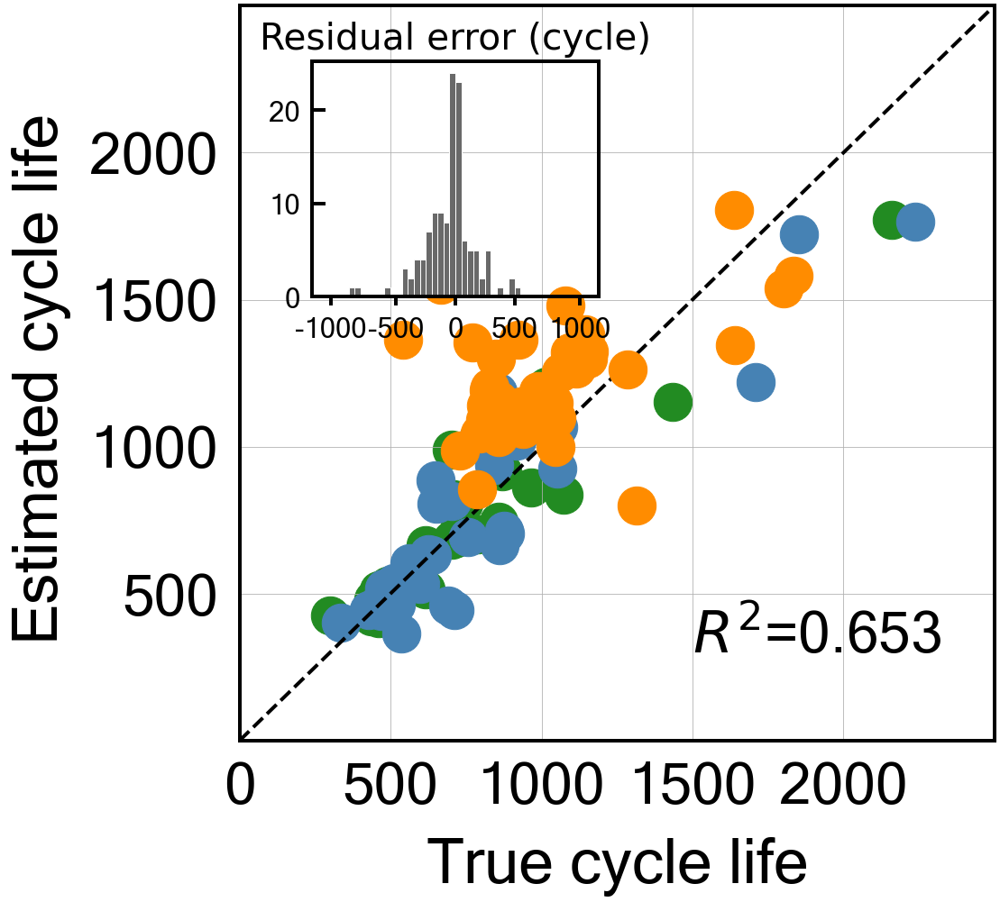


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.3
Best score obtained was: -0.28173468658872114
Cycle no: Average_2to92
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to92') : 0.0038840714372598197
T_Q('Charge', 'Skewness', 'Average_2to92') : 0.01037125876139596
T_Q('Charge', 'Max-Min', 'Average_2to92') : -0.0033329568025501776
dTdQ('Charge', 'Maximum', 'Average_2to92') : -0.06880849655965803
dTdQ('Discharge', 'Max-Min', 'Average_2to92') : 0.03320148562031025
nature_dictAvg_charge_time : 0.0963461948689706
nature_dictIR_cycle2 : -0.03168254965465891
nature_dictMinT_2to92 : 0.03275111831948506
nature_dictIntegralT_2to92 : -0.03795157681740557

Intercept: 2.793969897643638
r2-score: 0.706
MAE_all: 146.1
MAE_train: 78.2
MAE_test: 98.2
MAE_2ndTest: 266.1
MAPE_all: 17.3 %
MAPE_train: 10.2 %
MAPE_test: 11.8 %
MAPE_2ndTest: 30.2 %
RMSE_all: 216.3
RMSE_train: 120.1
RMSE_test: 153.9
RMSE_2ndTest: 322.8
RM

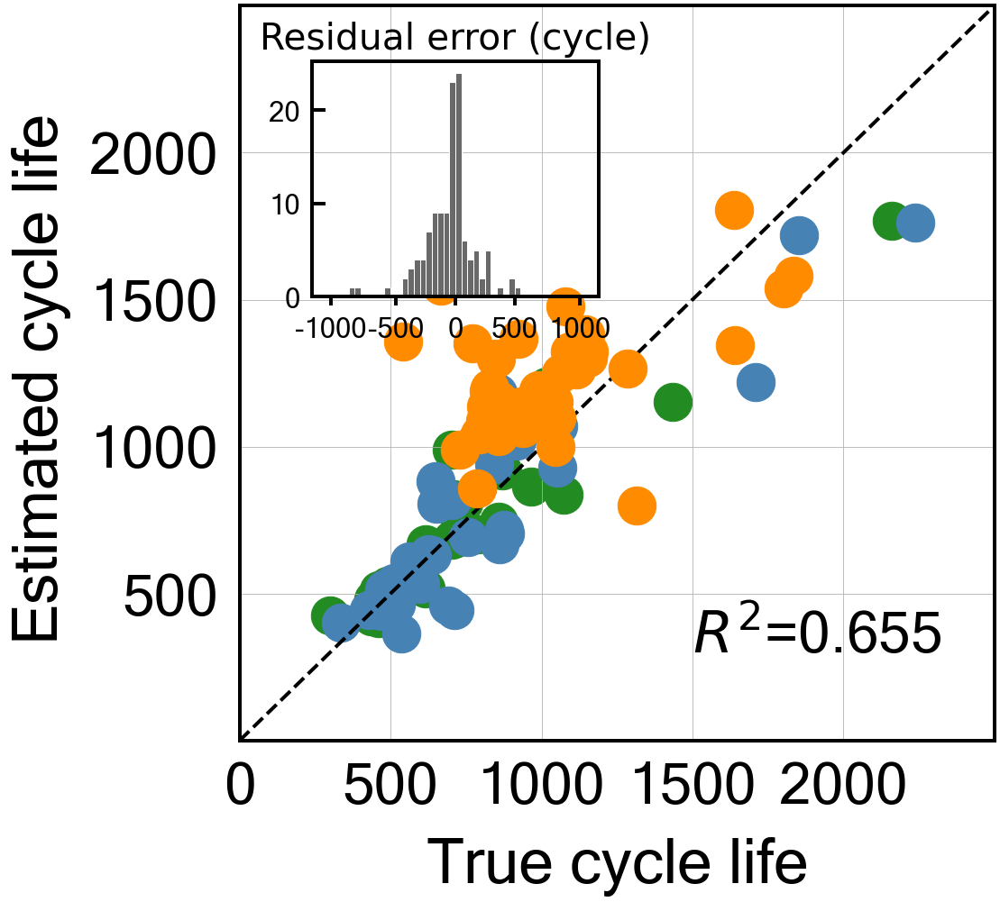


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.6
Best score obtained was: -0.25606900349522665
Cycle no: Average_2to93
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to93') : 0.0033932117757465726
T_Q('Charge', 'Skewness', 'Average_2to93') : 0.009348798952911975
T_Q('Charge', 'Max-Min', 'Average_2to93') : -0.006323526235627799
dTdQ('Charge', 'Maximum', 'Average_2to93') : -0.06876299423306415
dTdQ('Discharge', 'Max-Min', 'Average_2to93') : 0.03633030532063614
nature_dictAvg_charge_time : 0.09521450341712445
nature_dictIR_cycle2 : -0.031610782844712484
nature_dictMinT_2to93 : 0.03221748812295289
nature_dictIntegralT_2to93 : -0.037531726567243545

Intercept: 2.7939698976436373
r2-score: 0.710
MAE_all: 145.4
MAE_train: 78.0
MAE_test: 98.1
MAE_2ndTest: 264.2
MAPE_all: 17.2 %
MAPE_train: 10.2 %
MAPE_test: 11.9 %
MAPE_2ndTest: 30.0 %
RMSE_all: 214.5
RMSE_train: 120.1
RMSE_test: 153.2
RMSE_2ndTest: 319.

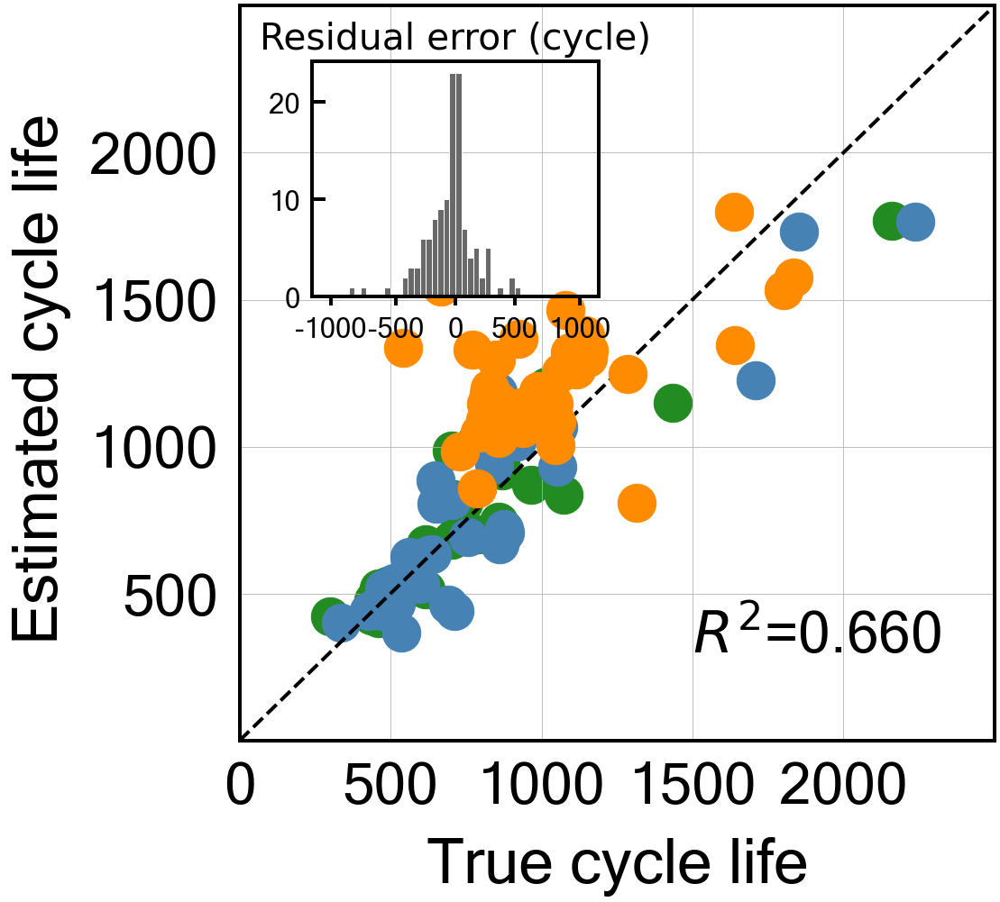


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.0
Best score obtained was: -0.24929335989546586
Cycle no: Average_2to94
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to94') : 0.0036127053665884583
T_Q('Charge', 'Skewness', 'Average_2to94') : 0.009932972052575801
T_Q('Charge', 'Max-Min', 'Average_2to94') : -0.0054246448292392824
dTdQ('Charge', 'Maximum', 'Average_2to94') : -0.06959335484971478
dTdQ('Discharge', 'Max-Min', 'Average_2to94') : 0.03645997360745766
nature_dictAvg_charge_time : 0.09540687335791487
nature_dictIR_cycle2 : -0.030986888796526578
nature_dictMinT_2to94 : 0.03213632341386315
nature_dictIntegralT_2to94 : -0.03827547694909883

Intercept: 2.793969897643638
r2-score: 0.712
MAE_all: 145.2
MAE_train: 77.7
MAE_test: 97.9
MAE_2ndTest: 263.9
MAPE_all: 17.1 %
MAPE_train: 10.1 %
MAPE_test: 11.9 %
MAPE_2ndTest: 29.9 %
RMSE_all: 213.9
RMSE_train: 119.7
RMSE_test: 152.6
RMSE_2ndTest: 318.7

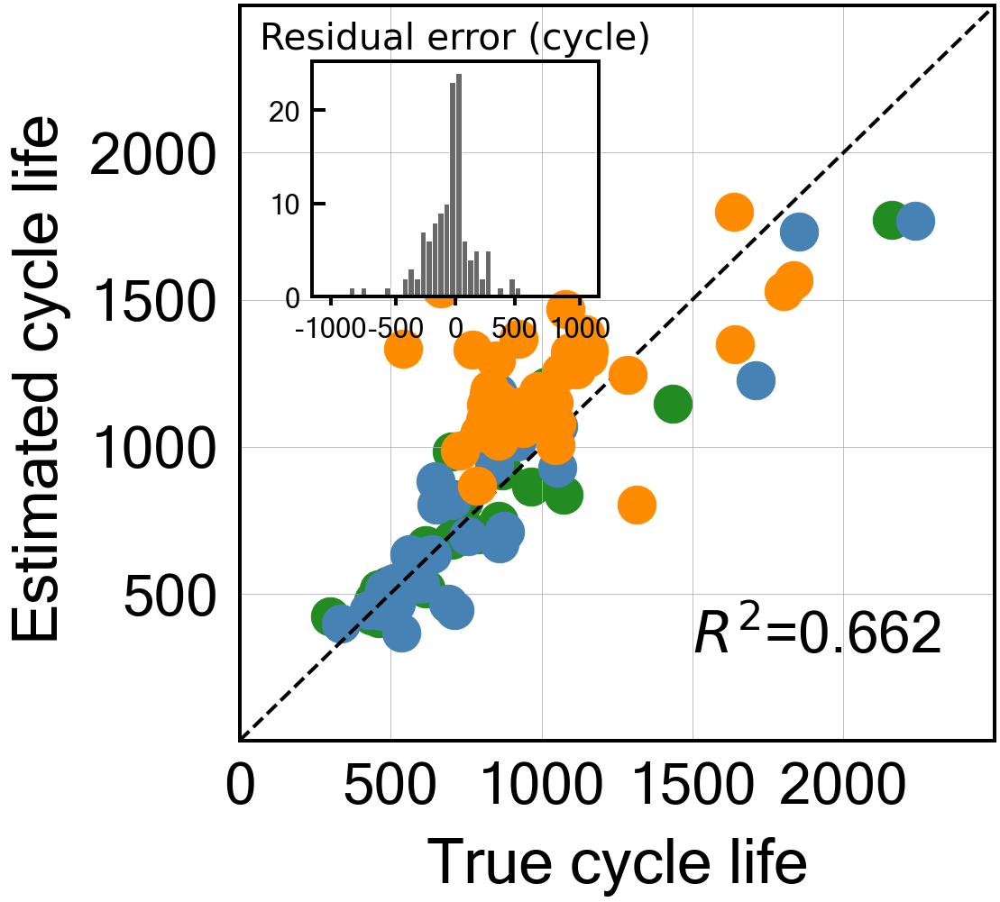


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: -0.2467961954825466
Cycle no: Average_2to95
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to95') : 0.0022178578309678563
T_Q('Charge', 'Skewness', 'Average_2to95') : 0.009486994341889621
T_Q('Charge', 'Max-Min', 'Average_2to95') : -0.006944563887924922
dTdQ('Charge', 'Maximum', 'Average_2to95') : -0.06990774334634652
dTdQ('Discharge', 'Max-Min', 'Average_2to95') : 0.038831341741314425
nature_dictAvg_charge_time : 0.09448005572062593
nature_dictIR_cycle2 : -0.03096233761985692
nature_dictMinT_2to95 : 0.032027046888891644
nature_dictIntegralT_2to95 : -0.03779405901140222

Intercept: 2.7939698976436373
r2-score: 0.712
MAE_all: 145.4
MAE_train: 77.5
MAE_test: 97.9
MAE_2ndTest: 264.7
MAPE_all: 17.2 %
MAPE_train: 10.1 %
MAPE_test: 11.9 %
MAPE_2ndTest: 30.0 %
RMSE_all: 213.6
RMSE_train: 119.4
RMSE_test: 152.2
RMSE_2ndTest: 318.4

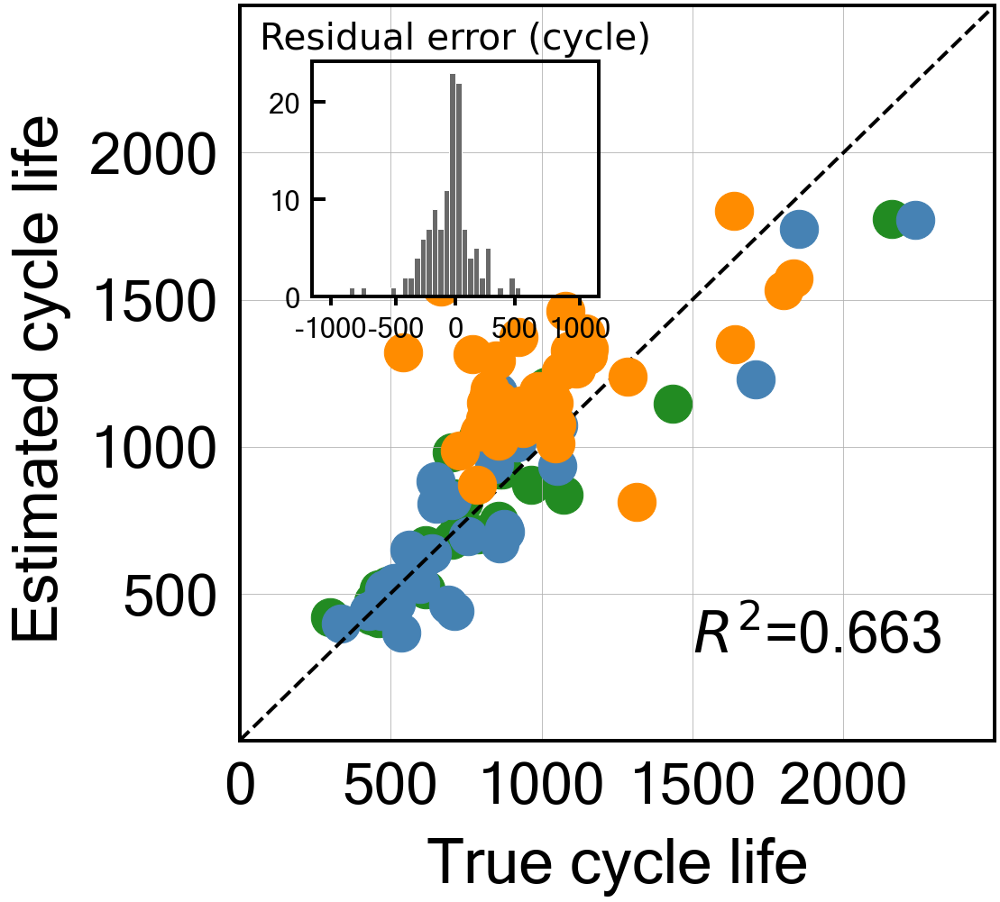


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: -0.23903571687793201
Cycle no: Average_2to96
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to96') : 0.002083762598463815
T_Q('Charge', 'Skewness', 'Average_2to96') : 0.009334215298864324
T_Q('Charge', 'Max-Min', 'Average_2to96') : -0.0072505055397713404
dTdQ('Charge', 'Maximum', 'Average_2to96') : -0.0698209662416246
dTdQ('Discharge', 'Max-Min', 'Average_2to96') : 0.03945570940451808
nature_dictAvg_charge_time : 0.0940089981740927
nature_dictIR_cycle2 : -0.03064695566235236
nature_dictMinT_2to96 : 0.031878277430315204
nature_dictIntegralT_2to96 : -0.03818145954175445

Intercept: 2.7939698976436373
r2-score: 0.714
MAE_all: 145.2
MAE_train: 77.4
MAE_test: 98.2
MAE_2ndTest: 264.0
MAPE_all: 17.1 %
MAPE_train: 10.0 %
MAPE_test: 11.9 %
MAPE_2ndTest: 29.9 %
RMSE_all: 213.2
RMSE_train: 119.5
RMSE_test: 152.6
RMSE_2ndTest: 317.4
R

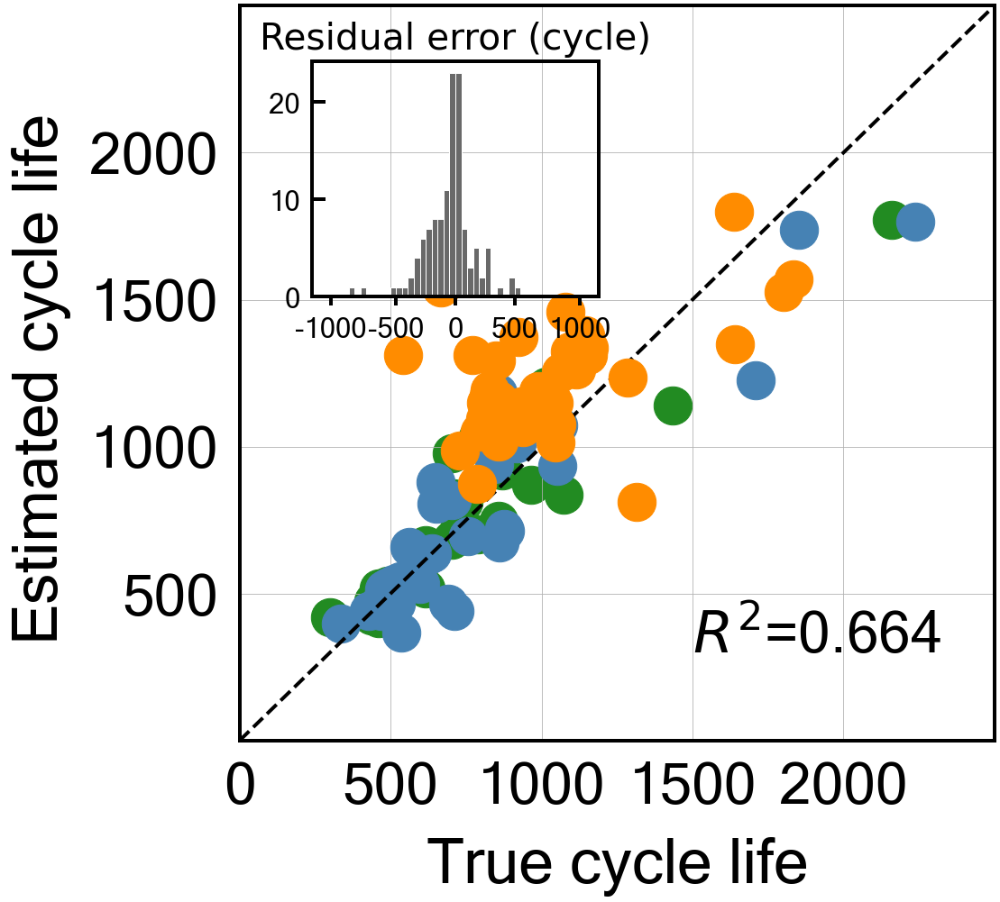


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.7
Best score obtained was: -0.24546960489984637
Cycle no: Average_2to97
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to97') : 0.0026169630820460934
T_Q('Charge', 'Skewness', 'Average_2to97') : 0.009598442936913797
T_Q('Charge', 'Max-Min', 'Average_2to97') : -0.006915374866289737
dTdQ('Charge', 'Maximum', 'Average_2to97') : -0.07032648932267946
dTdQ('Discharge', 'Max-Min', 'Average_2to97') : 0.03932167092792712
nature_dictAvg_charge_time : 0.09416068730719007
nature_dictIR_cycle2 : -0.030105034444551145
nature_dictMinT_2to97 : 0.03195119290977684
nature_dictIntegralT_2to97 : -0.038992883714794584

Intercept: 2.793969897643638
r2-score: 0.713
MAE_all: 145.5
MAE_train: 77.3
MAE_test: 98.1
MAE_2ndTest: 265.2
MAPE_all: 17.2 %
MAPE_train: 10.0 %
MAPE_test: 11.9 %
MAPE_2ndTest: 30.0 %
RMSE_all: 213.5
RMSE_train: 119.3
RMSE_test: 152.3
RMSE_2ndTest: 318.2

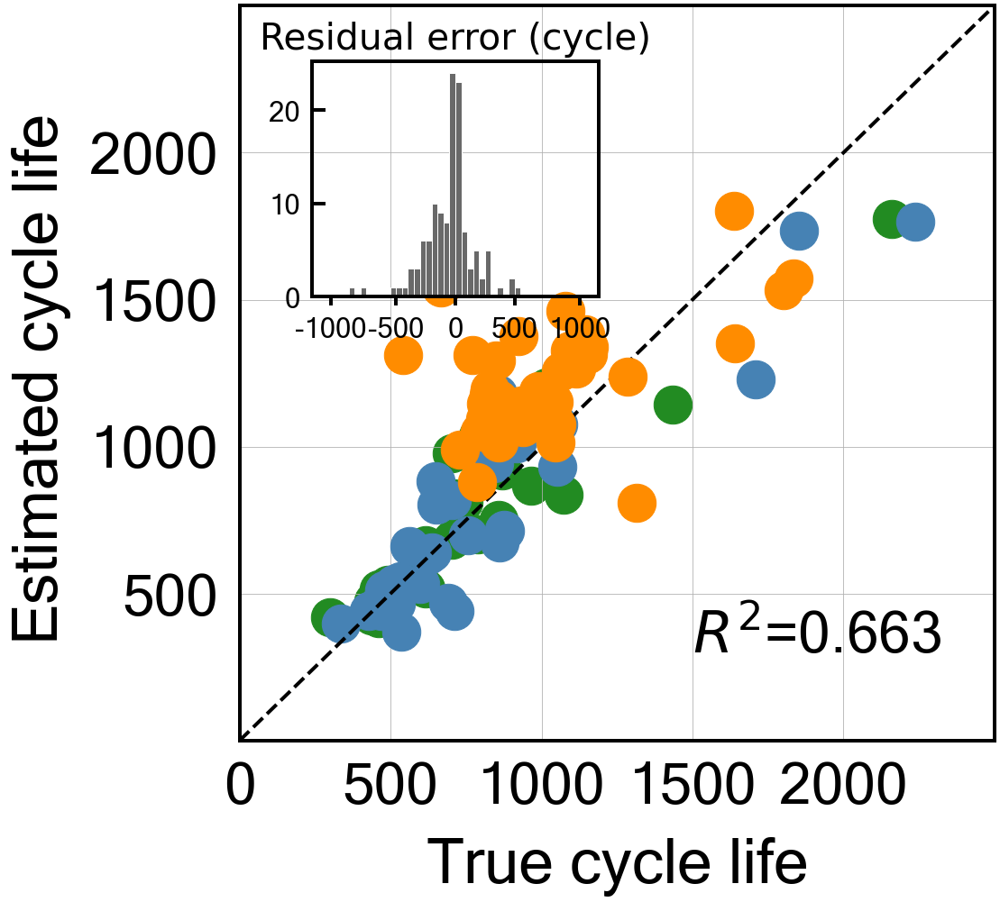


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: -0.24797332232077407
Cycle no: Average_2to98
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to98') : 0.002313447863803839
T_Q('Charge', 'Skewness', 'Average_2to98') : 0.009363889647249098
T_Q('Charge', 'Max-Min', 'Average_2to98') : -0.007564838609253163
dTdQ('Charge', 'Maximum', 'Average_2to98') : -0.07051383502382548
dTdQ('Discharge', 'Max-Min', 'Average_2to98') : 0.04031323965063248
nature_dictAvg_charge_time : 0.09392002126287674
nature_dictIR_cycle2 : -0.029714229395170585
nature_dictMinT_2to98 : 0.032251891769320286
nature_dictIntegralT_2to98 : -0.03922537513506953

Intercept: 2.7939698976436373
r2-score: 0.713
MAE_all: 146.0
MAE_train: 77.2
MAE_test: 98.3
MAE_2ndTest: 266.7
MAPE_all: 17.2 %
MAPE_train: 10.0 %
MAPE_test: 11.9 %
MAPE_2ndTest: 30.2 %
RMSE_all: 213.7
RMSE_train: 119.4
RMSE_test: 152.2
RMSE_2ndTest: 318.5

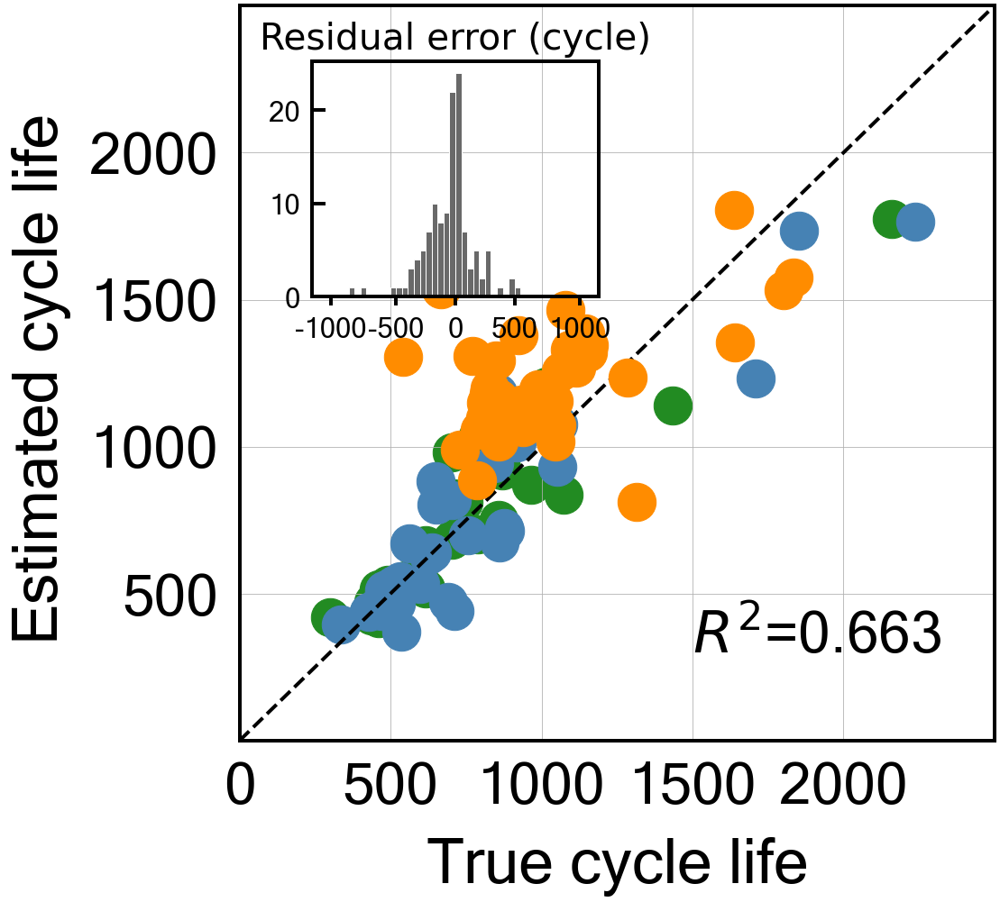


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.6
Best score obtained was: -0.24964783127227252
Cycle no: Average_2to99
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to99') : 0.0014642653983922554
T_Q('Charge', 'Skewness', 'Average_2to99') : 0.00930262786607256
T_Q('Charge', 'Max-Min', 'Average_2to99') : -0.0056837058451780186
dTdQ('Charge', 'Maximum', 'Average_2to99') : -0.07043491804446217
dTdQ('Discharge', 'Max-Min', 'Average_2to99') : 0.03904932210163756
nature_dictAvg_charge_time : 0.09415696704748905
nature_dictIR_cycle2 : -0.0290703042987056
nature_dictMinT_2to99 : 0.03306877649595049
nature_dictIntegralT_2to99 : -0.03991480620618812

Intercept: 2.7939698976436373
r2-score: 0.713
MAE_all: 146.4
MAE_train: 77.3
MAE_test: 98.0
MAE_2ndTest: 267.9
MAPE_all: 17.2 %
MAPE_train: 10.0 %
MAPE_test: 11.9 %
MAPE_2ndTest: 30.3 %
RMSE_all: 213.7
RMSE_train: 119.7
RMSE_test: 151.8
RMSE_2ndTest: 318.7
R

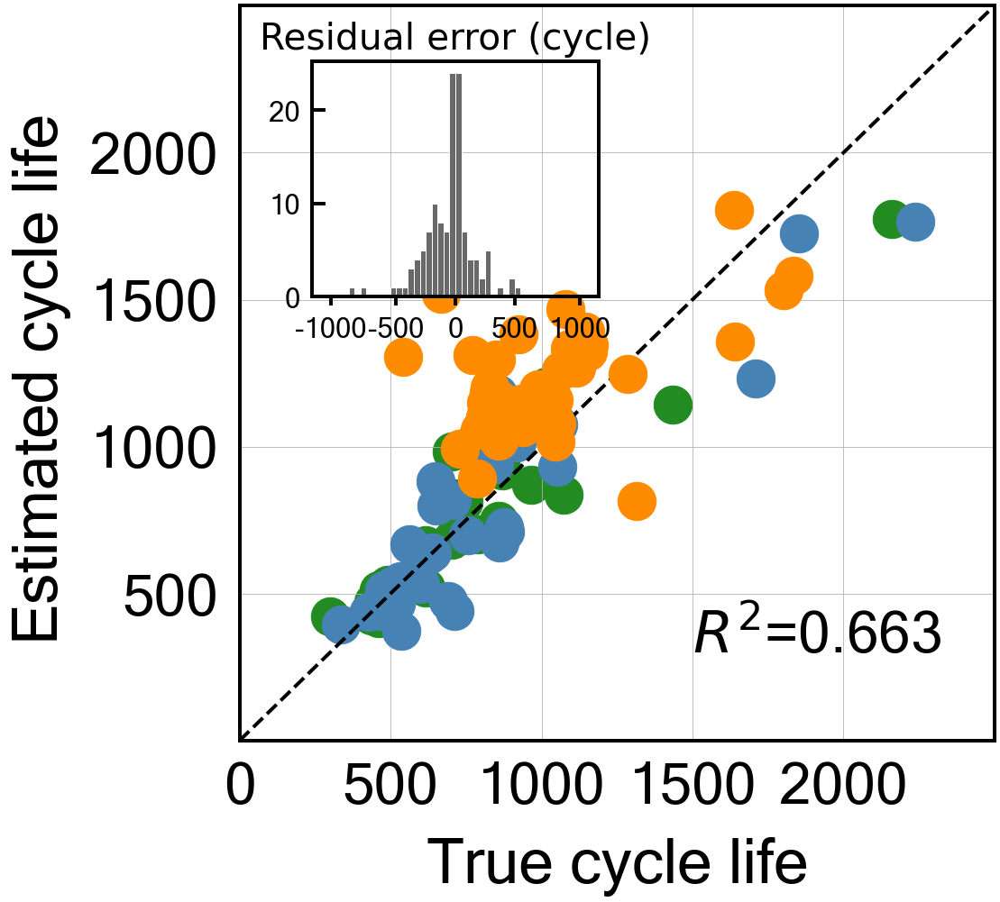


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.4
Best score obtained was: -0.24889781436526115
Cycle no: Average_2to100
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to100') : 0.0017153212602389648
T_Q('Charge', 'Skewness', 'Average_2to100') : 0.00927273890565237
T_Q('Charge', 'Max-Min', 'Average_2to100') : -0.005339558459567595
dTdQ('Charge', 'Maximum', 'Average_2to100') : -0.07042429142626745
dTdQ('Discharge', 'Max-Min', 'Average_2to100') : 0.038689241398429636
nature_dictAvg_charge_time : 0.09437226447898697
nature_dictIR_cycle2 : -0.02860188171741239
nature_dictMinT_2to100 : 0.033457472454621294
nature_dictIntegralT_2to100 : -0.04056221301358186

Intercept: 2.7939698976436373
r2-score: 0.713
MAE_all: 146.4
MAE_train: 77.3
MAE_test: 97.8
MAE_2ndTest: 268.4
MAPE_all: 17.3 %
MAPE_train: 10.0 %
MAPE_test: 11.9 %
MAPE_2ndTest: 30.3 %
RMSE_all: 213.6
RMSE_train: 119.5
RMSE_test: 151.6
RMSE_2ndTes

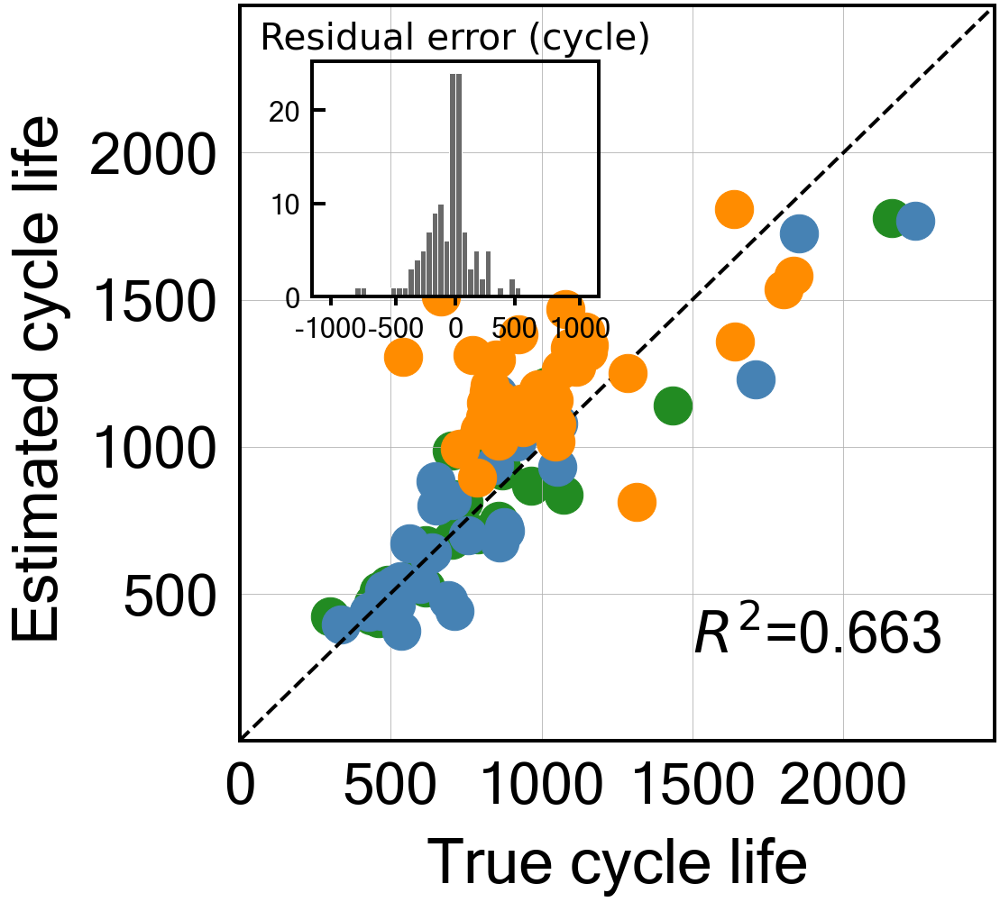


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: -0.2443804847681772
Cycle no: Average_2to101
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to101') : 0.001545379366184263
T_Q('Charge', 'Skewness', 'Average_2to101') : 0.009423540245719734
T_Q('Charge', 'Max-Min', 'Average_2to101') : -0.004141099301210035
dTdQ('Charge', 'Maximum', 'Average_2to101') : -0.07039747464024528
dTdQ('Discharge', 'Max-Min', 'Average_2to101') : 0.03780427339247121
nature_dictAvg_charge_time : 0.09466637390097779
nature_dictIR_cycle2 : -0.028234047210857177
nature_dictMinT_2to101 : 0.033685861165665285
nature_dictIntegralT_2to101 : -0.040980316134725796

Intercept: 2.7939698976436373
r2-score: 0.714
MAE_all: 146.3
MAE_train: 77.3
MAE_test: 97.6
MAE_2ndTest: 268.2
MAPE_all: 17.2 %
MAPE_train: 10.0 %
MAPE_test: 11.8 %
MAPE_2ndTest: 30.3 %
RMSE_all: 213.2
RMSE_train: 119.3
RMSE_test: 151.2
RMSE_2ndTes

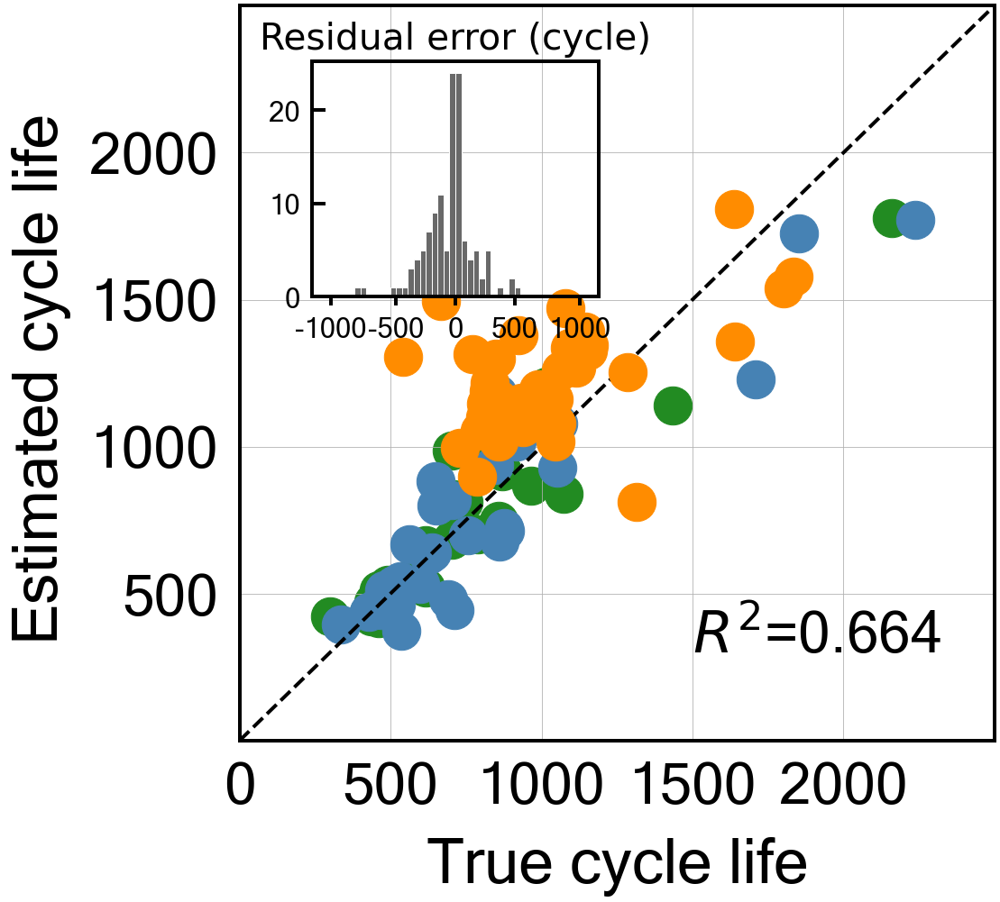


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.5
Best score obtained was: -0.24922696016703783
Cycle no: Average_2to102
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to102') : 0.0008759351305390163
T_Q('Charge', 'Skewness', 'Average_2to102') : 0.009309222988402437
T_Q('Charge', 'Max-Min', 'Average_2to102') : -0.004985881538853184
dTdQ('Charge', 'Maximum', 'Average_2to102') : -0.07109166478590012
dTdQ('Discharge', 'Max-Min', 'Average_2to102') : 0.03947534620640297
nature_dictAvg_charge_time : 0.09404828101391825
nature_dictIR_cycle2 : -0.027795064444728613
nature_dictMinT_2to102 : 0.03373740443449661
nature_dictIntegralT_2to102 : -0.04103248565949081

Intercept: 2.793969897643638
r2-score: 0.714
MAE_all: 146.8
MAE_train: 76.9
MAE_test: 97.5
MAE_2ndTest: 270.2
MAPE_all: 17.3 %
MAPE_train: 10.0 %
MAPE_test: 11.8 %
MAPE_2ndTest: 30.5 %
RMSE_all: 213.2
RMSE_train: 118.8
RMSE_test: 150.5
RMSE_2ndTest

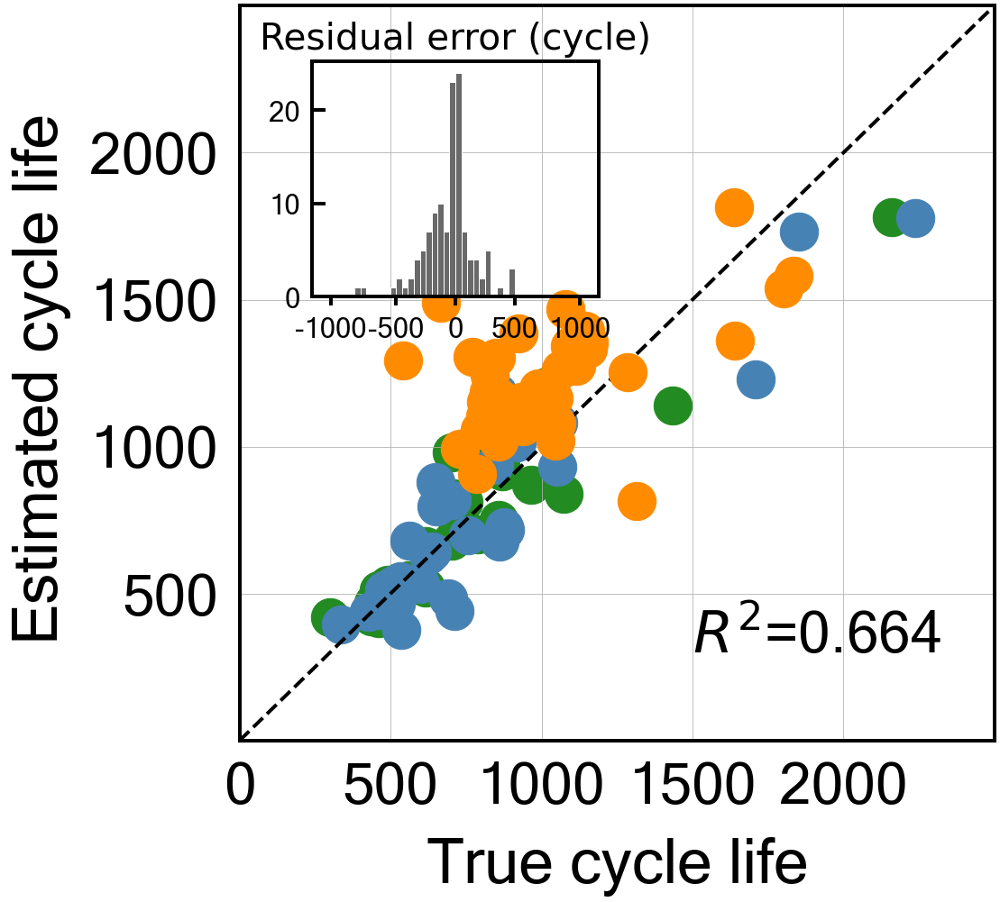


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.1
Best score obtained was: -0.24337116280542936
Cycle no: Average_2to103
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to103') : 0.000545085753850542
T_Q('Charge', 'Skewness', 'Average_2to103') : 0.009088831559090276
T_Q('Charge', 'Max-Min', 'Average_2to103') : -0.0060925752326681645
dTdQ('Charge', 'Maximum', 'Average_2to103') : -0.0715390081862744
dTdQ('Discharge', 'Max-Min', 'Average_2to103') : 0.041177331162524373
nature_dictAvg_charge_time : 0.09350841086424273
nature_dictIR_cycle2 : -0.027290137916168928
nature_dictMinT_2to103 : 0.033662968137405276
nature_dictIntegralT_2to103 : -0.041280735724462725

Intercept: 2.7939698976436373
r2-score: 0.716
MAE_all: 146.8
MAE_train: 76.7
MAE_test: 97.5
MAE_2ndTest: 270.4
MAPE_all: 17.3 %
MAPE_train: 9.9 %
MAPE_test: 11.9 %
MAPE_2ndTest: 30.5 %
RMSE_all: 212.7
RMSE_train: 118.5
RMSE_test: 150.0
RMSE_2ndTe

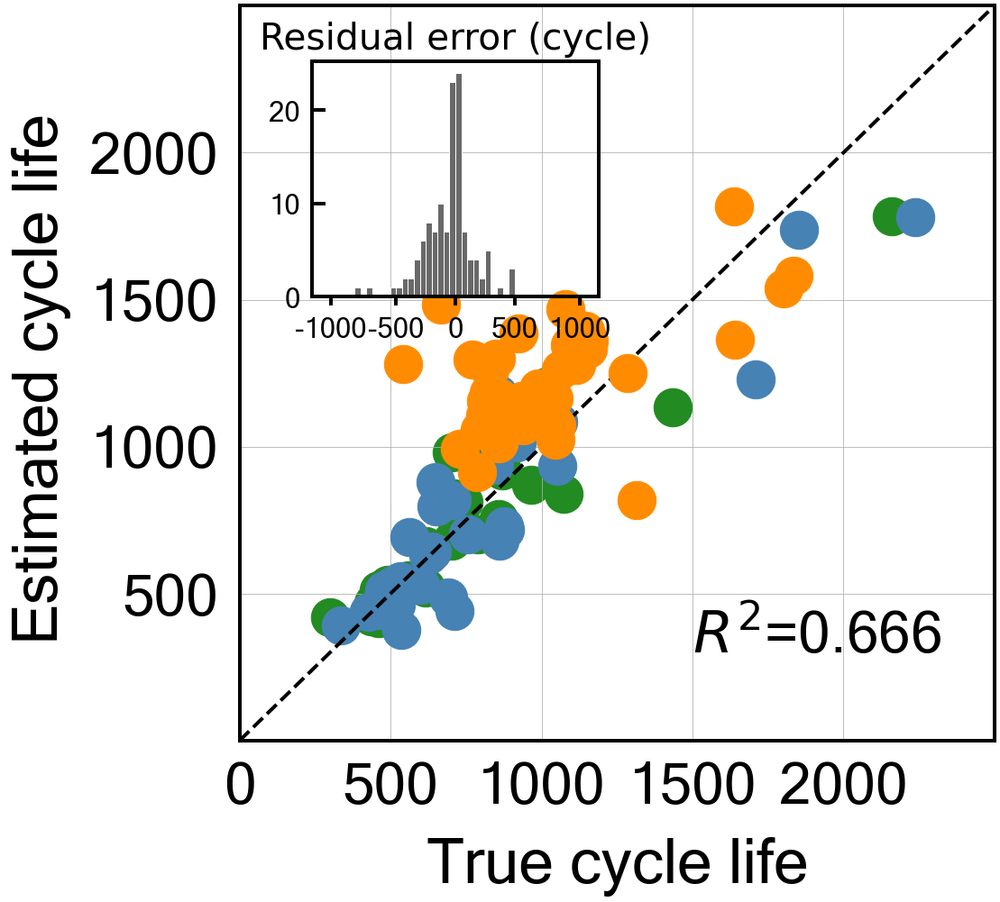


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.5
Best score obtained was: -0.24941781344374037
Cycle no: Average_2to104
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to104') : 0.0005255667187319912
T_Q('Charge', 'Skewness', 'Average_2to104') : 0.009205491232621928
T_Q('Charge', 'Max-Min', 'Average_2to104') : -0.005504138928449518
dTdQ('Charge', 'Maximum', 'Average_2to104') : -0.07158153220401284
dTdQ('Discharge', 'Max-Min', 'Average_2to104') : 0.0407073736065077
nature_dictAvg_charge_time : 0.09351539208864748
nature_dictIR_cycle2 : -0.026753892837110077
nature_dictMinT_2to104 : 0.03406399686570632
nature_dictIntegralT_2to104 : -0.04191857786283876

Intercept: 2.793969897643638
r2-score: 0.715
MAE_all: 147.1
MAE_train: 76.5
MAE_test: 97.5
MAE_2ndTest: 271.5
MAPE_all: 17.3 %
MAPE_train: 9.9 %
MAPE_test: 11.8 %
MAPE_2ndTest: 30.6 %
RMSE_all: 213.2
RMSE_train: 118.6
RMSE_test: 150.4
RMSE_2ndTest: 

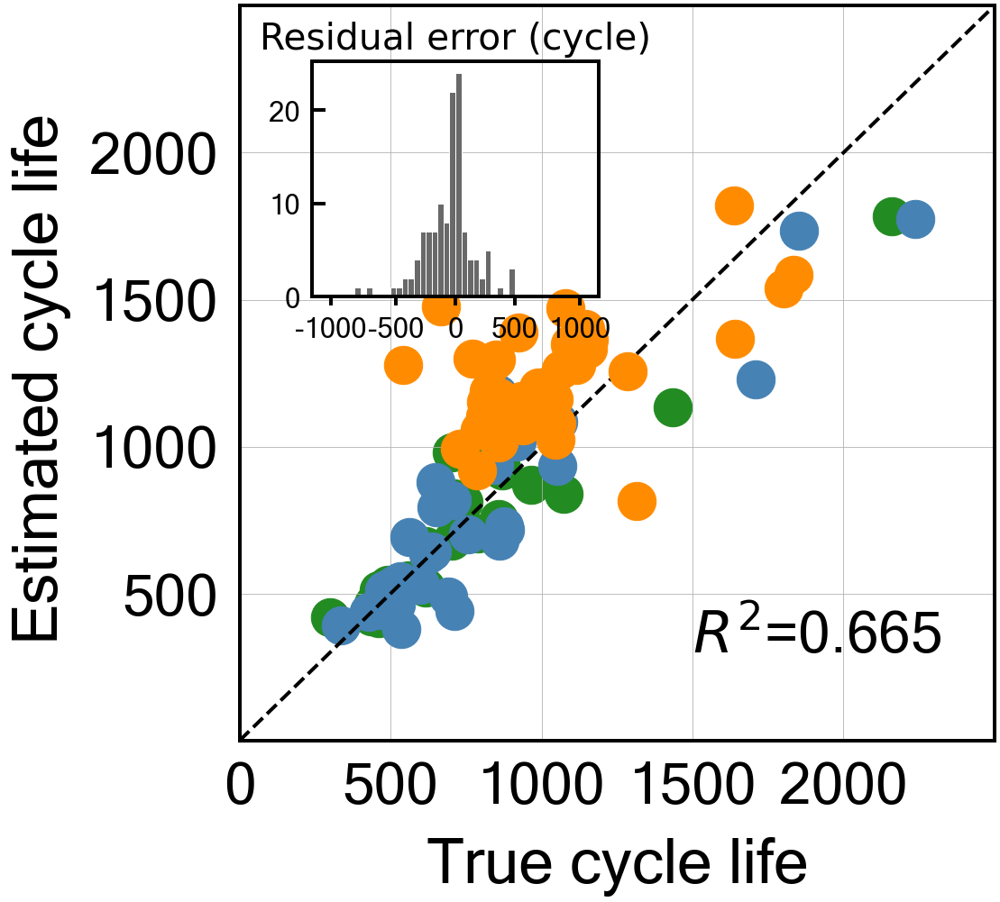


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: -0.24642831110486374
Cycle no: Average_2to105
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to105') : 9.823335292225805e-05
T_Q('Charge', 'Skewness', 'Average_2to105') : 0.00900877329784719
T_Q('Charge', 'Max-Min', 'Average_2to105') : -0.005397819794686316
dTdQ('Charge', 'Maximum', 'Average_2to105') : -0.07139730026689002
dTdQ('Discharge', 'Max-Min', 'Average_2to105') : 0.04080109713919823
nature_dictAvg_charge_time : 0.0933244826550854
nature_dictIR_cycle2 : -0.026289106621866162
nature_dictMinT_2to105 : 0.03426662557150078
nature_dictIntegralT_2to105 : -0.04231192101343687

Intercept: 2.793969897643638
r2-score: 0.716
MAE_all: 147.1
MAE_train: 76.4
MAE_test: 97.5
MAE_2ndTest: 271.6
MAPE_all: 17.3 %
MAPE_train: 9.9 %
MAPE_test: 11.8 %
MAPE_2ndTest: 30.6 %
RMSE_all: 213.1
RMSE_train: 118.8
RMSE_test: 150.6
RMSE_2ndTest: 3

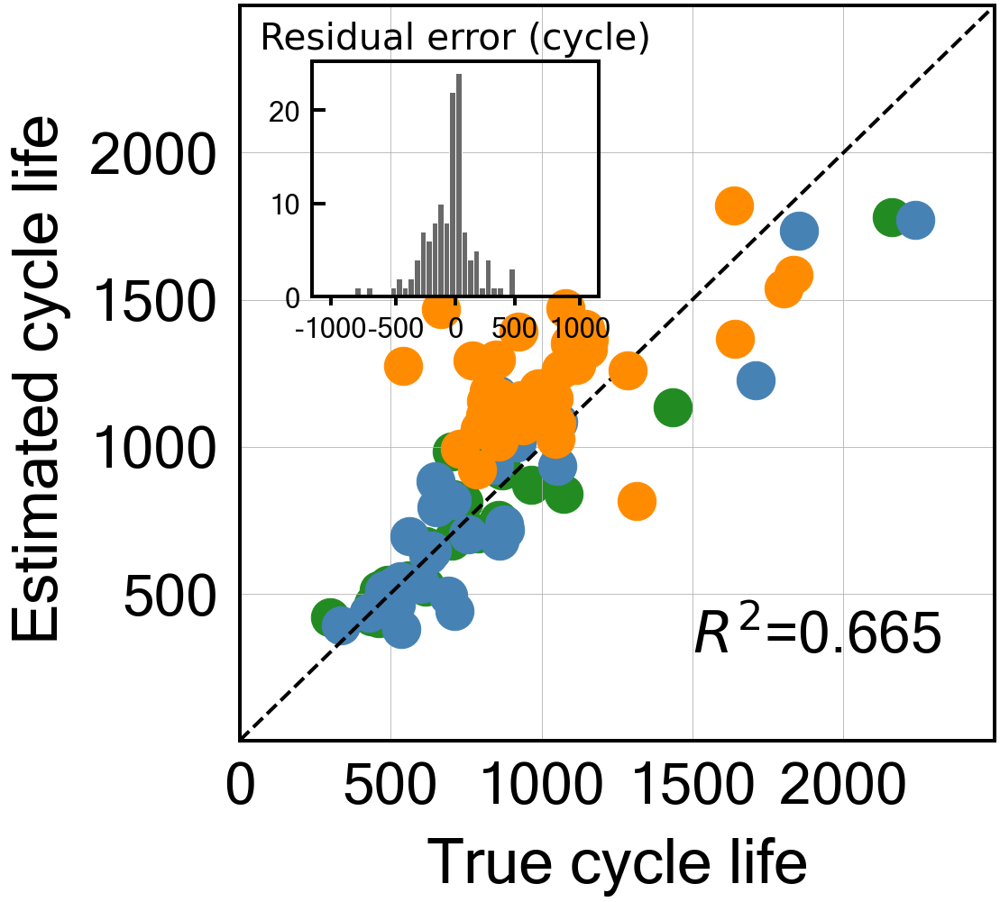


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.5
Best score obtained was: -0.25264565651725035
Cycle no: Average_2to106
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to106') : 0.00023628362700048417
T_Q('Charge', 'Skewness', 'Average_2to106') : 0.008848913944624021
T_Q('Charge', 'Max-Min', 'Average_2to106') : -0.004654051247487775
dTdQ('Charge', 'Maximum', 'Average_2to106') : -0.07117060083468912
dTdQ('Discharge', 'Max-Min', 'Average_2to106') : 0.04018529084827866
nature_dictAvg_charge_time : 0.09367594774767954
nature_dictIR_cycle2 : -0.02590074047923879
nature_dictMinT_2to106 : 0.034450661728873545
nature_dictIntegralT_2to106 : -0.04310347194651196

Intercept: 2.793969897643638
r2-score: 0.715
MAE_all: 147.3
MAE_train: 76.3
MAE_test: 97.3
MAE_2ndTest: 272.5
MAPE_all: 17.3 %
MAPE_train: 9.9 %
MAPE_test: 11.8 %
MAPE_2ndTest: 30.7 %
RMSE_all: 213.4
RMSE_train: 118.7
RMSE_test: 150.3
RMSE_2ndTest

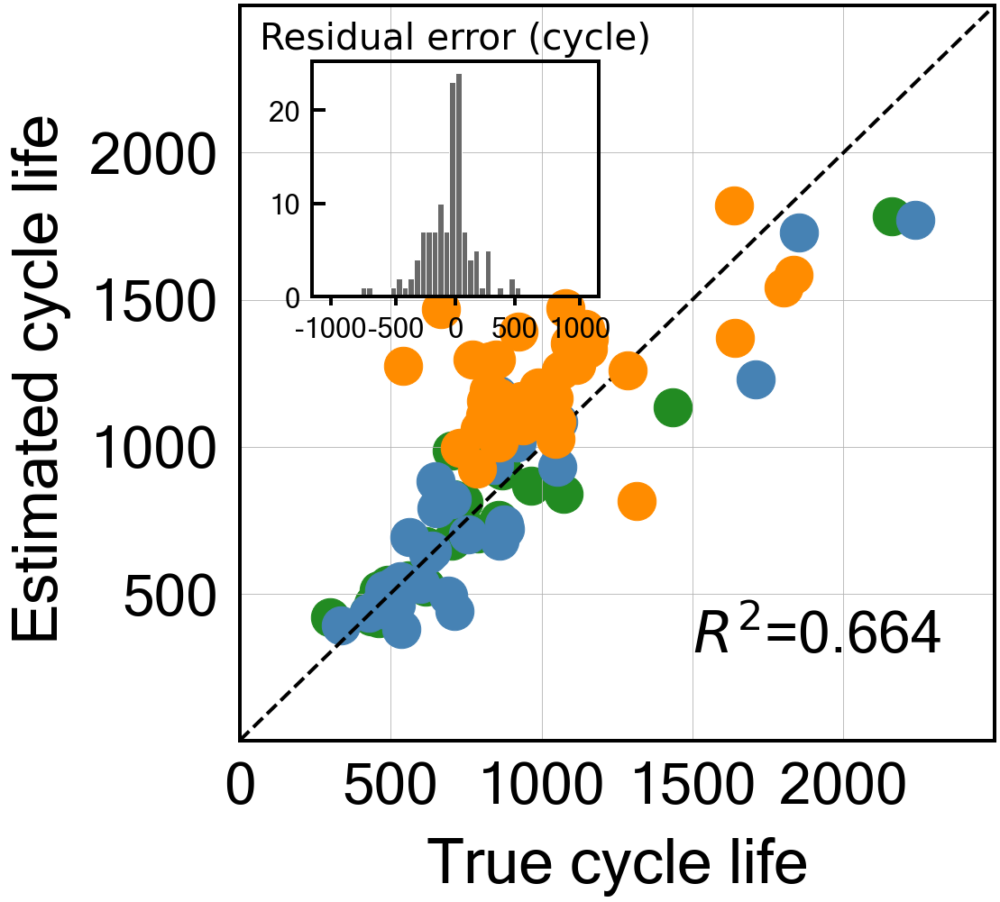


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.3
Best score obtained was: -0.26732017436272293
Cycle no: Average_2to107
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to107') : 0.0004978986921218959
T_Q('Charge', 'Skewness', 'Average_2to107') : 0.008741036755812628
T_Q('Charge', 'Max-Min', 'Average_2to107') : -0.0040857509620121175
dTdQ('Charge', 'Maximum', 'Average_2to107') : -0.07132085498003801
dTdQ('Discharge', 'Max-Min', 'Average_2to107') : 0.039890369824490124
nature_dictAvg_charge_time : 0.0940700395980345
nature_dictIR_cycle2 : -0.025458668771204857
nature_dictMinT_2to107 : 0.03482797199587796
nature_dictIntegralT_2to107 : -0.043829726410654704

Intercept: 2.7939698976436373
r2-score: 0.714
MAE_all: 147.9
MAE_train: 76.4
MAE_test: 97.1
MAE_2ndTest: 274.4
MAPE_all: 17.4 %
MAPE_train: 9.9 %
MAPE_test: 11.8 %
MAPE_2ndTest: 30.9 %
RMSE_all: 214.2
RMSE_train: 118.8
RMSE_test: 149.8
RMSE_2ndTe

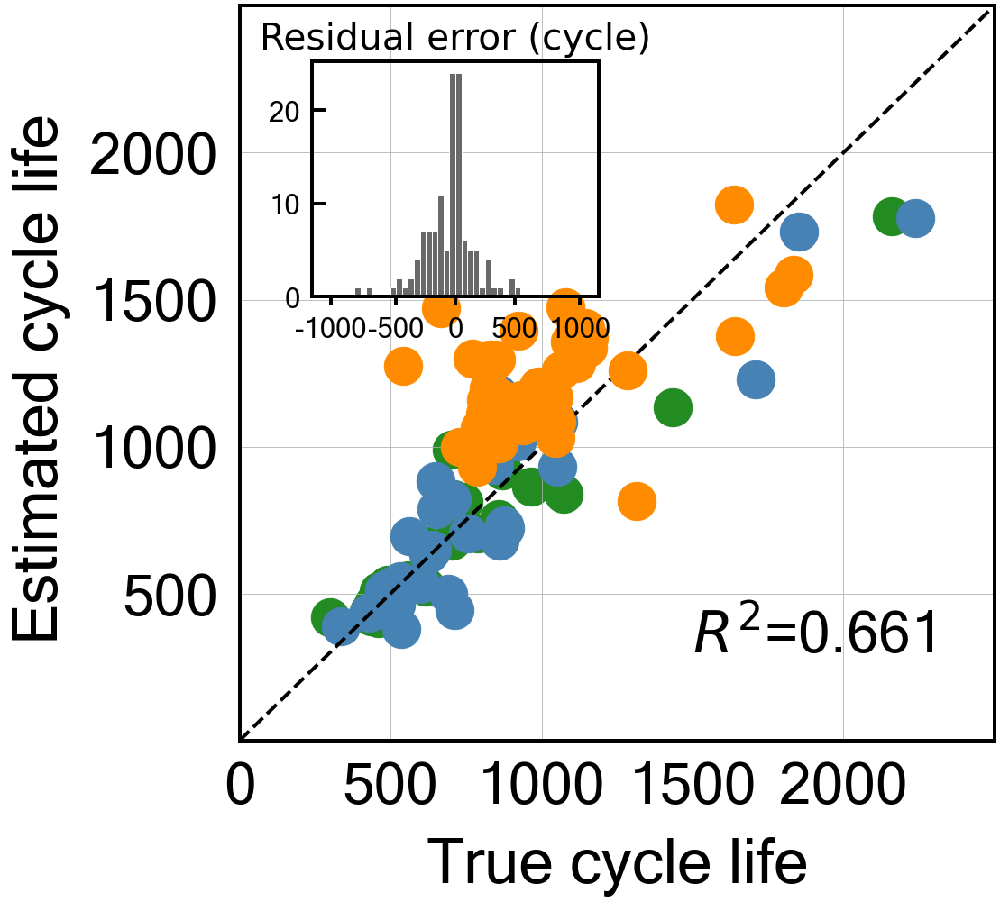


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: -0.27780640263750467
Cycle no: Average_2to108
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to108') : 0.000475954271935449
T_Q('Charge', 'Skewness', 'Average_2to108') : 0.008982258143211066
T_Q('Charge', 'Max-Min', 'Average_2to108') : -0.003866451356117009
dTdQ('Charge', 'Maximum', 'Average_2to108') : -0.07164609215937431
dTdQ('Discharge', 'Max-Min', 'Average_2to108') : 0.04020687321216835
nature_dictAvg_charge_time : 0.09407346288217505
nature_dictIR_cycle2 : -0.025288907402733235
nature_dictMinT_2to108 : 0.03486316575393639
nature_dictIntegralT_2to108 : -0.04418239233194842

Intercept: 2.7939698976436373
r2-score: 0.713
MAE_all: 148.1
MAE_train: 76.2
MAE_test: 96.9
MAE_2ndTest: 275.6
MAPE_all: 17.4 %
MAPE_train: 9.8 %
MAPE_test: 11.7 %
MAPE_2ndTest: 31.1 %
RMSE_all: 214.7
RMSE_train: 118.8
RMSE_test: 149.3
RMSE_2ndTest:

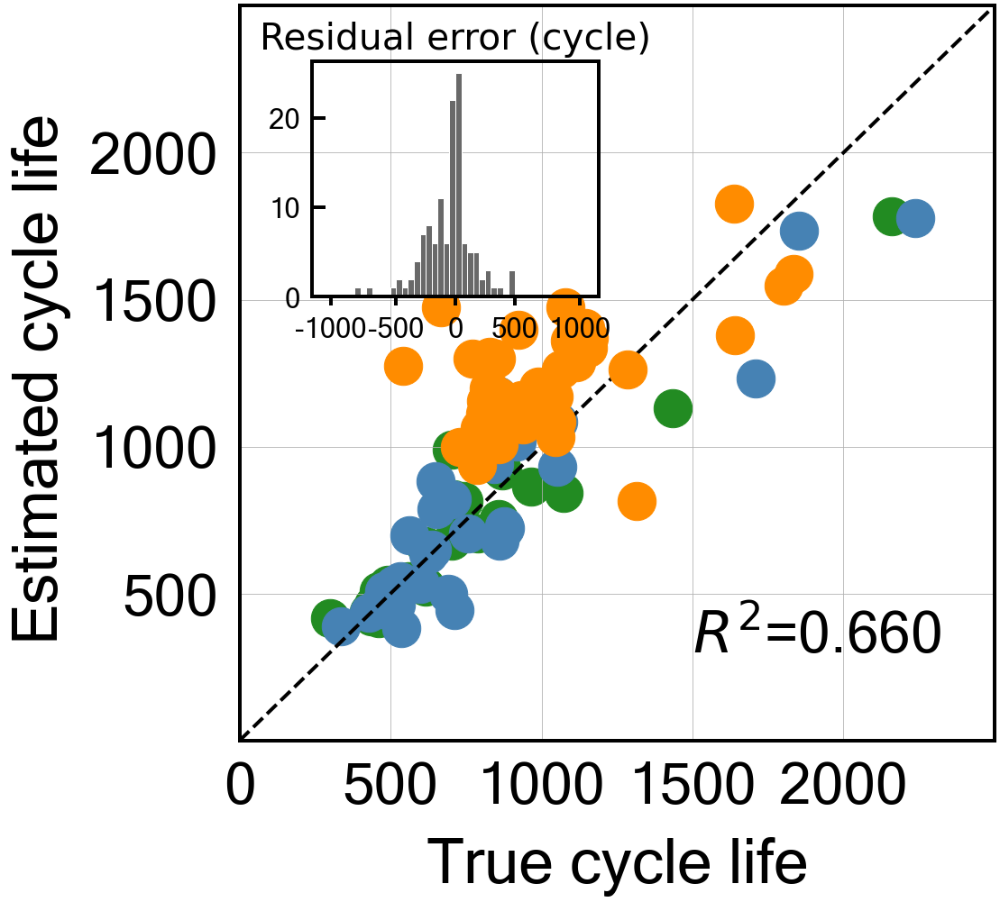


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: -0.28613386988327516
Cycle no: Average_2to109
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to109') : 0.0004887231055464131
T_Q('Charge', 'Skewness', 'Average_2to109') : 0.009038008095057757
T_Q('Charge', 'Max-Min', 'Average_2to109') : -0.003537705263333514
dTdQ('Charge', 'Maximum', 'Average_2to109') : -0.07170141418772351
dTdQ('Discharge', 'Max-Min', 'Average_2to109') : 0.04015364473696045
nature_dictAvg_charge_time : 0.0941046832626963
nature_dictIR_cycle2 : -0.024942478498808523
nature_dictMinT_2to109 : 0.035044406863004585
nature_dictIntegralT_2to109 : -0.04470091413487649

Intercept: 2.7939698976436373
r2-score: 0.713
MAE_all: 148.3
MAE_train: 76.2
MAE_test: 96.7
MAE_2ndTest: 276.6
MAPE_all: 17.4 %
MAPE_train: 9.8 %
MAPE_test: 11.7 %
MAPE_2ndTest: 31.2 %
RMSE_all: 215.1
RMSE_train: 118.7
RMSE_test: 148.9
RMSE_2ndTest

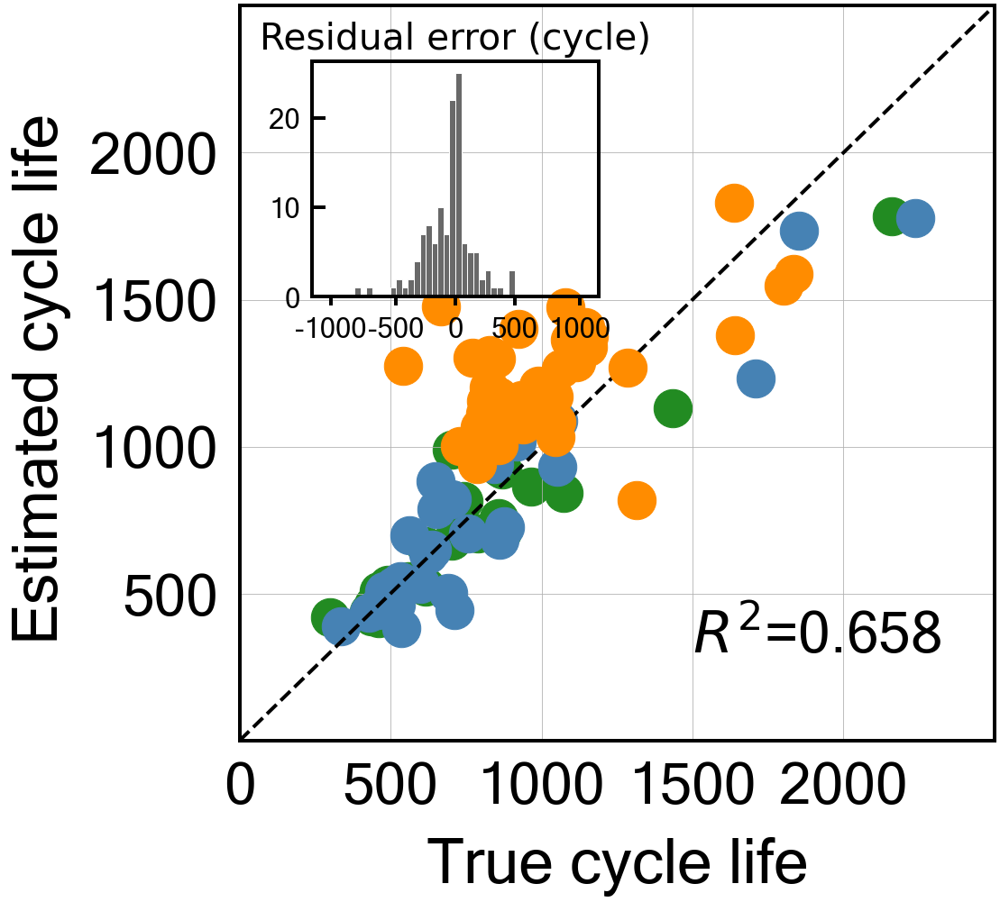


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: -0.29752238757568494
Cycle no: Average_2to110
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to110') : 0.0005126700419930731
T_Q('Charge', 'Skewness', 'Average_2to110') : 0.008861853363944884
T_Q('Charge', 'Max-Min', 'Average_2to110') : -0.00236550844891415
dTdQ('Charge', 'Maximum', 'Average_2to110') : -0.07155815351141398
dTdQ('Discharge', 'Max-Min', 'Average_2to110') : 0.039246020563418006
nature_dictAvg_charge_time : 0.09455312069061277
nature_dictIR_cycle2 : -0.02443904516133688
nature_dictMinT_2to110 : 0.035563395401794755
nature_dictIntegralT_2to110 : -0.04551682092821935

Intercept: 2.793969897643638
r2-score: 0.712
MAE_all: 148.6
MAE_train: 76.3
MAE_test: 95.9
MAE_2ndTest: 278.1
MAPE_all: 17.4 %
MAPE_train: 9.8 %
MAPE_test: 11.6 %
MAPE_2ndTest: 31.4 %
RMSE_all: 215.8
RMSE_train: 118.8
RMSE_test: 148.7
RMSE_2ndTest:

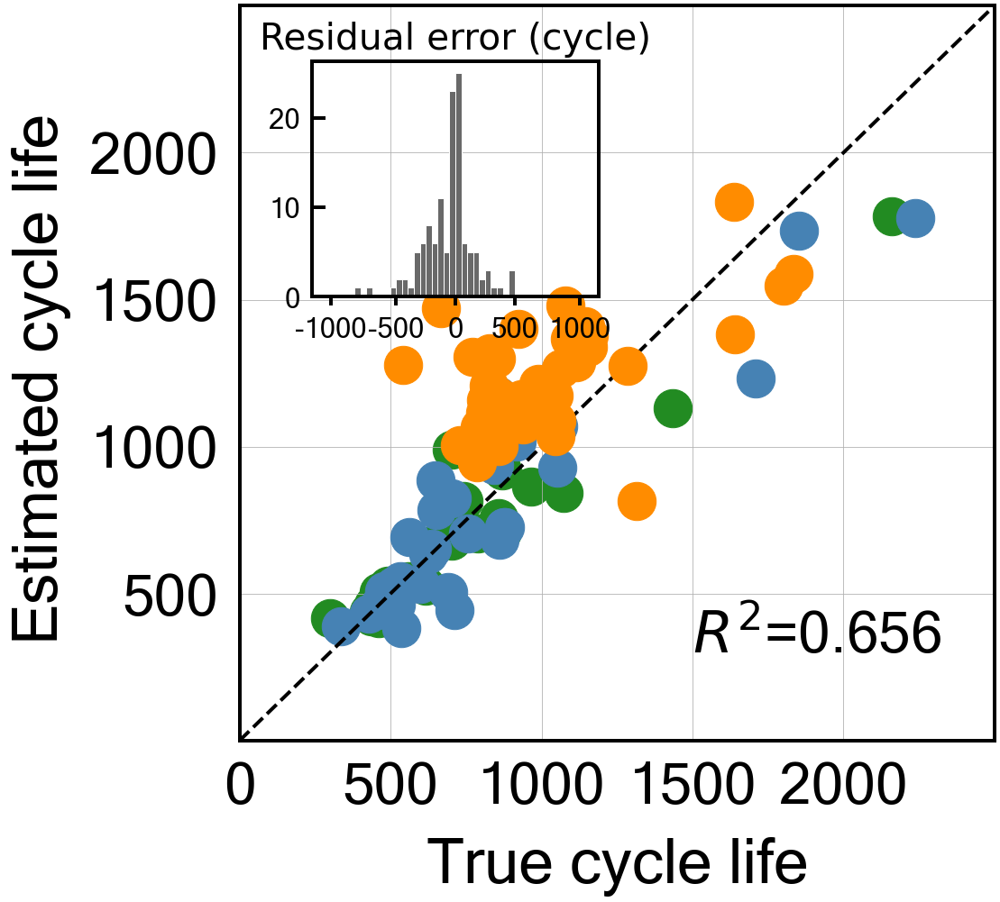


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: -0.3032900920031345
Cycle no: Average_2to111
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to111') : 0.0002643822424779536
T_Q('Charge', 'Skewness', 'Average_2to111') : 0.008796115329419821
T_Q('Charge', 'Max-Min', 'Average_2to111') : -0.002059260281100665
dTdQ('Charge', 'Maximum', 'Average_2to111') : -0.07185315217091827
dTdQ('Discharge', 'Max-Min', 'Average_2to111') : 0.039413856929118474
nature_dictAvg_charge_time : 0.0944672063383908
nature_dictIR_cycle2 : -0.023919045787357564
nature_dictMinT_2to111 : 0.035744733785690846
nature_dictIntegralT_2to111 : -0.045892450351238734

Intercept: 2.7939698976436373
r2-score: 0.712
MAE_all: 148.8
MAE_train: 76.0
MAE_test: 95.6
MAE_2ndTest: 279.2
MAPE_all: 17.5 %
MAPE_train: 9.8 %
MAPE_test: 11.6 %
MAPE_2ndTest: 31.5 %
RMSE_all: 215.9
RMSE_train: 118.4
RMSE_test: 148.0
RMSE_2ndTes

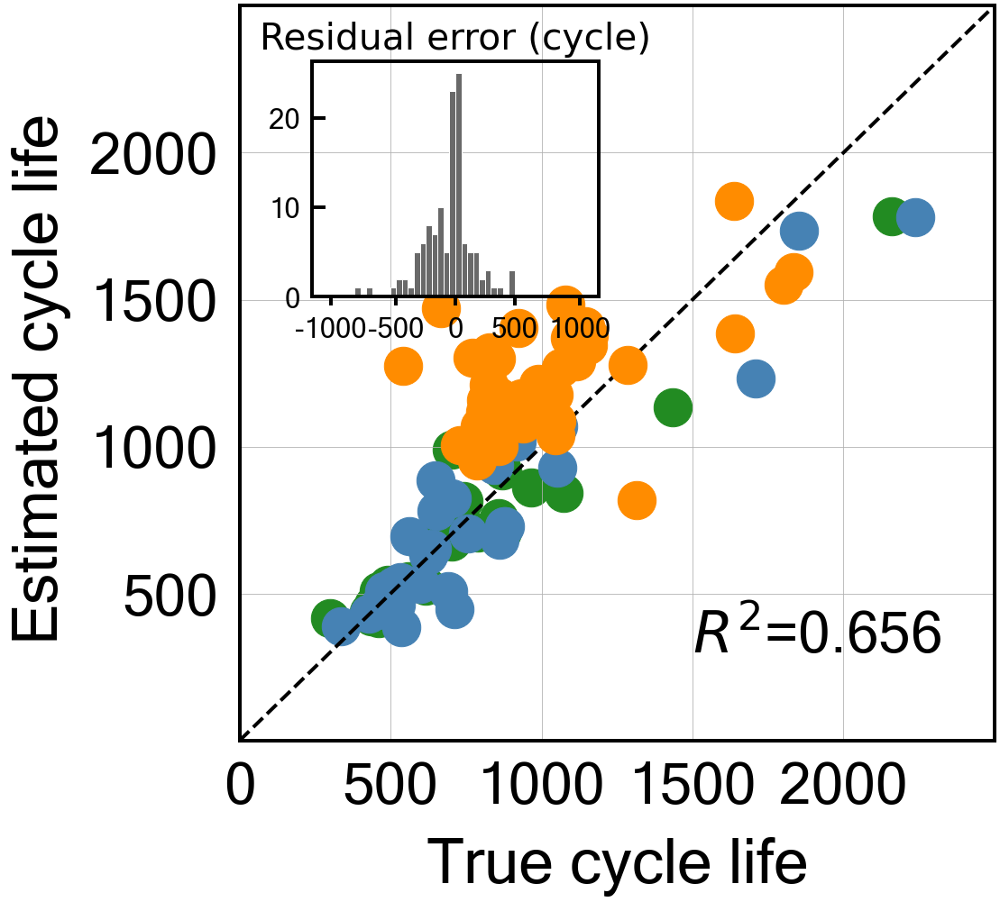


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: -0.28612172045355844
Cycle no: Average_2to112
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to112') : 0.0
T_Q('Charge', 'Skewness', 'Average_2to112') : 0.008524637085407152
T_Q('Charge', 'Max-Min', 'Average_2to112') : -0.002365952222977193
dTdQ('Charge', 'Maximum', 'Average_2to112') : -0.07141435506875082
dTdQ('Discharge', 'Max-Min', 'Average_2to112') : 0.03969347372958603
nature_dictAvg_charge_time : 0.09418295421656443
nature_dictIR_cycle2 : -0.02360322289025448
nature_dictMinT_2to112 : 0.03563057167055849
nature_dictIntegralT_2to112 : -0.04618197718366164

Intercept: 2.7939698976436373
r2-score: 0.715
MAE_all: 148.0
MAE_train: 75.8
MAE_test: 95.6
MAE_2ndTest: 277.1
MAPE_all: 17.4 %
MAPE_train: 9.8 %
MAPE_test: 11.6 %
MAPE_2ndTest: 31.2 %
RMSE_all: 214.9
RMSE_train: 118.6
RMSE_test: 148.0
RMSE_2ndTest: 323.3
RMSPE_all: 

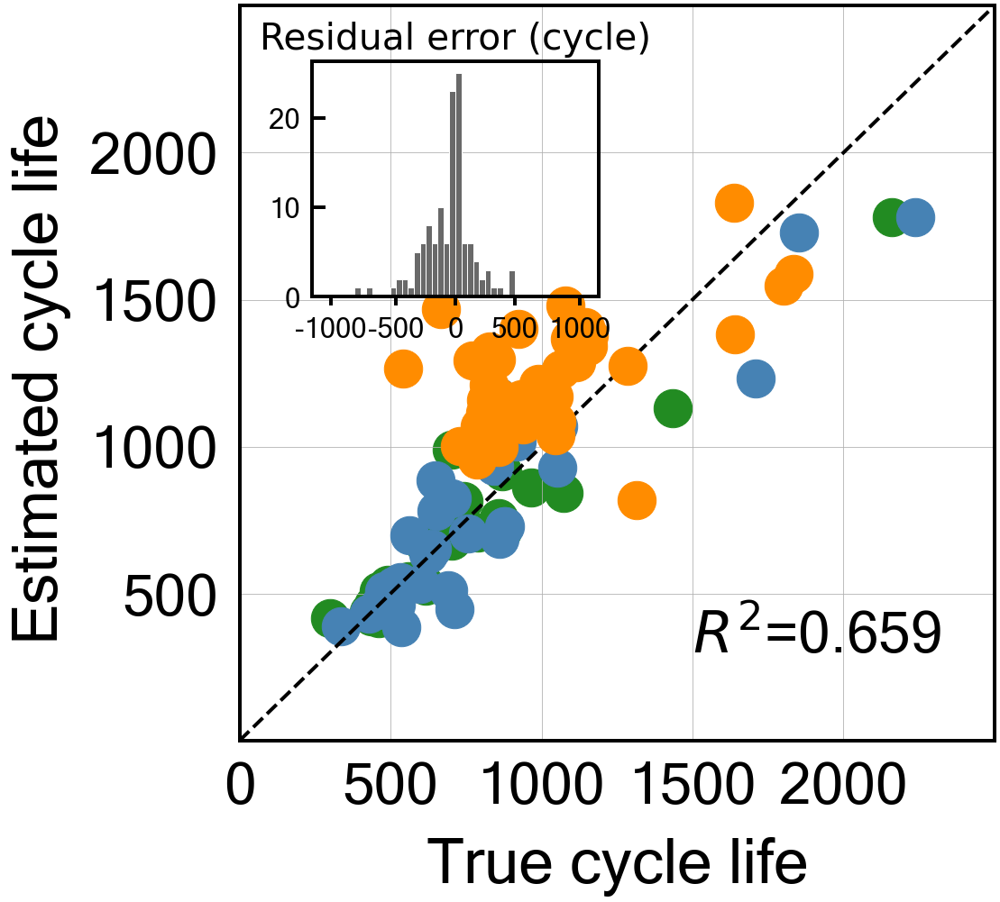


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: -0.2949045681225
Cycle no: Average_2to113
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to113') : 0.0
T_Q('Charge', 'Skewness', 'Average_2to113') : 0.008445119313401455
T_Q('Charge', 'Max-Min', 'Average_2to113') : -0.0039887111142086346
dTdQ('Charge', 'Maximum', 'Average_2to113') : -0.07172215361790081
dTdQ('Discharge', 'Max-Min', 'Average_2to113') : 0.04115608920993521
nature_dictAvg_charge_time : 0.09353073704422163
nature_dictIR_cycle2 : -0.023244661577226038
nature_dictMinT_2to113 : 0.03567491825530197
nature_dictIntegralT_2to113 : -0.046306896357831466

Intercept: 2.793969897643637
r2-score: 0.714
MAE_all: 148.6
MAE_train: 75.6
MAE_test: 96.0
MAE_2ndTest: 278.7
MAPE_all: 17.4 %
MAPE_train: 9.7 %
MAPE_test: 11.7 %
MAPE_2ndTest: 31.4 %
RMSE_all: 215.4
RMSE_train: 118.7
RMSE_test: 147.9
RMSE_2ndTest: 324.4
RMSPE_all: 26

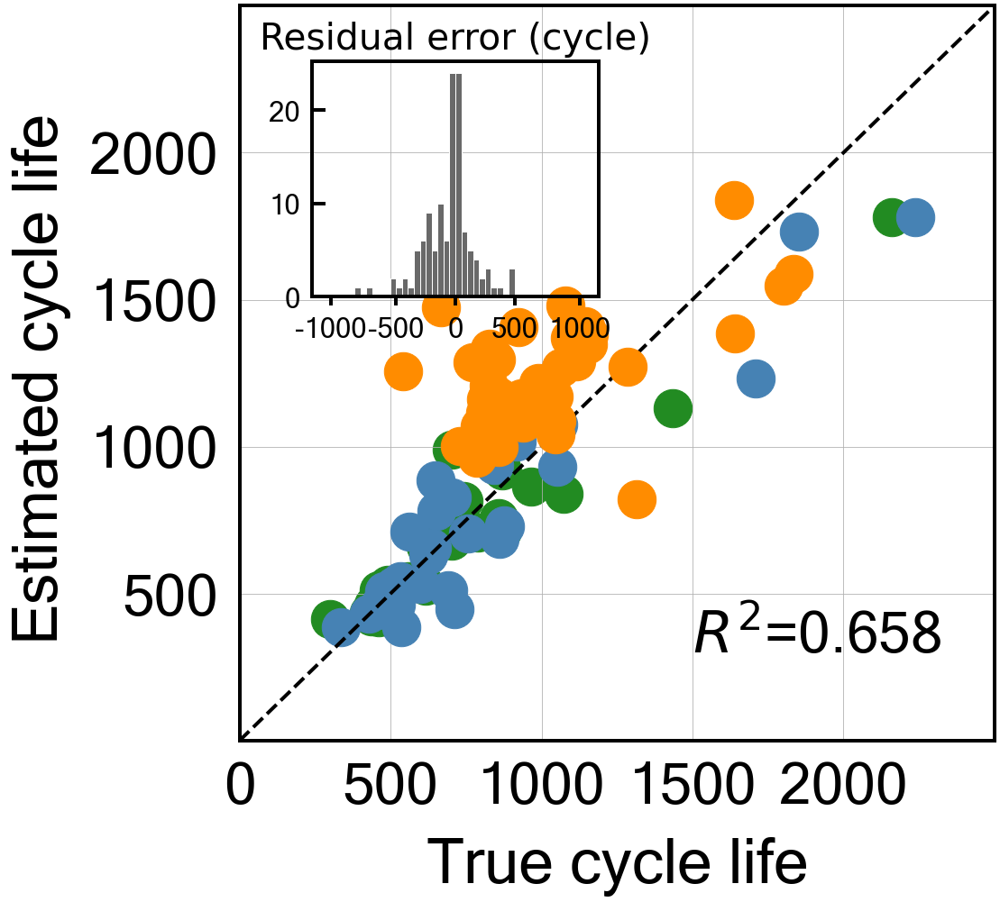


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: -0.3018902462147759
Cycle no: Average_2to114
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to114') : -0.0
T_Q('Charge', 'Skewness', 'Average_2to114') : 0.008419190396020852
T_Q('Charge', 'Max-Min', 'Average_2to114') : -0.004890258781443486
dTdQ('Charge', 'Maximum', 'Average_2to114') : -0.07217805704627368
dTdQ('Discharge', 'Max-Min', 'Average_2to114') : 0.04234897034216765
nature_dictAvg_charge_time : 0.09311075838031023
nature_dictIR_cycle2 : -0.022673548997624825
nature_dictMinT_2to114 : 0.035724776140262045
nature_dictIntegralT_2to114 : -0.04668591723353378

Intercept: 2.7939698976436373
r2-score: 0.714
MAE_all: 148.9
MAE_train: 75.3
MAE_test: 95.9
MAE_2ndTest: 280.0
MAPE_all: 17.5 %
MAPE_train: 9.7 %
MAPE_test: 11.7 %
MAPE_2ndTest: 31.5 %
RMSE_all: 215.6
RMSE_train: 118.4
RMSE_test: 147.3
RMSE_2ndTest: 325.3
RMSPE_all

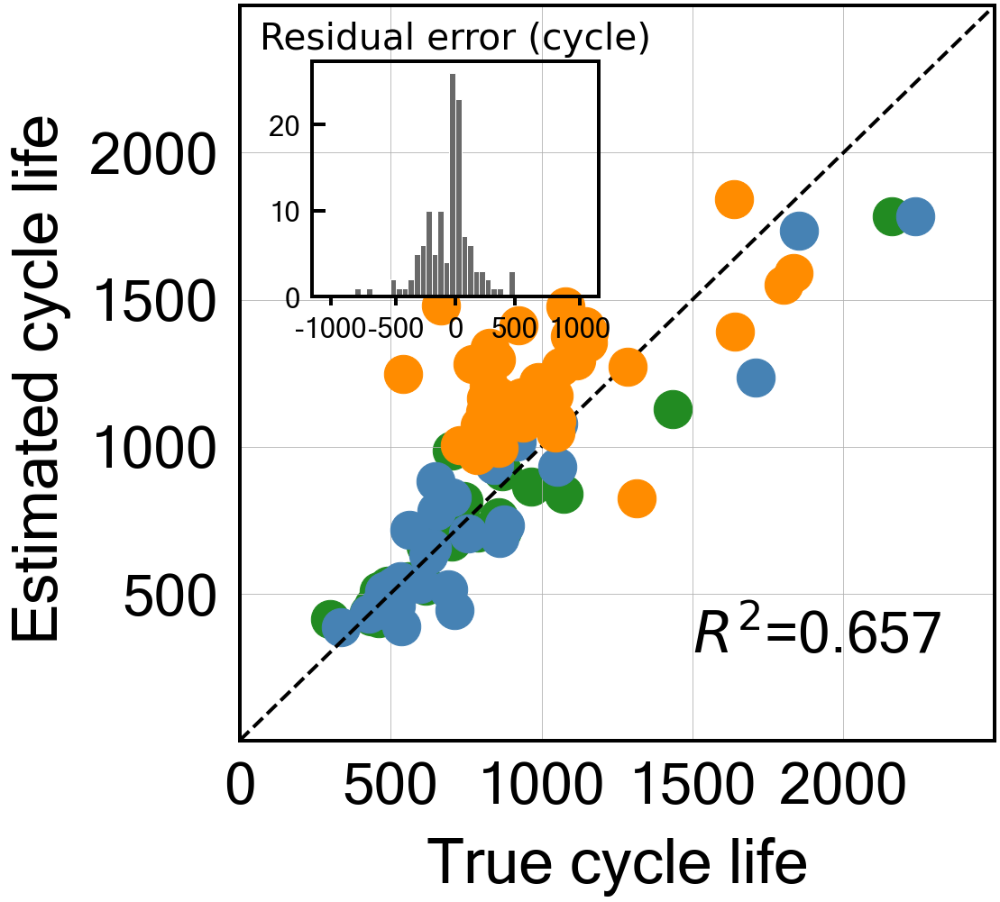


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.3
Best score obtained was: -0.2979132866041887
Cycle no: Average_2to115
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to115') : 0.0
T_Q('Charge', 'Skewness', 'Average_2to115') : 0.008146163715917358
T_Q('Charge', 'Max-Min', 'Average_2to115') : -0.003971296435061924
dTdQ('Charge', 'Maximum', 'Average_2to115') : -0.07151333384426947
dTdQ('Discharge', 'Max-Min', 'Average_2to115') : 0.04124724654202971
nature_dictAvg_charge_time : 0.09323779891608582
nature_dictIR_cycle2 : -0.022498895639937955
nature_dictMinT_2to115 : 0.03588081686984867
nature_dictIntegralT_2to115 : -0.0472139065883561

Intercept: 2.7939698976436373
r2-score: 0.714
MAE_all: 148.7
MAE_train: 75.4
MAE_test: 95.6
MAE_2ndTest: 279.4
MAPE_all: 17.4 %
MAPE_train: 9.7 %
MAPE_test: 11.6 %
MAPE_2ndTest: 31.5 %
RMSE_all: 215.5
RMSE_train: 118.9
RMSE_test: 147.5
RMSE_2ndTest: 324.8
RMSPE_all: 2

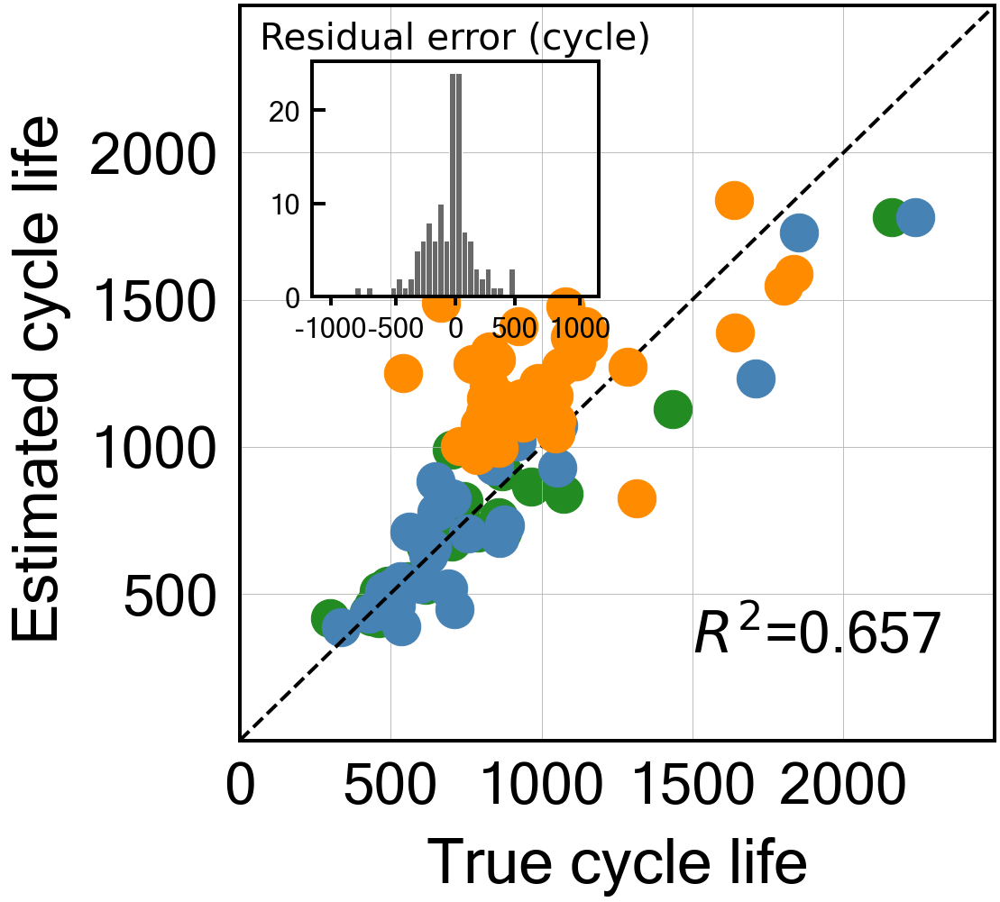


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.4
Best score obtained was: -0.29769934482068816
Cycle no: Average_2to116
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to116') : 0.0
T_Q('Charge', 'Skewness', 'Average_2to116') : 0.008108754692776441
T_Q('Charge', 'Max-Min', 'Average_2to116') : -0.0031701866307853595
dTdQ('Charge', 'Maximum', 'Average_2to116') : -0.07165790249391205
dTdQ('Discharge', 'Max-Min', 'Average_2to116') : 0.041037597145730326
nature_dictAvg_charge_time : 0.09347546961974479
nature_dictIR_cycle2 : -0.02224297801272584
nature_dictMinT_2to116 : 0.03578417407231984
nature_dictIntegralT_2to116 : -0.04776579243993086

Intercept: 2.7939698976436373
r2-score: 0.715
MAE_all: 148.4
MAE_train: 75.2
MAE_test: 95.5
MAE_2ndTest: 278.9
MAPE_all: 17.4 %
MAPE_train: 9.6 %
MAPE_test: 11.6 %
MAPE_2ndTest: 31.4 %
RMSE_all: 215.3
RMSE_train: 118.5
RMSE_test: 146.9
RMSE_2ndTest: 324.8
RMSPE_all

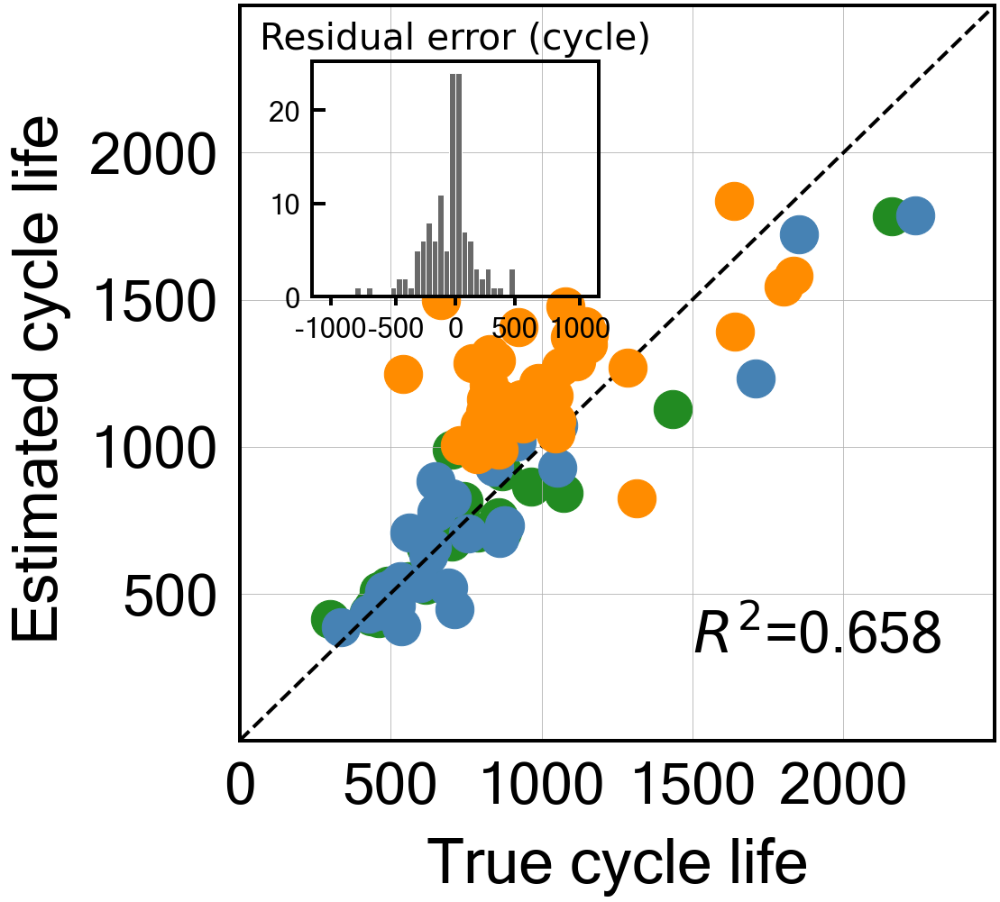


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.9
Best score obtained was: -0.28071224202958334
Cycle no: Average_2to117
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to117') : -0.0
T_Q('Charge', 'Skewness', 'Average_2to117') : 0.007676869740877276
T_Q('Charge', 'Max-Min', 'Average_2to117') : -0.002636557683400202
dTdQ('Charge', 'Maximum', 'Average_2to117') : -0.0708719333049381
dTdQ('Discharge', 'Max-Min', 'Average_2to117') : 0.04019993248588224
nature_dictAvg_charge_time : 0.0936306755525747
nature_dictIR_cycle2 : -0.021783628421131032
nature_dictMinT_2to117 : 0.03583230200236828
nature_dictIntegralT_2to117 : -0.048338737052751

Intercept: 2.793969897643638
r2-score: 0.717
MAE_all: 147.5
MAE_train: 75.2
MAE_test: 95.2
MAE_2ndTest: 276.6
MAPE_all: 17.3 %
MAPE_train: 9.6 %
MAPE_test: 11.5 %
MAPE_2ndTest: 31.2 %
RMSE_all: 214.4
RMSE_train: 118.9
RMSE_test: 147.3
RMSE_2ndTest: 322.7
RMSPE_all: 26.

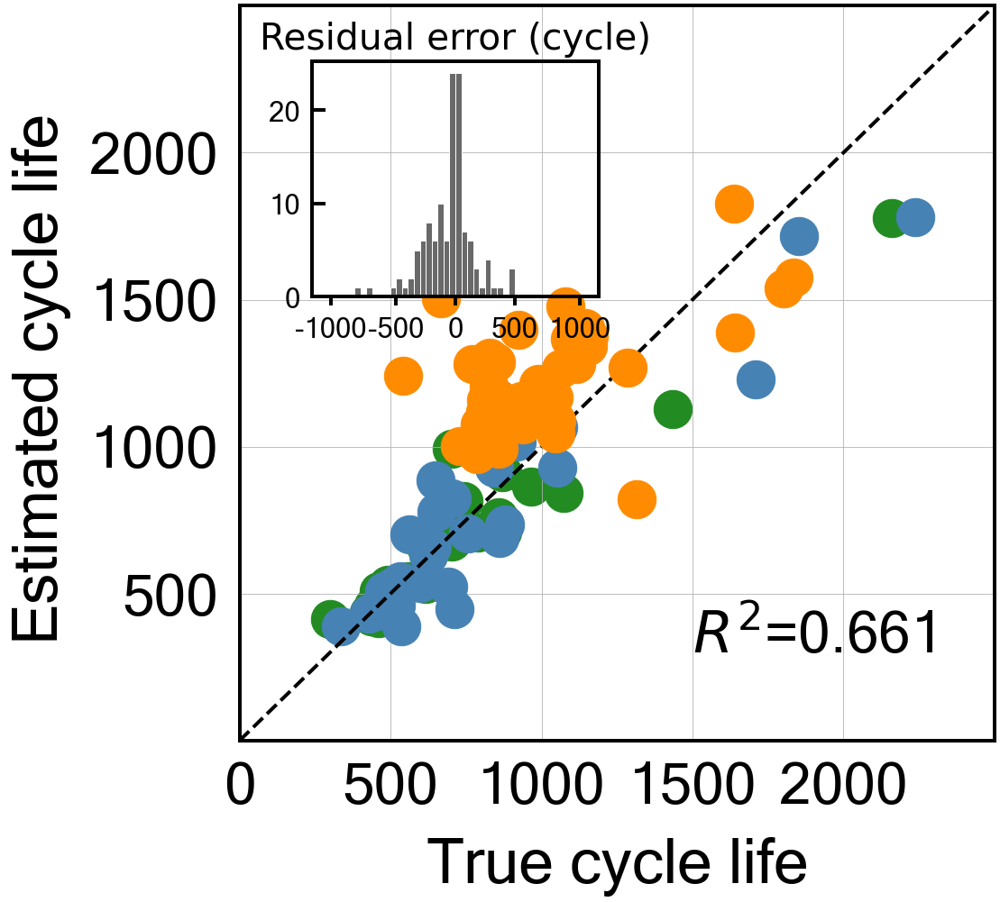


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.6
Best score obtained was: -0.3161549254210998
Cycle no: Average_2to118
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to118') : 0.0013187354761516371
T_Q('Charge', 'Skewness', 'Average_2to118') : 0.008683927328047476
T_Q('Charge', 'Max-Min', 'Average_2to118') : -0.0012904266583979728
dTdQ('Charge', 'Maximum', 'Average_2to118') : -0.07251274558449493
dTdQ('Discharge', 'Max-Min', 'Average_2to118') : 0.04023529829766776
nature_dictAvg_charge_time : 0.09446181064017864
nature_dictIR_cycle2 : -0.021318912833943993
nature_dictMinT_2to118 : 0.03589853341625111
nature_dictIntegralT_2to118 : -0.04956022212704362

Intercept: 2.7939698976436373
r2-score: 0.714
MAE_all: 148.4
MAE_train: 75.0
MAE_test: 94.7
MAE_2ndTest: 280.2
MAPE_all: 17.4 %
MAPE_train: 9.6 %
MAPE_test: 11.5 %
MAPE_2ndTest: 31.6 %
RMSE_all: 216.1
RMSE_train: 117.9
RMSE_test: 145.9
RMSE_2ndTest

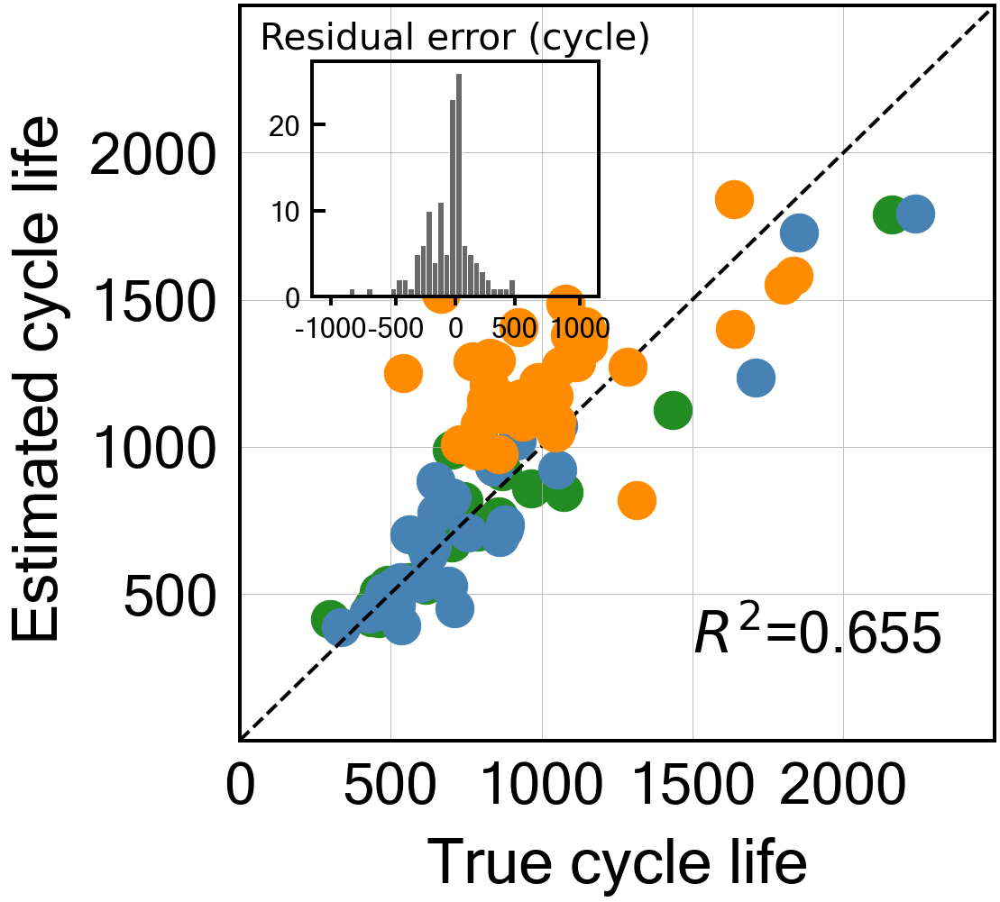


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.6
Best score obtained was: -0.3144966877709139
Cycle no: Average_2to119
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to119') : 0.0012173240972170368
T_Q('Charge', 'Skewness', 'Average_2to119') : 0.008876157334657813
T_Q('Charge', 'Max-Min', 'Average_2to119') : -0.0009687277267569349
dTdQ('Charge', 'Maximum', 'Average_2to119') : -0.0729843100152528
dTdQ('Discharge', 'Max-Min', 'Average_2to119') : 0.04070008344533251
nature_dictAvg_charge_time : 0.09485650101183468
nature_dictIR_cycle2 : -0.02113936966481128
nature_dictMinT_2to119 : 0.0357061483777291
nature_dictIntegralT_2to119 : -0.04981712999218683

Intercept: 2.7939698976436373
r2-score: 0.715
MAE_all: 148.2
MAE_train: 75.0
MAE_test: 94.8
MAE_2ndTest: 279.4
MAPE_all: 17.4 %
MAPE_train: 9.6 %
MAPE_test: 11.5 %
MAPE_2ndTest: 31.5 %
RMSE_all: 216.1
RMSE_train: 118.2
RMSE_test: 146.1
RMSE_2ndTest: 3

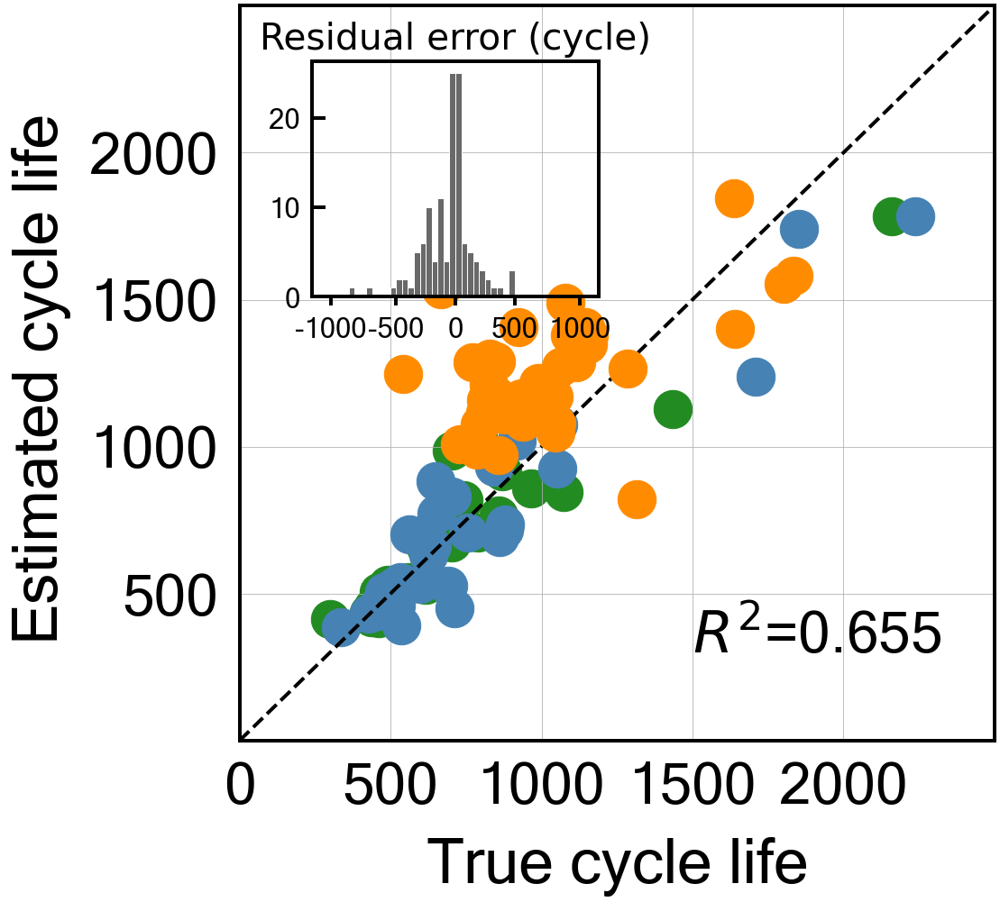


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.2
Best score obtained was: -0.3237986060949052
Cycle no: Average_2to120
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to120') : 8.694391631460091e-05
T_Q('Charge', 'Skewness', 'Average_2to120') : 0.008634982410844596
T_Q('Charge', 'Max-Min', 'Average_2to120') : 0.0
dTdQ('Charge', 'Maximum', 'Average_2to120') : -0.07285416286019823
dTdQ('Discharge', 'Max-Min', 'Average_2to120') : 0.040419895870071866
nature_dictAvg_charge_time : 0.09452121858918683
nature_dictIR_cycle2 : -0.020950146433245987
nature_dictMinT_2to120 : 0.03588769029821813
nature_dictIntegralT_2to120 : -0.04995474350393187

Intercept: 2.793969897643638
r2-score: 0.714
MAE_all: 148.5
MAE_train: 75.0
MAE_test: 94.6
MAE_2ndTest: 280.6
MAPE_all: 17.4 %
MAPE_train: 9.6 %
MAPE_test: 11.4 %
MAPE_2ndTest: 31.7 %
RMSE_all: 216.6
RMSE_train: 118.3
RMSE_test: 145.9
RMSE_2ndTest: 328.0
RMSPE_all: 

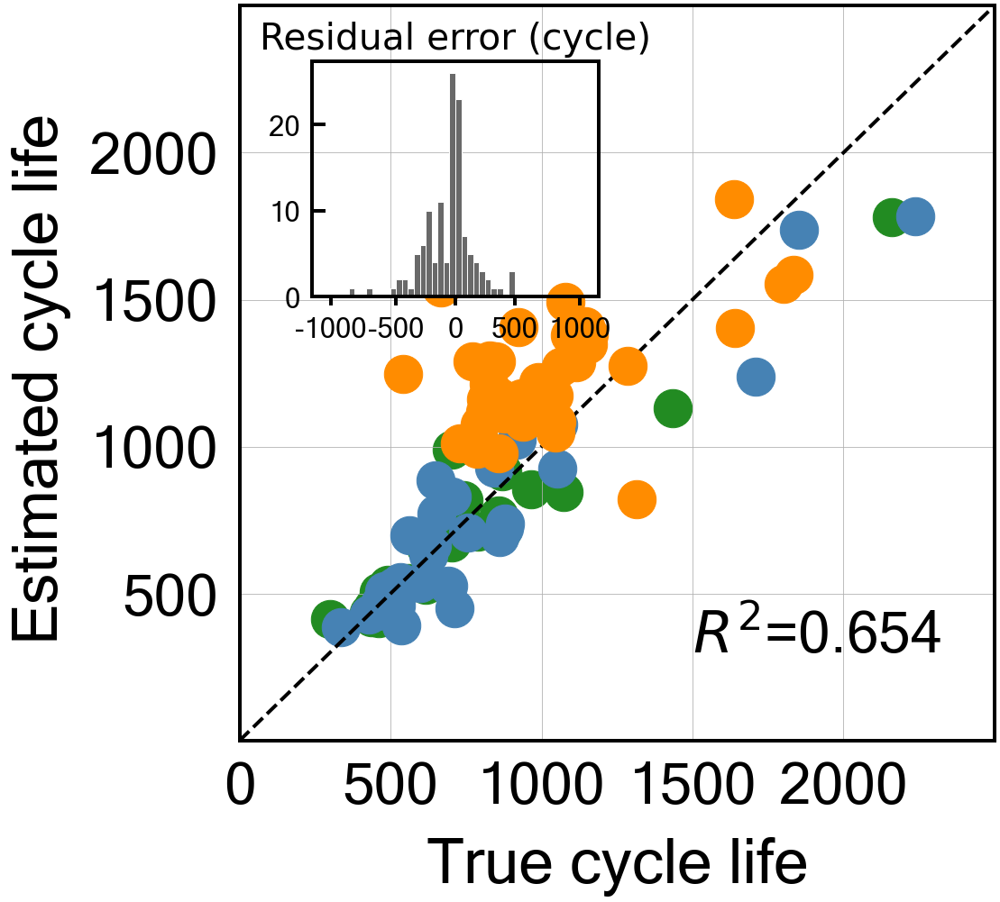


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.6
Best score obtained was: -0.3131067413879336
Cycle no: Average_2to121
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to121') : 0.0004124270569181468
T_Q('Charge', 'Skewness', 'Average_2to121') : 0.008420417569666288
T_Q('Charge', 'Max-Min', 'Average_2to121') : 0.0004169305530563495
dTdQ('Charge', 'Maximum', 'Average_2to121') : -0.07245055756258147
dTdQ('Discharge', 'Max-Min', 'Average_2to121') : 0.04001944790060861
nature_dictAvg_charge_time : 0.09491371101243559
nature_dictIR_cycle2 : -0.0205638187366975
nature_dictMinT_2to121 : 0.035835076849157634
nature_dictIntegralT_2to121 : -0.05069160139610379

Intercept: 2.7939698976436373
r2-score: 0.715
MAE_all: 148.0
MAE_train: 75.0
MAE_test: 94.3
MAE_2ndTest: 279.2
MAPE_all: 17.3 %
MAPE_train: 9.6 %
MAPE_test: 11.4 %
MAPE_2ndTest: 31.5 %
RMSE_all: 215.9
RMSE_train: 118.4
RMSE_test: 145.6
RMSE_2ndTest: 

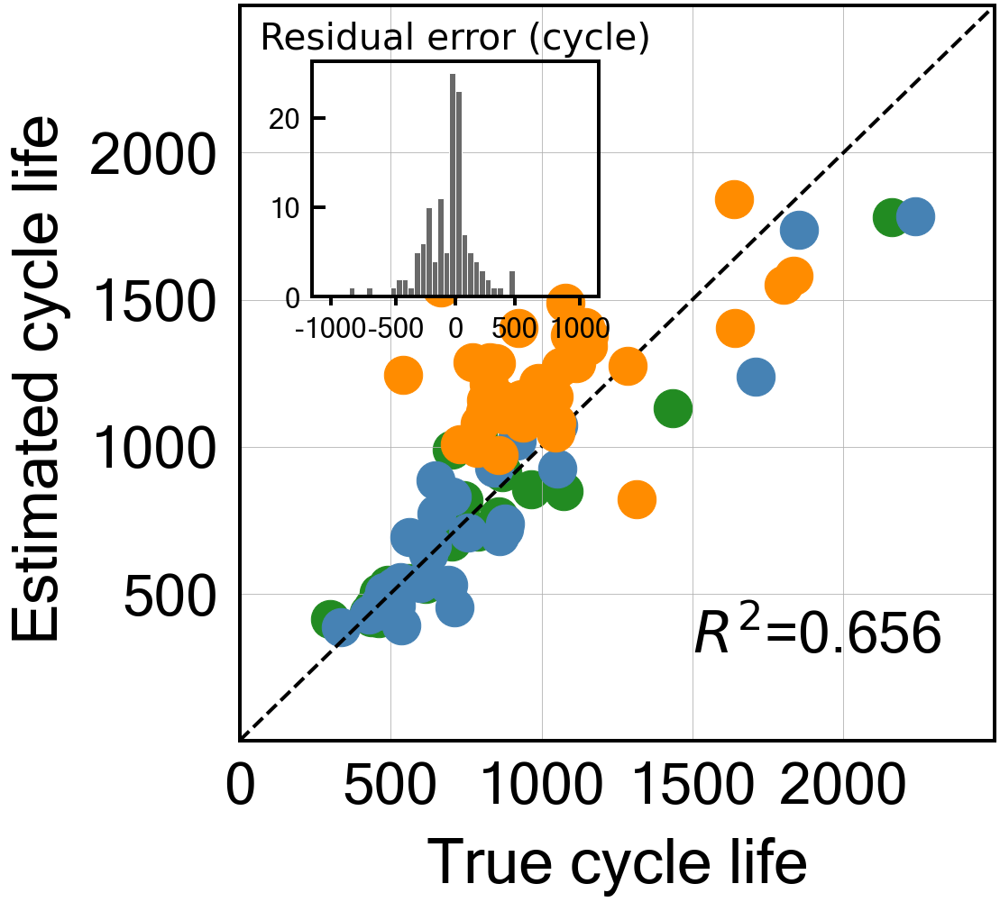


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.5
Best score obtained was: -0.30371980280565136
Cycle no: Average_2to122
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to122') : 0.0002846098156247934
T_Q('Charge', 'Skewness', 'Average_2to122') : 0.008049139616294372
T_Q('Charge', 'Max-Min', 'Average_2to122') : 0.0004124155942592195
dTdQ('Charge', 'Maximum', 'Average_2to122') : -0.07202055828365252
dTdQ('Discharge', 'Max-Min', 'Average_2to122') : 0.039864512478173984
nature_dictAvg_charge_time : 0.0948378221944254
nature_dictIR_cycle2 : -0.020173151244609017
nature_dictMinT_2to122 : 0.036002804480352556
nature_dictIntegralT_2to122 : -0.05106448329918399

Intercept: 2.7939698976436373
r2-score: 0.717
MAE_all: 147.7
MAE_train: 75.2
MAE_test: 93.9
MAE_2ndTest: 278.5
MAPE_all: 17.3 %
MAPE_train: 9.6 %
MAPE_test: 11.3 %
MAPE_2ndTest: 31.4 %
RMSE_all: 215.4
RMSE_train: 118.8
RMSE_test: 145.6
RMSE_2ndTes

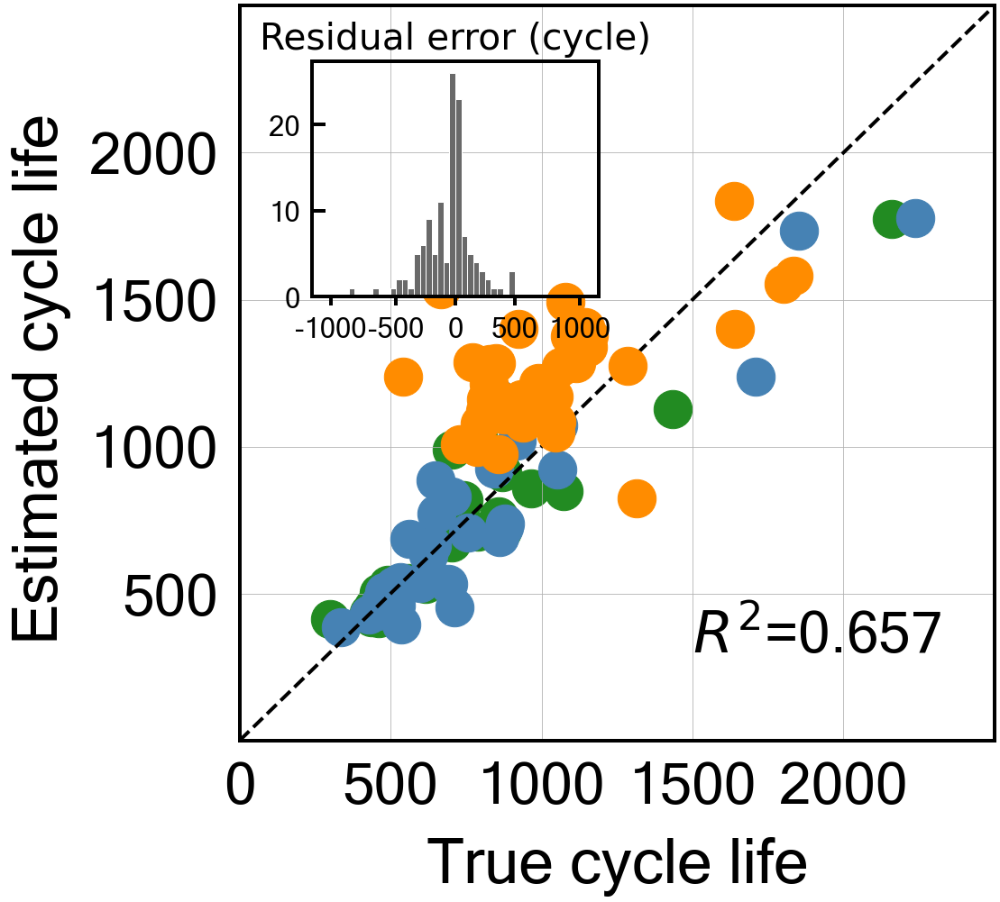


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.5
Best score obtained was: -0.2964844741439272
Cycle no: Average_2to123
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to123') : -0.0
T_Q('Charge', 'Skewness', 'Average_2to123') : 0.00756981031508408
T_Q('Charge', 'Max-Min', 'Average_2to123') : -0.00020148778189321088
dTdQ('Charge', 'Maximum', 'Average_2to123') : -0.07188808571139277
dTdQ('Discharge', 'Max-Min', 'Average_2to123') : 0.04036569753216404
nature_dictAvg_charge_time : 0.09450603844867528
nature_dictIR_cycle2 : -0.01954085116321322
nature_dictMinT_2to123 : 0.0362886853342851
nature_dictIntegralT_2to123 : -0.05140189197193715

Intercept: 2.793969897643638
r2-score: 0.719
MAE_all: 147.6
MAE_train: 75.1
MAE_test: 93.7
MAE_2ndTest: 278.6
MAPE_all: 17.3 %
MAPE_train: 9.6 %
MAPE_test: 11.3 %
MAPE_2ndTest: 31.4 %
RMSE_all: 214.9
RMSE_train: 118.6
RMSE_test: 145.4
RMSE_2ndTest: 324.6
RMSPE_all: 2

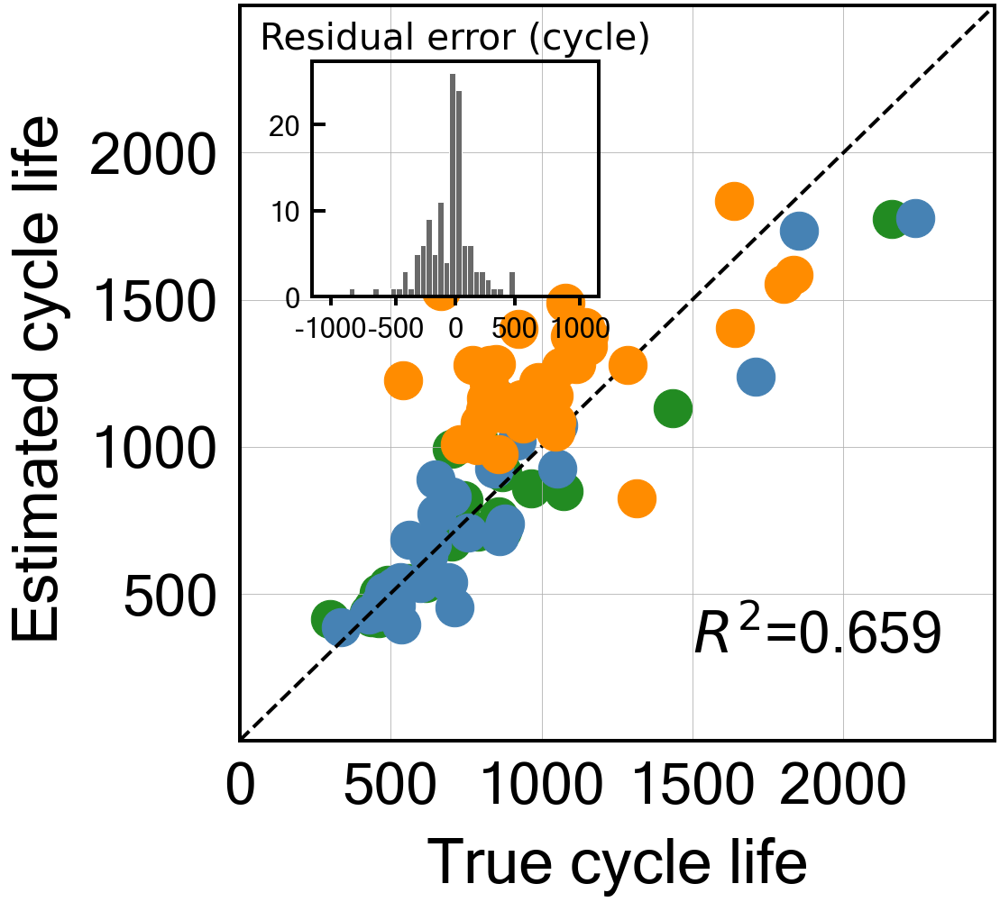


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.2
Best score obtained was: -0.2677220072894957
Cycle no: Average_2to124
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to124') : 0.0003204427345813308
T_Q('Charge', 'Skewness', 'Average_2to124') : 0.0070603621828097185
T_Q('Charge', 'Max-Min', 'Average_2to124') : 2.08499976840855e-05
dTdQ('Charge', 'Maximum', 'Average_2to124') : -0.07082315951742847
dTdQ('Discharge', 'Max-Min', 'Average_2to124') : 0.039004981024300125
nature_dictAvg_charge_time : 0.09480107688103537
nature_dictIR_cycle2 : -0.019122802172207045
nature_dictMinT_2to124 : 0.03668959298828224
nature_dictIntegralT_2to124 : -0.05173263868416099

Intercept: 2.7939698976436373
r2-score: 0.722
MAE_all: 146.5
MAE_train: 75.4
MAE_test: 93.2
MAE_2ndTest: 275.3
MAPE_all: 17.1 %
MAPE_train: 9.6 %
MAPE_test: 11.2 %
MAPE_2ndTest: 31.0 %
RMSE_all: 213.3
RMSE_train: 119.4
RMSE_test: 145.3
RMSE_2ndTest

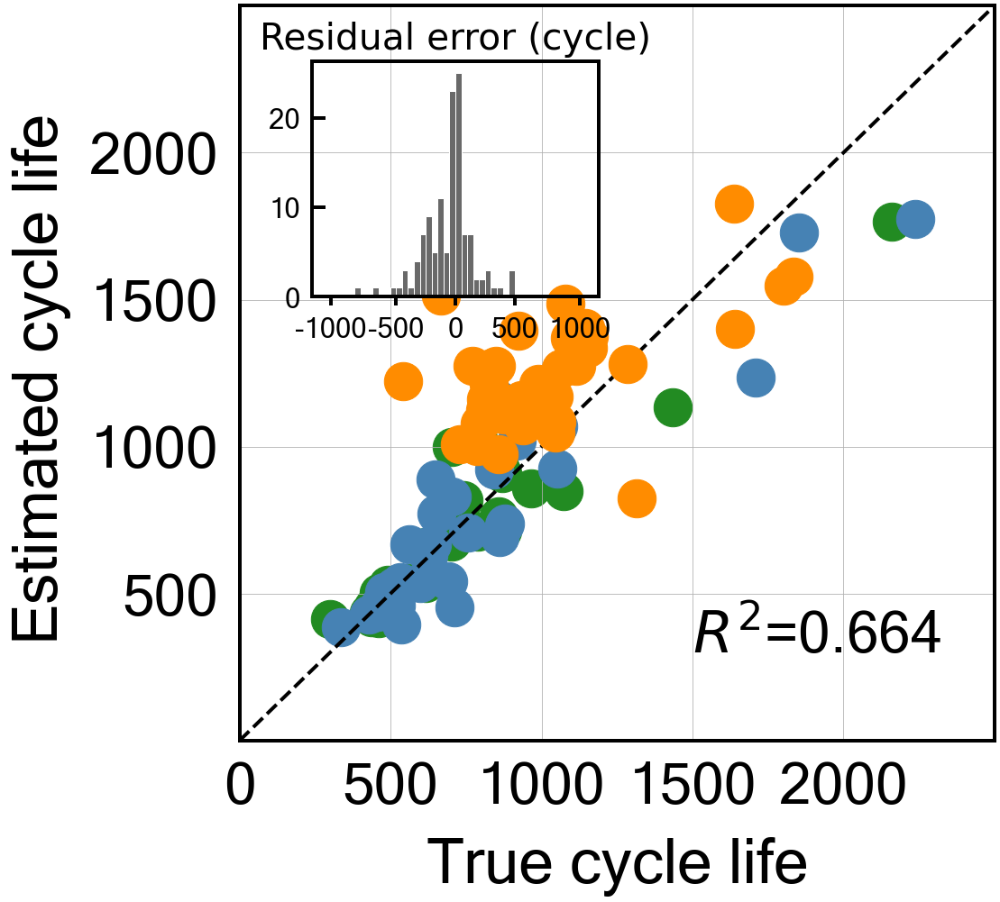


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.4
Best score obtained was: -0.23685211854997812
Cycle no: Average_2to125
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to125') : 5.128785888296446e-05
T_Q('Charge', 'Skewness', 'Average_2to125') : 0.006508692660334484
T_Q('Charge', 'Max-Min', 'Average_2to125') : 0.00014234728941793617
dTdQ('Charge', 'Maximum', 'Average_2to125') : -0.06956817702032936
dTdQ('Discharge', 'Max-Min', 'Average_2to125') : 0.03809551841216092
nature_dictAvg_charge_time : 0.09448435343798019
nature_dictIR_cycle2 : -0.018933405038056832
nature_dictMinT_2to125 : 0.03676712404288193
nature_dictIntegralT_2to125 : -0.05175273459976597

Intercept: 2.793969897643637
r2-score: 0.726
MAE_all: 145.3
MAE_train: 75.2
MAE_test: 93.1
MAE_2ndTest: 271.8
MAPE_all: 17.0 %
MAPE_train: 9.6 %
MAPE_test: 11.2 %
MAPE_2ndTest: 30.6 %
RMSE_all: 211.6
RMSE_train: 119.9
RMSE_test: 146.0
RMSE_2ndTest

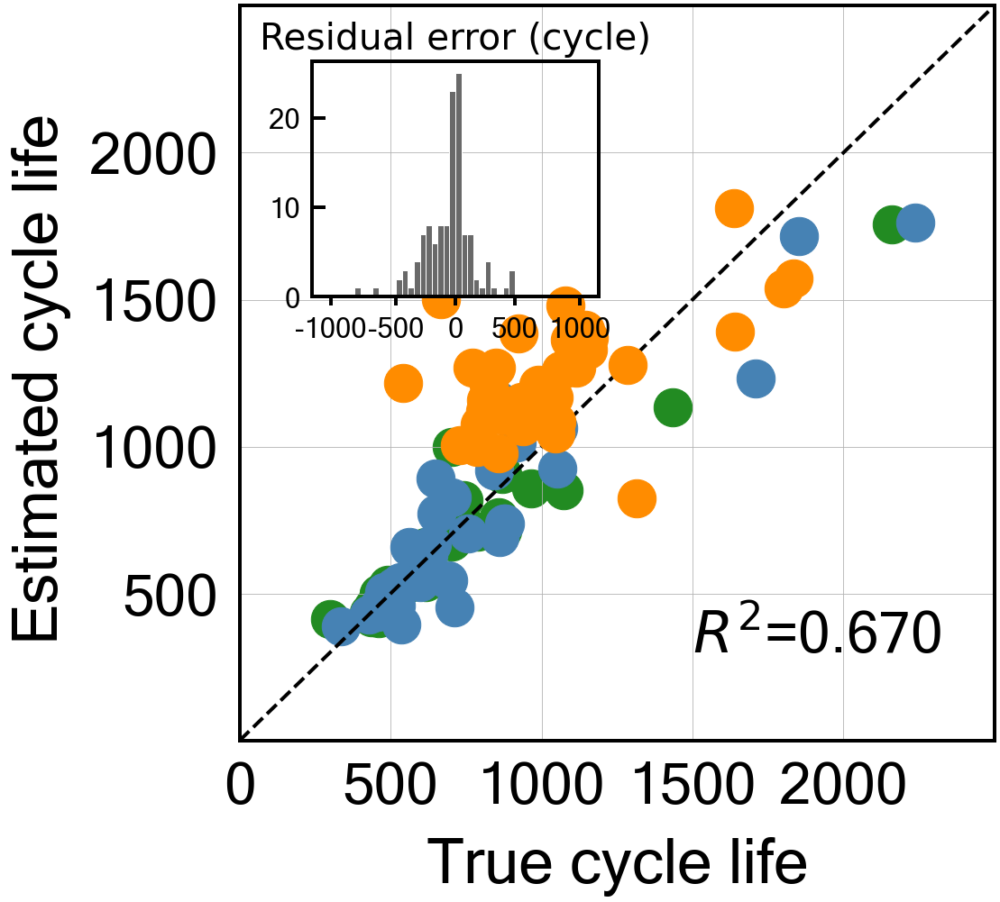


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.3
Best score obtained was: -0.2474295318953197
Cycle no: Average_2to126
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to126') : 0.0012809172117871296
T_Q('Charge', 'Skewness', 'Average_2to126') : 0.006815934753439589
T_Q('Charge', 'Max-Min', 'Average_2to126') : 0.0008498006640336643
dTdQ('Charge', 'Maximum', 'Average_2to126') : -0.06980999961836365
dTdQ('Discharge', 'Max-Min', 'Average_2to126') : 0.03708700364851482
nature_dictAvg_charge_time : 0.09534050661908511
nature_dictIR_cycle2 : -0.018994279769248924
nature_dictMinT_2to126 : 0.03697148078343343
nature_dictIntegralT_2to126 : -0.05208998247632142

Intercept: 2.7939698976436373
r2-score: 0.725
MAE_all: 145.6
MAE_train: 75.4
MAE_test: 92.8
MAE_2ndTest: 272.8
MAPE_all: 17.0 %
MAPE_train: 9.7 %
MAPE_test: 11.1 %
MAPE_2ndTest: 30.8 %
RMSE_all: 212.0
RMSE_train: 119.6
RMSE_test: 145.2
RMSE_2ndTest:

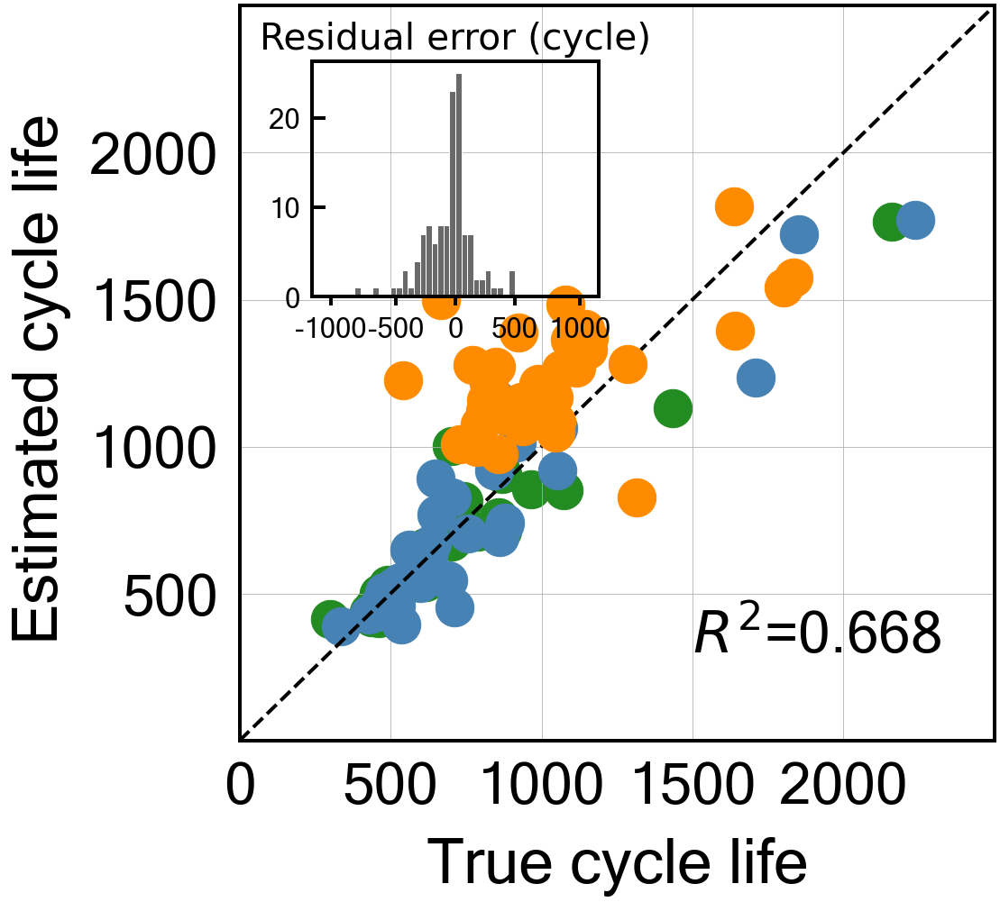


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: -0.26058219661664195
Cycle no: Average_2to127
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to127') : 0.0016792868120826879
T_Q('Charge', 'Skewness', 'Average_2to127') : 0.007431922325110515
T_Q('Charge', 'Max-Min', 'Average_2to127') : 0.0018076343372288566
dTdQ('Charge', 'Maximum', 'Average_2to127') : -0.07023566683396686
dTdQ('Discharge', 'Max-Min', 'Average_2to127') : 0.036588994551585804
nature_dictAvg_charge_time : 0.09566978329360606
nature_dictIR_cycle2 : -0.018927340500913332
nature_dictMinT_2to127 : 0.03686826868374175
nature_dictIntegralT_2to127 : -0.05263216081211758

Intercept: 2.793969897643638
r2-score: 0.724
MAE_all: 145.7
MAE_train: 75.5
MAE_test: 92.1
MAE_2ndTest: 274.0
MAPE_all: 17.0 %
MAPE_train: 9.7 %
MAPE_test: 11.0 %
MAPE_2ndTest: 30.9 %
RMSE_all: 212.5
RMSE_train: 119.2
RMSE_test: 144.0
RMSE_2ndTest

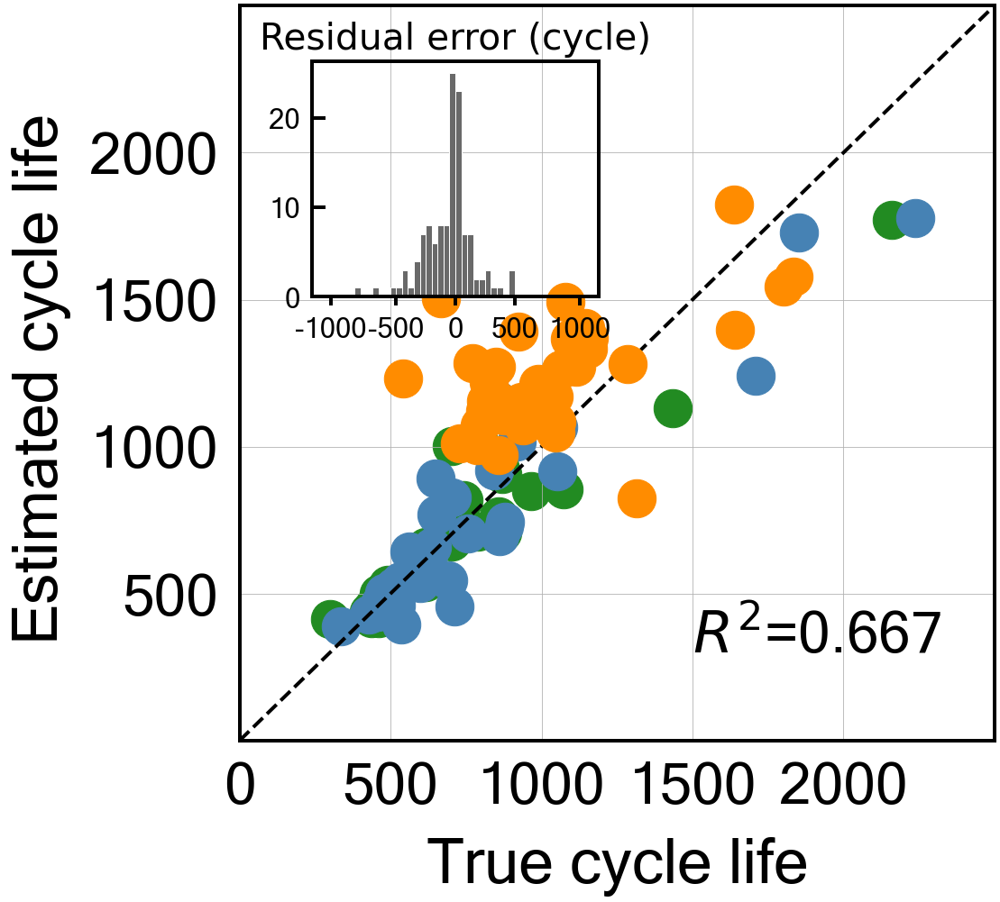


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.0
Best score obtained was: -0.24872214028489226
Cycle no: Average_2to128
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to128') : 0.0017811126537554162
T_Q('Charge', 'Skewness', 'Average_2to128') : 0.007165387955626712
T_Q('Charge', 'Max-Min', 'Average_2to128') : 0.0018089451013771829
dTdQ('Charge', 'Maximum', 'Average_2to128') : -0.0698613945373991
dTdQ('Discharge', 'Max-Min', 'Average_2to128') : 0.036409086045795604
nature_dictAvg_charge_time : 0.0956850470602907
nature_dictIR_cycle2 : -0.018533810854001305
nature_dictMinT_2to128 : 0.036867912617533805
nature_dictIntegralT_2to128 : -0.053190764002505886

Intercept: 2.7939698976436373
r2-score: 0.726
MAE_all: 145.3
MAE_train: 75.4
MAE_test: 91.8
MAE_2ndTest: 273.1
MAPE_all: 17.0 %
MAPE_train: 9.7 %
MAPE_test: 11.0 %
MAPE_2ndTest: 30.8 %
RMSE_all: 211.7
RMSE_train: 119.3
RMSE_test: 143.9
RMSE_2ndTes

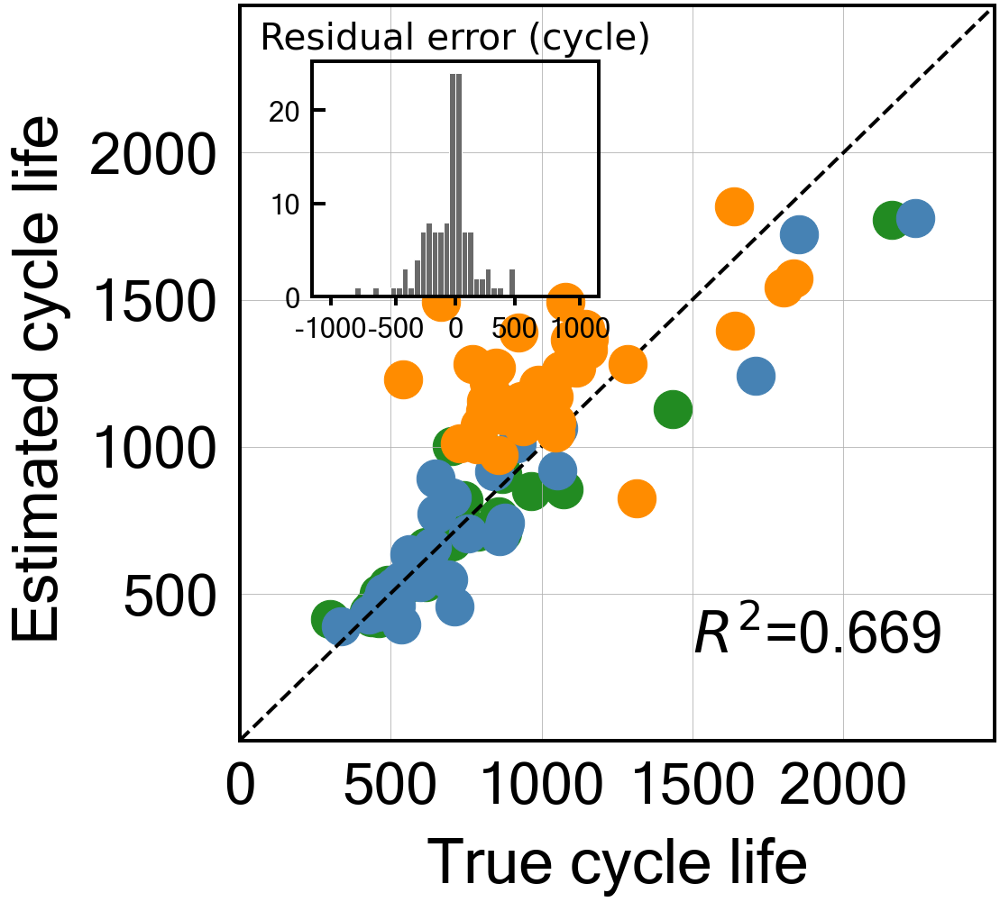


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 3.9
Best score obtained was: -0.20653233607706856
Cycle no: Average_2to129
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to129') : 0.0005417843387933201
T_Q('Charge', 'Skewness', 'Average_2to129') : 0.005915765121833616
T_Q('Charge', 'Max-Min', 'Average_2to129') : 0.0009319719031801632
dTdQ('Charge', 'Maximum', 'Average_2to129') : -0.06824472126315893
dTdQ('Discharge', 'Max-Min', 'Average_2to129') : 0.03667819635248299
nature_dictAvg_charge_time : 0.09495251673425582
nature_dictIR_cycle2 : -0.018170270124716486
nature_dictMinT_2to129 : 0.03669393010364106
nature_dictIntegralT_2to129 : -0.053283735305933465

Intercept: 2.7939698976436373
r2-score: 0.731
MAE_all: 143.8
MAE_train: 75.3
MAE_test: 91.8
MAE_2ndTest: 268.7
MAPE_all: 16.8 %
MAPE_train: 9.6 %
MAPE_test: 11.0 %
MAPE_2ndTest: 30.3 %
RMSE_all: 209.5
RMSE_train: 120.0
RMSE_test: 145.1
RMSE_2ndTes

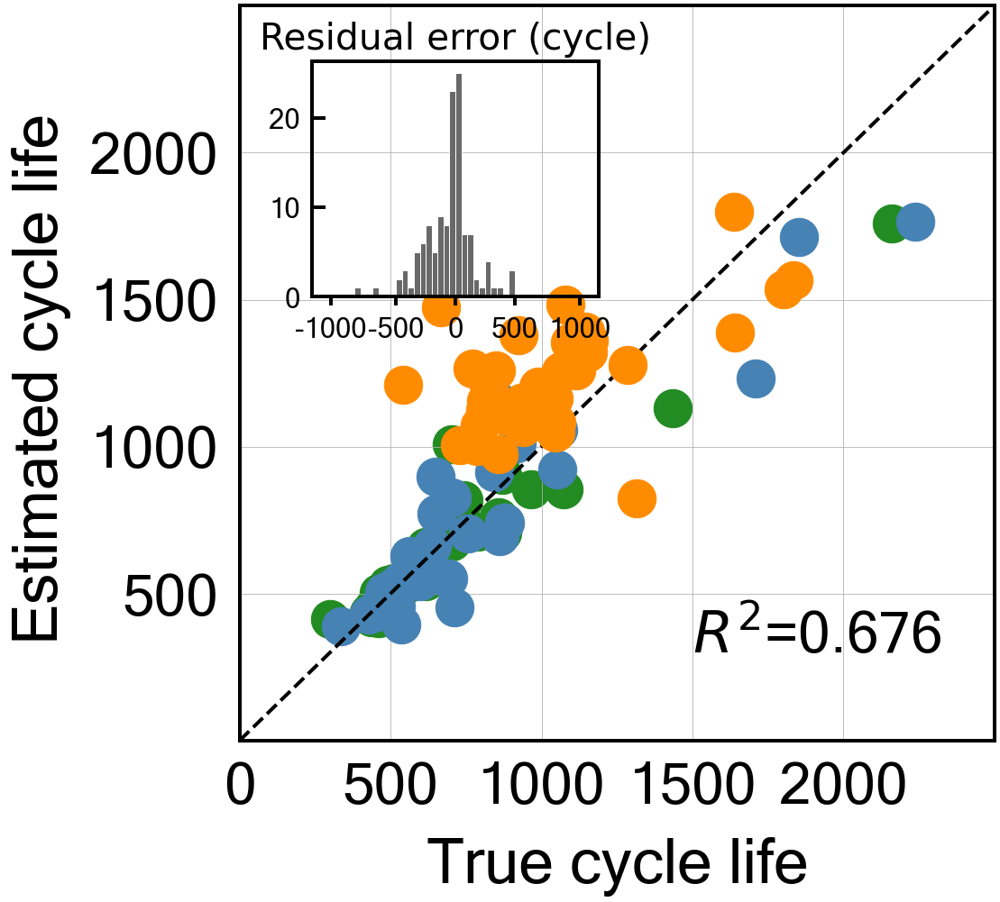


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 3.9
Best score obtained was: -0.2408506155241248
Cycle no: Average_2to130
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to130') : 0.0023984060429480536
T_Q('Charge', 'Skewness', 'Average_2to130') : 0.0068567575691509544
T_Q('Charge', 'Max-Min', 'Average_2to130') : 0.0018485188767833527
dTdQ('Charge', 'Maximum', 'Average_2to130') : -0.06915684166896682
dTdQ('Discharge', 'Max-Min', 'Average_2to130') : 0.03579874957702942
nature_dictAvg_charge_time : 0.09578513160318697
nature_dictIR_cycle2 : -0.01787019013285037
nature_dictMinT_2to130 : 0.037018213446094676
nature_dictIntegralT_2to130 : -0.054290980121630375

Intercept: 2.7939698976436373
r2-score: 0.727
MAE_all: 145.2
MAE_train: 75.5
MAE_test: 91.5
MAE_2ndTest: 272.9
MAPE_all: 16.9 %
MAPE_train: 9.7 %
MAPE_test: 10.9 %
MAPE_2ndTest: 30.7 %
RMSE_all: 211.4
RMSE_train: 119.9
RMSE_test: 144.1
RMSE_2ndTes

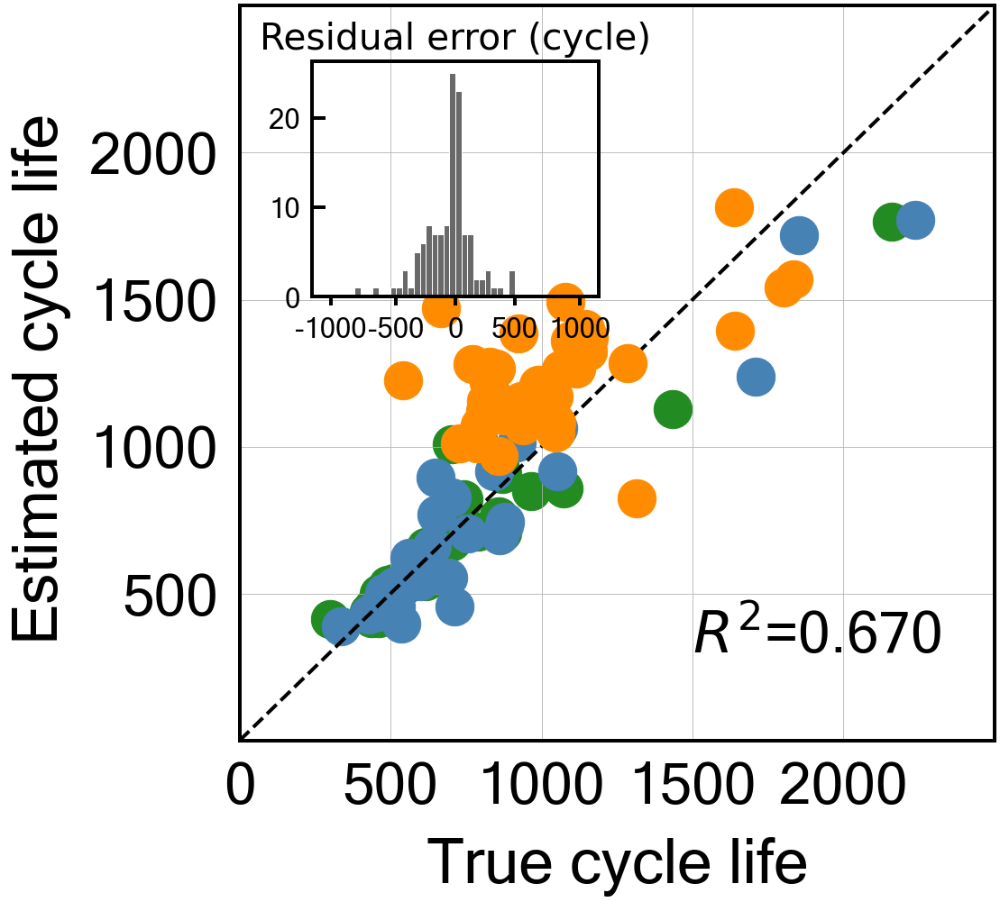


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 3.9
Best score obtained was: -0.21372982175196253
Cycle no: Average_2to131
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to131') : 0.0017041194809249282
T_Q('Charge', 'Skewness', 'Average_2to131') : 0.0057814848503163875
T_Q('Charge', 'Max-Min', 'Average_2to131') : 0.0014050225121879382
dTdQ('Charge', 'Maximum', 'Average_2to131') : -0.0677915784049047
dTdQ('Discharge', 'Max-Min', 'Average_2to131') : 0.03541670895904851
nature_dictAvg_charge_time : 0.09542671597137027
nature_dictIR_cycle2 : -0.017488081063022198
nature_dictMinT_2to131 : 0.03722105287482858
nature_dictIntegralT_2to131 : -0.05445586786028282

Intercept: 2.793969897643638
r2-score: 0.730
MAE_all: 144.4
MAE_train: 75.4
MAE_test: 91.7
MAE_2ndTest: 270.4
MAPE_all: 16.8 %
MAPE_train: 9.6 %
MAPE_test: 10.9 %
MAPE_2ndTest: 30.4 %
RMSE_all: 210.1
RMSE_train: 120.5
RMSE_test: 145.4
RMSE_2ndTest:

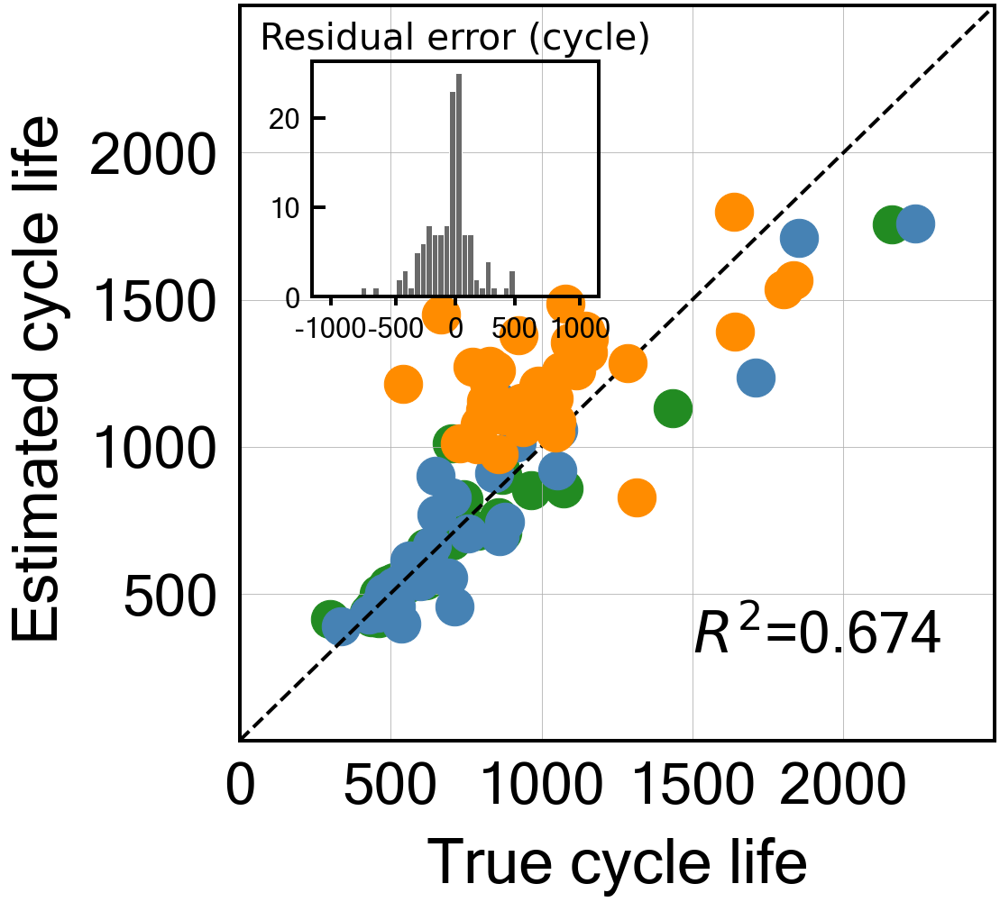


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 3.9
Best score obtained was: -0.20609891136774094
Cycle no: Average_2to132
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to132') : 0.0029508684427777127
T_Q('Charge', 'Skewness', 'Average_2to132') : 0.005696237066882649
T_Q('Charge', 'Max-Min', 'Average_2to132') : 0.0016753445419396844
dTdQ('Charge', 'Maximum', 'Average_2to132') : -0.06718073324165641
dTdQ('Discharge', 'Max-Min', 'Average_2to132') : 0.03397632040580096
nature_dictAvg_charge_time : 0.09594251671184227
nature_dictIR_cycle2 : -0.01723611339329692
nature_dictMinT_2to132 : 0.037453135339600374
nature_dictIntegralT_2to132 : -0.055025514266194876

Intercept: 2.7939698976436373
r2-score: 0.731
MAE_all: 144.0
MAE_train: 75.5
MAE_test: 91.5
MAE_2ndTest: 269.4
MAPE_all: 16.8 %
MAPE_train: 9.6 %
MAPE_test: 10.9 %
MAPE_2ndTest: 30.3 %
RMSE_all: 209.8
RMSE_train: 120.8
RMSE_test: 145.8
RMSE_2ndTes

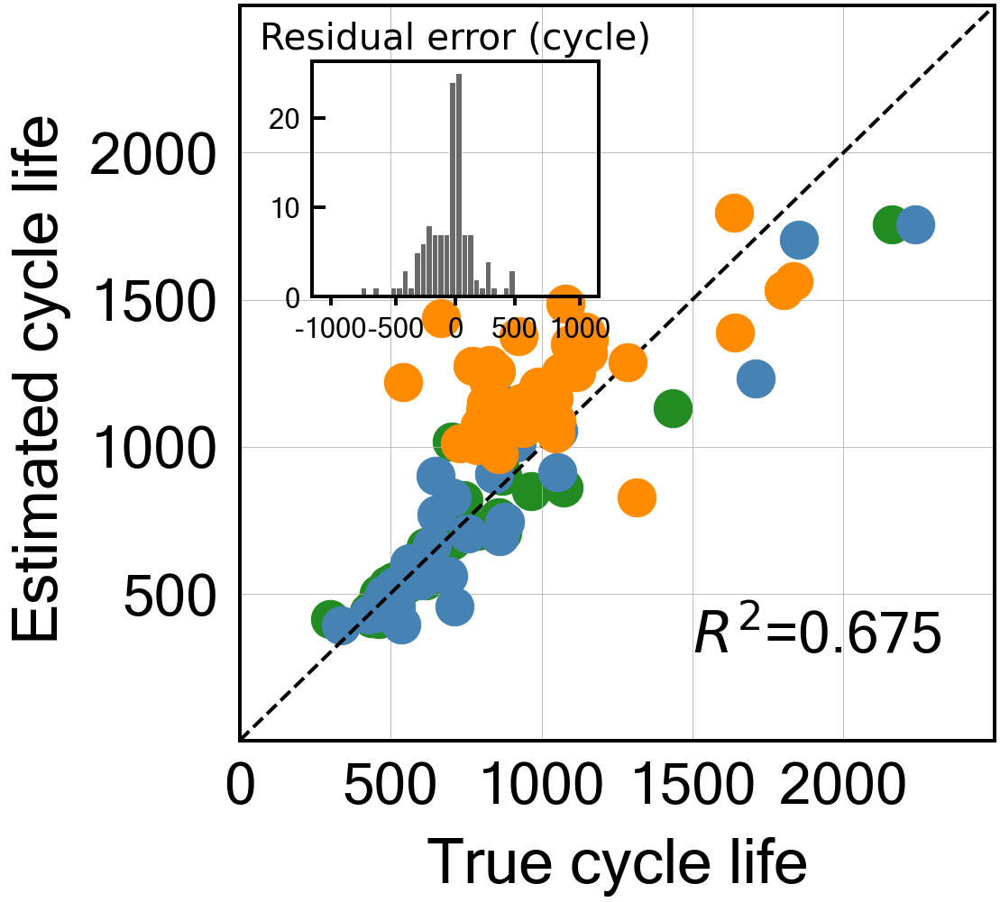


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 3.9
Best score obtained was: -0.2005350505586787
Cycle no: Average_2to133
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to133') : 0.0028831348704991596
T_Q('Charge', 'Skewness', 'Average_2to133') : 0.00530490040863099
T_Q('Charge', 'Max-Min', 'Average_2to133') : 0.0017508399079693808
dTdQ('Charge', 'Maximum', 'Average_2to133') : -0.06696351641791437
dTdQ('Discharge', 'Max-Min', 'Average_2to133') : 0.03407069576271325
nature_dictAvg_charge_time : 0.0958451484007768
nature_dictIR_cycle2 : -0.016978645758751545
nature_dictMinT_2to133 : 0.03746218365010634
nature_dictIntegralT_2to133 : -0.055396645195937774

Intercept: 2.7939698976436373
r2-score: 0.732
MAE_all: 143.8
MAE_train: 75.4
MAE_test: 91.5
MAE_2ndTest: 268.9
MAPE_all: 16.8 %
MAPE_train: 9.6 %
MAPE_test: 10.9 %
MAPE_2ndTest: 30.3 %
RMSE_all: 209.5
RMSE_train: 120.9
RMSE_test: 146.0
RMSE_2ndTest: 

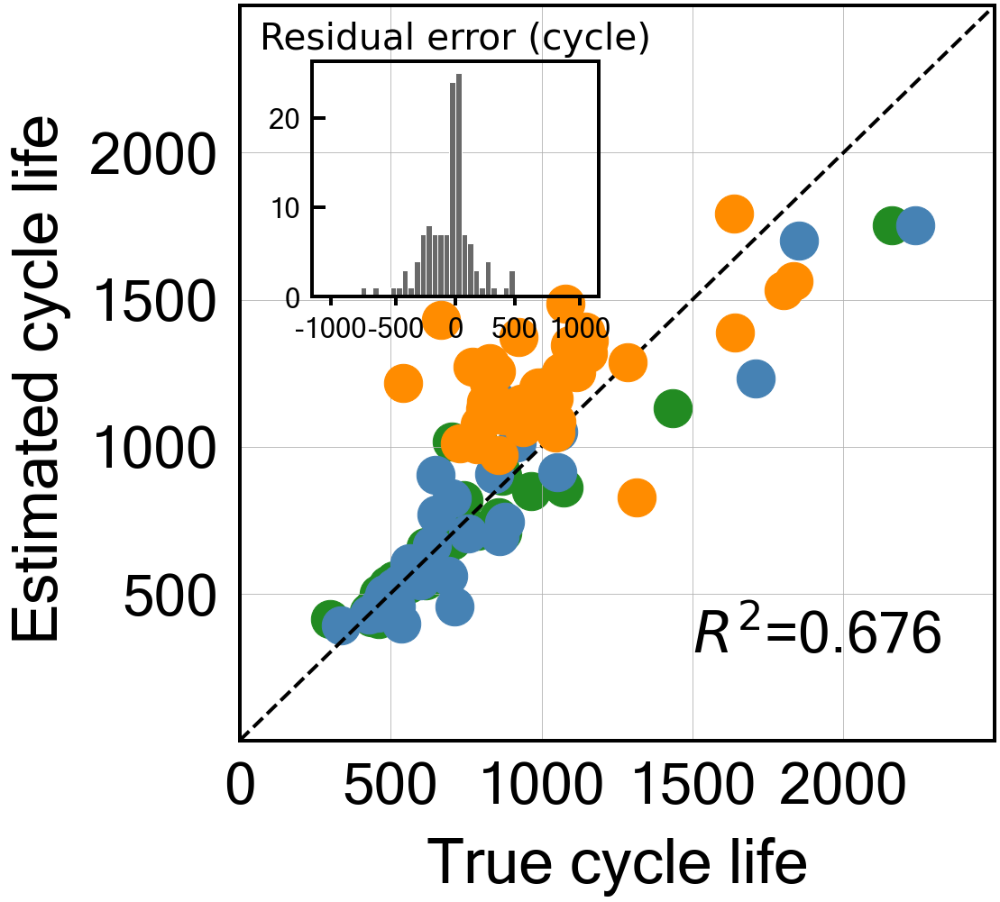


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 3.9
Best score obtained was: -0.18944848276668425
Cycle no: Average_2to134
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to134') : 0.0027438106366249626
T_Q('Charge', 'Skewness', 'Average_2to134') : 0.005149317493857811
T_Q('Charge', 'Max-Min', 'Average_2to134') : 0.0017321949071226236
dTdQ('Charge', 'Maximum', 'Average_2to134') : -0.06659685958069701
dTdQ('Discharge', 'Max-Min', 'Average_2to134') : 0.033971024118416376
nature_dictAvg_charge_time : 0.09573114280395707
nature_dictIR_cycle2 : -0.01685431438697715
nature_dictMinT_2to134 : 0.03743844680939321
nature_dictIntegralT_2to134 : -0.055474440278373865

Intercept: 2.793969897643638
r2-score: 0.733
MAE_all: 143.4
MAE_train: 75.5
MAE_test: 91.6
MAE_2ndTest: 267.5
MAPE_all: 16.7 %
MAPE_train: 9.6 %
MAPE_test: 10.9 %
MAPE_2ndTest: 30.1 %
RMSE_all: 208.9
RMSE_train: 121.3
RMSE_test: 146.1
RMSE_2ndTest

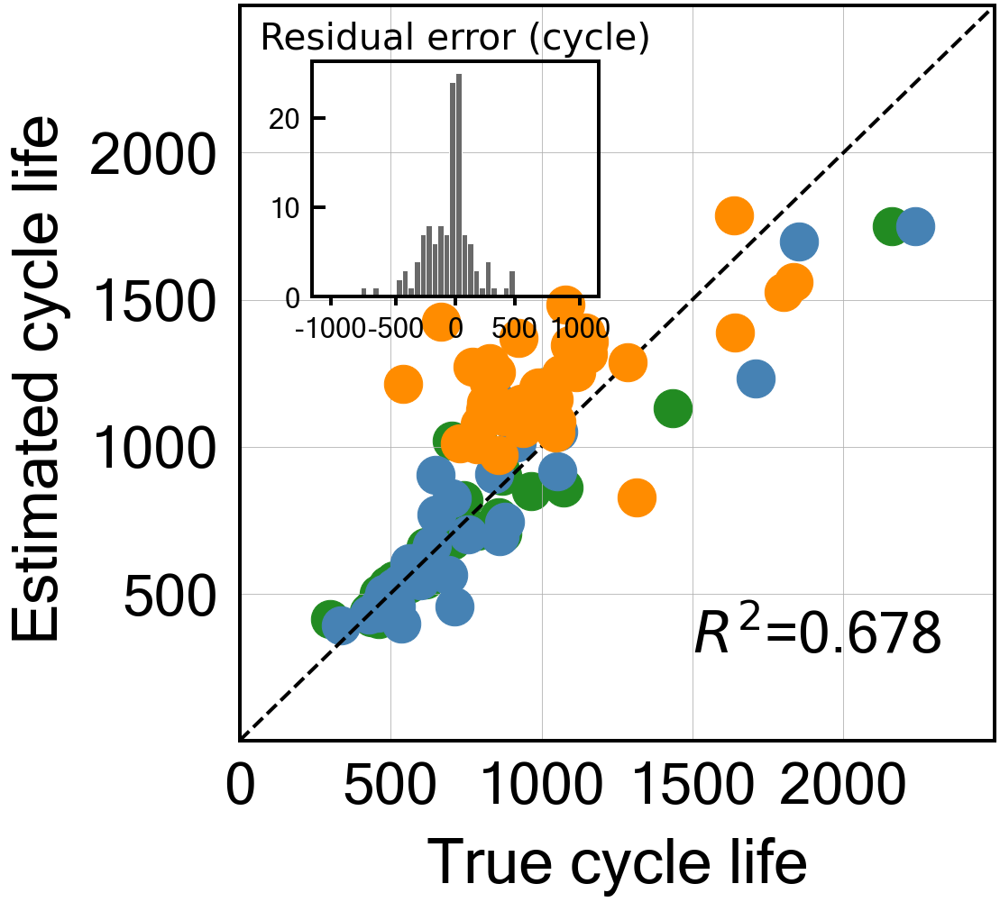


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 3.9
Best score obtained was: -0.1989404815158149
Cycle no: Average_2to135
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to135') : 0.003025220886271579
T_Q('Charge', 'Skewness', 'Average_2to135') : 0.005169964920662221
T_Q('Charge', 'Max-Min', 'Average_2to135') : 0.0018193318935181672
dTdQ('Charge', 'Maximum', 'Average_2to135') : -0.06672394715100535
dTdQ('Discharge', 'Max-Min', 'Average_2to135') : 0.033914753663602
nature_dictAvg_charge_time : 0.09574891710999128
nature_dictIR_cycle2 : -0.01661337115066032
nature_dictMinT_2to135 : 0.03760593521176006
nature_dictIntegralT_2to135 : -0.05586261918138387

Intercept: 2.793969897643638
r2-score: 0.732
MAE_all: 143.9
MAE_train: 75.5
MAE_test: 91.5
MAE_2ndTest: 269.1
MAPE_all: 16.8 %
MAPE_train: 9.6 %
MAPE_test: 10.9 %
MAPE_2ndTest: 30.3 %
RMSE_all: 209.4
RMSE_train: 121.0
RMSE_test: 146.0
RMSE_2ndTest: 312.

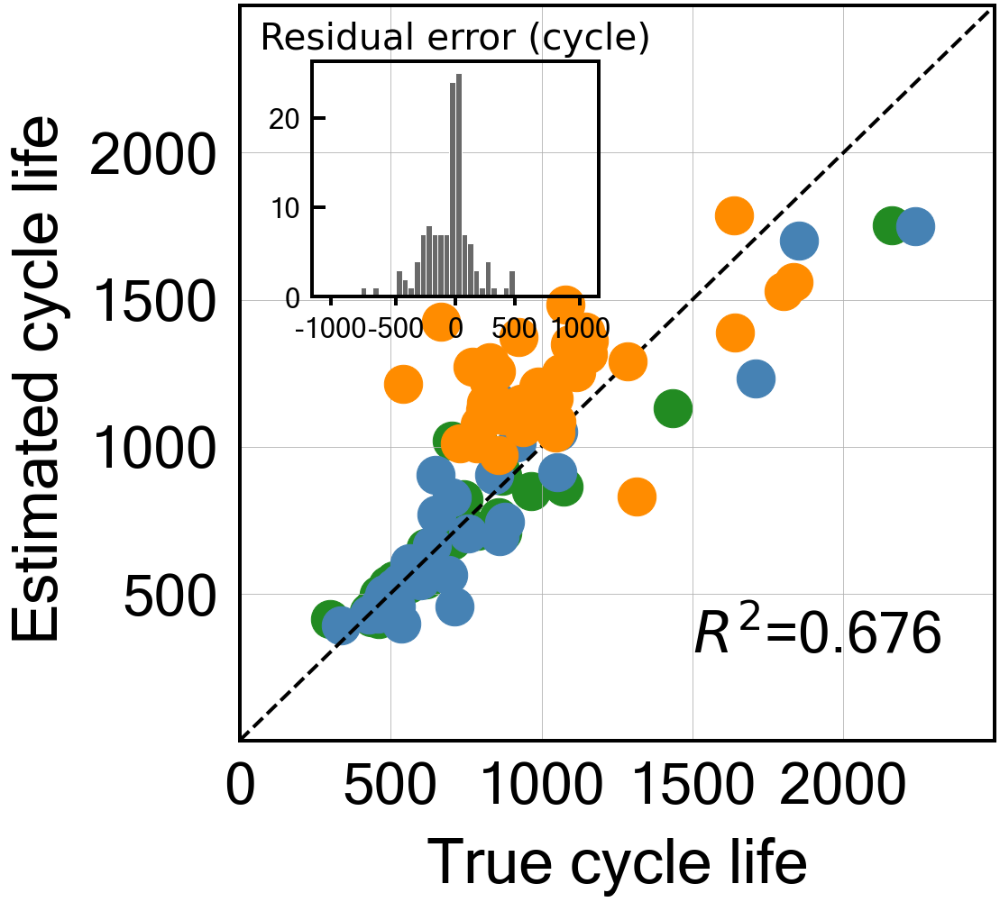


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.0
Best score obtained was: -0.17205221108167357
Cycle no: Average_2to136
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to136') : 0.002230032519480075
T_Q('Charge', 'Skewness', 'Average_2to136') : 0.004525864749764567
T_Q('Charge', 'Max-Min', 'Average_2to136') : 0.0021715405491031067
dTdQ('Charge', 'Maximum', 'Average_2to136') : -0.06590239661008364
dTdQ('Discharge', 'Max-Min', 'Average_2to136') : 0.033600758081499336
nature_dictAvg_charge_time : 0.09548318238876077
nature_dictIR_cycle2 : -0.01660959821270057
nature_dictMinT_2to136 : 0.03752418799328897
nature_dictIntegralT_2to136 : -0.05572360206745839

Intercept: 2.793969897643637
r2-score: 0.735
MAE_all: 142.7
MAE_train: 75.5
MAE_test: 91.4
MAE_2ndTest: 265.4
MAPE_all: 16.6 %
MAPE_train: 9.7 %
MAPE_test: 10.8 %
MAPE_2ndTest: 29.9 %
RMSE_all: 207.8
RMSE_train: 121.1
RMSE_test: 146.3
RMSE_2ndTest: 

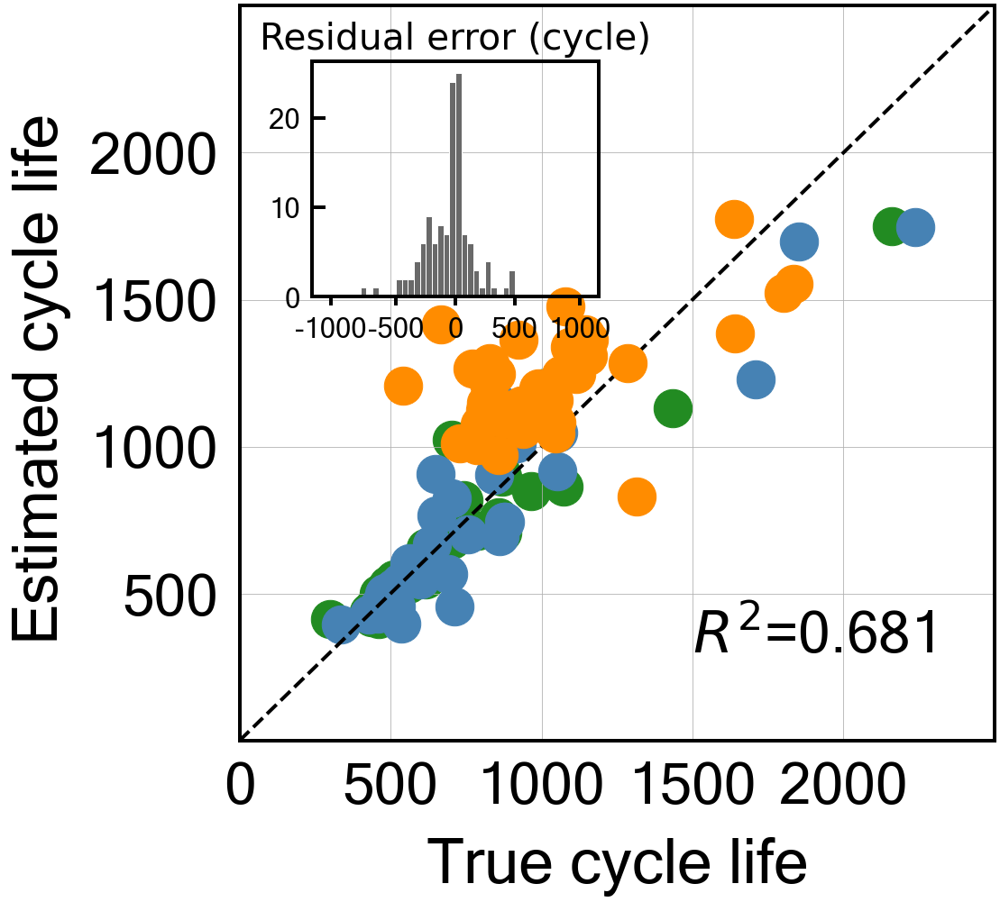


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: -0.16970818269627896
Cycle no: Average_2to137
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to137') : 0.0026733326754588586
T_Q('Charge', 'Skewness', 'Average_2to137') : 0.004415247683262268
T_Q('Charge', 'Max-Min', 'Average_2to137') : 0.0024588308965381484
dTdQ('Charge', 'Maximum', 'Average_2to137') : -0.06593606319178118
dTdQ('Discharge', 'Max-Min', 'Average_2to137') : 0.03348340544926316
nature_dictAvg_charge_time : 0.09588620380922301
nature_dictIR_cycle2 : -0.016406990926805396
nature_dictMinT_2to137 : 0.03747981893211939
nature_dictIntegralT_2to137 : -0.05627590641090971

Intercept: 2.793969897643637
r2-score: 0.736
MAE_all: 142.5
MAE_train: 75.6
MAE_test: 91.3
MAE_2ndTest: 264.8
MAPE_all: 16.6 %
MAPE_train: 9.7 %
MAPE_test: 10.9 %
MAPE_2ndTest: 29.8 %
RMSE_all: 207.6
RMSE_train: 121.1
RMSE_test: 146.0
RMSE_2ndTest:

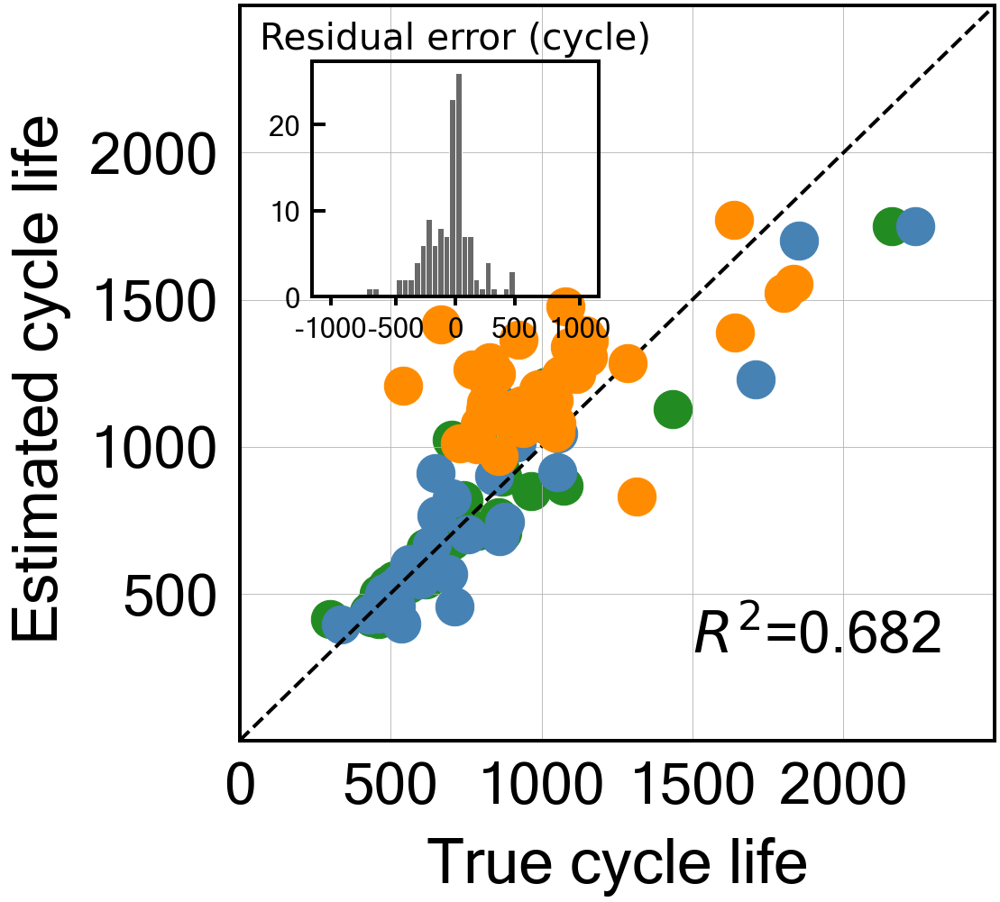


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.0
Best score obtained was: -0.16647124437084249
Cycle no: Average_2to138
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to138') : 0.0027027134340994914
T_Q('Charge', 'Skewness', 'Average_2to138') : 0.004354062856230275
T_Q('Charge', 'Max-Min', 'Average_2to138') : 0.002421466041377013
dTdQ('Charge', 'Maximum', 'Average_2to138') : -0.06586977825761442
dTdQ('Discharge', 'Max-Min', 'Average_2to138') : 0.03361248002036393
nature_dictAvg_charge_time : 0.09583235147530103
nature_dictIR_cycle2 : -0.01628204951916874
nature_dictMinT_2to138 : 0.037430290440862476
nature_dictIntegralT_2to138 : -0.05645001814493091

Intercept: 2.793969897643637
r2-score: 0.736
MAE_all: 142.3
MAE_train: 75.6
MAE_test: 91.2
MAE_2ndTest: 264.3
MAPE_all: 16.6 %
MAPE_train: 9.7 %
MAPE_test: 10.8 %
MAPE_2ndTest: 29.8 %
RMSE_all: 207.3
RMSE_train: 121.1
RMSE_test: 145.9
RMSE_2ndTest: 

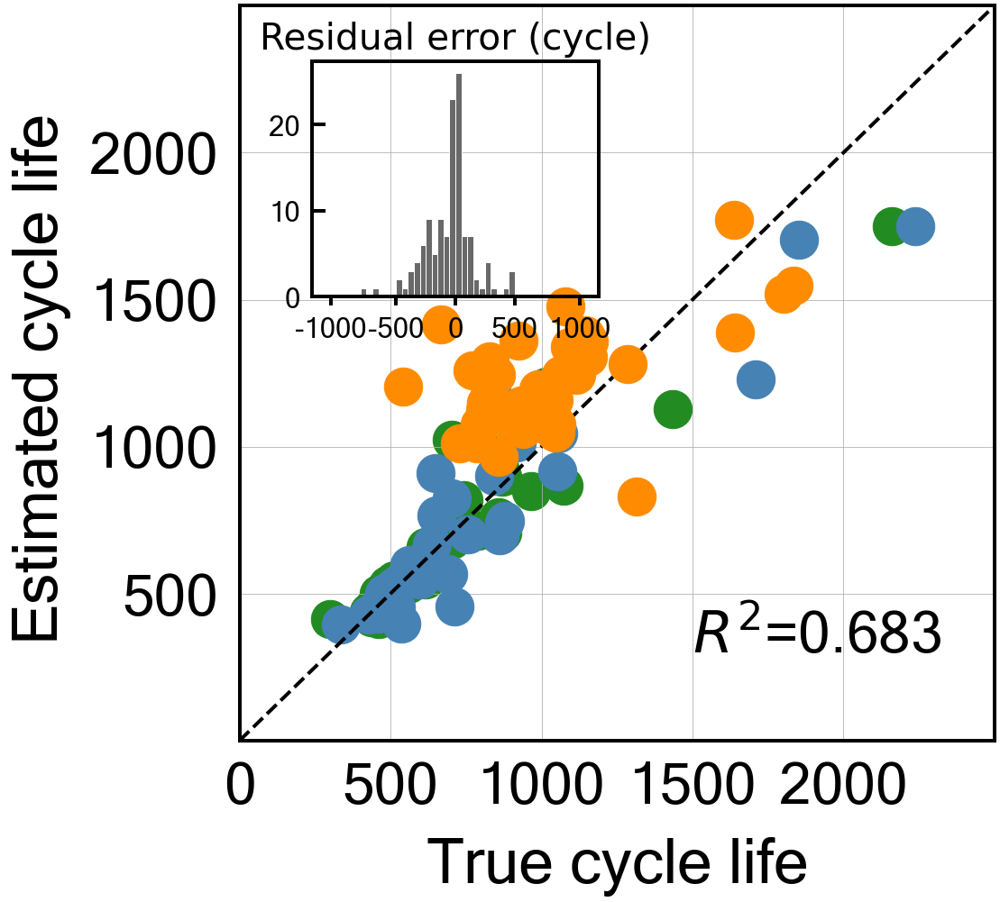


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.0
Best score obtained was: -0.1487733780033138
Cycle no: Average_2to139
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to139') : 0.002201484409888896
T_Q('Charge', 'Skewness', 'Average_2to139') : 0.00408600441253062
T_Q('Charge', 'Max-Min', 'Average_2to139') : 0.0019346899231416099
dTdQ('Charge', 'Maximum', 'Average_2to139') : -0.06512142622011885
dTdQ('Discharge', 'Max-Min', 'Average_2to139') : 0.033727400448881555
nature_dictAvg_charge_time : 0.09520288092187876
nature_dictIR_cycle2 : -0.01629324943215047
nature_dictMinT_2to139 : 0.03730708842866894
nature_dictIntegralT_2to139 : -0.05612177844063863

Intercept: 2.7939698976436373
r2-score: 0.739
MAE_all: 141.5
MAE_train: 75.5
MAE_test: 91.3
MAE_2ndTest: 261.9
MAPE_all: 16.5 %
MAPE_train: 9.6 %
MAPE_test: 10.8 %
MAPE_2ndTest: 29.5 %
RMSE_all: 206.5
RMSE_train: 121.5
RMSE_test: 146.8
RMSE_2ndTest: 3

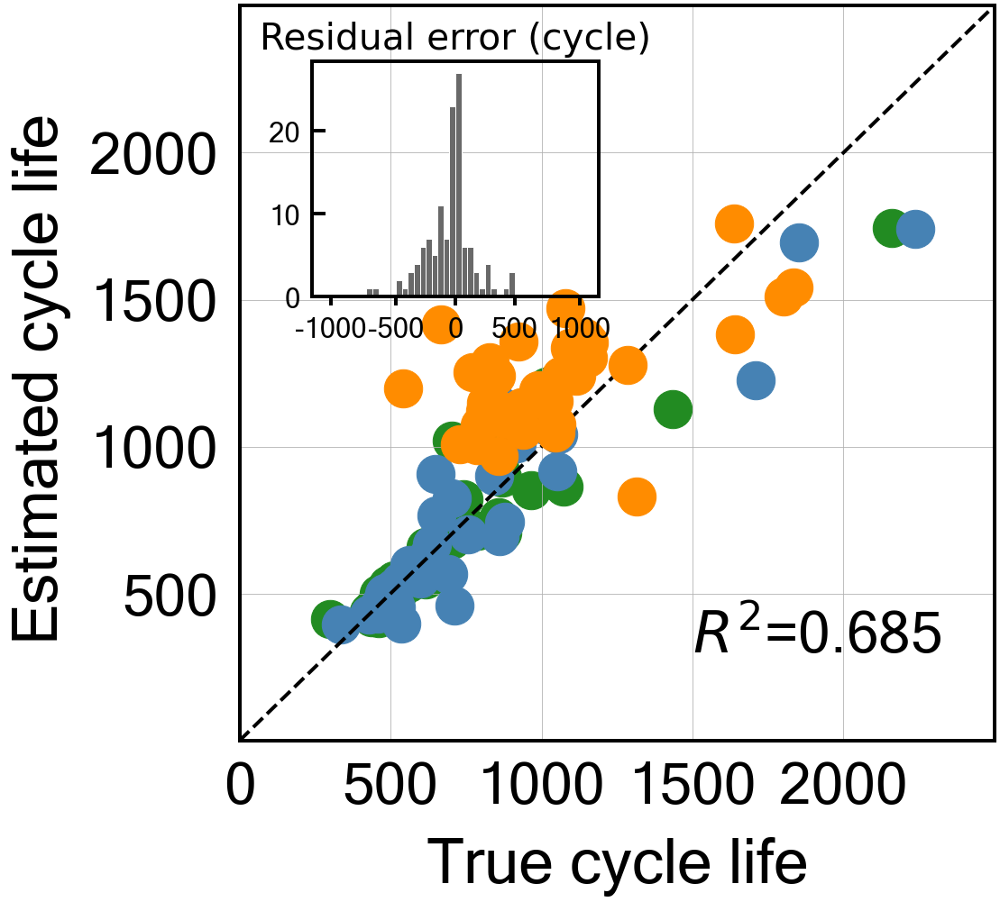


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 3.9
Best score obtained was: -0.17091284760503833
Cycle no: Average_2to140
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to140') : 0.0034456629672953913
T_Q('Charge', 'Skewness', 'Average_2to140') : 0.004869410795641261
T_Q('Charge', 'Max-Min', 'Average_2to140') : 0.0030943719423987387
dTdQ('Charge', 'Maximum', 'Average_2to140') : -0.06607341942700175
dTdQ('Discharge', 'Max-Min', 'Average_2to140') : 0.03321438632559631
nature_dictAvg_charge_time : 0.09604676184568306
nature_dictIR_cycle2 : -0.016119520749220035
nature_dictMinT_2to140 : 0.037344647116966105
nature_dictIntegralT_2to140 : -0.057028772168930514

Intercept: 2.7939698976436373
r2-score: 0.736
MAE_all: 142.2
MAE_train: 75.6
MAE_test: 90.8
MAE_2ndTest: 264.4
MAPE_all: 16.6 %
MAPE_train: 9.7 %
MAPE_test: 10.8 %
MAPE_2ndTest: 29.8 %
RMSE_all: 207.6
RMSE_train: 120.9
RMSE_test: 145.7
RMSE_2ndTe

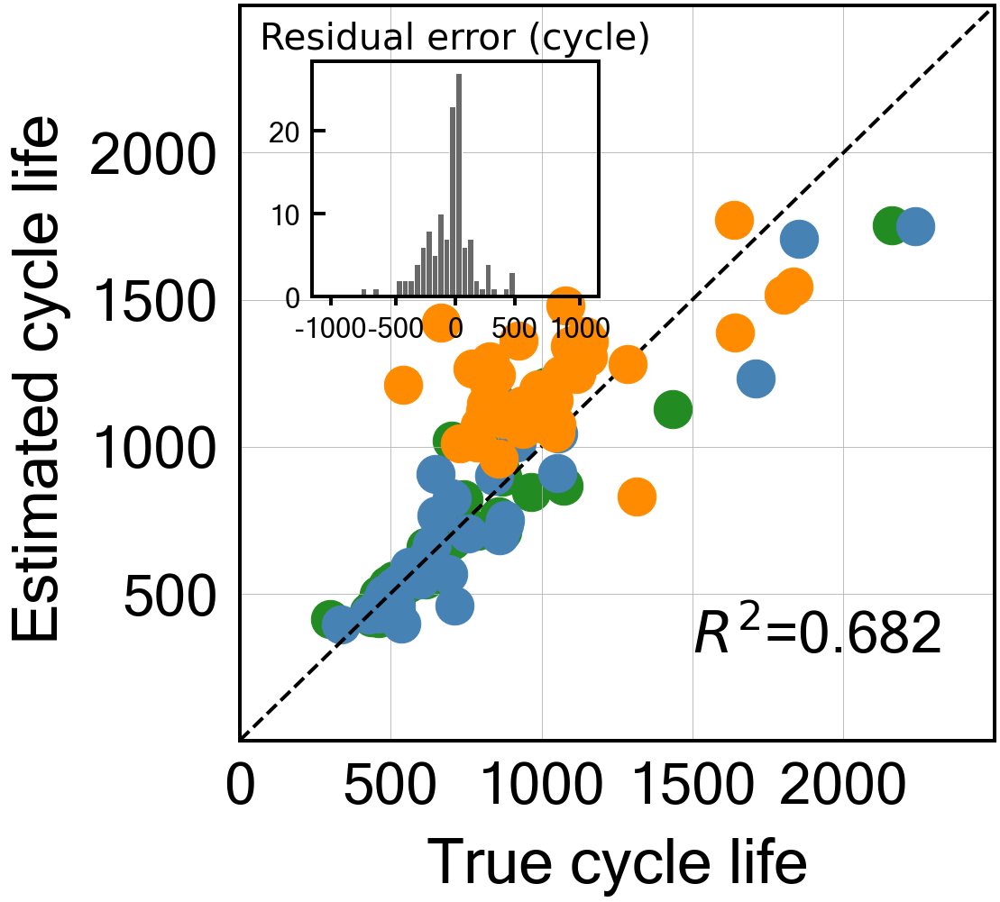


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.0
Best score obtained was: -0.13595284727517765
Cycle no: Average_2to141
Coefficient:
T_Q('Charge', 'Variance', 'Average_2to141') : 0.0020532360360308727
T_Q('Charge', 'Skewness', 'Average_2to141') : 0.004020779646782139
T_Q('Charge', 'Max-Min', 'Average_2to141') : 0.0014506371041370935
dTdQ('Charge', 'Maximum', 'Average_2to141') : -0.06515571243324819
dTdQ('Discharge', 'Max-Min', 'Average_2to141') : 0.03451442944057508
nature_dictAvg_charge_time : 0.09492749613861916
nature_dictIR_cycle2 : -0.015808223858912958
nature_dictMinT_2to141 : 0.03720028997903904
nature_dictIntegralT_2to141 : -0.056524941825324256

Intercept: 2.7939698976436373
r2-score: 0.741
MAE_all: 140.8
MAE_train: 75.5
MAE_test: 90.8
MAE_2ndTest: 260.4
MAPE_all: 16.4 %
MAPE_train: 9.6 %
MAPE_test: 10.7 %
MAPE_2ndTest: 29.3 %
RMSE_all: 205.6
RMSE_train: 121.6
RMSE_test: 146.4
RMSE_2ndTes

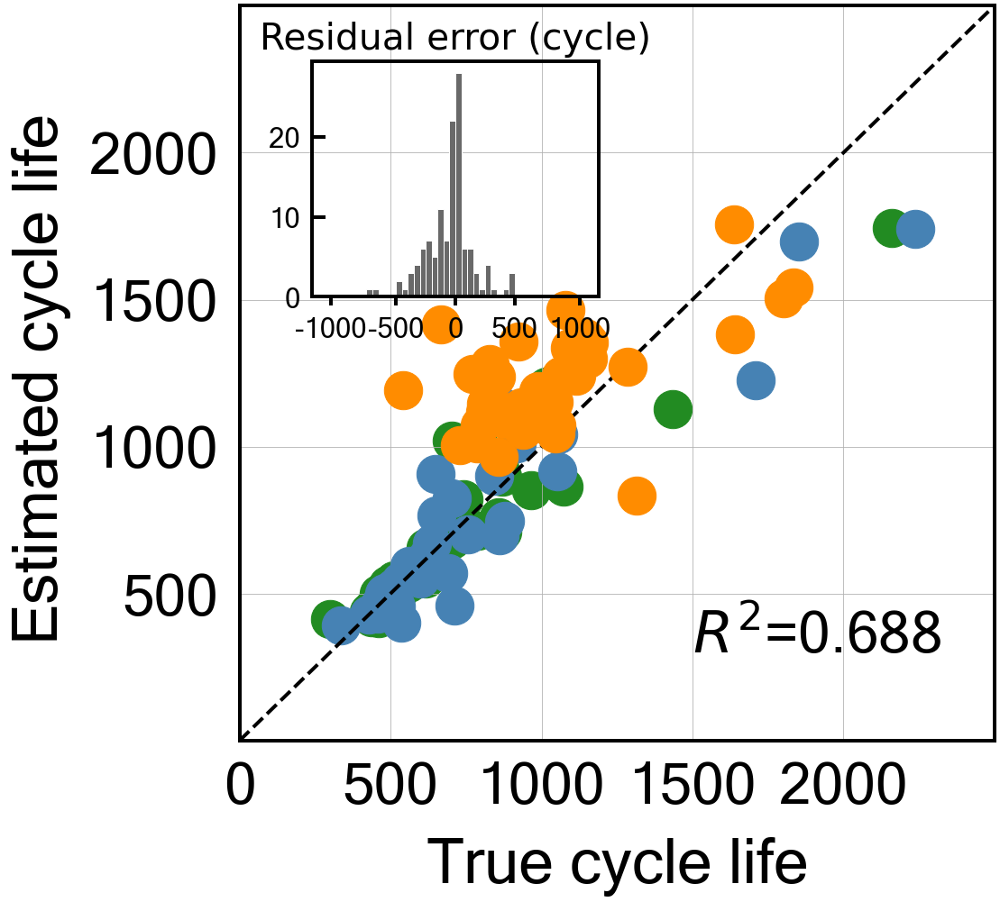


Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 3.8
Best score obtained was: -0.161790152435626
error in 142

Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 3.8
Best score obtained was: -0.1459551684271172
error in 143

Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: -0.1537598819796615
error in 144

Hybrid model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.1
Best score obtained was: -0.14440623626907323
error in 145

Hybrid model
rScore compared --> 2nd dataset
error in 146

Hybrid model
rScore compared --> 2nd dataset
error in 147

Hybrid model
rScore compared --> 2nd dataset
error in 148

Hybrid model
rScore compared --> 2

In [10]:
# modeList = ['Charge', 'Discharge']
# printCoef = False
# stringOutputList = []
# errorList = []
# for avgCycleNo in [str(x) for x in np.arange(3,150,1)]:
#     try:
#         # Create nature dictionary
#         nature_dict = build_feature_utils.create_nature_feature_v2_2to10(bat_index_dict, testDict, cyc = [str(int(avgCycleNo)-1), '1'])
#         natureKeynameUnique = list(nature_dict.keys())[5:]
        
#         ## Create the dataframe
#         # Evalute for cycle Average_2to10
#         setCycleNo = 'Average_2to'+avgCycleNo
#         feat_df = pd.DataFrame(columns=['dictionary', 'keyName', 'valueArray'])#, 'rScore'])  
#         ##                                      1. T(Q)
#         # Variables
#         featureDict = T_Q.copy()
#         featureKeynameUniqueList = TQKeynameUnique.copy()
#         keyCycle = setCycleNo
#         sample_size = featureDict[('Discharge', 'Max-Min', setCycleNo)].size

#         ## END

#         featureKeynameList = []

#         # All cells
#         X = np.empty((sample_size,0))
#         y = featureDict['cycle_life'].ravel()


#         # Append the feature KEYS to be inspected into featureKeynameList
#         for keyMode in modeList:
#             ## NEED TO CHANGE THE RANGE
#             for keyStat in featureKeynameUniqueList[1][2:9]:
#                 featureKeynameList.append((keyMode, keyStat, keyCycle))
                
#         # Append the FEATURE into X array

#         for feat in featureKeynameList:
#             # ALL CELLS
#             X = np.append(X, featureDict[feat].reshape(-1,1), axis=1)
            
#         # Append to dataframe
#         for i in range(len(featureKeynameList)):
#             newRow = {'dictionary': 'T_Q', 'keyName': featureKeynameList[i], 'valueArray': X[:, i]}#, 'rScore': rScore[i]}
#             feat_df = feat_df.append(newRow, ignore_index=True)
                    
#         ##                                      2. dT/dQ

#         # Variables

#         featureDict = dTdQ.copy()
#         featureKeynameUniqueList = dTdQKeynameUnique.copy()
#         keyCycle = setCycleNo
#         sample_size = featureDict[('Charge', 'Maximum', setCycleNo)].size

#         ## END

#         featureKeynameList = []

#         # All cells
#         X = np.empty((sample_size,0))
#         y = featureDict['cycle_life'].ravel()

#         # Append the feature KEYS to be inspected into featureKeynameList
#         # For Charge and Discharge
#         for keyMode in modeList:
#             ## NEED TO CHANGE THE RANGE
#             for keyStat in featureKeynameUniqueList[1][3:10]:
#                 featureKeynameList.append((keyMode, keyStat, keyCycle))
                
#         # Append the FEATURE into X array

#         for feat in featureKeynameList:
#             # ALL CELLS
#             X = np.append(X, featureDict[feat].reshape(-1,1), axis=1)
            
#         # Append to dataframe
#         for i in range(len(featureKeynameList)):
#             newRow = {'dictionary': 'dTdQ', 'keyName': featureKeynameList[i], 'valueArray': X[:, i]}#, 'rScore': rScore[i]}
#             feat_df = feat_df.append(newRow, ignore_index=True)
                
#         ##                                      3. Severson's features: Cycle 2 to X

#         # Append the feature KEYS to be inspected into featureKeynameList
        
        
#         featureDict = nature_dict.copy()
#         featureKeynameList = natureKeynameUnique[:-1].copy()
#         sample_size = featureDict['Q_V_Variance'].size

#         ## END

#         # All cells
#         X = np.empty((sample_size,0))
#         y = featureDict['cycle_life'].ravel()
                
#         # Append the FEATURE into X array

#         for feat in featureKeynameList:
#             # ALL CELLS
#             X = np.append(X, featureDict[feat].reshape(-1,1), axis=1)
            
#         # Append to dataframe
#         for i in range(len(featureKeynameList)):
#             newRow = {'dictionary': 'nature_dict', 'keyName': featureKeynameList[i], 'valueArray': X[:, i]}#, 'rScore': rScore[i]}
#             feat_df = feat_df.append(newRow, ignore_index=True)
            


    


            
#         #### Train the models now:
#         # Initiate savepath
#         savepath = os.path.join('.', 'folderName')
#         natureIdx = feat_df[feat_df['dictionary'] == 'nature_dict'].index[0]
#         modelName = "Hybrid model"

#         combo = [0, 2, 6, 18, 27, 41, 42, 46, 47]
            
#         X_array = np.vstack(feat_df.loc[:, 'valueArray']).transpose()

#         print("\nHybrid model\nrScore compared --> 2nd dataset")

#         startTime = time.time()

#         r2ScoreBest = -10
#         featureKeynameListBest = []
#         saveFilePath = os.path.join(savepath, 'average'+avgCycleNo+'.png')
            
#         featureKeynameList = []
#         X_all = X_array[:, combo]

#         for j in combo:
#             featureKeynameList.append(feat_df.loc[j, 'dictionary'] + str(feat_df.loc[j, 'keyName']))

#         X_train  = X_all[train_ind]
#         X_test = X_all[test_ind]
#         X_secondary_test = X_all[secondary_test_ind]

#         scaler = StandardScaler().fit(X_train)
#         X_train_scaled = scaler.transform(X_train)
#         X_test_scaled = scaler.transform(X_test)
#         X_secondary_test_scaled = scaler.transform(X_secondary_test)
#         X_all_scaled = np.concatenate((X_train_scaled, X_test_scaled, X_secondary_test_scaled))

#         # Train
#         regEN = ElasticNetCV(l1_ratio=np.linspace(0.01,1,100), cv=4, random_state=20, max_iter=100000, n_jobs=1, tol=1e-2, verbose=0, selection='random')
#         model = regEN
#         model.fit(X_train_scaled, y_train)

#         #Evaluate score: SECONDARY DATASET
#         r2Score = r2_score(10**y_secondary_test, 10**model.predict(X_secondary_test_scaled))

#         if r2Score > r2ScoreBest:
#             r2ScoreBest = r2Score
#             featureKeynameListBest = featureKeynameList
#             modelBest = model
#             X_all_scaled_best = X_all_scaled
                    
#         stringOutputManual = ("\n\n------------------------------------------------------------------------\n" + 
#                             "Time elapsed: {:.1f}".format(time.time() - startTime) + 
#                             "\nBest score obtained was: " + str(r2ScoreBest))
        
#         print(stringOutputManual)
#         stringOutput = train_utils.print_result(setCycleNo, modelBest, X_all_scaled_best, y_all, featureKeynameListBest, idlst=lenList)
#         stringOutput += plot_utils.build_all_comparison_graph_v2(X_all_scaled_best, y_all, modelBest, len_list = [len(train_ind), len(test_ind), len(secondary_test_ind)],  name=modelName)#, save = saveFilePath)
#         stringOutputList.append(stringOutputManual + stringOutput)
#     except:
#         print("error in " + avgCycleNo)
#         errorList.append(avgCycleNo)

# # # Uncomment to print the output  
# # with open(os.path.join(savepath, "output.txt"), "w") as f:
# #     f.write('\n'.join(stringOutputList))
# #     f.close()
# if len(errorList) > 0: print("error found in ", errorList)

In [11]:
# The obtained results are plotted using a different source code